In [4]:
import rasterio as rio
import os
import numpy as np
import matplotlib.pyplot as plt
import shutil
from scipy.interpolate import interp2d
import pandas as pd

# import isce
from geogrid import GeogridOptical
from autoRIFT import autoRIFT
# from contrib.geo_autoRIFT.geogrid import Geogrid, GeogridOptical
# from iscesys.Component.ProductManager import ProductManager as PM
# from isceobj.Orbit.Orbit import Orbit
from osgeo import gdal, osr
import struct
import re
from datetime import date
import datetime
import xml.etree.ElementTree as ET
import urllib.request
# from components.contrib.geo_autoRIFT.autoRIFT import autoRIFT_ISCE
# import isceobj
import time
import subprocess
import cv2
import scipy.io as sio

from autorift_utilities import rio_write
# os.environ['PROJ_LIB'] = '/Users/jukesliu/opt/anaconda3/envs/newautoriftenv/share/proj'

gdal.AllRegister() # register all GDAL drivers

This is the Open Source version of ISCE.
Some of the workflows depend on a separate licensed package.
To obtain the licensed package, please make a request for ISCE
through the website: https://download.jpl.nasa.gov/ops/request/index.cfm.
Alternatively, if you are a member, or can become a member of WinSAR
you may be able to obtain access to a version of the licensed sofware at
https://winsar.unavco.org/software/isce


## 1) Resample DEM and other autoRIFT/geogrid input rasters to the desired chip size

Recommended chip size is >= 16*pixel_resolution

#### Customizable parameters for geogrid:

    dhdx, dhdy:              x/y local surface slope maps (unitless)
    vx,vy:                   x/y reference velocity maps (in units of m/yr)
    srx, sry:                x/y velocity search range limit maps (in units of m/yr)
    csminx, csminy:          x/y chip size minimum maps (in units of m; constant ratio between x and y)
    csmaxx, csmaxy:          x/y chip size maximum maps (in units of m; constant ratio between x and y)
    ssm:                     stable surface mask (boolean)

In [5]:
######### ENTER CHIP SIZE, DEM INFO, AND REFERENCE VELOCITY INFO ########### 
CHIPSIZE_M = 200 # enter in desired grid size in meters (default is 32 pixels)

# enter in the path to your best DEM over the region
# dempath = '/Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/'
dempath = '/Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/Variegated/'
demname = 'Variegated_20070903_clipped.tif'

# path to the reference files for geogrid (vx, vy, ssm)
refvpath = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/forAutoRIFT/' 
# vx_fname = 'vx_cropped.tif' # name of reference vx file
# vy_fname = 'vy_cropped.tif' # name of reference vy file
# refvpath = '/Volumes/SGlacier/' 
vx_fname = '' # name of reference vx file
vy_fname = '' # name of reference vy file

sr_scaling = 16 # multiply by vx and vy to generate search range limits
############################################################################

In [6]:
# Read and grab info from your DEM
refdem = rio.open(dempath+demname) # open DEM using rasterio
elev = refdem.read(1) # read in the first and only band (elevations)

# grab the x and y grid values from the DEM:
dem_x = np.linspace(refdem.bounds.left, refdem.bounds.right, num=np.shape(elev)[1])
dem_y = np.linspace(refdem.bounds.top, refdem.bounds.bottom, num=np.shape(elev)[0])

# grab the resampled x and y grid values from the DEM
new_x = np.arange(refdem.bounds.left, refdem.bounds.right, CHIPSIZE_M)
new_y = np.arange(refdem.bounds.top, refdem.bounds.bottom, -CHIPSIZE_M)

In [7]:
dem_outfile = 'IfSAR_'+str(CHIPSIZE_M)+'m_DSM_clipped.tif' # generate new filename

if not os.path.exists(dempath+dem_outfile): # if the resampled DEM does not exist already
    # Create thew new x and y grid values using DEM bounds and the chipsize
    dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
    print(dem_resamp.shape)
    
    # Resample to your new DEM bounds
    f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
    dem_resamp = f(new_x,new_y) # resample the NIR data to the DSM coordinates
    dem_resamp = np.flipud(dem_resamp) # flip up down
    print("Resampled to new dimensions:",dem_resamp.shape)
    
    # Display the two DEMs as a visual check
    fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
    im1 = ax1.imshow(elev, cmap='Greys_r', vmin=0)
    ax1.set_title('Original DEM: '+str(refdem.transform[0])+' m') # original spatial resolution
    fig.colorbar(im1, ax=ax1,label='Elevation [m]')

    im2 = ax2.imshow(dem_resamp, cmap='Greys_r', vmin=0)
    ax2.set_title('Resampled DEM: '+str(CHIPSIZE_M)+' m') # new spatial resolution
    fig.colorbar(im2, ax=ax2,label='Elevation [m]')
    plt.show()
    
    # Save the resampled DEM to georeferenced tif file
    print("Save resampled DEM to", dempath+dem_outfile)
    rio_write(dempath+dem_outfile, dem_resamp, refdem, CHIPSIZE_M)
else:
    # load the empty grid
    dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
    print(dem_outfile, ' already exists.')

IfSAR_200m_DSM_clipped.tif  already exists.


In [8]:
def generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling):
    import rasterio as rio
    import os
    
    # GRAB DEM INFO
    refdem = rio.open(dempath+demname) # open DEM using rasterio
    elev = refdem.read(1) # read in the first and only band (elevations)

    # grab the x and y grid values from the DEM:
    dem_x = np.linspace(refdem.bounds.left, refdem.bounds.right, num=np.shape(elev)[1])
    dem_y = np.linspace(refdem.bounds.top, refdem.bounds.bottom, num=np.shape(elev)[0])

    # grab the resampled x and y grid values from the DEM
    new_x = np.arange(refdem.bounds.left, refdem.bounds.right, CHIPSIZE_M)
    new_y = np.arange(refdem.bounds.top, refdem.bounds.bottom, -CHIPSIZE_M)
    
    # RESAMPLE THE DEM
    dem_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    if not os.path.exists(dempath+dem_outfile): # if the resampled DEM does not exist already
        # Create thew new x and y grid values using DEM bounds and the chipsize
        dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
        print(dem_resamp.shape)

        # Resample to your new DEM bounds
        f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
        dem_resamp = f(new_x,new_y) # resample the NIR data to the DSM coordinates
        dem_resamp = np.flipud(dem_resamp) # flip up down
        print("Resampled to new dimensions:",dem_resamp.shape)

        # Display the two DEMs as a visual check
        fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
        im1 = ax1.imshow(elev, cmap='Greys_r', vmin=0)
        ax1.set_title('Original DEM: '+str(refdem.transform[0])+' m') # original spatial resolution
        fig.colorbar(im1, ax=ax1,label='Elevation [m]')

        im2 = ax2.imshow(dem_resamp, cmap='Greys_r', vmin=0)
        ax2.set_title('Resampled DEM: '+str(CHIPSIZE_M)+' m') # new spatial resolution
        fig.colorbar(im2, ax=ax2,label='Elevation [m]')
        plt.show()

        # Save the resampled DEM to georeferenced tif file
        print("Save resampled DEM to", dempath+dem_outfile)
        rio_write(dempath+dem_outfile, dem_resamp, refdem, CHIPSIZE_M)
    else:
        # load the existing resampled DEM
        dem_r = rio.open(dempath+dem_outfile) # open DEM using rasterio
        dem_resamp = dem_r.read(1) # read in the first and only band (elevations)
        print(dem_outfile, ' already exists.')
    
    # CREATE DHDX, DHDY
    dhdx_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m_dhdx.tif' # generate new filename
    dhdy_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m_dhdy.tif' # generate new filename
    if not os.path.exists(dempath+dhdx_outfile) or not os.path.exists(dempath+dhdy_outfile): # if either is missing
        # Produce dhdx and dhdy maps from resampled DEM
        dhdx = np.gradient(dem_resamp, axis=1)/CHIPSIZE_M
        dhdy = np.gradient(dem_resamp, axis=0)/CHIPSIZE_M

        # Filter out borders with high gradient values
        grad_thresh = 5
        dhdx[abs(dhdx) > grad_thresh] = 0; dhdy[abs(dhdy) > grad_thresh] = 0

        # absolute value of the max gradient values expected:
        dhmax = 1

        # Display the two DEMs as a visual check
        fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
        im1 = ax1.imshow(dhdx, cmap='Greys_r', vmin=-dhmax, vmax=dhmax)
        ax1.set_title('dhdx') # surface slope x
        fig.colorbar(im1, ax=ax1)

        im2 = ax2.imshow(dhdy, cmap='Greys_r', vmin=-dhmax, vmax=dhmax)
        ax2.set_title('dhdy') # surface slope y
        fig.colorbar(im2, ax=ax2)
        plt.show()

        # Save the gradient maps to tif files
        print("Save surface slope maps to", dempath)
        rio_write(dempath+dhdx_outfile, dhdx, refdem, CHIPSIZE_M) # dhdx
        rio_write(dempath+dhdy_outfile, dhdy, refdem, CHIPSIZE_M)
    else:
        print(dhdy_outfile, 'and', dhdx_outfile, 'already exist.')

    # VX, VY, SRX, SRY
    vx_outfile = 'vx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    vy_outfile = 'vy_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    srx_outfile = 'srx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    sry_outfile = 'sry_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    if vx_fname != '':
        if not os.path.exists(refvpath+vx_outfile) or not os.path.exists(refvpath+vy_outfile): # if either vx, vy missing
            # open the files with rasterio
            vx_reader = rio.open(refvpath+vx_fname); vx0 = vx_reader.read(1)
            vy_reader = rio.open(refvpath+vy_fname); vy0 = vy_reader.read(1)
            vx_x = np.linspace(vx_reader.bounds.left, vx_reader.bounds.right, num=np.shape(vx0)[1])
            vx_y = np.linspace(vx_reader.bounds.top, vx_reader.bounds.bottom, num=np.shape(vx0)[0])
            vy_x = np.linspace(vy_reader.bounds.left, vy_reader.bounds.right, num=np.shape(vy0)[1])
            vy_y = np.linspace(vy_reader.bounds.top, vy_reader.bounds.bottom, num=np.shape(vy0)[0])

            # Resample to the DEM grid
            fx = interp2d(vx_x, vx_y, vx0)
            fy = interp2d(vy_x, vy_y, vy0)
            vx_resamp = np.flipud(fx(new_x,new_y)) 
            vy_resamp = np.flipud(fy(new_x,new_y)) # flip up down

            # Display the two velocity files as a visual check
            fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
            im1 = ax1.imshow(vx_resamp, cmap='Greys_r'); ax1.set_title('vx'); fig.colorbar(im1, ax=ax1)
            im2 = ax2.imshow(vy_resamp, cmap='Greys_r'); ax2.set_title('vy'); fig.colorbar(im2, ax=ax2)
            plt.show()

            # CALCULATE SEARCH RANGE LIMITS MULTIPLY VX AND VY BY SOME NUMBER
            srx_resamp = vx_resamp*sr_scaling; sry_resamp = vy_resamp*sr_scaling

            # Display the two search range files as a visual check
            fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
            im1 = ax1.imshow(srx_resamp, cmap='Greys_r'); ax1.set_title('srx'); fig.colorbar(im1, ax=ax1)
            im2 = ax2.imshow(sry_resamp, cmap='Greys_r'); ax2.set_title('sry'); fig.colorbar(im2, ax=ax2)
            plt.show()

            # save the reference velocity and search range maps
            rio_write(refvpath+vx_outfile, vx_resamp, refdem, CHIPSIZE_M) # vx
            rio_write(refvpath+vy_outfile, vy_resamp, refdem, CHIPSIZE_M) # vy
            rio_write(refvpath+srx_outfile, srx_resamp, refdem, CHIPSIZE_M) # srx
            rio_write(refvpath+sry_outfile, sry_resamp, refdem, CHIPSIZE_M) # sry
        else:
            print(vx_outfile, ',', vy_outfile, ',', srx_outfile, ',', sry_outfile, 'already exist.')  
    
    # MASKS
    ssm_outfile = 'ssm_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    tg_outfile = 'TG_mask_'+str(CHIPSIZE_M)+'m.tif' # generate new filename

    if not os.path.exists(refvpath+ssm_outfile) or not os.path.exists(refvpath+tg_outfile):  # overwrite all
        if os.path.exists(refvpath+'ice_mask_200mbuffer.tif'):
            # read it in, process (resample, mask, etc.) and resave
            ssmreader = rio.open(refvpath+'ice_mask_200mbuffer.tif')
            ssm = ssmreader.read(1)
            ssm[ssm > 0] = 1; #ssm[ssm < 0.0] = 0; # make binary
            ssm = ssm < 1 # find all stable areas (where.tif = 0)

            # do the same for Turner Glacier mask
            tgreader = rio.open(refvpath+'TG_mask.tif'); tg_mask = tgreader.read(1)
            tg_mask[tg_mask > 0] = 1; tg_mask = tg_mask > 0


            # grab x and y-values
            ssm_x = np.linspace(ssmreader.bounds.left, ssmreader.bounds.right, num=np.shape(ssm)[1])
            ssm_y = np.linspace(ssmreader.bounds.top, ssmreader.bounds.bottom, num=np.shape(ssm)[0])
            tg_x = np.linspace(tgreader.bounds.left, tgreader.bounds.right, num=np.shape(tg_mask)[1])
            tg_y = np.linspace(tgreader.bounds.top, tgreader.bounds.bottom, num=np.shape(tg_mask)[0])

            # Resample to the DEM grid
            f_ssm = interp2d(ssm_x, ssm_y, ssm)
            f_tg = interp2d(tg_x, tg_y, tg_mask)

            ssm_resamp = np.flipud(f_ssm(new_x,new_y))
            tg_resamp = np.flipud(f_tg(new_x, new_y))

            # plot
            fig, ax = plt.subplots(1,1)
            ssm_im = ax.imshow(ssm_resamp,cmap='gray',vmin=0)
            ax.set_title('Stable Surface Mask')
            fig.colorbar(ssm_im, ax=ax)
            plt.show()

            # export
            rio_write(refvpath+ssm_outfile, ssm_resamp, refdem, CHIPSIZE_M)
            rio_write(refvpath+tg_outfile, tg_resamp, refdem, CHIPSIZE_M)
    else:
        print(ssm_outfile,'and',tg_outfile,'already exist.')
    
    return dem_outfile, dhdx_outfile, dhdy_outfile, #vx_outfile, vy_outfile, srx_outfile, sry_outfile, ssm_outfile, tg_outfile
        

In [9]:
# # ONE CHIPSIZE:
# generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling)

# MANY CHIPSIZES:
# for CHIPSIZE_M in [100,150,160,200,300,350,400]:
for CHIPSIZE_M in [100,200,300]:
    generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling)
    print(); print()

# COULD MAKE AN EQUIVALENT LOOP FOR MAY SEARCH RANGE SCALING FACTORS - FIND OPTIMAL PARAMATERS

Variegated_20070903_clipped_100m.tif  already exists.
Variegated_20070903_clipped_100m_dhdy.tif and Variegated_20070903_clipped_100m_dhdx.tif already exist.
ssm_100m.tif and TG_mask_100m.tif already exist.


Variegated_20070903_clipped_200m.tif  already exists.
Variegated_20070903_clipped_200m_dhdy.tif and Variegated_20070903_clipped_200m_dhdx.tif already exist.
ssm_200m.tif and TG_mask_200m.tif already exist.


Variegated_20070903_clipped_300m.tif  already exists.
Variegated_20070903_clipped_300m_dhdy.tif and Variegated_20070903_clipped_300m_dhdx.tif already exist.
ssm_300m.tif and TG_mask_300m.tif already exist.




## Generate geogrid outputs one at a time

### dhdx, dhdy

In [10]:
dhdx_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m_dhdx.tif' # generate new filename
dhdy_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m_dhdy.tif' # generate new filename

if not os.path.exists(dempath+dhdx_outfile) or not os.path.exists(dempath+dhdy_outfile): # if either is missing
    # Produce dhdx and dhdy maps from resampled DEM
    dhdx = np.gradient(dem_resamp, axis=1)/CHIPSIZE_M
    dhdy = np.gradient(dem_resamp, axis=0)/CHIPSIZE_M

    # Filter out borders with high gradient values
    grad_thresh = 5
    dhdx[abs(dhdx) > grad_thresh] = 0; dhdy[abs(dhdy) > grad_thresh] = 0

    # absolute value of the max gradient values expected:
    dhmax = 1

    # Display the two DEMs as a visual check
    fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
    im1 = ax1.imshow(dhdx, cmap='Greys_r', vmin=-dhmax, vmax=dhmax)
    ax1.set_title('dhdx') # surface slope x
    fig.colorbar(im1, ax=ax1)

    im2 = ax2.imshow(dhdy, cmap='Greys_r', vmin=-dhmax, vmax=dhmax)
    ax2.set_title('dhdy') # surface slope y
    fig.colorbar(im2, ax=ax2)
    plt.show()
    
    # Save the gradient maps to tif files
    print("Save surface slope maps to", dempath)
    rio_write(dempath+dhdx_outfile, dhdx, refdem, CHIPSIZE_M) # dhdx
    rio_write(dempath_dhdy_outfile, dhdy, refdem, CHIPSIZE_M)
else:
    print(dhdy_outfile, 'and', dhdx_outfile, 'already exist.')

Variegated_20070903_clipped_300m_dhdy.tif and Variegated_20070903_clipped_300m_dhdx.tif already exist.


### vx, vy, srx, sry

In [11]:
############### SEARCH RANGE MULTIPLICATION FACTOR ###############
# search range limits are calculated as a scalar multiplied by the
# reference velocity distribution
sr_scaling = 16
##################################################################

# generate outfile names
vx_outfile = 'vx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
vy_outfile = 'vy_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
srx_outfile = 'srx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
sry_outfile = 'sry_'+str(CHIPSIZE_M)+'m.tif' # generate new filename

if not os.path.exists(refvpath+vx_outfile) or not os.path.exists(refvpath+vy_outfile): # if either vx, vy missing
    # open the files with rasterio
    vx_reader = rio.open(refvpath+vx_fname); vx0 = vx_reader.read(1)
    vy_reader = rio.open(refvpath+vy_fname); vy0 = vy_reader.read(1)
    vx_x = np.linspace(vx_reader.bounds.left, vx_reader.bounds.right, num=np.shape(vx0)[1])
    vx_y = np.linspace(vx_reader.bounds.top, vx_reader.bounds.bottom, num=np.shape(vx0)[0])
    vy_x = np.linspace(vy_reader.bounds.left, vy_reader.bounds.right, num=np.shape(vy0)[1])
    vy_y = np.linspace(vy_reader.bounds.top, vy_reader.bounds.bottom, num=np.shape(vy0)[0])

    # Resample to the DEM grid
    fx = interp2d(vx_x, vx_y, vx0)
    fy = interp2d(vy_x, vy_y, vy0)
    vx_resamp = np.flipud(fx(new_x,new_y)) 
    vy_resamp = np.flipud(fy(new_x,new_y)) # flip up down

    # Display the two velocity files as a visual check
    fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
    im1 = ax1.imshow(vx_resamp, cmap='Greys_r'); ax1.set_title('vx'); fig.colorbar(im1, ax=ax1)
    im2 = ax2.imshow(vy_resamp, cmap='Greys_r'); ax2.set_title('vy'); fig.colorbar(im2, ax=ax2)
    plt.show()

    # CALCULATE SEARCH RANGE LIMITS MULTIPLY VX AND VY BY SOME NUMBER
    srx_resamp = vx_resamp*sr_scaling; sry_resamp = vy_resamp*sr_scaling

    # Display the two search range files as a visual check
    fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
    im1 = ax1.imshow(srx_resamp, cmap='Greys_r'); ax1.set_title('srx'); fig.colorbar(im1, ax=ax1)
    im2 = ax2.imshow(sry_resamp, cmap='Greys_r'); ax2.set_title('sry'); fig.colorbar(im2, ax=ax2)
    plt.show()
    
    # save the reference velocity and search range maps
    rio_write(refvpath+vx_outfile, vx_resamp, refdem, CHIPSIZE_M) # vx
    rio_write(refvpath+vy_outfile, vy_resamp, refdem, CHIPSIZE_M) # vy
    rio_write(refvpath+srx_outfile, srx_resamp, refdem, CHIPSIZE_M) # srx
    rio_write(refvpath+sry_outfile, sry_resamp, refdem, CHIPSIZE_M) # sry
else:
    print(vx_outfile, ',', vy_outfile, ',', srx_outfile, ',', sry_outfile, 'already exist.')
    
#     # OPTIONAL REMOVE
#     os.remove(refvpath+vx_outfile); os.remove(refvpath+vy_outfile); 
#     os.remove(refvpath+srx_outfile); os.remove(refvpath+sry_outfile);

vx_300m.tif , vy_300m.tif , srx_300m.tif , sry_300m.tif already exist.


### stable surface mask - optional

In [12]:
ssm_outfile = 'ssm_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
tg_outfile = 'TG_mask_'+str(CHIPSIZE_M)+'m.tif' # generate new filename

if not os.path.exists(refvpath+ssm_outfile) or not os.path.exists(refvpath+tg_outfile):
    # read it in, process (resample, mask, etc.) and resave
    ssmreader = rio.open(refvpath+'ice_mask.tif')
    ssm = ssmreader.read(1)
    ssm[ssm > 0] = 1; #ssm[ssm < 0.0] = 0; # make binary
    ssm = ssm < 0 # find all stable areas (where.tif = 0)
    
    # do the same for Turner Glacier mask
    tgreader = rio.open(refvpath+'TG_mask.tif'); tg_mask = tgreader.read(1)
    tg_mask[tg_mask > 0] = 1
#     tg_mask = tg_mask < 0

    # grab x and y-values
    ssm_x = np.linspace(ssmreader.bounds.left, ssmreader.bounds.right, num=np.shape(ssm)[1])
    ssm_y = np.linspace(ssmreader.bounds.top, ssmreader.bounds.bottom, num=np.shape(ssm)[0])
    tg_x = np.linspace(tgreader.bounds.left, tgreader.bounds.right, num=np.shape(tg_mask)[1])
    tg_y = np.linspace(tgreader.bounds.top, tgreader.bounds.bottom, num=np.shape(tg_mask)[0])

    # Resample to the DEM grid
    f_ssm = interp2d(ssm_x, ssm_y, ssm)
    f_tg = interp2d(tg_x, tg_y, tg_mask)
    ssm_resamp = np.flipud(f_ssm(new_x,new_y))
    tg_resamp = np.flipud(f_tg(new_x, new_y))

    # plot
    fig, ax = plt.subplots(1,1)
    ssm_im = ax.imshow(tg_resamp,cmap='gray',vmin=0)
    ax.set_title('Stable Surface Mask')
    fig.colorbar(ssm_im, ax=ax)
    plt.show()

#     # export
    rio_write(refvpath+ssm_outfile, ssm_resamp, refdem, CHIPSIZE_M)
    rio_write(refvpath+tg_outfile, tg_resamp, refdem, CHIPSIZE_M)
else:
    print(ssm_outfile,'and',tg_outfile,'already exist.')

ssm_300m.tif and TG_mask_300m.tif already exist.


### csminx, csminy, csmax, csmaxy - optional

In [13]:
# generate the file names
csminx_fname = 'csminx_'+str(CHIPSIZE_M)+'m.tif'
csminy_fname = 'csminy_'+str(CHIPSIZE_M)+'m.tif'
csmaxx_fname = 'csmaxx_'+str(CHIPSIZE_M)+'m.tif'
csmaxy_fname = 'csmaxy_'+str(CHIPSIZE_M)+'m.tif'

if not os.path.exists(refvpath+csminx_fname) or not os.path.exists(refvpath+csminy_fname): # if either csminx or csminy missing:
    # create the rasters
    csminx = np.ones(dem_resamp.shape)*CHIPSIZE_M # minimum chip size shaped like the resampled DEM
    csminy = csminx # make identical in both directions
    csmaxx = csminx*4 # make maximum chip size 4*minimum chip size (400)
    csmaxy = csmaxx
    
    # export
    rio_write(refvpath+csminx_fname, csminx, refdem, CHIPSIZE_M) # csminx
    rio_write(refvpath+csminy_fname, csminy, refdem, CHIPSIZE_M) # csminy
    rio_write(refvpath+csmaxx_fname, csmaxx, refdem, CHIPSIZE_M) # csmaxx
    rio_write(refvpath+csmaxy_fname, csmaxy, refdem, CHIPSIZE_M) # csmaxx
else:
    print(csminx_fname, ',',csminy_fname, ',', csmaxx_fname, ',', csmaxy_fname, 'already exist.')

csminx_300m.tif , csminy_300m.tif , csmaxx_300m.tif , csmaxy_300m.tif already exist.


## 2) Run geogrid with resampled DEM and other inputs

In [28]:
###### SET PATH PROCESSING PATHS ##########################
out_path = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/output_AutoRIFT/' # output file path

# LS test:
imgpath = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/LS8images/useable_images/'
im1_name = 'LC08_L1TP_062018_20200401_20200410_01_T1_B8_BufferTurner.TIF'
im2_name = 'LC08_L1TP_062018_20200417_20200423_01_T1_B8_BufferTurner.TIF'
img_type = 'OPT'

# # S2 test:
# imgpath = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel2/'
# im1_name = 'S2A_7VEG_20200427_B08_clipped.tif'
# im2_name = 'S2A_7VEG_20200510_B08_clipped.tif'
# img_type = 'OPT'

# # PS test:
# imgpath = '/Volumes/SGlacier/Lowell_PS/stitched_images/'
# im1_name = 'PS_20220320_clipped.tif'
# im2_name = 'PS_20220412_clipped.tif'
# img_type = 'OPT'

#########################################################

In [29]:
def run_geogrid_inhouse(out_path, img_type, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
                        dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm, # optional inputs
                       temp_dir): # SAR needed only
    import rasterio as rio
    import os
    
    CHIPSIZE_M = MINCHIPSIZE # set minimum chip size equal
    ############ Clear all old geogrid files ##########################
    for file in os.listdir(out_path):
        if file.startswith('window') and file.endswith('.tif'):
            print('removed', file)
            os.remove(out_path+file)
    print('Old files cleared.'); print()

    dem_info = gdal.Info(dem, format='json') # grab info from DEM
    print('Obtained DEM info.'); print()
#     print(dem_info)
#     print(dem_info['geoTransform'][1])

    ############ Run geogrid optical or SAR ##########################
    if img_type == 'OPT': # Optical images
        print('Processing optical images with geogrid.'); print()
        obj = GeogridOptical() # initialize geogrid object

        ############ Coregister the optical data (from coregisterLoadMetadataOptical) #############
        x1a, y1a, xsize1, ysize1, x2a, y2a, xsize2, ysize2, trans = obj.coregister(indir_m, indir_s)
#         print(trans)

        # grab dates from file names
        im1_name = indir_m.split('/')[-1]; im2_name = indir_s.split('/')[-1]
        if 'LC' in im1_name and 'LC' in im2_name:
            ds1 = im1_name.split('_')[3]
            ds2 = im2_name.split('_')[3]
        elif 'S2' in im1_name and 'S2' in im2_name:
            ds1 = im1_name.split('_')[2]
            ds2 = im2_name.split('_')[2]
        elif 'PS' in im1_name and 'PS' in im2_name:
            ds1 = im1_name.split('_')[1]
            ds2 = im2_name.split('_')[1]
        else:
            raise Exception('Optical data NOT supported yet!') 
        print('Optical images coregistered.'); print()

        ########### Load geogrid inputs and run (from runGeogridOptical) ################

        # grab info from above
        obj.startingX = trans[0]; obj.startingY = trans[3]
        obj.XSize = trans[1]; obj.YSize = trans[5]
        d0 = datetime.date(int(ds1[0:4]),int(ds1[4:6]),int(ds1[6:8]))
        d1 = datetime.date(int(ds2[0:4]),int(ds2[4:6]),int(ds2[6:8]))
        date_dt_base = d1 - d0
        obj.repeatTime = date_dt_base.total_seconds()
        obj.numberOfLines = ysize1; obj.numberOfSamples = xsize1
        obj.gridSpacingX = dem_info['geoTransform'][1] # output grid spacing is the same as the DEM

        # customize no data value and minimimum chip size
        obj.nodata_out = NO_DATA_VAL
        obj.chipSizeX0 = MINCHIPSIZE

        # set raster paths and names
        obj.dat1name = indir_m # first image
        obj.demname = dem # DEM
        obj.dhdxname = dhdx; obj.dhdyname = dhdy # surface slope
        obj.vxname = vx; obj.vyname = vy # reference velocity
        obj.srxname = srx; obj.sryname = sry # search range limits
        obj.csminxname = csminx; obj.csminyname = csminy # min chip size
        obj.csmaxxname = csmaxx; obj.csmaxyname = csmaxy # max chip size
        obj.ssmname = ssm # stable surface mask
        obj.winlocname = "window_location.tif"
        obj.winoffname = "window_offset.tif"
        obj.winsrname = "window_search_range.tif"
        obj.wincsminname = "window_chip_size_min.tif"
        obj.wincsmaxname = "window_chip_size_max.tif"
        obj.winssmname = "window_stable_surface_mask.tif"
        obj.winro2vxname = "window_rdr_off2vel_x_vec.tif"
        obj.winro2vyname = "window_rdr_off2vel_y_vec.tif"

        obj.runGeogrid() # RUN GEOGRID
        print('Optical geogrid finished.'); print()

    elif img_type == 'SAR': # SAR images
        print('Processing SAR images with geogrid.'); print();
        ############ Load SAR metadata from coreg_files ##################################
        # Store sensing start info for 2nd SAR image (in temp_dir+secondary/)
        frames = []
        for swath in range(1,4):
            inxml = os.path.join(temp_dir+'secondary/', 'IW{0}.xml'.format(swath))
            if os.path.exists(inxml):
                pm = PM(); pm.configure(); ifg = pm.loadProduct(inxml) # load XML file
                frames.append(ifg)
        info1_sensingStart = min([x.sensingStart for x in frames]) # store info1_sensingStart

        # Load other info from 1st SAR image (in temp_dir+reference/)
        del frames; frames = [] 
        for swath in range(1,4):
            inxml = os.path.join(temp_dir+'reference/', 'IW{0}.xml'.format(swath))
            if os.path.exists(inxml):
                pm = PM(); pm.configure(); ifg = pm.loadProduct(inxml) # load XML file        
                frames.append(ifg)
        print('SAR metadata loaded.'); print()

        ############ Get merged orbit getMergedOrbit() ################################## 
        # Create merged orbit
        orb = Orbit(); orb.configure()
        burst = frames[0].bursts[0]
        # Add first burst orbit to begin with
        for sv in burst.orbit:
            orb.addStateVector(sv)
        for pp in frames:
            # Add all state vectors
            for bb in pp.bursts:
                for sv in bb.orbit:
                    if (sv.time< orb.minTime) or (sv.time > orb.maxTime):
                        orb.addStateVector(sv)
        print('Merged orbit created.'); print()

        ############ Load geogrid inputs and run ###################################
        obj = Geogrid()
        obj.configure()

        obj.orbit = orb # grab merged orbit
        obj.startingRange = min([x.startingRange for x in frames])
        obj.rangePixelSize = frames[0].bursts[0].rangePixelSize
        obj.sensingStart = min([x.sensingStart for x in frames])
        obj.prf = 1.0 / frames[0].bursts[0].azimuthTimeInterval
        obj.lookSide = -1
        obj.repeatTime = (info1_sensingStart - obj.sensingStart).total_seconds() # INFO1
        obj.numberOfLines = int(np.round((max([x.sensingStop for x in frames])-obj.sensingStart).total_seconds()*obj.prf))+1
        obj.numberOfSamples = int(np.round((max([x.farRange for x in frames])-obj.startingRange)/obj.rangePixelSize))+1
        obj.gridSpacingX = dem_info['geoTransform'][1] # output grid spacing is the same as the DEM

        # custom no data value and chip size
        obj.nodata_out = NO_DATA_VAL
        obj.chipSizeX0 = CHIPSIZE_M

        # set raster paths and names
        obj.demname = dem # DEM
        obj.dhdxname = dhdx; obj.dhdyname = dhdy # surface slope
        obj.vxname = vx; obj.vyname = vy # reference velocity
        obj.srxname = srx; obj.sryname = sry # search range limmits
        obj.csminxname = csminx; obj.csminyname = csminy # min chip size
        obj.csmaxxname = csmaxx; obj.csmaxyname = csmaxy # max chip size
        obj.ssmname = ssm # stable surface mask
        obj.winlocname = "window_location.tif"
        obj.winoffname = "window_offset.tif"
        obj.winsrname = "window_search_range.tif"
        obj.wincsminname = "window_chip_size_min.tif"
        obj.wincsmaxname = "window_chip_size_max.tif"
        obj.winssmname = "window_stable_surface_mask.tif"
        obj.winro2vxname = "window_rdr_off2vel_x_vec.tif"
        obj.winro2vyname = "window_rdr_off2vel_y_vec.tif"

        obj.getIncidenceAngle() # SAR specific
        obj.geogrid() # run geogrid
        print('SAR geogrid finished.'); print();

    else: # not OPT or SAR
        print('Image type flag not recognized :', img_type)


    ############ Move files produced to the out_path directory ##############
    for file in os.listdir(os.getcwd()):
        if file.startswith('window') and file.endswith('.tif'):
            shutil.move(os.getcwd()+'/'+file, out_path+file)
    print('Geogrid output files moved')

### Set custom Geogrid parameters

     input "dhdxname"/"dhdyname"                          -> output "winro2vxname"/"winro2vyname"
     input "dhdxname"/"dhdyname" and "vxname"/"vyname"    -> output "winro2vxname"/"winro2vyname" and "winoffname" 
     input "dhdxname"/"dhdyname" and "srxname"/"sryname"  -> output "winro2vxname"/"winro2vyname" and "winsrname"
     input "csminxname"/"csminyname"                      -> output "wincsminname"
     input "csmaxxname"/"csmaxyname"                      -> output "wincsmaxname"
     input "ssmname"                                      -> output "winssmname"

#### Best  MINCHIPSIZE >= SCALAR*PIXRES where SCALAR = 16 or some other power of 2

    LS = 200
    S2 = 160
    PS = 100

In [30]:
###### SET CUSTOM PARAMETERS FOR GEOGRID ################
dem = dempath+dem_outfile # path to the resampled DEM produced in the previous step (outfile name)
indir_m = imgpath+im1_name
indir_s = imgpath+im2_name
out_path = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/output_AutoRIFT/' 
MINCHIPSIZE = 100 # smallest chip size allowed in image horizontal direction (in m)
NO_DATA_VAL = -32767 # no data value in the output products
temp_dir = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/coreg_files/'

if MINCHIPSIZE > CHIPSIZE_M:
    warning = 'Your minimum chip size for autoRIFT exceeds the output grid size (CHIPSIZE_M). '
    warning += 'Please increase the resampled DEM gridsize (CHIPSIZE_M).'
    print(warning)

# optional inputs (set as '' to leave blank)
dhdx = dempath+dhdx_outfile
dhdy = dempath+dhdy_outfile
# vx = refvpath+vx_outfile
# vy = refvpath+vy_outfile
# srx = refvpath+srx_outfile
# sry = refvpath+sry_outfile
# csminx = refvpath+csminx_fname
# csminy = refvpath+csminy_fname
# csmaxx = refvpath+csmaxx_fname
# csmaxy = refvpath+csmaxy_fname
# ssm = refvpath+ssm_outfile # stable surface mask 

# dhdx = ''
# dhdy = ''
vx = ''
vy = ''
srx = ''
sry = ''
csminx = ''
csminy = ''
csmaxx = ''
csmaxy = ''
ssm = ''
#########################################################

In [ ]:
run_geogrid_inhouse(out_path, img_type, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
                    dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm, # optional inputs
                    temp_dir)

## 3) Run autoRIFT with new parameters

In [1]:
# identify files produced from geogrid
gp = out_path

# remove all empty grids
for grid in os.listdir(gp): 
    if grid.startswith('window') and grid.endswith('.tif'):
        reader = rio.open(gp+grid) # read dataset
        data_found = False 
        for band in range(1,reader.count+1):
            testband = reader.read(band) # read in the band
            if np.count_nonzero(testband[testband != NO_DATA_VAL]) > 0:
                data_found = True
        if not data_found:
            print(grid, 'has no data. Removed.')
            os.remove(gp+grid)
        else:
            print(grid)

NameError: name 'out_path' is not defined

In [3]:
# fill in AutoRIFT parameters using the files - make all of these function arguments
mpflag = 0 # leave multiprocessing off

# GRID LOCATION (required) from window_location.tif
grid_location = rio.open(gp+'window_location.tif')
xGrid = grid_location.read(1) # 1st band in window location
yGrid = grid_location.read(2) # 2nd band in window location

# optional parameters (default None or zero until filled)
init_offset = None; search_range = None
chip_size_min = None; chip_size_max = None
offset2vx = None; offset2vy = None; stable_surface_mask = None
Dx0 = None; Dy0 = None; CSMINx0 = None
SRx0 = None; SRy0 = None;
CSMAXx0 = None; CSMAXy0 = None; SSM = None
noDataMask = np.zeros(xGrid.shape).astype(int)

if os.path.exists(gp+'window_offset.tif'): # Dx0 and Dy0 from window_offset.tif
    init_offset = rio.open(gp+'window_offset.tif')
    Dx0 = init_offset.read(1); Dy0 = init_offset.read(2)
if os.path.exists(gp+'window_search_range.tif'): # SRx0 and SRy0 from window_search_range.tif
    search_range = rio.open(gp+'window_search_range.tif')
    SRx0 = search_range.read(1); SRy0 = search_range.read(2)
if os.path.exists(gp+'window_chip_size_min.tif'): # CSMINx0 and CSMINy0 from window_chip_size_min.tif
    chip_size_min = rio.open(gp+'window_chip_size_min.tif')
    CSMINx0 = chip_size_min.read(1); CSMINy0 = chip_size_min.read(2)
if os.path.exists(gp+'window_chip_size_max.tif'): # CSMAXx0 and CSMAXy0 from window_chip_size_max.tif
    chip_size_max = rio.open(gp+'window_chip_size_max.tif')
    CSMAXx0 = chip_size_max.read(1); CSMAXy0 = chip_size_max.read(2)
if os.path.exists(gp+'window_rdr_off2vel_x_vec.tif'): # offset2vx from window_rdr_off2vel_x_vec.tif
    offset2vx = gp+'window_rdr_off2vel_x_vec.tif' # path to be read in with GDAL
if os.path.exists(gp+'window_rdr_off2vel_y_vec.tif'): # offset2vy from window_rdr_off2vel_y_vec.tif
    offset2vy = gp+'window_rdr_off2vel_y_vec.tif' 
if os.path.exists(gp+'window_stable_surface_mask.tif'): # noDataMask from window_stable_surface_mask.tif
    stable_surface_mask = rio.open(gp+'window_stable_surface_mask.tif')
    noDataMask = stable_surface_mask.read(1)
    
# other parameters
nodata = NO_DATA_VAL # use same as in previous steps
geogrid_run_info=None
print('AutoRIFT parameters loaded.')

NameError: name 'rio' is not defined

In [218]:
######################### CHOOSE FILTERS & SAMPLING ########################
# Filters:
# options are HPS (high pass), WAL (wallis), SOB (sobel), DB (logarithmic operator)
FILTER = 'WAL'
WALLISFILTERWIDTH = 32 # only for wallis filter, must be a power of 2

# Sampling:
SPARSE_SEARCH_SAMPLE_RATE = 16 # how many samples to skip to speed up processing
OVERSAMPLE_RATIO = 0 # enter in a constant scalar or 0 for default parameters
############################################################################
print('Filters and autoRIFT sample rates chosen.')

Filters and autoRIFT sample rates chosen.


In [7]:
# AutoRIFT  
def run_autoRIFT_inhouse(indir_m, indir_s, out_path, img_type, mpflag, xGrid, yGrid, # required parameters
                         FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATIO, OVERSAMPLE_RATIO, MINCHIPSIZE,
                         Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                         noDataMask, nodataval, geogrid_run_info):
    CHIPSIZE_M = MINCHIPSIZE # set minimum chip size equal
    
    # requires grid location from geogrid
    origSize = xGrid.shape # grab original size from xGrid
    
    if img_type == 'OPT': ############# OPTICAL SETTINGS ############################# 
        print('Processing optical images with autoRIFT.'); print()
        optflag = 1 # turn on optical flag
        # Coregister and read in the two images (from loadProductOptical())
        obj = GeogridOptical()
        x1a, y1a, xsize1, ysize1, x2a, y2a, xsize2, ysize2, trans = obj.coregister(indir_m, indir_s, 0)

        # read dates from filenames
        indir_m = indir_m.split('/')[-1]; indir_s = indir_s.split('/')[-1]
        if 'LC' in indir_m and 'LC' in indir_s:
            ds1 = indir_m.split('_')[3]; ds2 = indir_s.split('_')[3]
            sat = 'LS'
        elif 'S2' in indir_m and 'S2' in indir_s:
            ds1 = indir_m.split('_')[2]; ds2 = indir_s.split('_')[2]
            sat = 'S2'
        elif 'PS' in indir_m and 'PS' in indir_s:
            ds1 = indir_m.split('_')[1]
            ds2 = indir_s.split('_')[1]
            sat = 'PS'
        else:
            raise Exception('Optical data NOT supported yet!')
        
            
        print('DATES: ')
        print(ds1, ds2); print(sat)

        # read in the images
        DS1 = gdal.Open(indir_m); DS2 = gdal.Open(indir_s)
        I1 = DS1.ReadAsArray(xoff=x1a, yoff=y1a, xsize=xsize1, ysize=ysize1)
        I1 = I1.astype(np.float32)
        I2 = DS2.ReadAsArray(xoff=x2a, yoff=y2a, xsize=xsize2, ysize=ysize2)
        I2 = I2.astype(np.float32)
        DS1=None; DS2=None # clear DS1 and DS2

        # Initialize autoRIFT object (from runAutorift())
        obj = autoRIFT()
#         obj.configure()

    elif img_type == 'SAR': ############# SAR SETTINGS #############################  
        print('Processing SAR images with autoRIFT.'); print()
        optflag = 0 # turn off opt flag
        # Read in the two SAR images (from loadProduct())
        img1 = IML.mmapFromISCE(filename1, logging); I1 = IMG.bands[0]
        img2 = IML.mmapFromISCE(filename2, logging); I2 = IMG.bands[0]
        I1 = np.abs(I1); I2 = np.abs(I2) # SAR amplitude only
        
    else:
        print("Image type not recognized. Use either 'OPT' or 'SAR'.")
        
    ############# Initialize autoRIFT object (from runAutorift()) ##################
    obj = autoRIFT()
#     obj.configure()
    
    obj.MultiThread = mpflag # multiprocessing
    obj.I1 = I1; obj.I2 = I2 # assign the images
    obj.xGrid = xGrid; obj.yGrid = yGrid # assign the grid 

    # GENERATE NO DATA MASK
    # where offset searching will be skipped based on 
    # 1) imported nodata mask and/or 2) zero values in the image
    for ii in range(obj.xGrid.shape[0]):
        for jj in range(obj.xGrid.shape[1]):
            if (obj.yGrid[ii,jj] != nodata)&(obj.xGrid[ii,jj] != nodata):
                if (I1[obj.yGrid[ii,jj]-1,obj.xGrid[ii,jj]-1]==0)|(I2[obj.yGrid[ii,jj]-1,obj.xGrid[ii,jj]-1]==0):
                    noDataMask[ii,jj] = True
                    
    # SEARCH RANGE
    if SRx0 is None:
        # default is a zero array
#        ###########     uncomment to customize SearchLimit based on velocity distribution 
        if Dx0 is not None:
            obj.SearchLimitX = np.int32(4+(25-4)/(np.max(np.abs(Dx0[np.logical_not(noDataMask)]))-np.min(np.abs(Dx0[np.logical_not(noDataMask)])))*(np.abs(Dx0)-np.min(np.abs(Dx0[np.logical_not(noDataMask)]))))
        else:
            obj.SearchLimitX = 15
        obj.SearchLimitY = 15
#        ###########
        obj.SearchLimitX = obj.SearchLimitX * np.logical_not(noDataMask)
        obj.SearchLimitY = obj.SearchLimitY * np.logical_not(noDataMask)
    else:
        obj.SearchLimitX = SRx0
        obj.SearchLimitY = SRy0
       ############ add buffer to search range
        obj.SearchLimitX[obj.SearchLimitX!=0] = obj.SearchLimitX[obj.SearchLimitX!=0] + 2
        obj.SearchLimitY[obj.SearchLimitY!=0] = obj.SearchLimitY[obj.SearchLimitY!=0] + 2
    
    # CHIP SIZE
    if CSMINx0 is not None:
        obj.ChipSizeMaxX = CSMAXx0
        obj.ChipSizeMinX = CSMINx0
        
        gridspacingx = MINCHIPSIZE # use the grid spacing from above
        chipsizex0 = MINCHIPSIZE
        pixsizex = trans[1] # grab from coregister function
    
        obj.ChipSize0X = int(np.ceil(chipsizex0/pixsizex/4)*4)
        obj.GridSpacingX = int(obj.ChipSize0X*gridspacingx/chipsizex0)

        RATIO_Y2X = CSMINy0/CSMINx0
        obj.ScaleChipSizeY = np.median(RATIO_Y2X[(CSMINx0!=nodata)&(CSMINy0!=nodata)])
#         obj.ScaleChipSizeY = 1 # USE SCALE OF 1 for square pixels
    else:
        if ((optflag == 1)&(xGrid is not None)):
            obj.ChipSizeMaxX = 32 # pixels
            obj.ChipSizeMinX = 16 # pixels
            obj.ChipSize0X = 16 # pixels
    
    # DOWNSTREAM SEARCH OFFSET
    if Dx0 is not None:
        obj.Dx0 = Dx0
        obj.Dy0 = Dy0
    else:
        obj.Dx0 = obj.Dx0 * np.logical_not(noDataMask)
        obj.Dy0 = obj.Dy0 * np.logical_not(noDataMask)

    # REPLACE NO DATA VALUES WITH 0
    obj.xGrid[noDataMask] = 0
    obj.yGrid[noDataMask] = 0
    obj.Dx0[noDataMask] = 0
    obj.Dy0[noDataMask] = 0
    if SRx0 is not None:
        obj.SearchLimitX[noDataMask] = 0
        obj.SearchLimitY[noDataMask] = 0
    if CSMINx0 is not None:
        obj.ChipSizeMaxX[noDataMask] = 0
        obj.ChipSizeMinX[noDataMask] = 0
    
    # convert azimuth offset to vertical offset as used in autoRIFT convention for SAR images
    if optflag == 0:
        obj.Dy0 = -1 * obj.Dy0
        
    ############## AutoRIFT Pre-processing (from runAutorift()) ############################
    t1 = time.time()
    print("Pre-process Start!!!")
    
    # FILTERING:
    if FILTER == 'WAL': 
        obj.preprocess_filt_wal() # WALLIS FILTER
#         obj.zeroMask = 1 # removes edges
        obj.WallisFilterWidth = WALLISFILTERWIDTH # optional, default supposedly 21
    elif FILTER == 'HPS':
        obj.preprocess_filt_hps() # HIGH PASS FILTER
    elif FILTER == 'SOB':
        obj.preprocess_filt_sob() # SOBEL FILTER
    elif FILTER == 'LAP':
        obj.preprocess_filt_lap()
    elif FILTER == 'DB':
        obj.preprocess_db() # LOGARITHMIC OPERATOR (NO FILTER), FOR TOPOGRAPHY
    else:
        print(FILTER, 'not recognized. Using default high pass filter instead.')
        obj.preprocess_filt_hps() # HIGH PASS FILTER
        
    print("Pre-process Done!!!")
    print(time.time()-t1)
    
    # CONVERT TO UNIFORM DATA TYPE
    t1 = time.time()
#    obj.DataType = 0
    obj.uniform_data_type()
    print("Uniform Data Type Done!!!")
    print(time.time()-t1)
    
    # OTHER :
    obj.sparseSearchSampleRate = 1
#    obj.colfiltChunkSize = 4

    obj.OverSampleRatio = 64
    if CSMINx0 is not None:
        obj.OverSampleRatio = {obj.ChipSize0X:16,obj.ChipSize0X*2:32,obj.ChipSize0X*4:64,obj.ChipSize0X*8:64}
    
    ####################### Run AutoRIFT (from runAutorift())  ############################
    t1 = time.time()
    print("AutoRIFT Start!!!")
    obj.runAutorift()
    print("AutoRIFT Done!!!")
    print(time.time()-t1)
    
    kernel = np.ones((3,3),np.uint8)
    noDataMask = cv2.dilate(noDataMask.astype(np.uint8),kernel,iterations = 1)
    noDataMask = noDataMask.astype(np.bool)

    # AT THIS POINT, THESE VARIABLES WILL BE CREATED:
    # obj.Dx, obj.Dy, obj.InterpMask, obj.ChipSizeX, obj.GridSpacingX, 
    # obj.ScaleChipSizeY, obj.SearchLimitX, obj.SearchLimitY, obj.origSize, noDataMask
    
    # PLOT RESULTS
    fig, (ax1, ax2, ax3) = plt.subplots(1,3,figsize=(15,5))
    im1 = ax1.imshow(obj.Dx); ax1.set_title('Dx'); fig.colorbar(im1, ax=ax1)
    im2 = ax2.imshow(obj.Dy); ax2.set_title('Dy'); fig.colorbar(im2, ax=ax2)
    im3 = ax3.imshow(np.sqrt((obj.Dx**2) + (obj.Dy**2))); ax3.set_title('D_total'); fig.colorbar(im3,ax=ax3)
    plt.suptitle(ds1+' to '+ds2)
    plt.show()

    ####################### Write outputs (from runAutorift())  ############################
    t1 = time.time()
    print("Write Outputs Start!!!")
          
    # Write text file with parameters
    f =  open(out_path+'parameters_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.txt', 'w')
    f.write('Geogrid/AutoRIFT parameters for offset_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.tif:')
    f.write('NO_DATA_VAL: '+str(NO_DATA_VAL))
    f.write('Min chip size: '+str(MINCHIPSIZE))
    f.write('DEM: '+dem)
    f.write('dhdx: '+dhdx); f.write('dhdy: '+dhdy)
    f.write('vx: '+vx); f.write('vy: '+vy)
    f.write('srx: '+srx); f.write('sry: '+sry)
    f.write('csminx: '+csminx); f.write('csminy: '+csminy)
    f.write('csmaxx: '+csmaxx); f.write('csmaxy: '+csmaxy)
    f.write('stable surface mask: '+ssm)
    f.write('FILTER: '+FILTER)
    f.write('WALLISFILTERWIDTH: '+str(WALLISFILTERWIDTH))
    f.write('Spare search sample rate: '+str(SPARSE_SEARCH_SAMPLE_RATE))
    f.write('Oversample ratio: '+str(OVERSAMPLE_RATIO))
    if offset2vx is not None and offset2vy is not None:
        f.write('Velocity.TIF file created.')
    else:
        f.write('Velocity.TIF not created.')
    f.close() # close the parameter text file
          
    # open the window_location.tif file to gdalinfo
    ds = gdal.Open(gp+'window_location.tif')
    tran = ds.GetGeoTransform()
    proj = ds.GetProjection()
    srs = ds.GetSpatialRef()
    
    # initialize arrays
    DX = np.zeros(origSize,dtype=np.float32) * np.nan; DY = np.zeros(origSize,dtype=np.float32) * np.nan
    INTERPMASK = np.zeros(origSize,dtype=np.float32); CHIPSIZEX = np.zeros(origSize,dtype=np.float32)
    SEARCHLIMITX = np.zeros(origSize,dtype=np.float32); SEARCHLIMITY = np.zeros(origSize,dtype=np.float32)
    
    # fill in arays
    Dx = obj.Dx; Dy = obj.Dy; InterpMask = obj.InterpMask; ChipSizeX = obj.ChipSizeX
    SearchLimitX = obj.SearchLimitX; SearchLimitY = obj.SearchLimitY
    DX[0:Dx.shape[0],0:Dx.shape[1]] = Dx;  DY[0:Dy.shape[0],0:Dy.shape[1]] = Dy
    INTERPMASK[0:InterpMask.shape[0],0:InterpMask.shape[1]] = InterpMask
    CHIPSIZEX[0:ChipSizeX.shape[0],0:ChipSizeX.shape[1]] = ChipSizeX
    SEARCHLIMITX[0:SearchLimitX.shape[0],0:SearchLimitX.shape[1]] = SearchLimitX
    SEARCHLIMITY[0:SearchLimitY.shape[0],0:SearchLimitY.shape[1]] = SearchLimitY
    
    # mask out no data
    DX[noDataMask] = np.nan; DY[noDataMask] = np.nan
    INTERPMASK[noDataMask] = 0; CHIPSIZEX[noDataMask] = 0
    SEARCHLIMITX[noDataMask] = 0; SEARCHLIMITY[noDataMask] = 0
    if SSM is not None:
        SSM[noDataMask] = False
    DX[SEARCHLIMITX == 0] = np.nan; DY[SEARCHLIMITX == 0] = np.nan
    INTERPMASK[SEARCHLIMITX == 0] = 0; CHIPSIZEX[SEARCHLIMITX == 0] = 0
    if SSM is not None:
        SSM[SEARCHLIMITX == 0] = False

    # SAVE TO OFFSET.MAT FILE
    sio.savemat('offset_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.mat', # offset mat filename
                {'Dx':DX,'Dy':DY,'InterpMask':INTERPMASK,'ChipSizeX':CHIPSIZEX})
    print('Offset.mat written.')
    
    # CREATE THE GEOTIFFS
    driver = gdal.GetDriverByName('GTiff')
    
    # OFFSET.TIF
    outRaster = driver.Create("offset_"+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+".tif", # offset filename
                              int(xGrid.shape[1]), int(xGrid.shape[0]), 5, gdal.GDT_Float32)
    outRaster.SetGeoTransform(tran); outRaster.SetProjection(proj) # projections
    outband = outRaster.GetRasterBand(1); outband.WriteArray(DX) # DX
    outband.FlushCache()
    outband = outRaster.GetRasterBand(2); outband.WriteArray(DY) # DY
    outband.FlushCache()
    outband = outRaster.GetRasterBand(3); outband.WriteArray(np.sqrt((DX**2) + (DY**2))) # DY
    outband.FlushCache()
    outband = outRaster.GetRasterBand(4); outband.WriteArray(INTERPMASK) # INTERPMASK
    outband.FlushCache()
    outband = outRaster.GetRasterBand(5); outband.WriteArray(CHIPSIZEX) # CHIPSIZE
    outband.FlushCache()
    del outRaster
    print('Offset.tif written.')
    
    # VELOCITY.TIF
    if offset2vx is not None and offset2vy is not None:
        ds = gdal.Open(offset2vx) #### VX
        band = ds.GetRasterBand(1); offset2vx_1 = band.ReadAsArray()
        band = ds.GetRasterBand(2); offset2vx_2 = band.ReadAsArray()
        if ds.RasterCount > 2:
                band = ds.GetRasterBand(3)
                offset2vr = band.ReadAsArray()
        else:
                offset2vr = None
        band=None; ds=None
        offset2vx_1[offset2vx_1 == nodata] = np.nan
        offset2vx_2[offset2vx_2 == nodata] = np.nan

        ds = gdal.Open(offset2vy) #### VY
        band = ds.GetRasterBand(1); offset2vy_1 = band.ReadAsArray()
        band = ds.GetRasterBand(2); offset2vy_2 = band.ReadAsArray()
        if ds.RasterCount > 2:
                band = ds.GetRasterBand(3)
                offset2va = band.ReadAsArray()
        else:
                offset2va = None
        band=None; ds=None
        offset2vy_1[offset2vy_1 == nodata] = np.nan; offset2vy_2[offset2vy_2 == nodata] = np.nan
        
        if offset2va is not None:
            offset2va[offset2va == nodata] = np.nan

        VX = offset2vx_1 * DX + offset2vx_2 * DY
        VY = offset2vy_1 * DX + offset2vy_2 * DY
        VX = VX.astype(np.float32); VY = VY.astype(np.float32)

        outRaster = driver.Create("velocity_"+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+".tif", # velocity filename
                                  int(xGrid.shape[1]), int(xGrid.shape[0]), 3, gdal.GDT_Float32)
        outRaster.SetGeoTransform(tran); outRaster.SetProjection(proj)
        outband = outRaster.GetRasterBand(1); outband.WriteArray(VX) # VX
        outband.FlushCache()
        outband = outRaster.GetRasterBand(2); outband.WriteArray(VY) # VY
        outband.FlushCache()
        outband = outRaster.GetRasterBand(3); outband.WriteArray(np.sqrt((VX**2) + (VY**2))) # V
        outband.FlushCache()
        del outRaster
        print('Velocity.tif written.')
    
    print("Write Outputs Done!!!")
    print(time.time()-t1)
    
    # Move files produced to the out_path directory
    for file in os.listdir(os.getcwd()):
        if 'offset' in file or ('velocity' in file and '.tif' in file):
            shutil.move(os.getcwd()+'/'+file, out_path+file)

In [221]:
# run autoRIFT with function
run_autoRIFT_inhouse(indir_m, indir_s, out_path, img_type, mpflag, xGrid, yGrid, # required parameters
                         FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATE, OVERSAMPLE_RATIO, MINCHIPSIZE,
                         Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                         noDataMask, nodata, geogrid_run_info)

NameError: name 'indir_m' is not defined

# Run geogrid and autoRIFT on all images in a folder

Adjusted to run on all image pairs, not just sequential pairs

In [8]:
import pandas as pd

# s2path = '/Volumes/SGlacier/Lowell_Sentinel/' # input S2 images
# LS8path = '/Users/jukesliu/Documents/LOWELL/LS8images/BoxLowell/reprojected/' # input LS8 images
# PSpath = '/Volumes/SGlacier/Lowell_PS/resampS2/'
# s2path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel2/' # input S2 images
# LS8path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/LS8images/useable_images/' # input LS8 images
# PSpath = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/Planet_test/'
# S1path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/'
PSpath = '/Volumes/SGlacier/TG_20_21/'
# boxpath = '/Users/surging/Documents/TG/BoxTurner/BoxTurner_UTM_07.shp' # the shapefile for Turner
# autoriftpath = '/Users/surging/Documents/TG/autoRIFT/' # path to the autorift scripts
# vmap_path = '/Users/surging/Documents/TG/vmap_test/' # output velocity map folder
# basepath = '/Users/surging/Documents/TG/optical-offset-tracking/' # path where this script is located

######### Set minimum and maximum time separation and the platform (L8, S2, PS, S1) ###############
platform = 'PS'
startdate = '20170101' # inclusive start date
enddate = '20220101' # inclusive end date
min_dt = 5 # minimum time separation between images
max_dt = 60 # maximum time separation between images
###############################################################################################

In [9]:
# assign the folder path based on the platform
if platform == 'S2': # sentinel-2
    path = s2path
    ext = '_clipped.tif' # image filename extension
    img_type = 'OPT'
    date_split_idx = 2 # split filename by underscore, index corresponds to image date
elif platform == 'L8': # landsat 8
    path = LS8path
    ext = '.TIF'
    img_type = 'OPT'
    date_split_idx = 3
elif platform == 'PS': # PlanetScope
    path = PSpath
    ext = '_clipped.tif'  
    img_type = 'OPT'
    date_split_idx = 1
elif platform == 'S1': # sentinel-1
    path = S1path
    ext = '.zip' 
    img_type = 'SAR'
    date_split_idx = 5
else:
    print('Platform', platform, 'not recognized. Options are "S2", "L8", "PS", and "S1"')

# record all possible images and their dates
dates = []; files = []  
for file in os.listdir(path):
    if file.endswith(ext):
        date = file.split('_')[date_split_idx] # grab the date from the filename
        if platform == 'S1': # S1 filenames need another split
            date = date[:8]
#         if platform == 'PS':
#             date = date[:-4] # PS filenames may need another split
        dates.append(date); files.append(file) # store the date and filename
files_df = pd.DataFrame(list(zip(files,dates)),columns=['filename','date'])
files_df = files_df.sort_values(by='date',ignore_index=True) # sort the dataframe by ascending date
files_df

,filename,date
0,PS_20200213_clipped.tif,20200213
1,PS_20200305_clipped.tif,20200305
2,PS_20200306_clipped.tif,20200306
3,PS_20200312_clipped.tif,20200312
4,PS_20200329_clipped.tif,20200329
5,PS_20200411_clipped.tif,20200411
6,PS_20200425_clipped.tif,20200425
7,PS_20200512_clipped.tif,20200512
8,PS_20200528_clipped.tif,20200528
9,PS_20200627_clipped.tif,20200627


In [11]:
# filter out those before and afte the input start and end date
files_df = files_df[(files_df.date >= startdate) & (files_df.date <= enddate)]
files_df = files_df.reset_index(drop=True) # reset index for searching
files_df

,filename,date
0,PS_20200213_clipped.tif,20200213
1,PS_20200305_clipped.tif,20200305
2,PS_20200306_clipped.tif,20200306
3,PS_20200312_clipped.tif,20200312
4,PS_20200329_clipped.tif,20200329
5,PS_20200411_clipped.tif,20200411
6,PS_20200425_clipped.tif,20200425
7,PS_20200512_clipped.tif,20200512
8,PS_20200528_clipped.tif,20200528
9,PS_20200627_clipped.tif,20200627


In [12]:
# drop duplicate dates for S2, keep the original over the PS imitation
if platform == 'S2':
    unique_dates = list(set(files_df.date))
    for date in unique_dates:
        date_df = files_df[files_df.date == date]
        if len(date_df) > 1: # if there's a duplicate
            for idx, row in date_df.iterrows():
                if row.filename.startswith('S2P'):
                    files_df = files_df.drop(idx)
files_df

,filename,date
0,PS_20200213_clipped.tif,20200213
1,PS_20200305_clipped.tif,20200305
2,PS_20200306_clipped.tif,20200306
3,PS_20200312_clipped.tif,20200312
4,PS_20200329_clipped.tif,20200329
5,PS_20200411_clipped.tif,20200411
6,PS_20200425_clipped.tif,20200425
7,PS_20200512_clipped.tif,20200512
8,PS_20200528_clipped.tif,20200528
9,PS_20200627_clipped.tif,20200627


In [13]:
########## PARAMETERS FOR GEOGRID #################################################### 
# out_path = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/output_AutoRIFT/' # output file path
out_path = '/Volumes/SGlacier/autorift_OUTPUT_PSsurge_SK/' # output file path
dem = dempath+dem_outfile # path to the resampled DEM produced in the previous step (outfile name)
#             MINCHIPSIZE = CHIPSIZE_M # smallest chip size allowed in image horizontal direction (in m)
#             print(MINCHIPSIZE)
NO_DATA_VAL = -32767 # no data value in the output products
temp_dir = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/coreg_files/'

# PARAMETERS FOR AUTORIFT CHOSEN
# options are HPS (high pass), WAL (wallis), SOB (sobel), DB (logarithmic operator)
FILTER = 'HPS'
WALLISFILTERWIDTH = 32 # only for wallis filter, must be a power of 2

# Sampling:
SPARSE_SEARCH_SAMPLE_RATE = 16 # how many samples to skip to speed up processing
OVERSAMPLE_RATIO = 0 # enter in a constant scalar or 0 for default parameters
print('Filters and autoRIFT sample rates chosen.')
############################################################################################

Filters and autoRIFT sample rates chosen.


In [14]:
######### ENTER DEM INFO, AND REFERENCE VELOCITY INFO ########### 
# enter in the path to your best DEM over the region
dempath = '/Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/'
demname = 'IfSAR_5m_DSM_clipped.tif'

# # path to the reference files for geogrid (vx, vy, ssm)
# refvpath = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/forAutoRIFT/' 
# vx_fname = 'vx_cropped.tif' # name of reference vx file
# vy_fname = 'vy_cropped.tif' # name of reference vy file

# enter in the path to your best DEM over the region
# dempath = '/Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/'
dempath = '/Volumes/SGlacier/TG_autorift_inputs/'
demname = 'IfSAR_5m_DSM_clipped.tif'

# path to the reference files for geogrid (vx, vy, ssm)
refvpath = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/forAutoRIFT/' 
# vx_fname = 'vx_cropped.tif' # name of reference vx file
# vy_fname = 'vy_cropped.tif' # name of reference vy file
refvpath = '/Volumes/SGlacier/TG_autorift_inputs/' 
vx_fname = 'vx_cropped.tif' # name of reference vx file
vy_fname = 'vy_cropped.tif' # name of reference vy file

sr_scaling = 16 # multiply by vx and vy to generate search range limits
############################################################################

Number of files found: 58
IfSAR_100m_DSM_clipped.tif  already exists.
IfSAR_100m_DSM_clipped_dhdy.tif and IfSAR_100m_DSM_clipped_dhdx.tif already exist.
vx_100m.tif , vy_100m.tif , srx_100m.tif , sry_100m.tif already exist.
ssm_100m.tif and TG_mask_100m.tif already exist.
PS_20200213_clipped.tif PS_20200305_clipped.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 1814400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Volumes/SGlacier/TG_autorift_inputs/IfSAR_100m_DSM_clipped.tif
Slopes: /Volumes/SGlacier/TG_autorift_inputs/IfSAR_100m_DSM_clipped_dhdx.tif  /Volumes/S

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_91832/2482976640.py:191: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
17.066845178604126


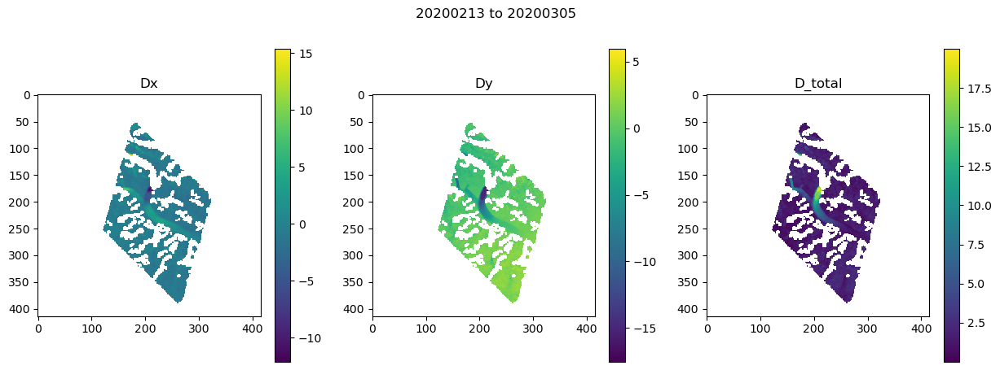

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.13558220863342285
20200305 20200312
PS_20200305_clipped.tif PS_20200312_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Volumes/SGlacier/TG_autorift_inputs/IfSAR_100m_DSM_clipped.tif
Slopes: /Volumes/SGlacier/TG_autorift_inputs/IfSAR_100m_DSM_clipped_dhdx.tif  /Volumes/SGlacier/TG_autorift_inputs/

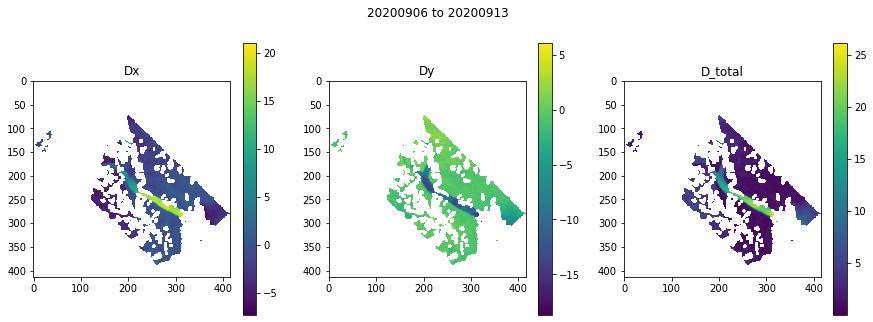

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0542452335357666
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

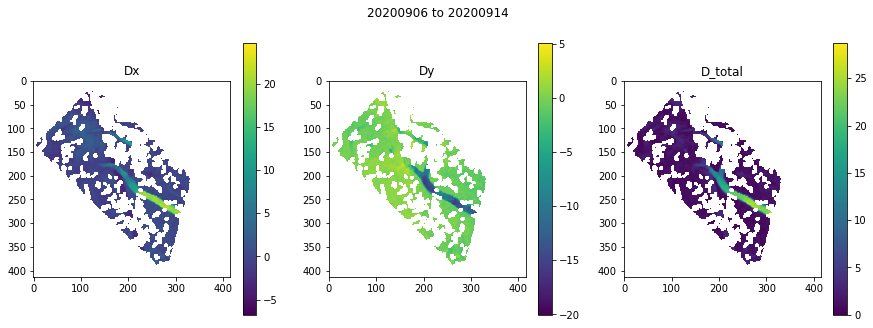

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3799760341644287
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

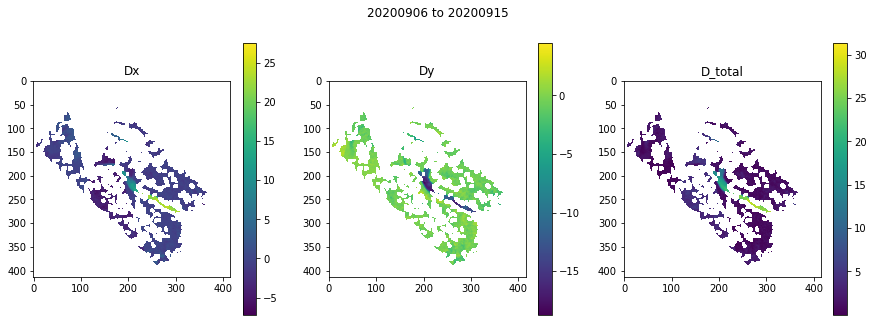

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05395197868347168
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

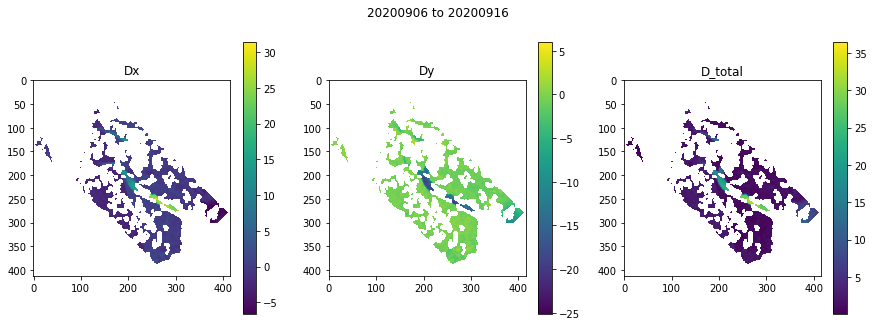

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05587005615234375
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

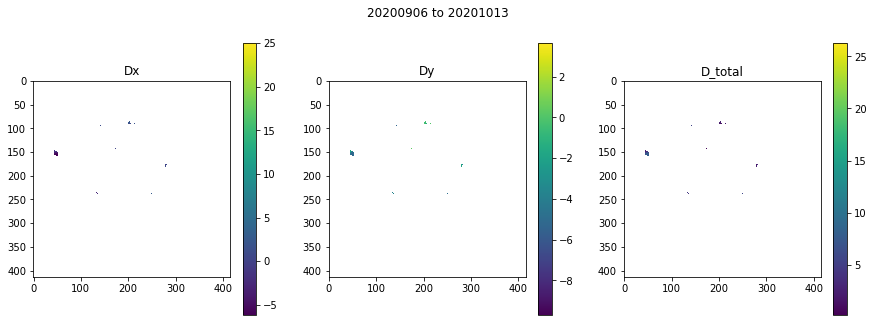

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05301499366760254
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

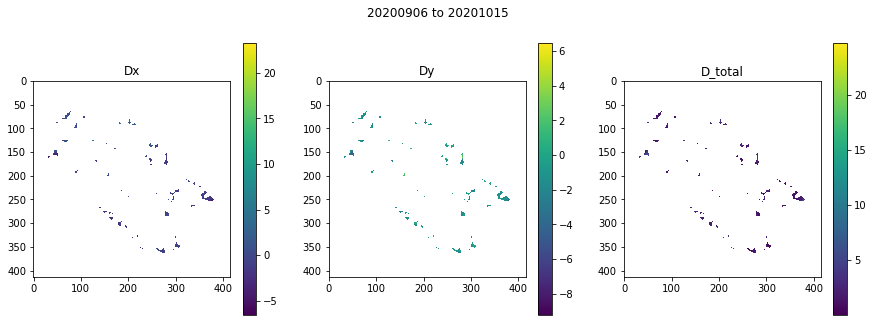

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.37434911727905273
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

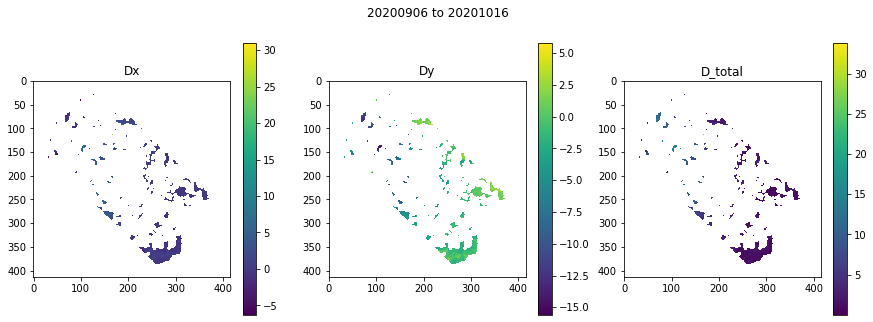

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06668400764465332
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

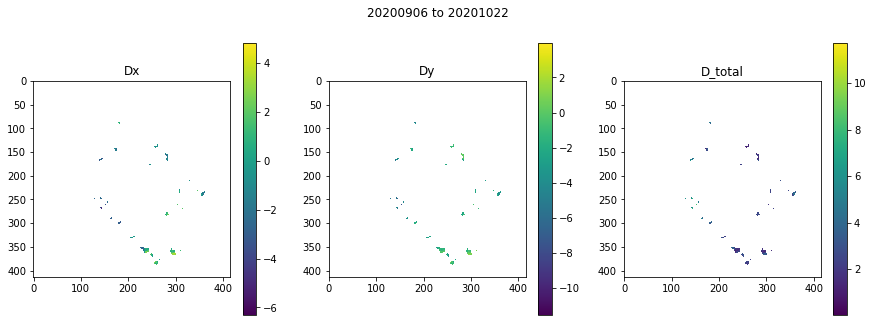

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05456995964050293
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

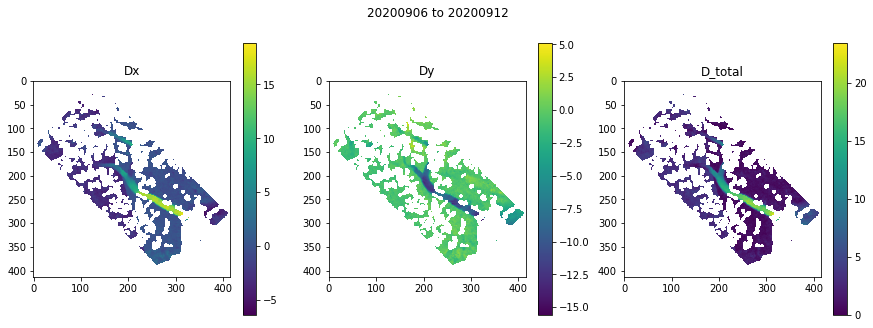

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06088399887084961
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

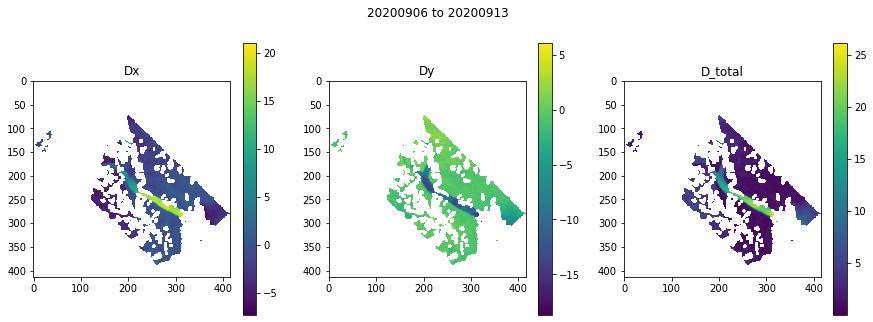

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.055593013763427734
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

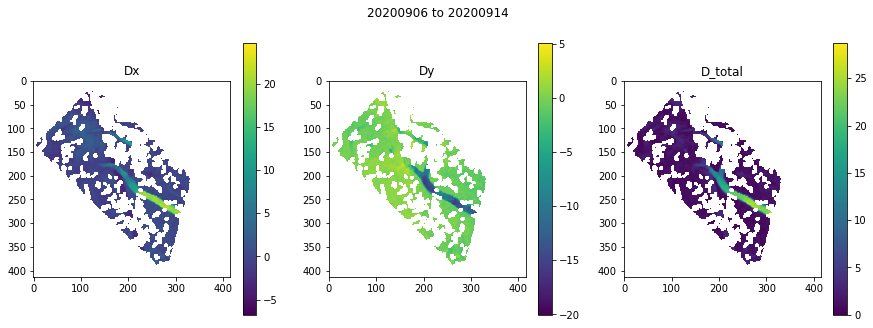

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054735660552978516
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

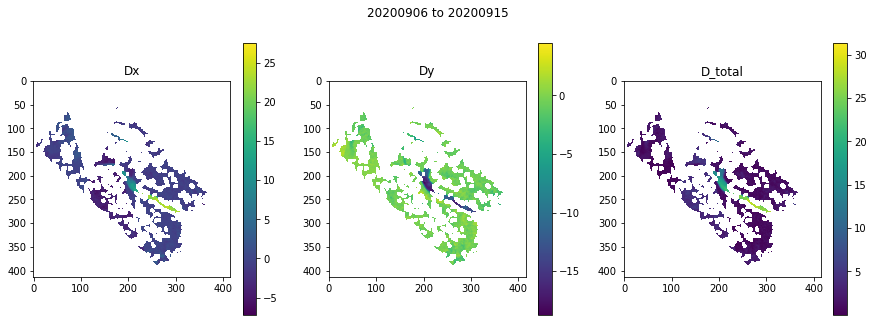

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05512285232543945
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

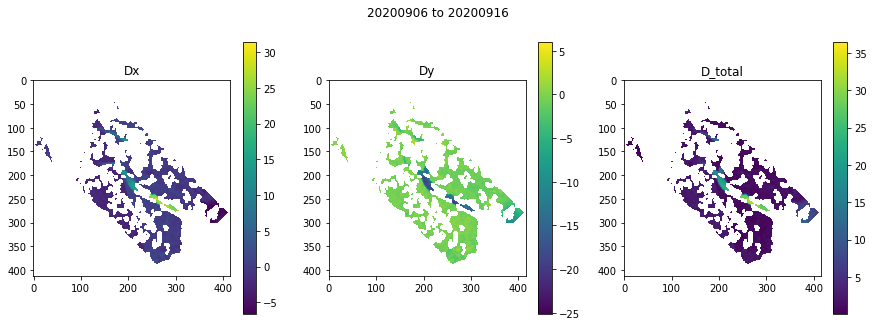

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05483078956604004
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

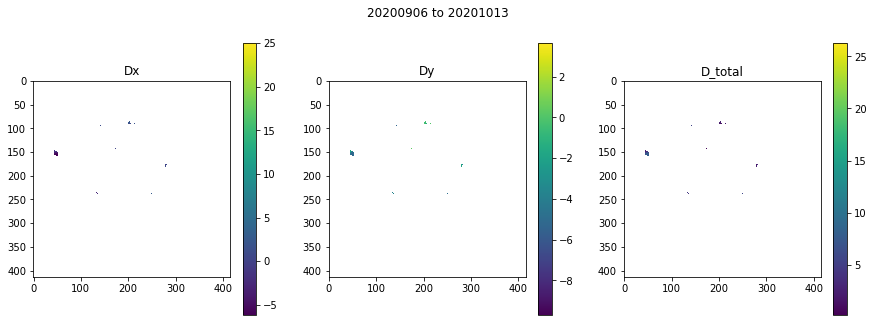

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.1072700023651123
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

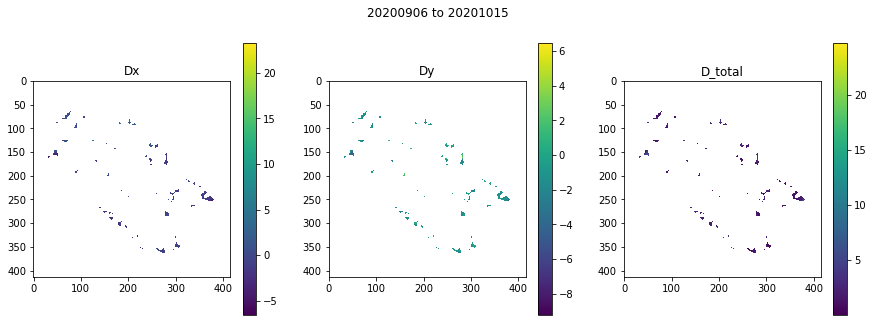

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0550839900970459
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

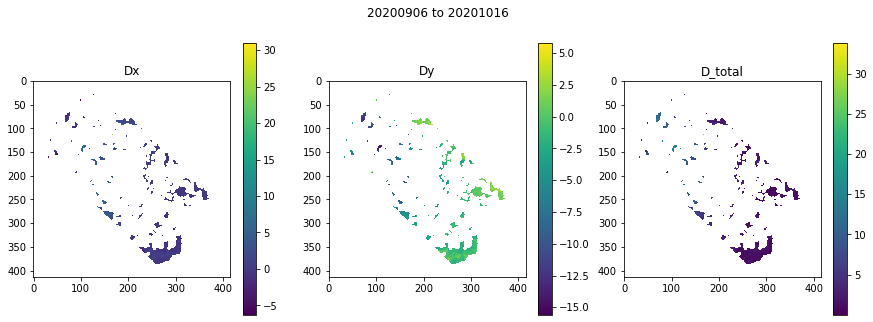

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.36299610137939453
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

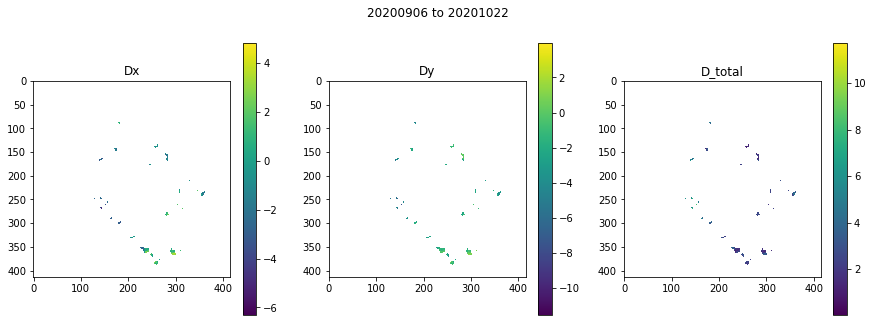

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05467510223388672
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

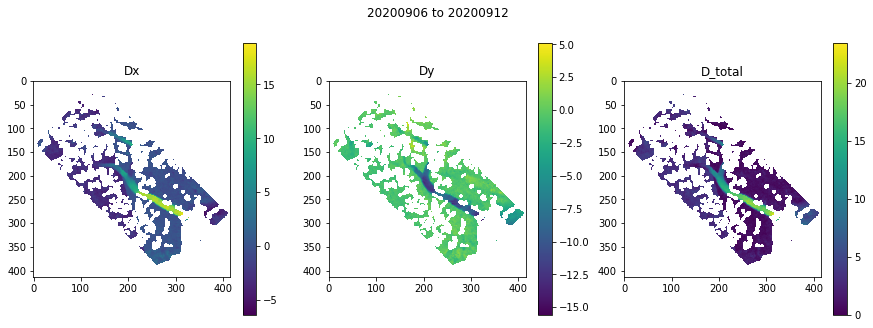

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054839134216308594
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

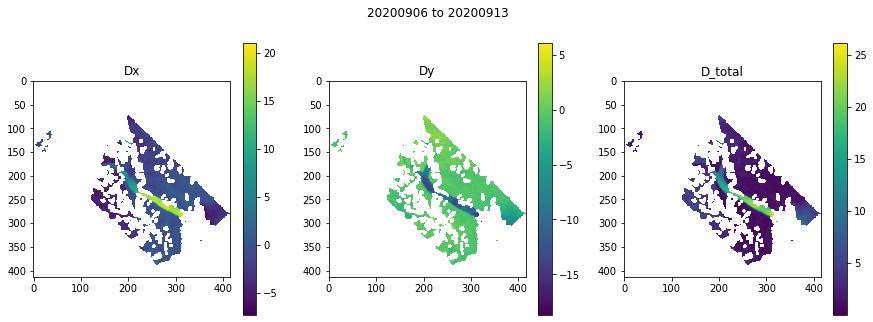

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.09759187698364258
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

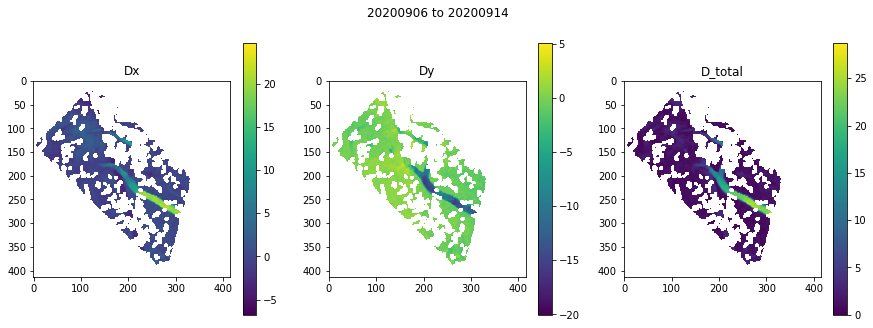

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05359792709350586
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

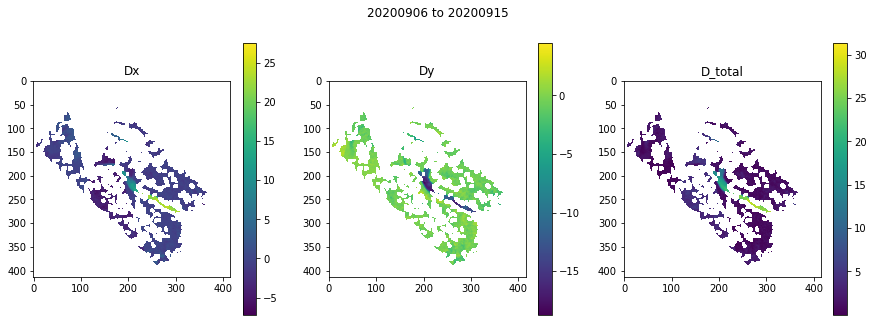

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06217169761657715
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

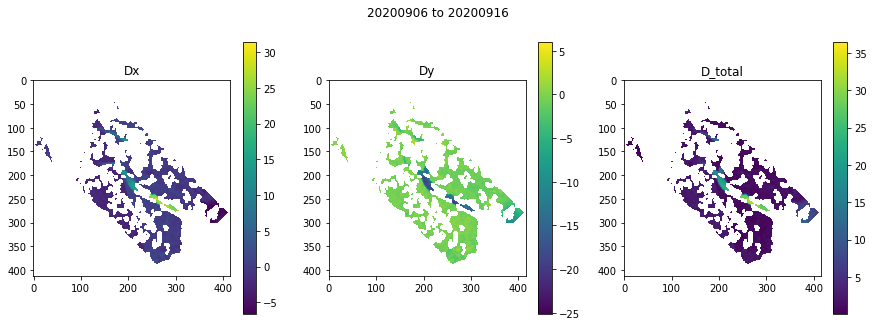

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06015324592590332
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

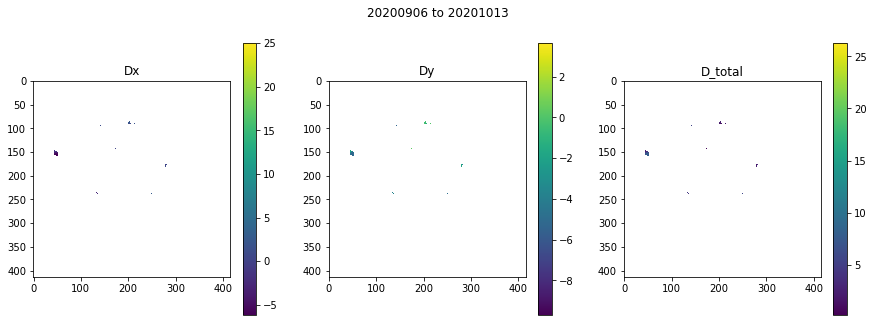

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05483603477478027
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

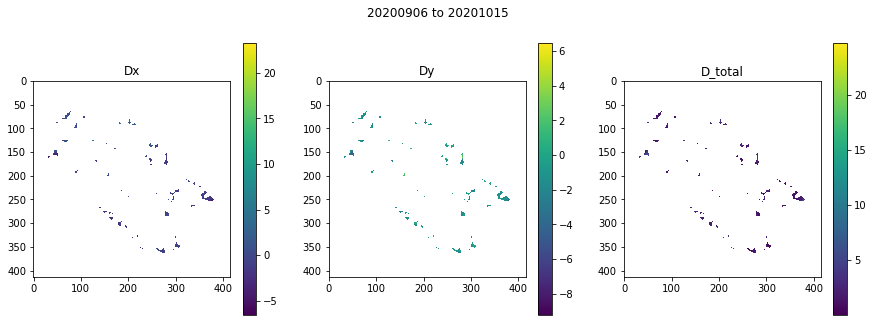

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05826425552368164
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

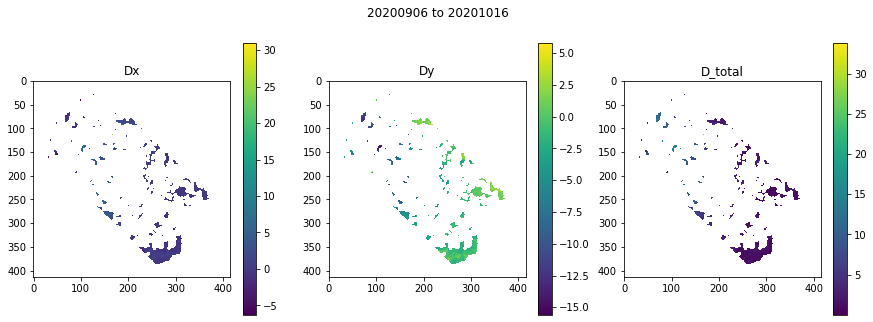

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05392313003540039
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

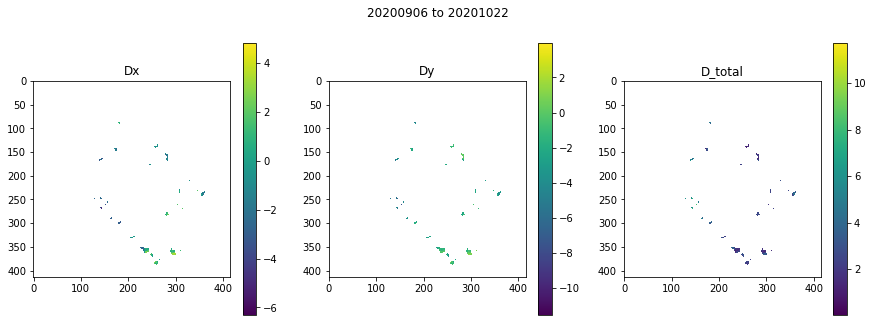

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06563591957092285
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

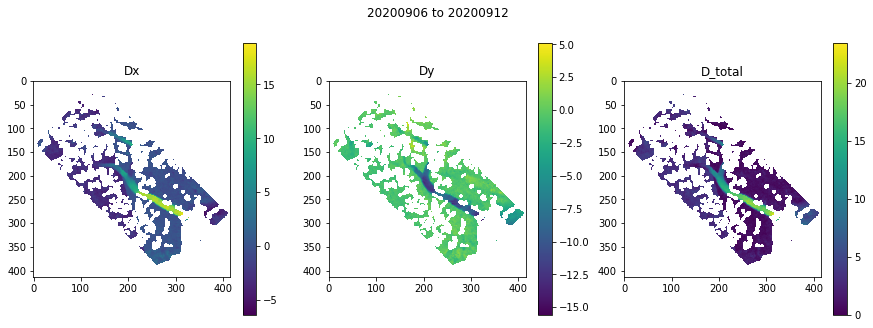

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.09606289863586426
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

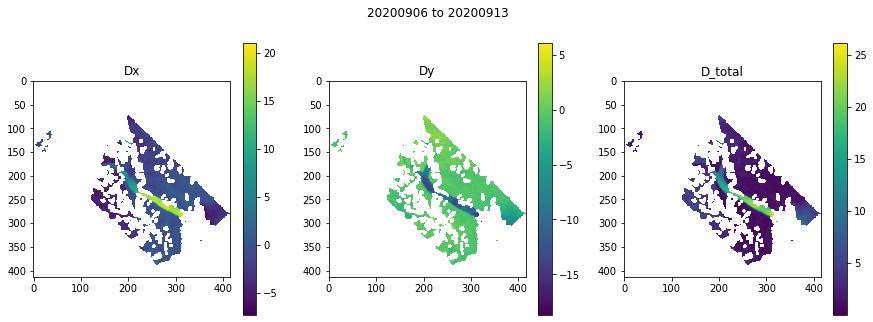

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05401182174682617
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

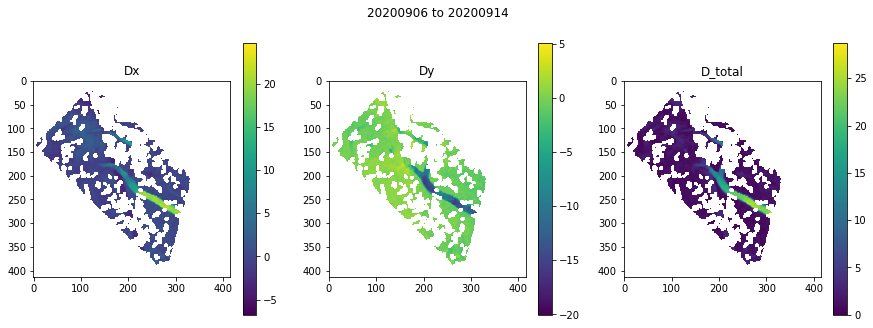

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05619382858276367
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

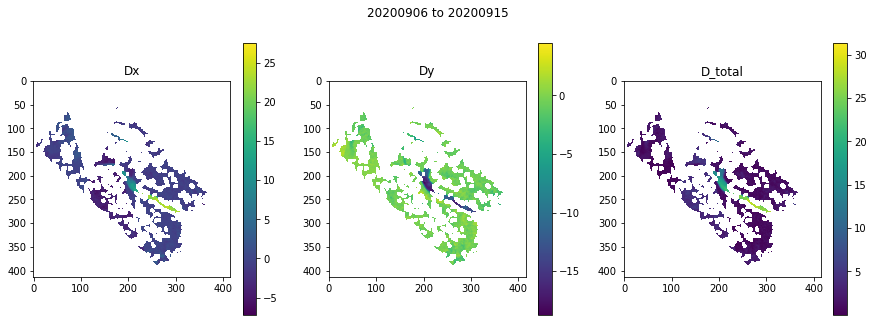

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05902886390686035
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

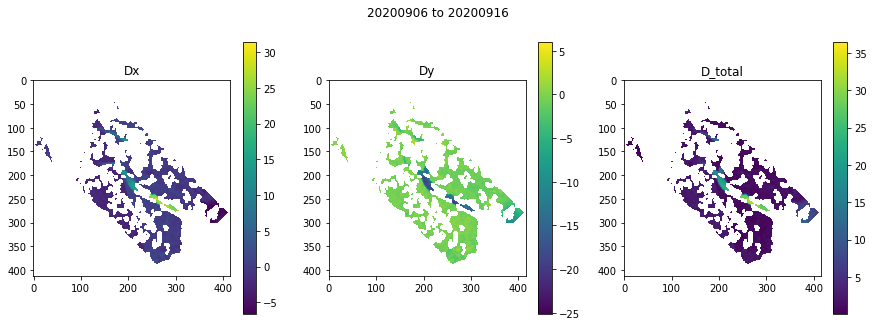

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.059603214263916016
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

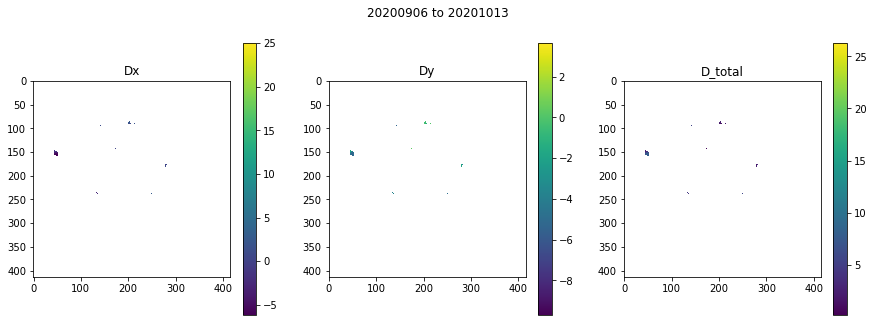

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05723690986633301
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

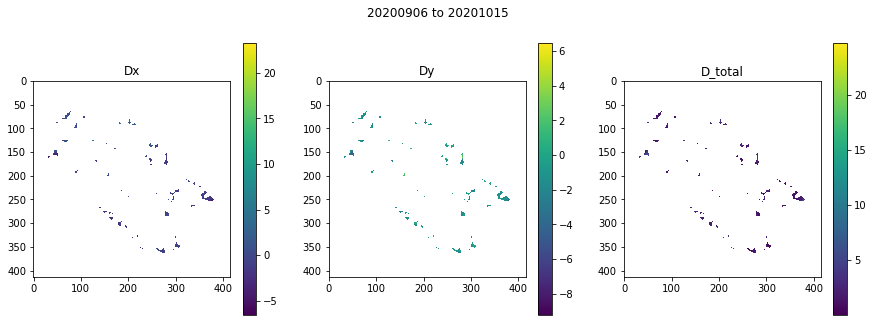

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05510091781616211
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

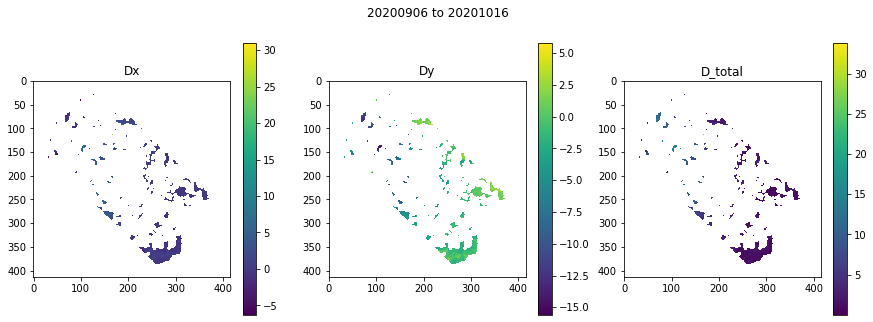

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05470585823059082
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

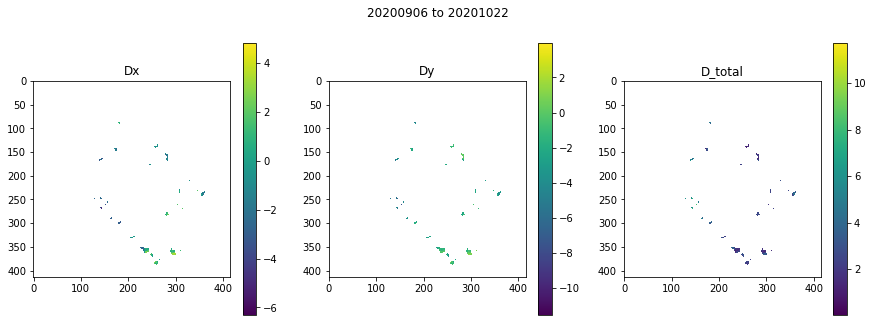

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.060350894927978516
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

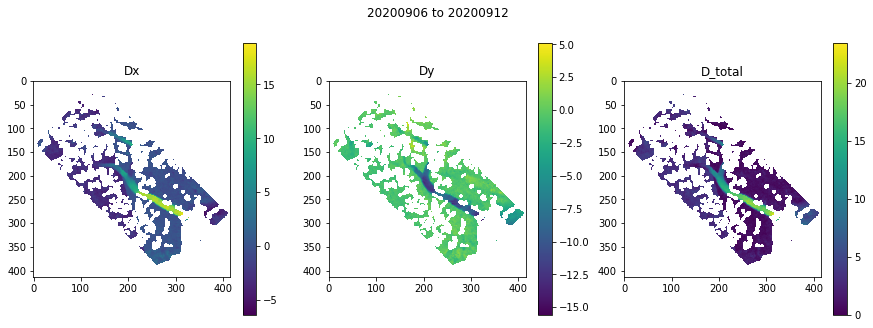

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.053826093673706055
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

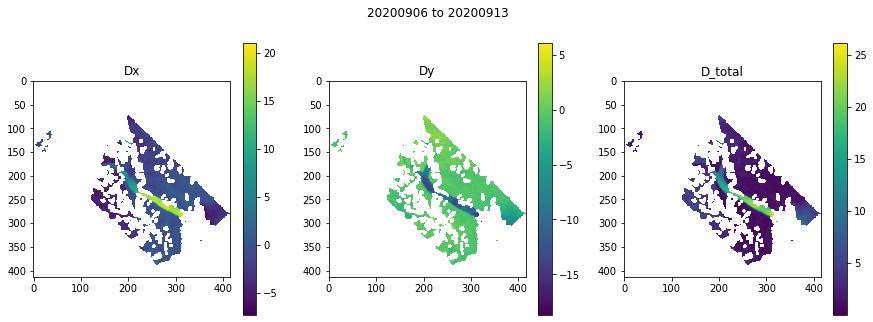

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054898977279663086
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

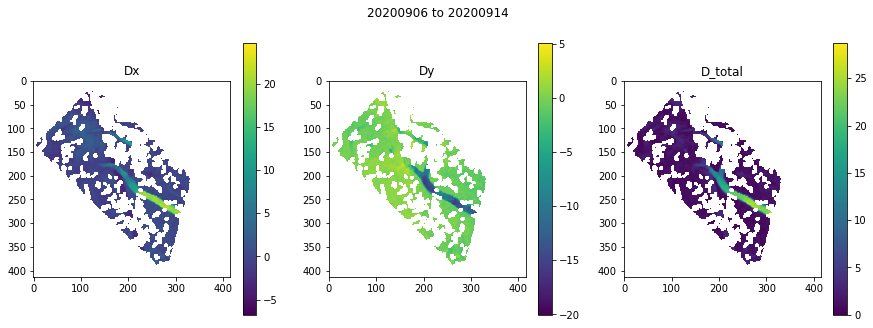

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05548906326293945
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

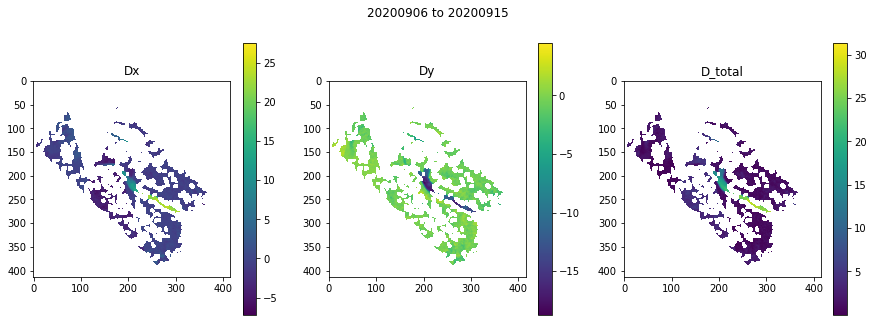

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06229901313781738
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

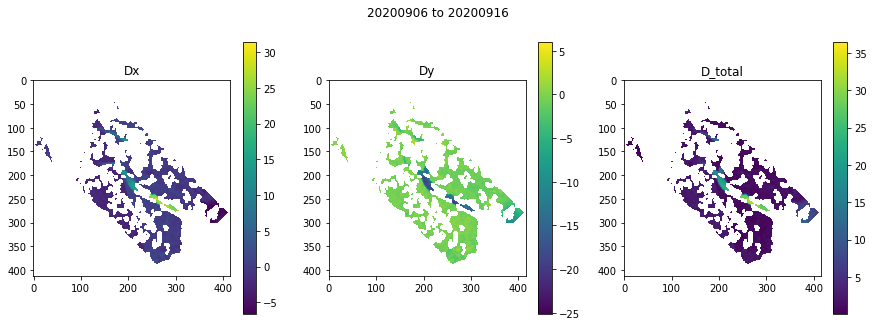

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05562591552734375
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

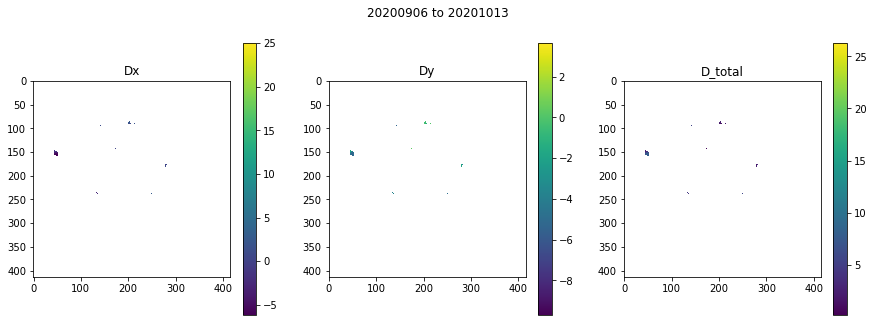

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05880117416381836
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

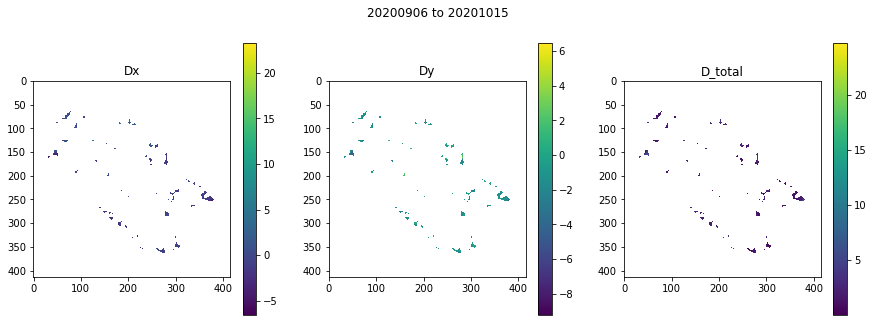

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0544886589050293
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

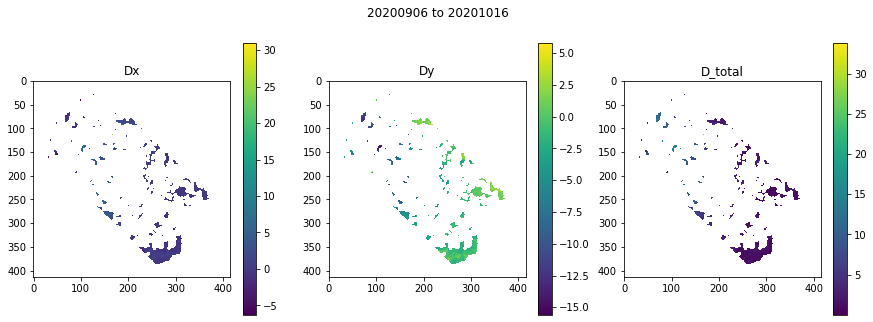

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054386138916015625
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

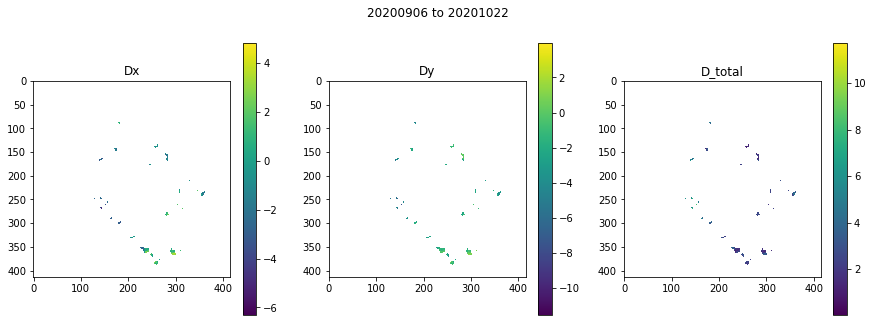

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06388592720031738
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

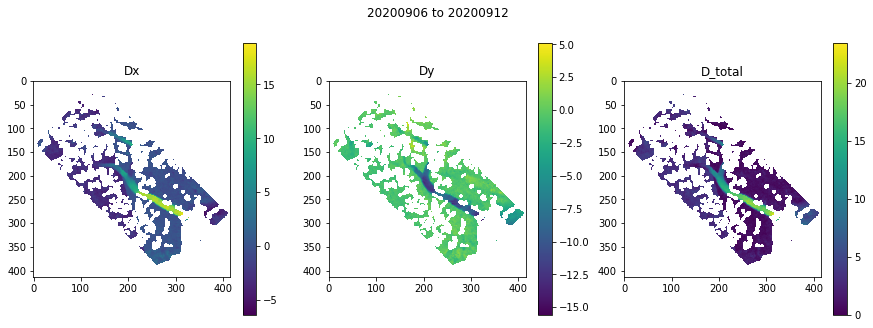

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05385708808898926
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

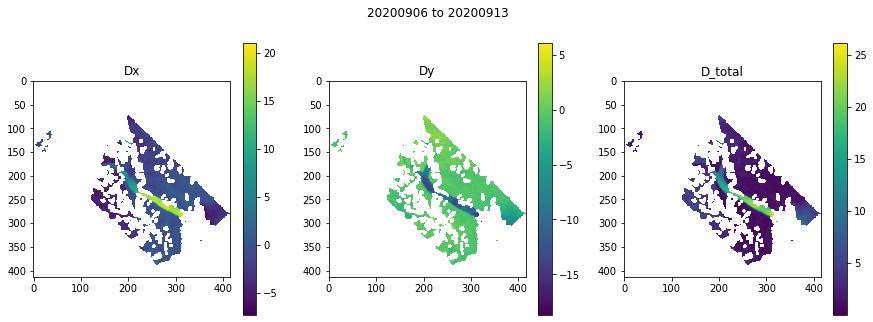

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05307483673095703
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

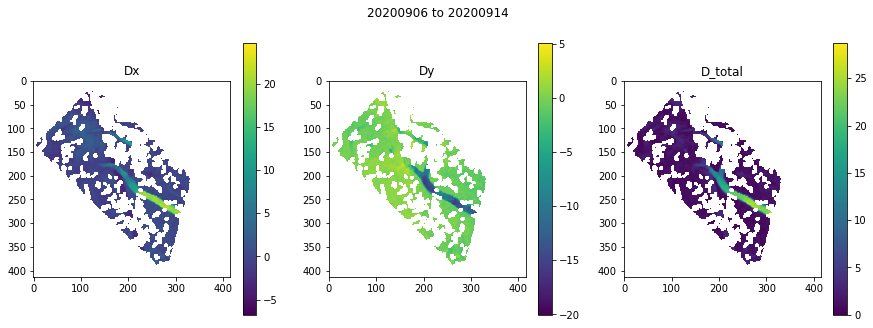

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05631279945373535
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

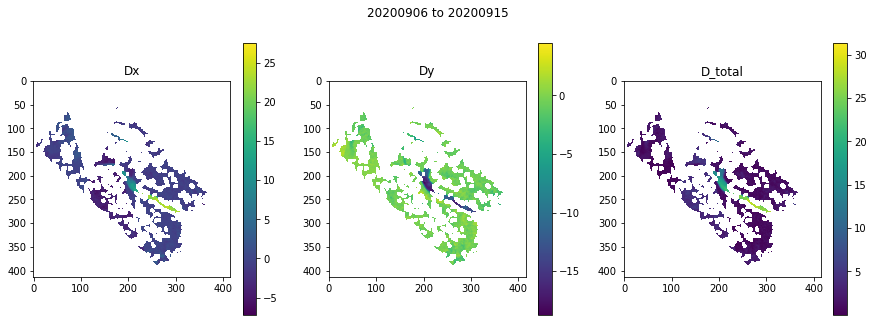

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05521202087402344
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

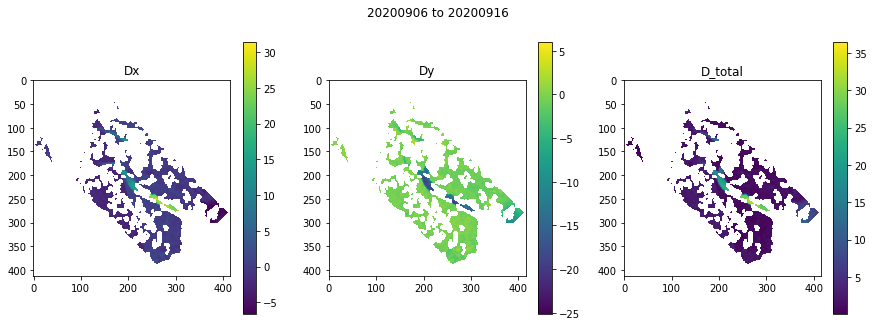

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.060389041900634766
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

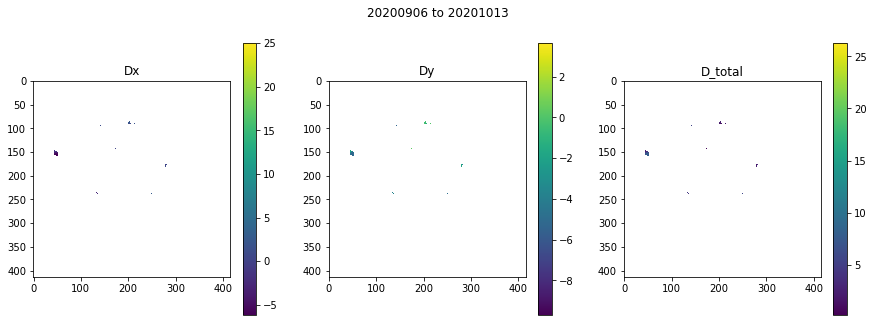

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.15699100494384766
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

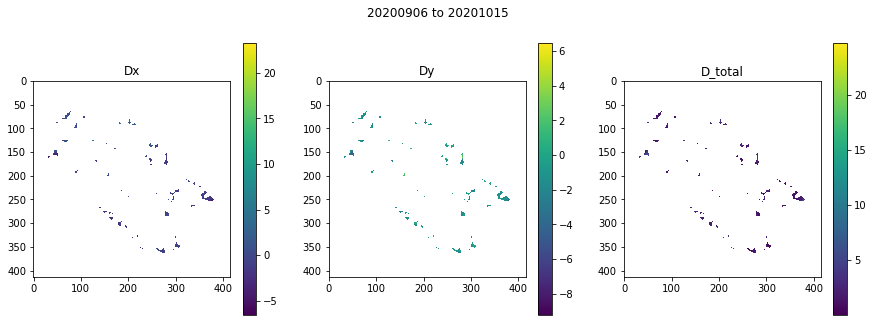

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.053714752197265625
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

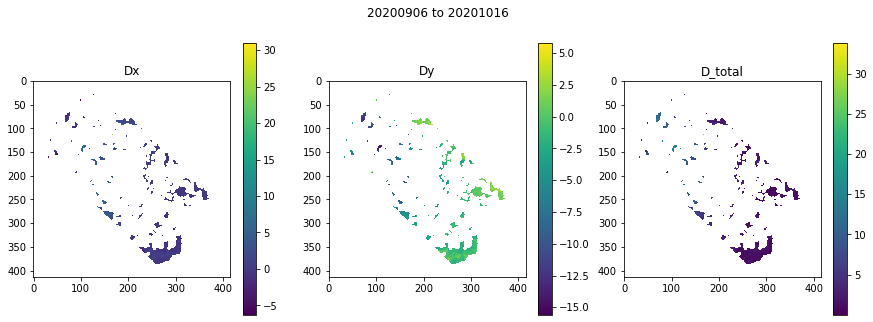

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05429410934448242
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

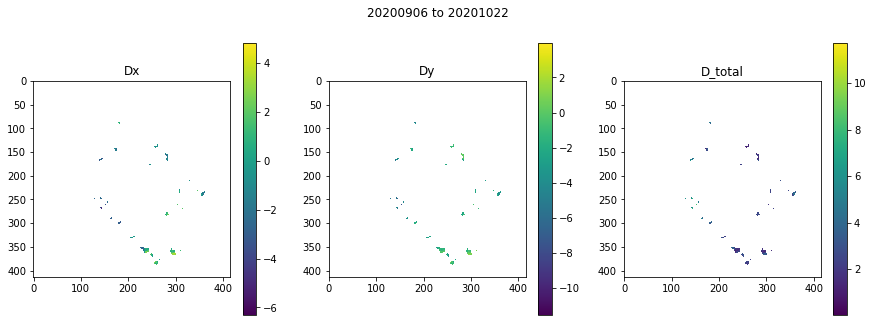

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.060259103775024414
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

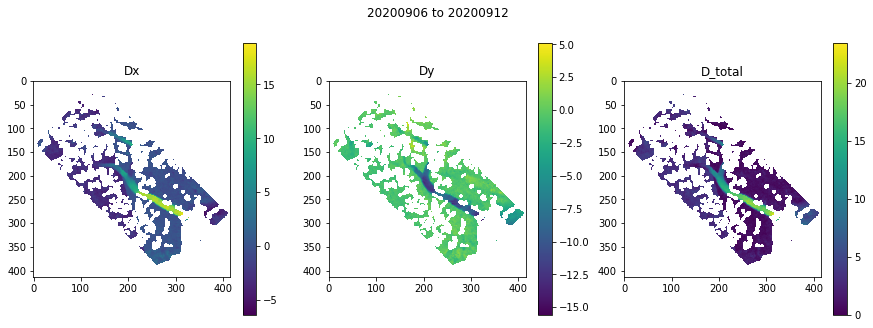

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054457902908325195
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

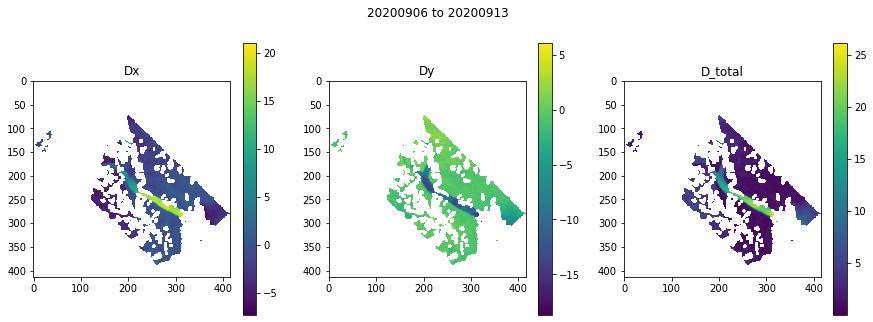

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.11484193801879883
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

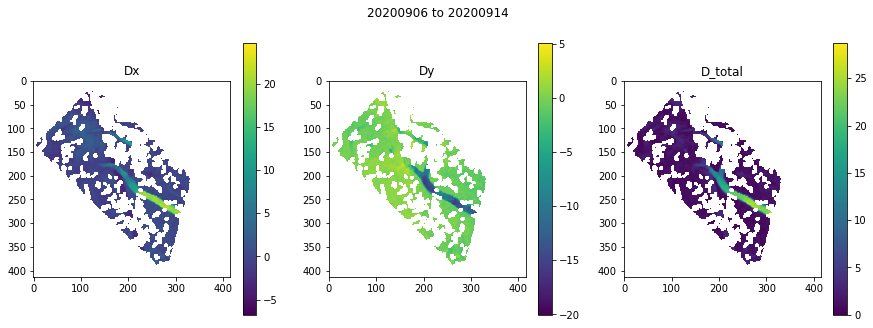

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.1214141845703125
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

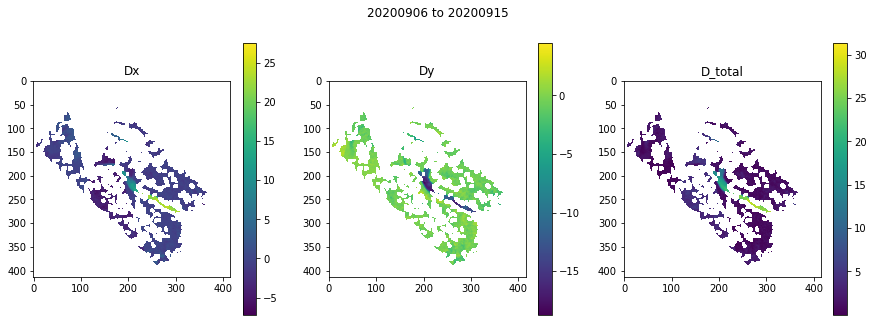

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.08690476417541504
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

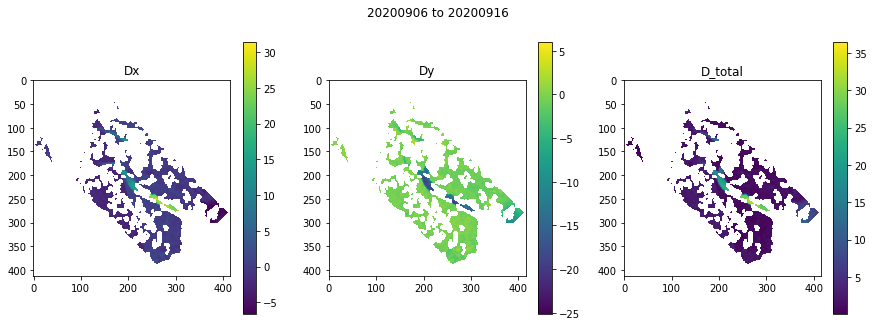

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.354794979095459
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

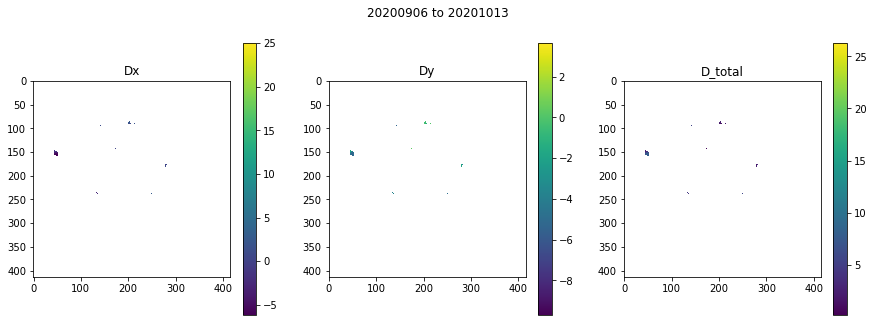

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.060343027114868164
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

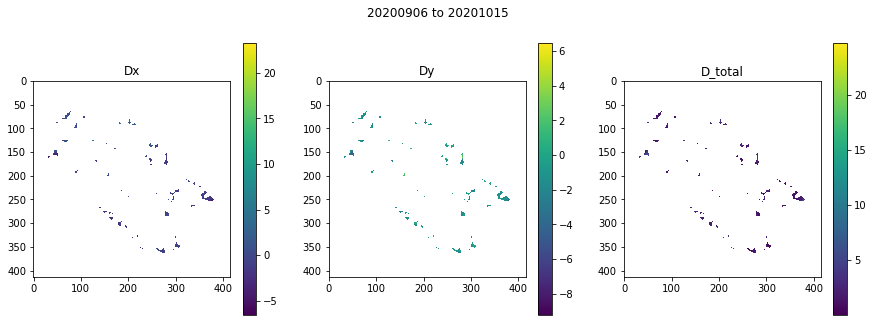

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06488800048828125
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

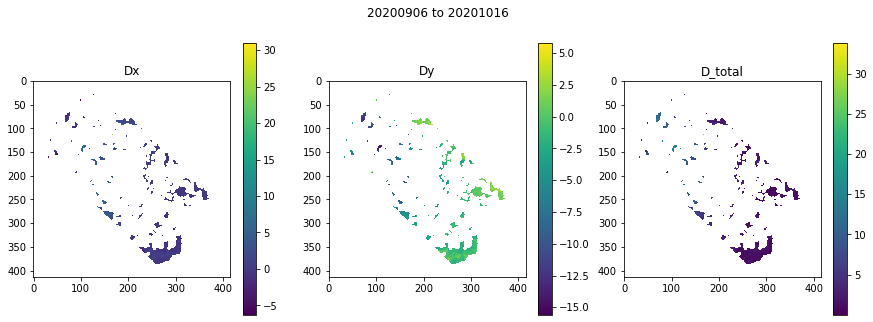

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.36301732063293457
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

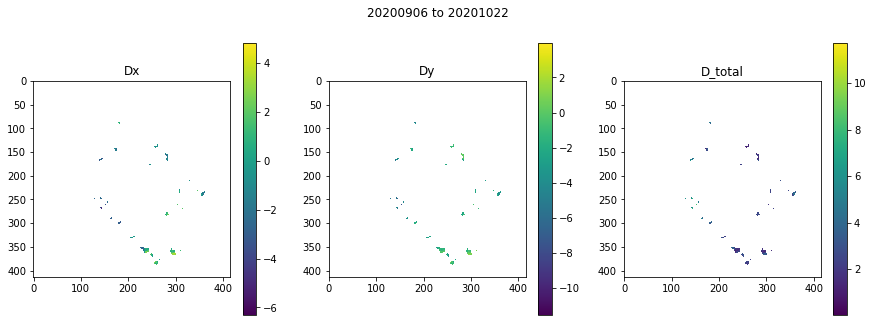

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.052763938903808594
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

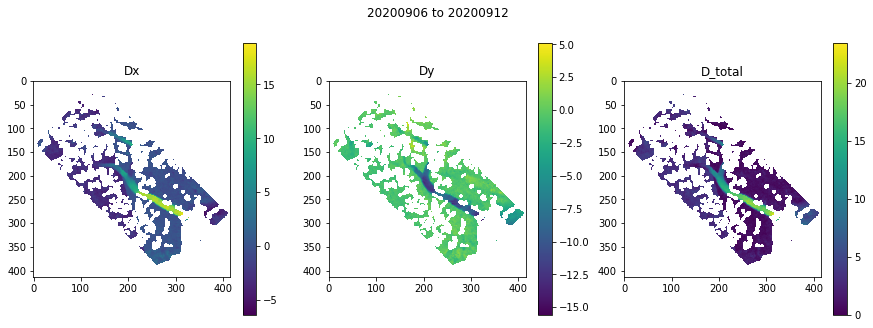

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05562996864318848
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

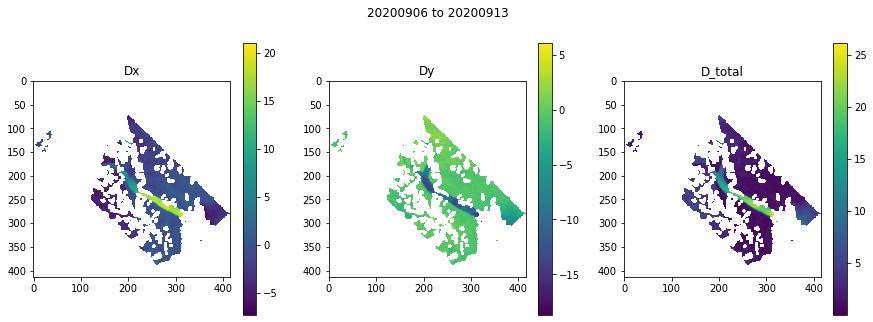

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.060667991638183594
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

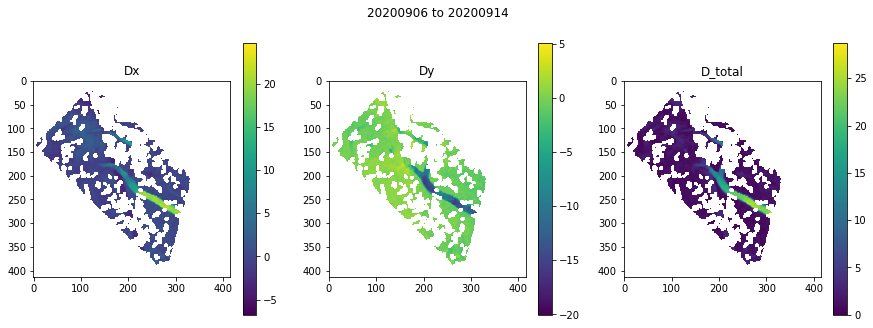

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05503106117248535
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

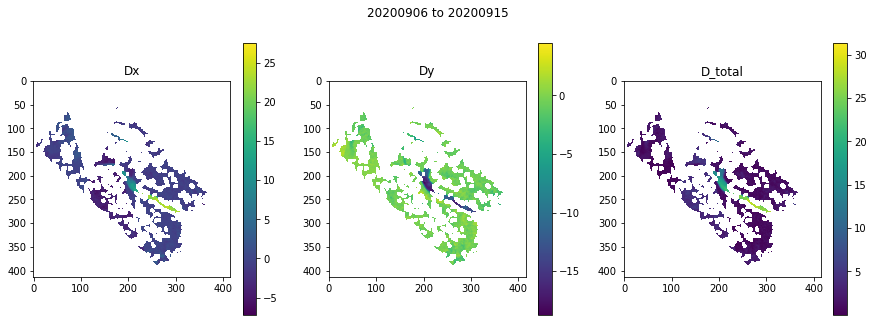

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05449700355529785
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

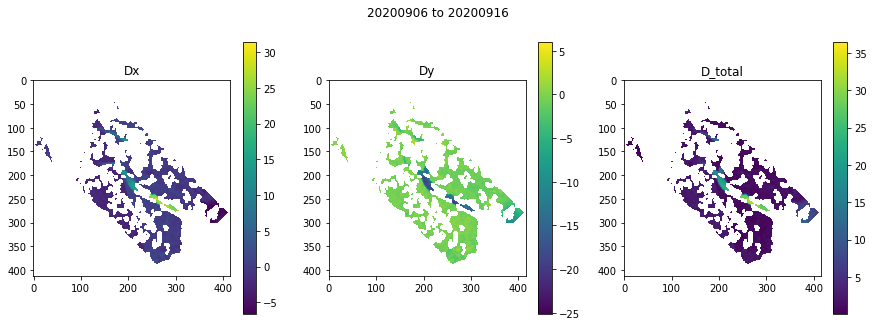

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05559897422790527
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

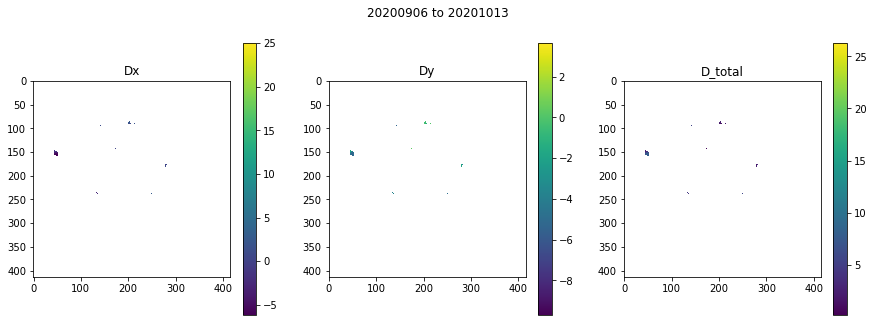

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05619478225708008
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

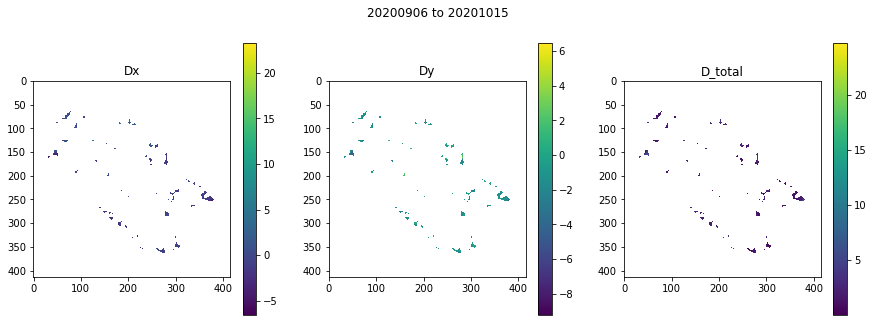

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05971407890319824
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

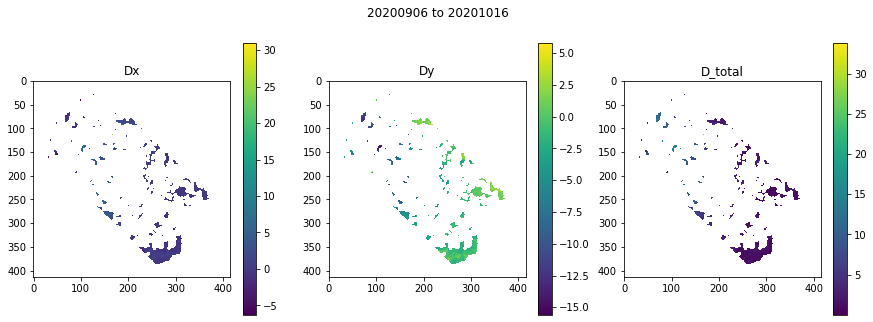

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.051191091537475586
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

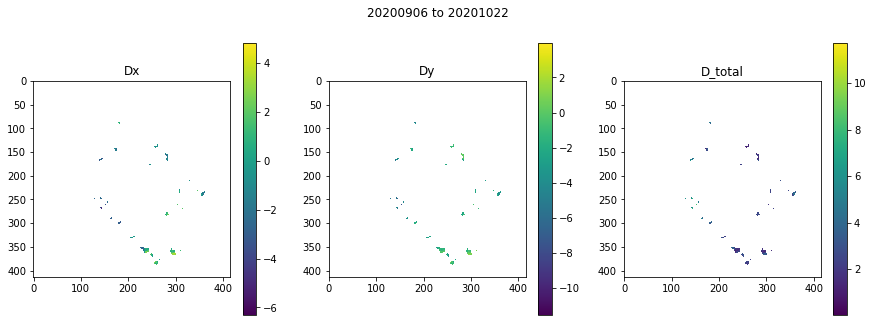

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05299782752990723
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

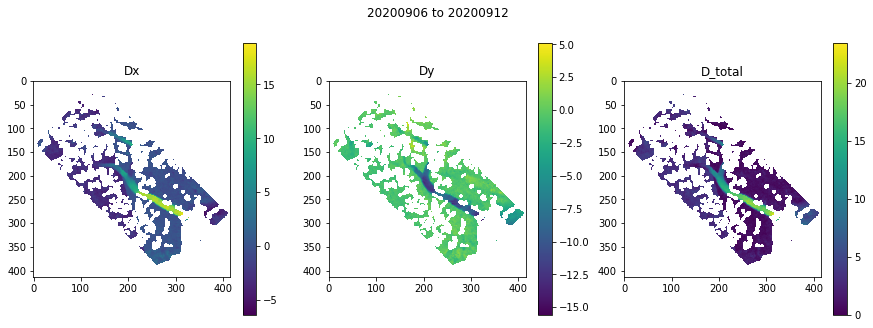

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0615389347076416
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

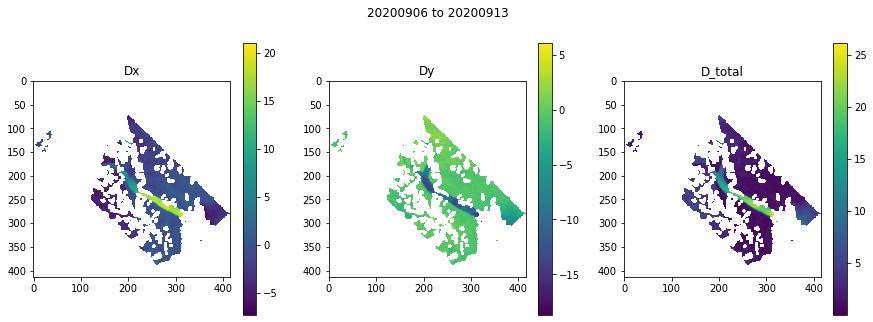

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0549769401550293
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

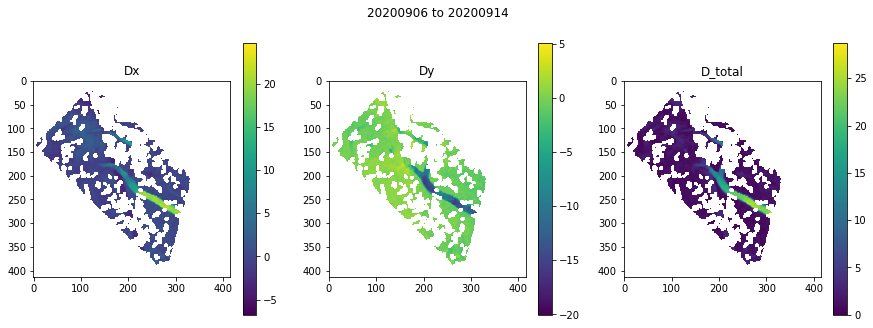

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05548691749572754
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

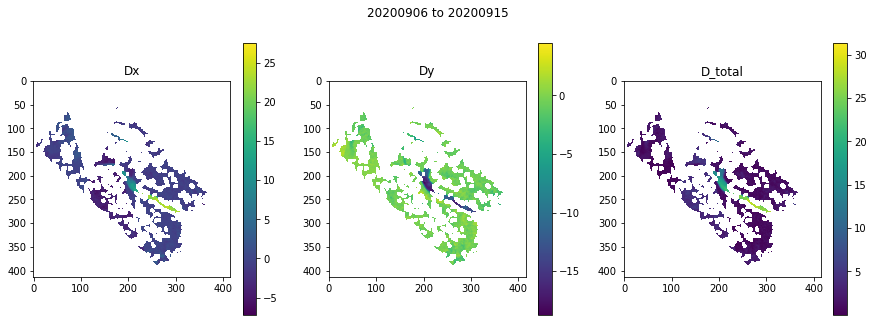

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06078910827636719
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

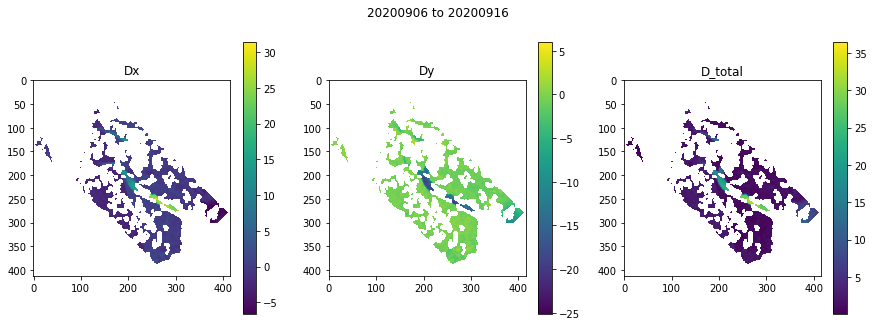

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05272984504699707
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

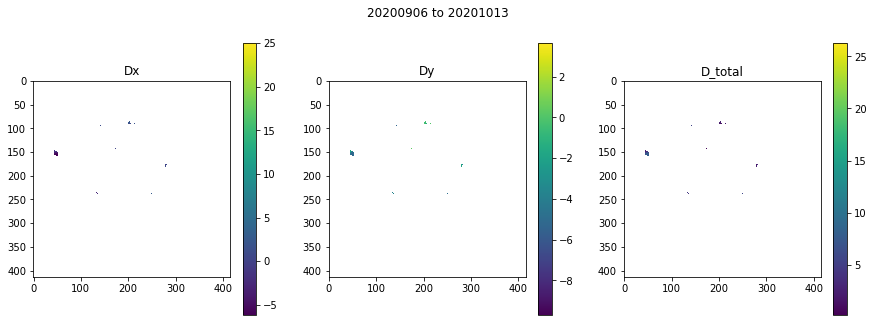

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.058136940002441406
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

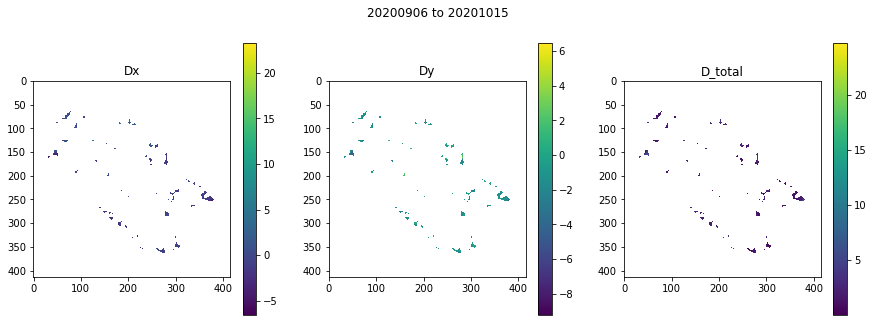

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05594205856323242
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

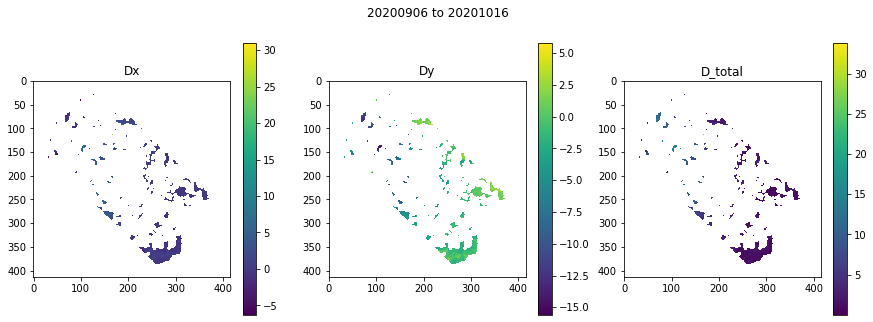

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05453610420227051
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

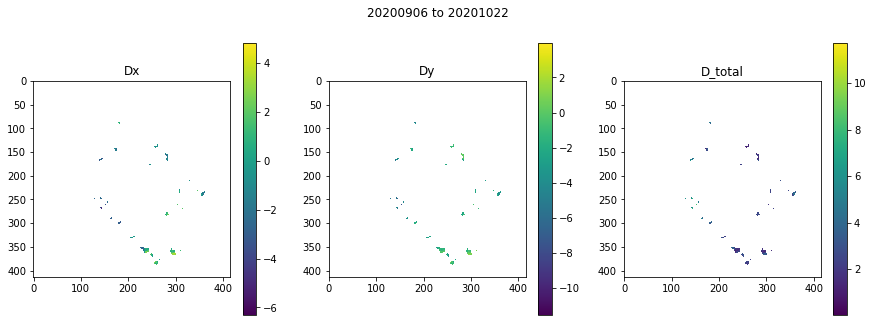

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05462813377380371
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

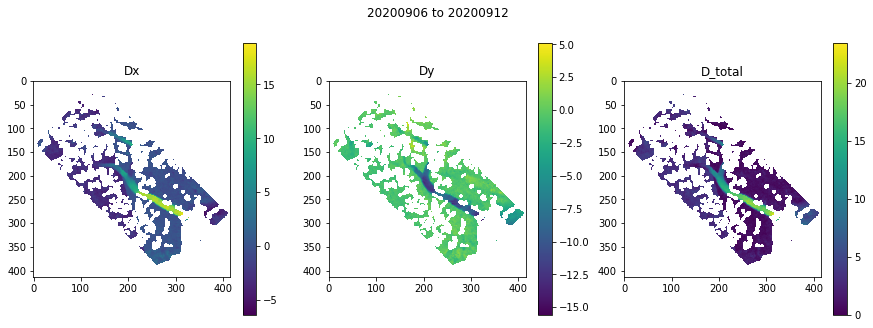

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0534510612487793
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

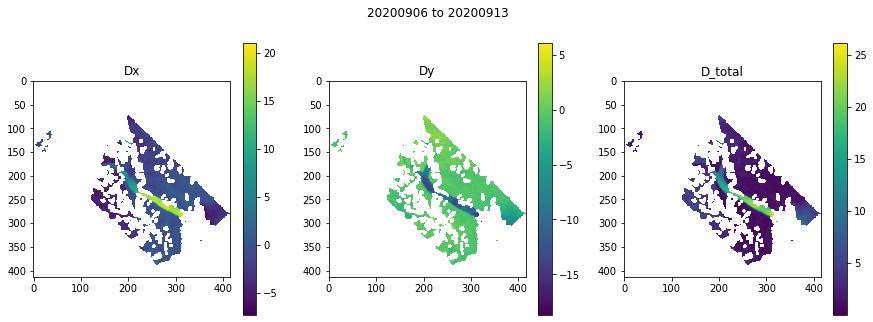

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05552482604980469
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

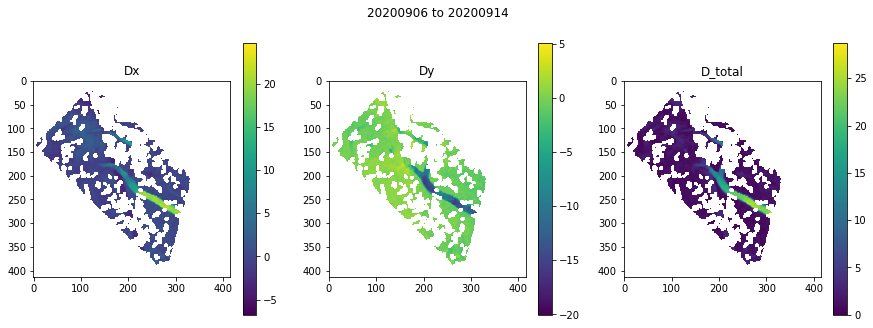

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05283999443054199
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

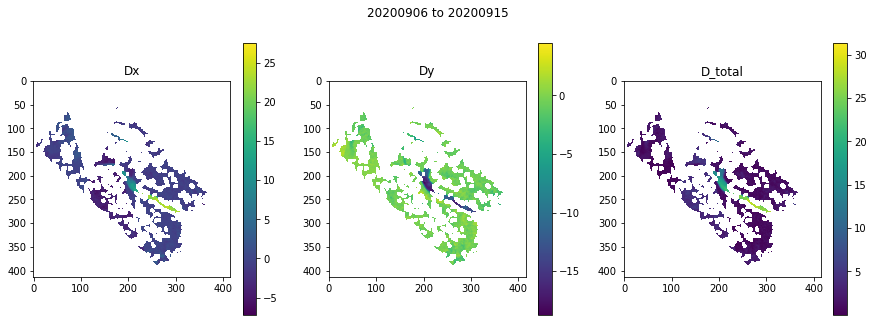

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.053730010986328125
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

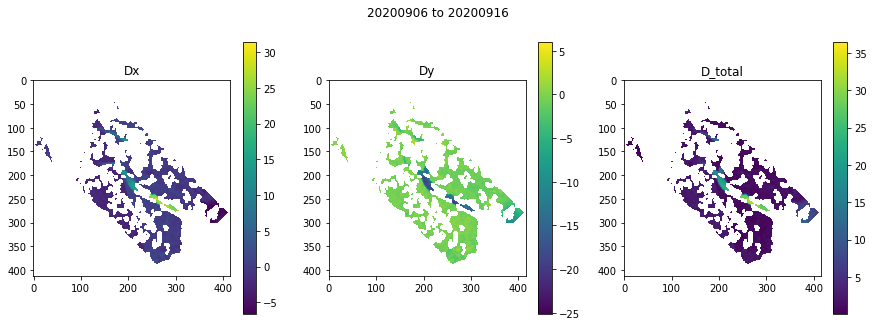

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05350828170776367
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

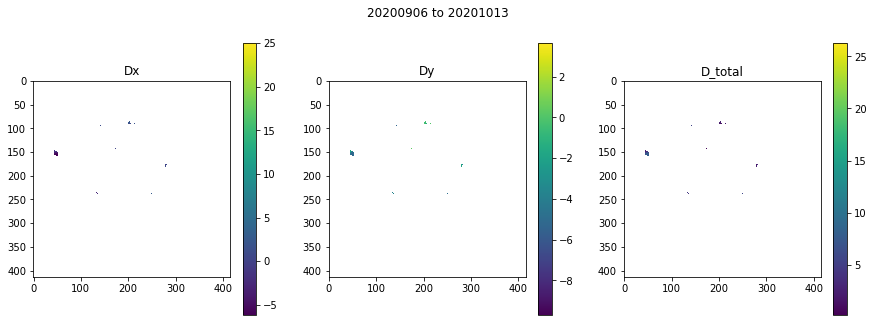

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.052793025970458984
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

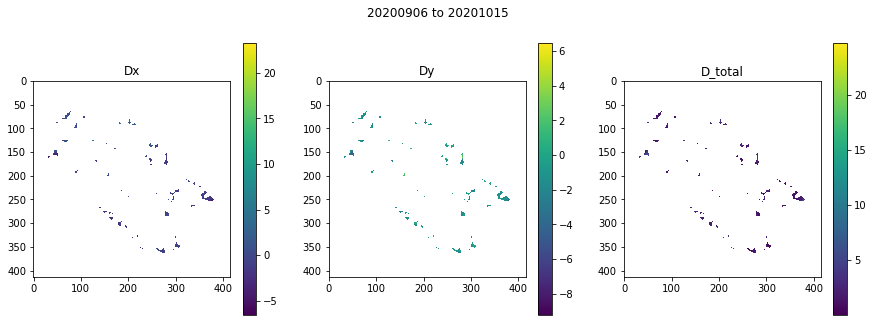

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05802583694458008
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

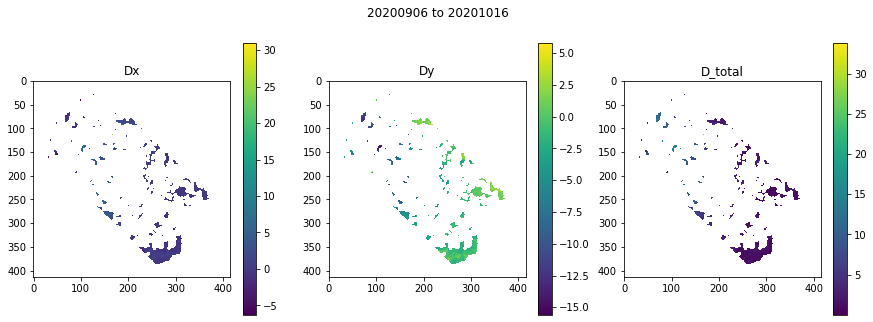

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.07975196838378906
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

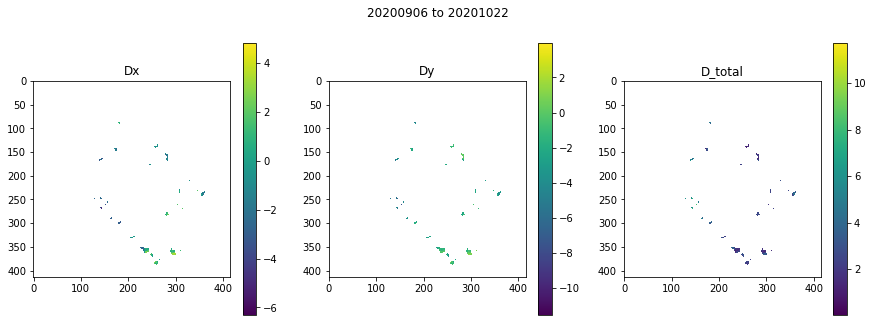

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.057805776596069336
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

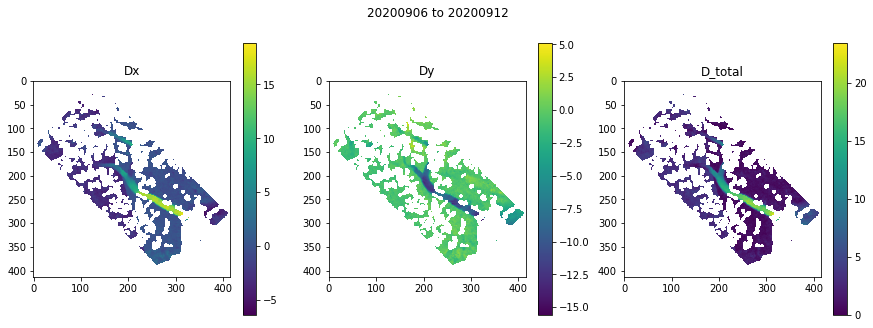

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05297207832336426
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

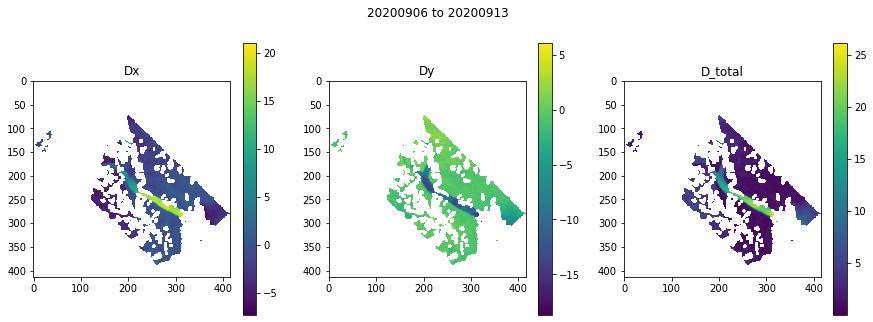

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.055400848388671875
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

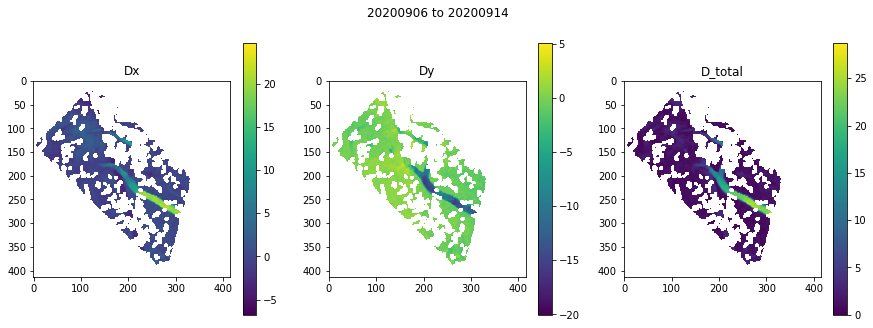

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0631108283996582
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

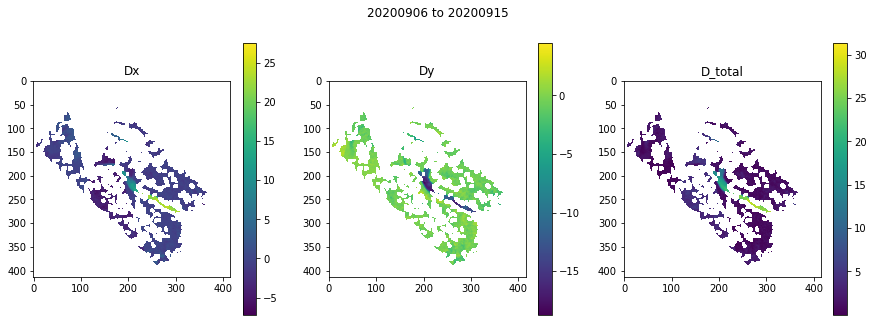

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.052375078201293945
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

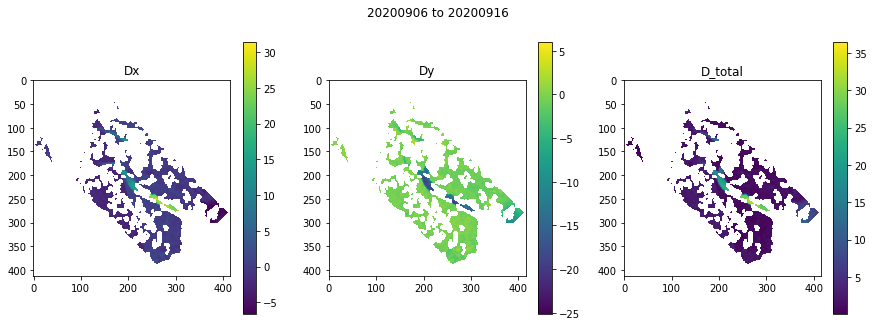

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.053253173828125
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

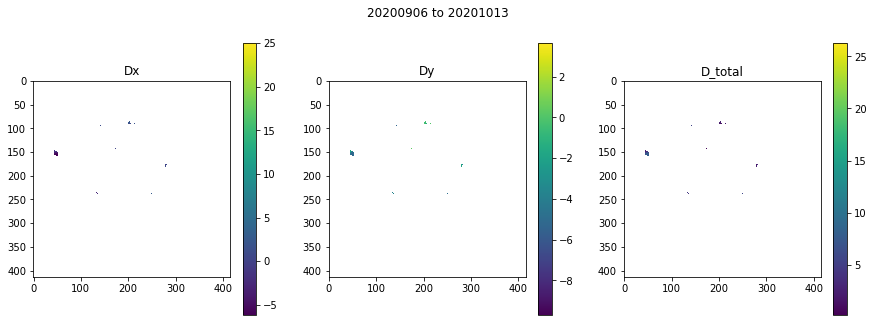

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.058129072189331055
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

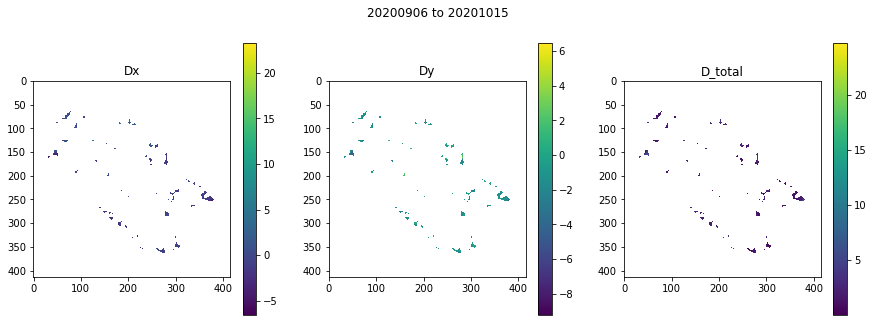

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054015159606933594
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

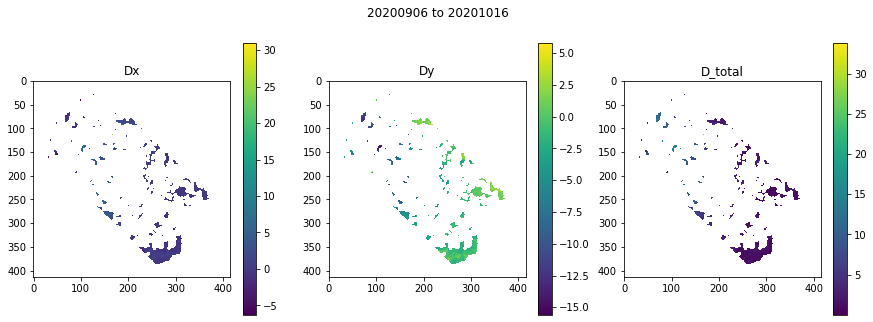

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054650068283081055
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

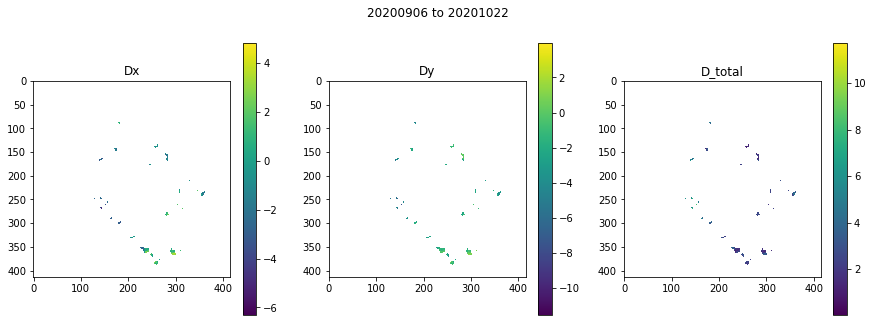

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05270099639892578
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

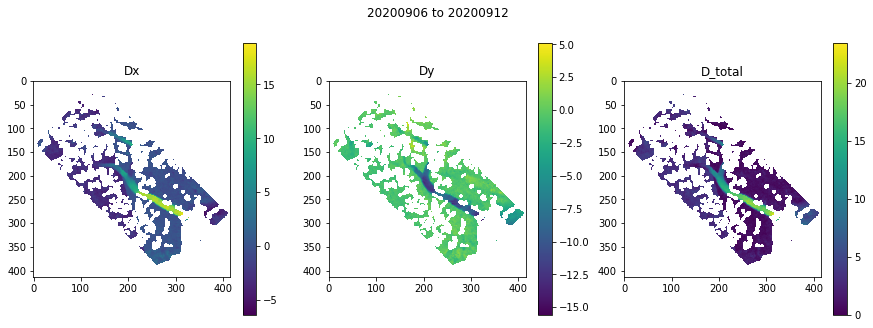

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06118607521057129
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

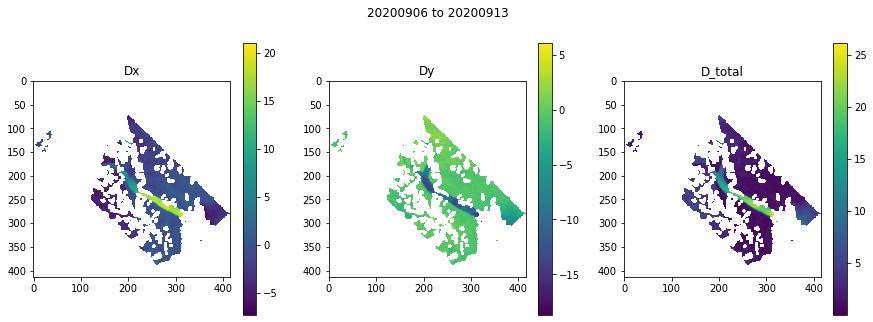

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05687880516052246
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

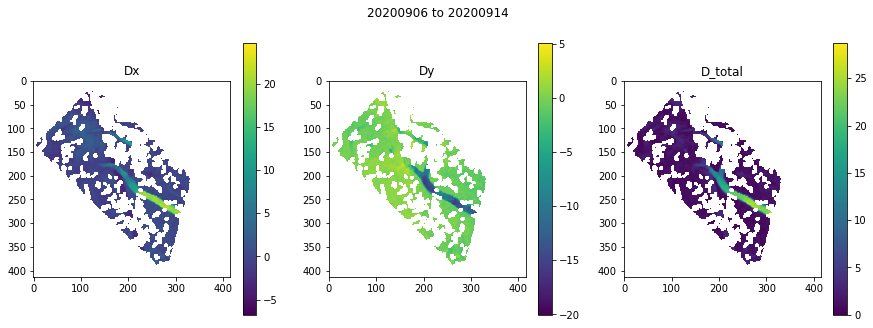

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05481100082397461
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

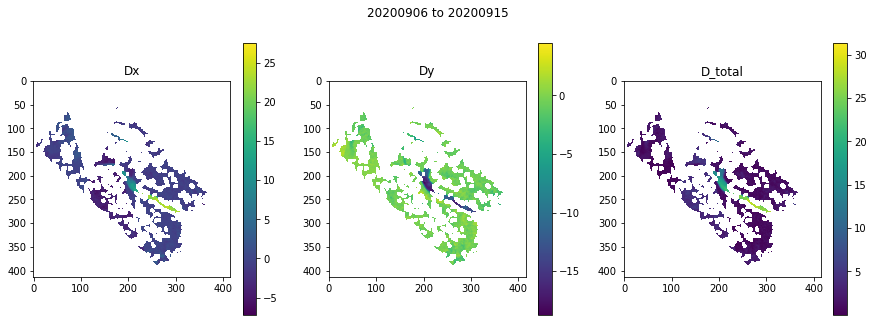

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05975985527038574
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

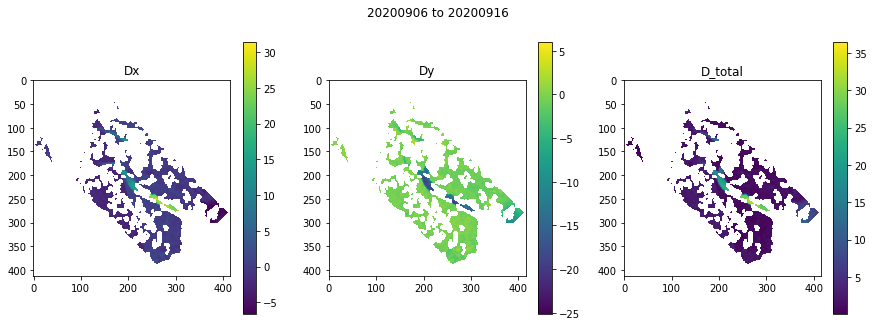

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05502724647521973
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

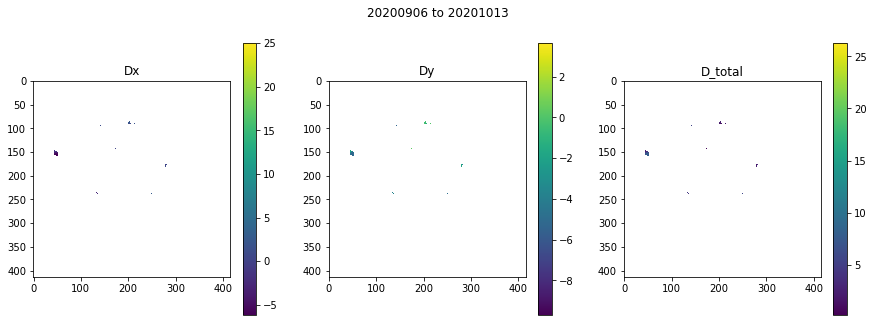

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05404186248779297
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

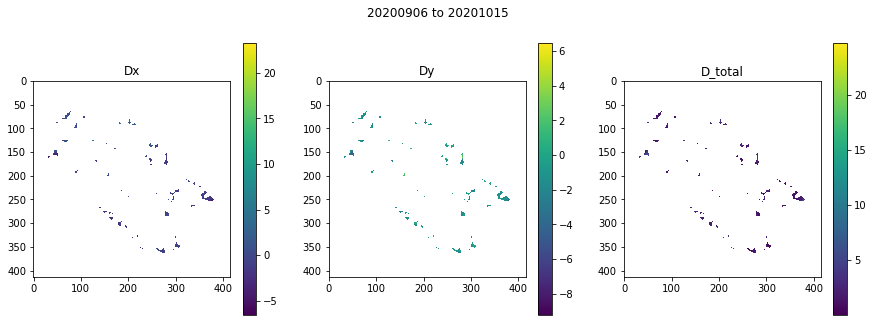

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.052247047424316406
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

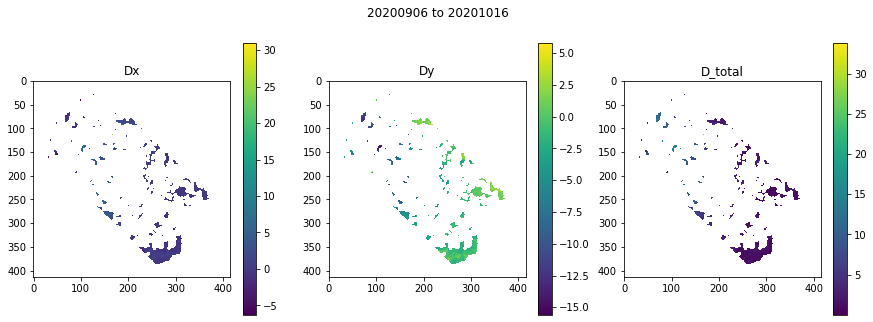

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054662227630615234
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

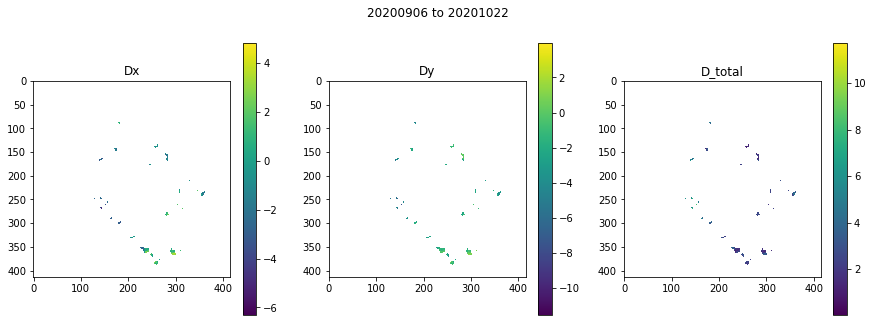

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06354117393493652
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

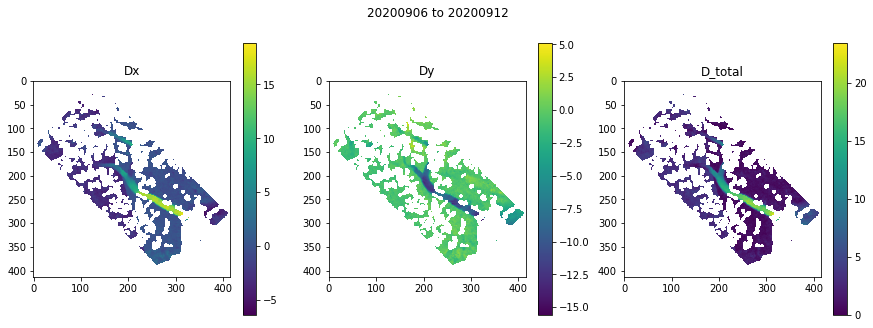

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05749320983886719
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

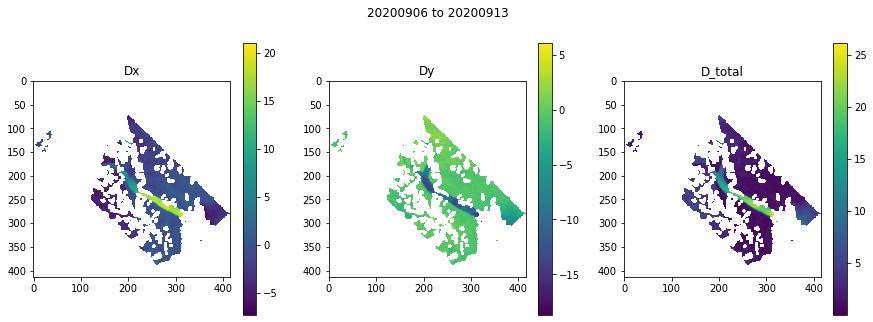

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.056208133697509766
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

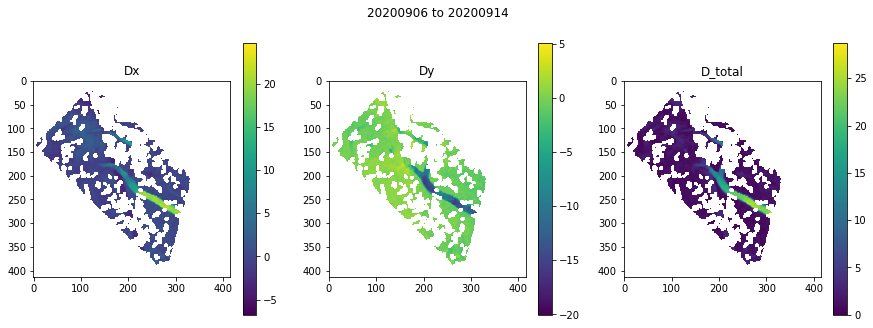

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05454206466674805
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

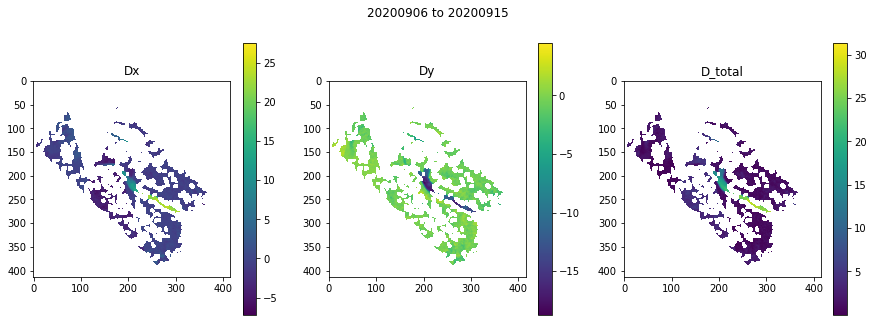

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.051611900329589844
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

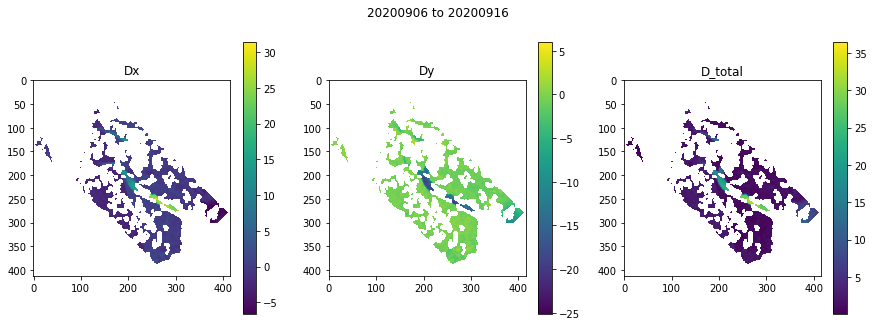

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05407881736755371
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

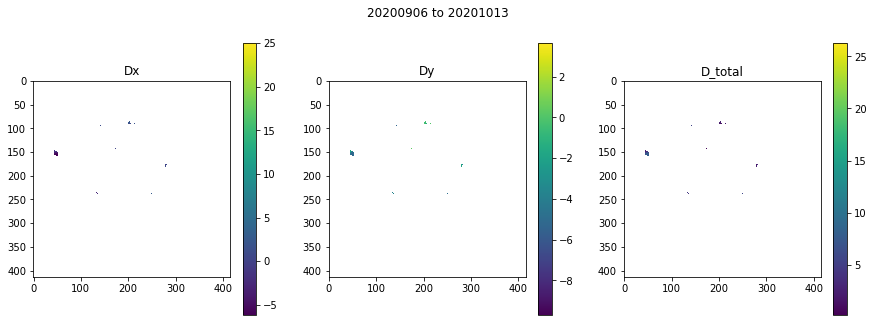

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3674769401550293
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

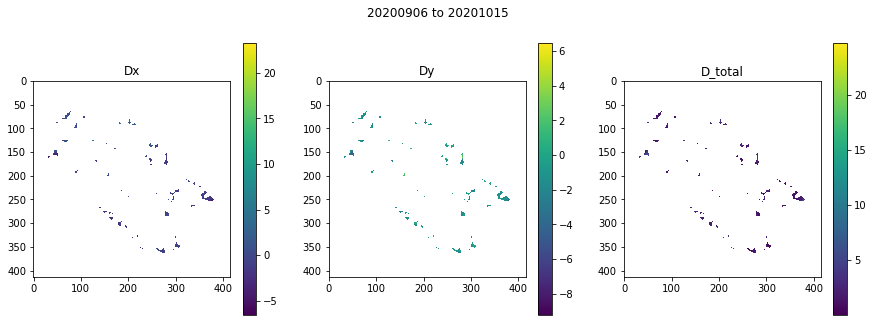

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.057331085205078125
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

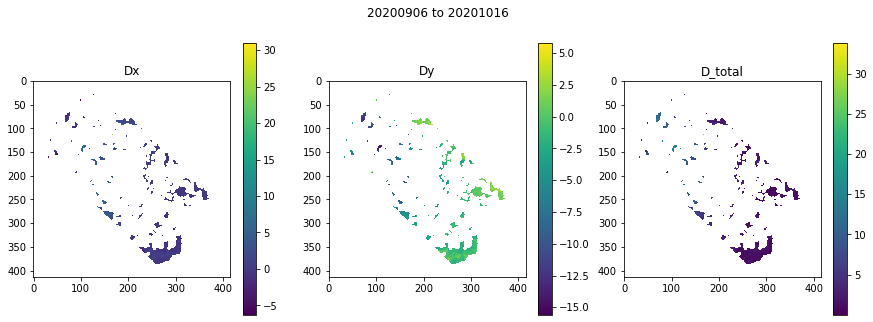

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.369675874710083
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

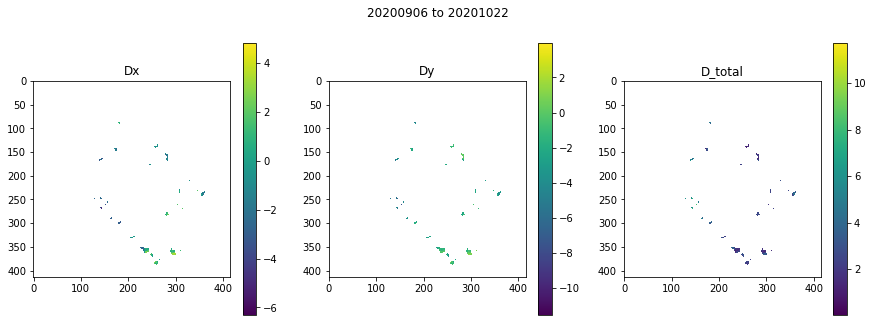

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05888104438781738
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

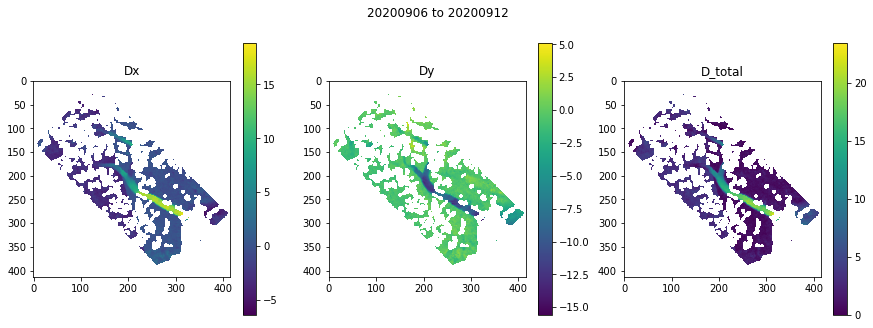

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05315208435058594
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

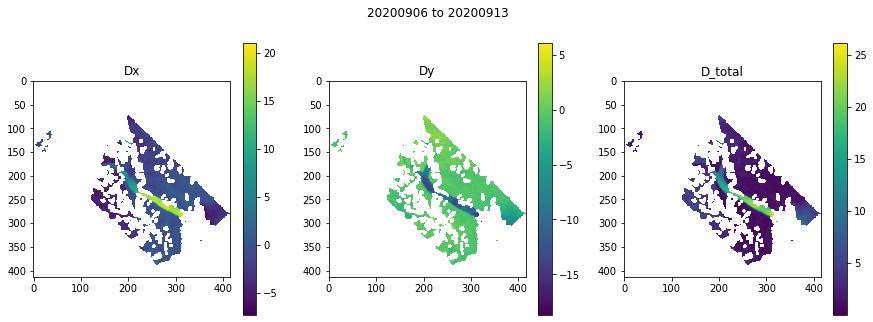

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3466019630432129
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

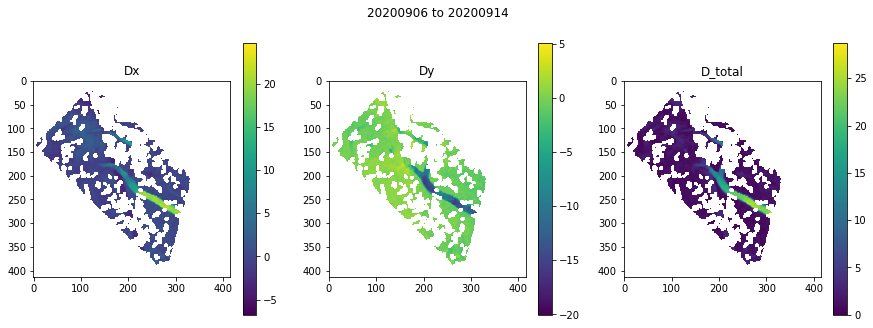

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.36023402214050293
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

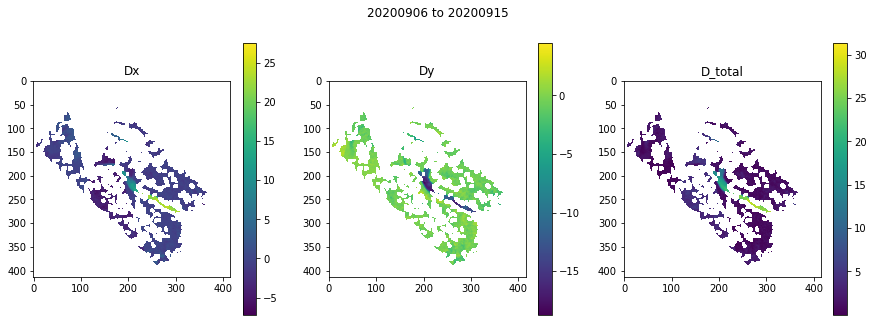

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05479288101196289
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

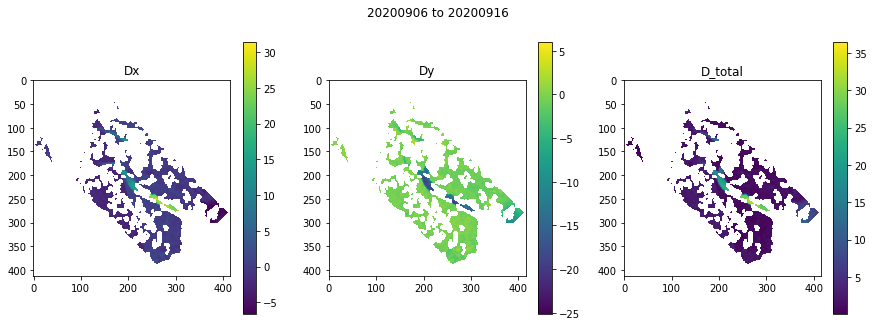

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.059394121170043945
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

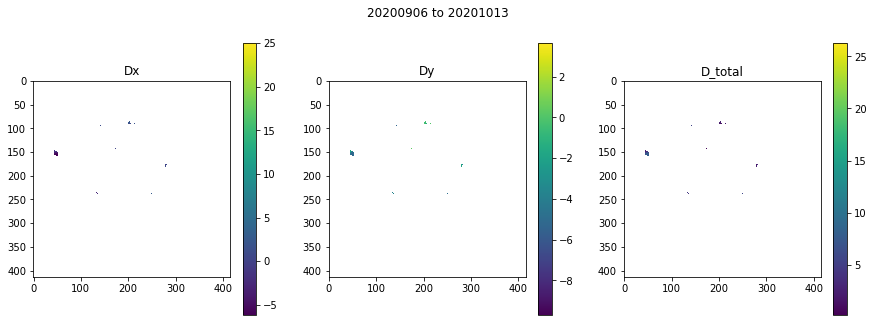

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05855989456176758
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

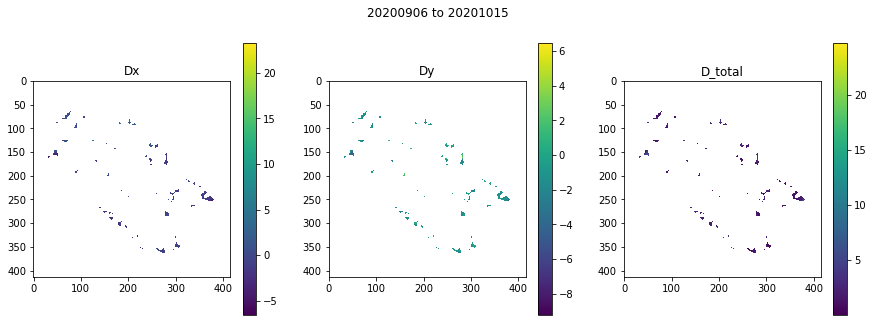

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05968213081359863
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

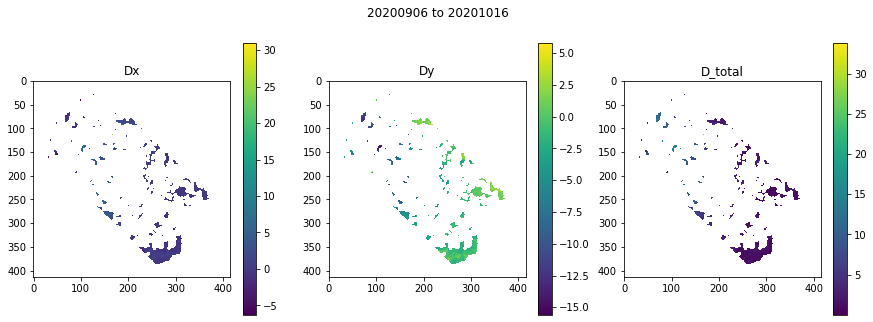

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.052516937255859375
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

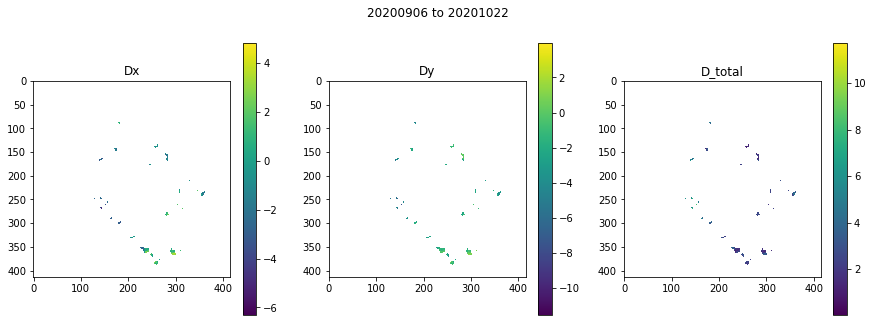

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05880904197692871
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

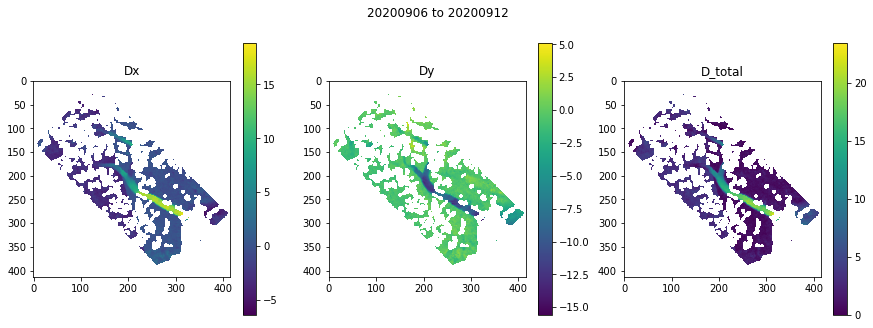

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.053105831146240234
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

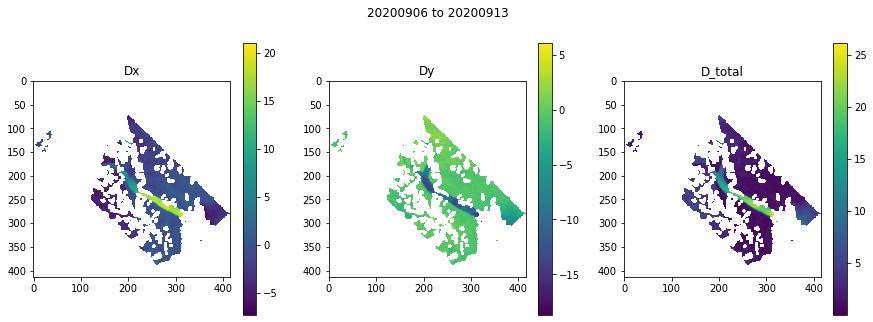

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05392169952392578
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

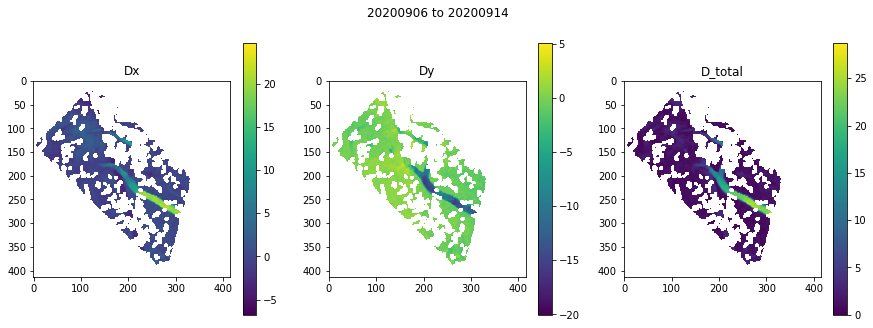

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05511593818664551
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

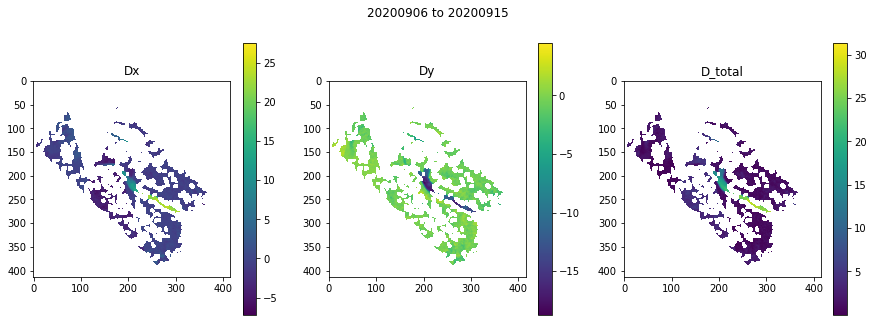

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05429196357727051
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

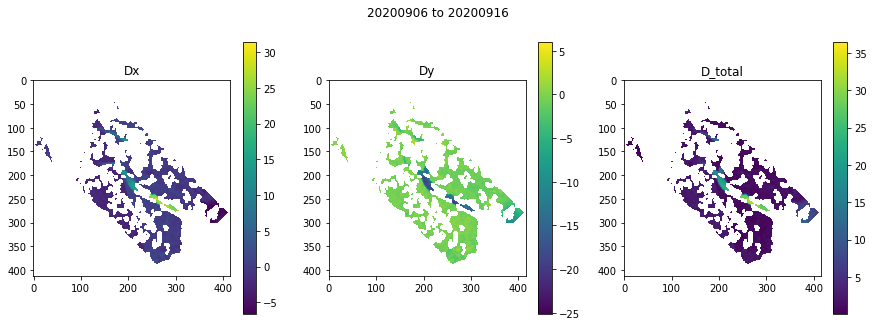

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.052989959716796875
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

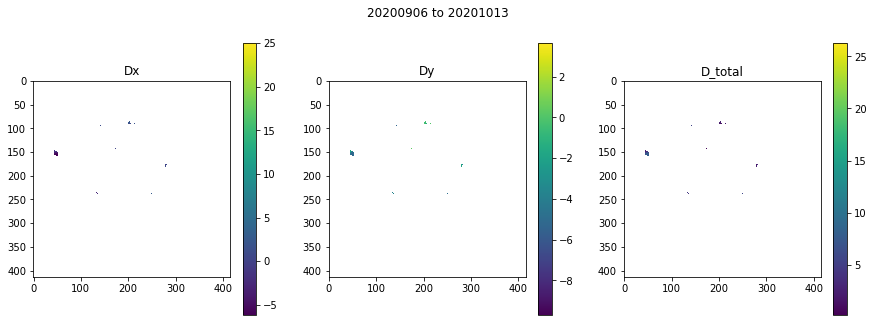

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0541839599609375
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

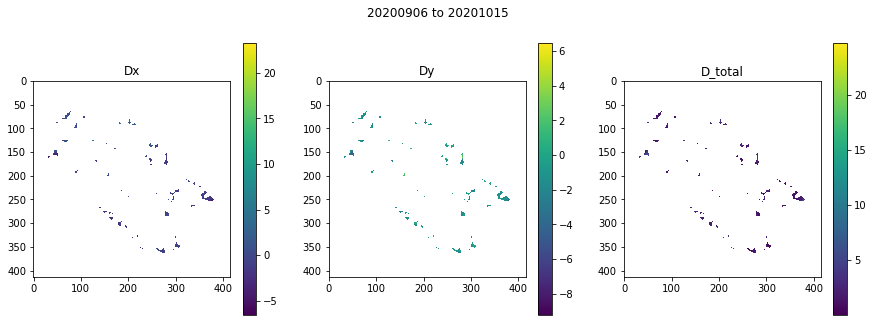

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05380392074584961
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

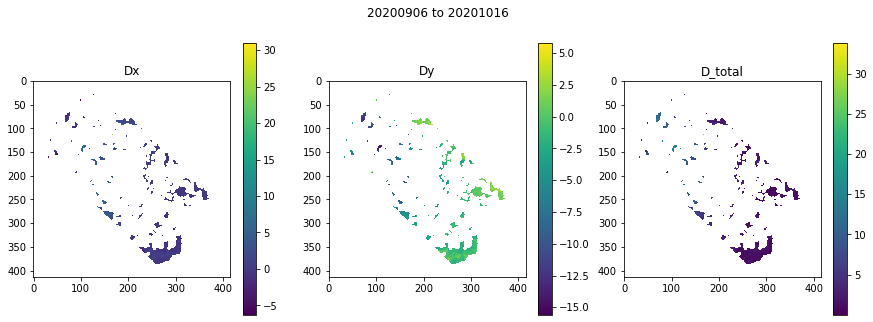

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05301618576049805
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

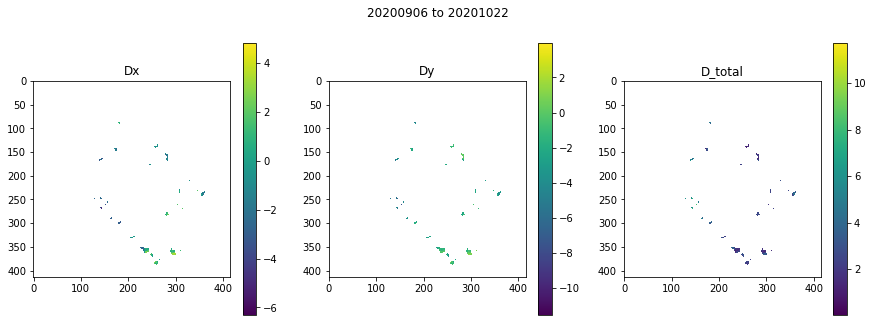

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06850695610046387
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

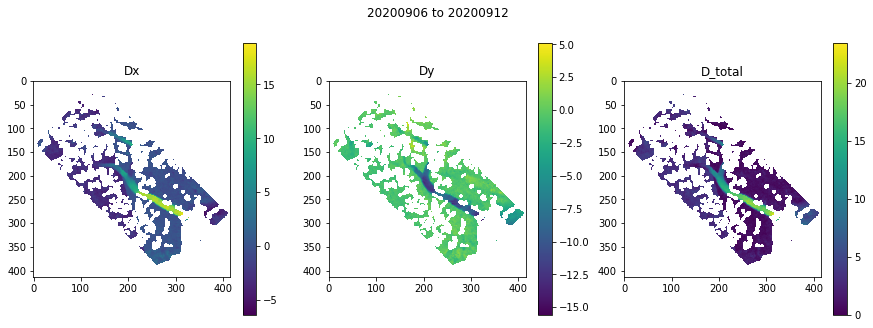

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05289793014526367
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

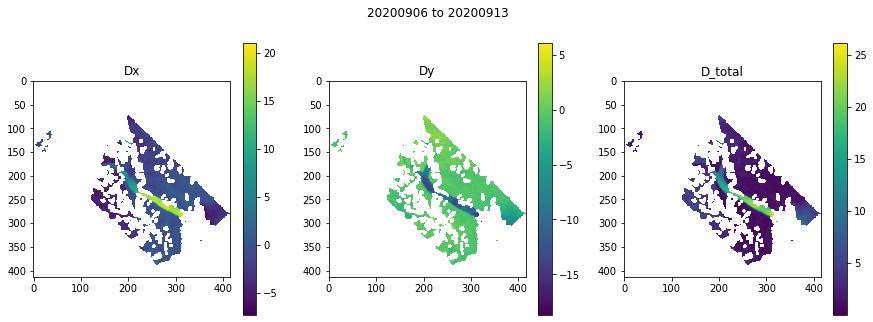

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.055371999740600586
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

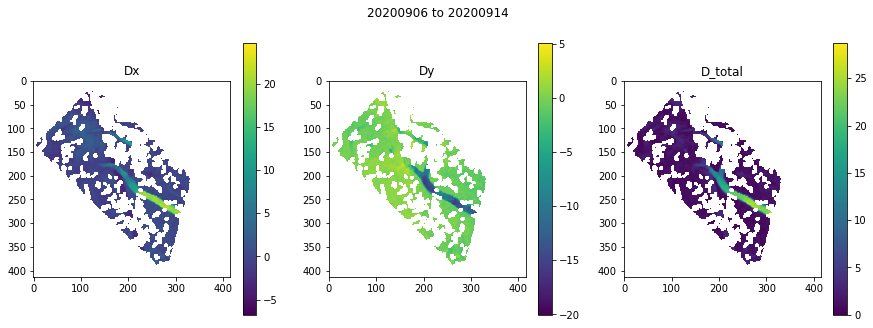

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05465197563171387
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

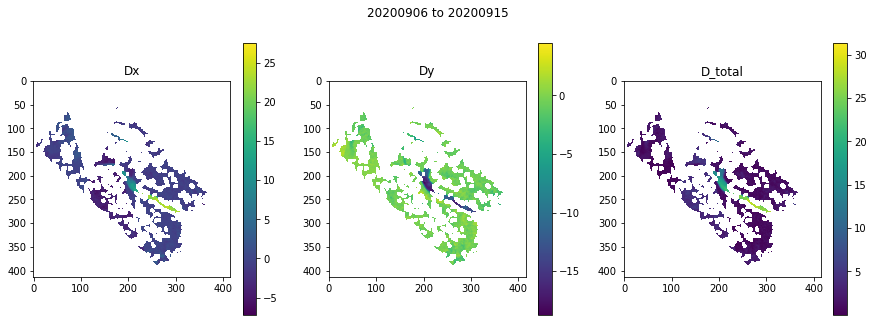

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06305813789367676
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

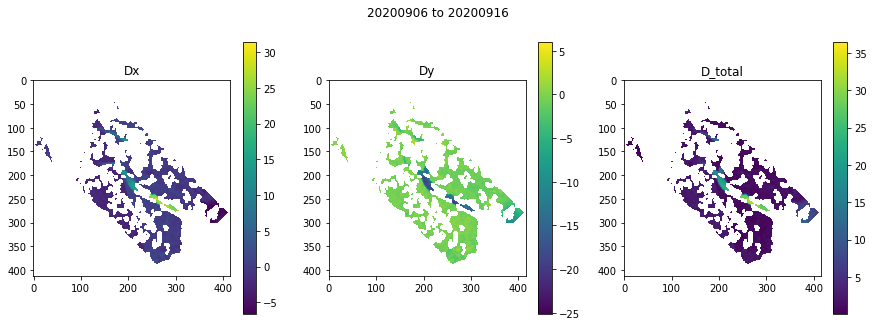

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05983424186706543
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

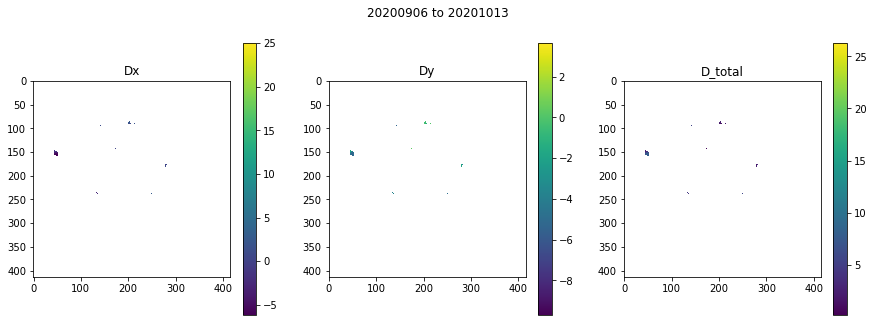

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05800223350524902
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

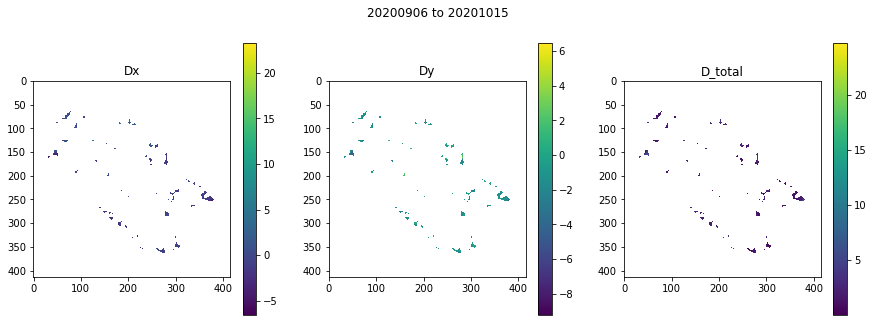

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.055394887924194336
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

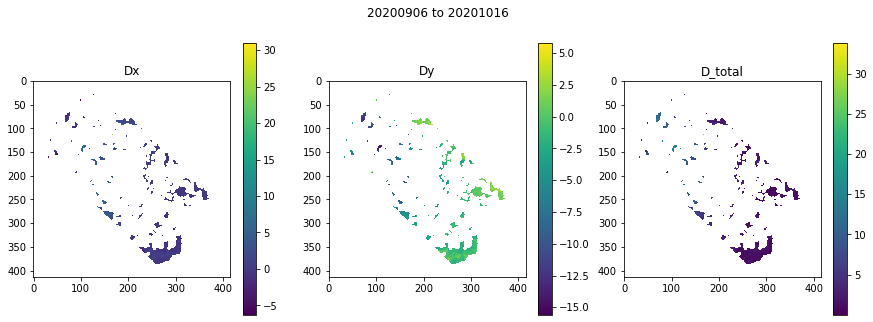

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.054006099700927734
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

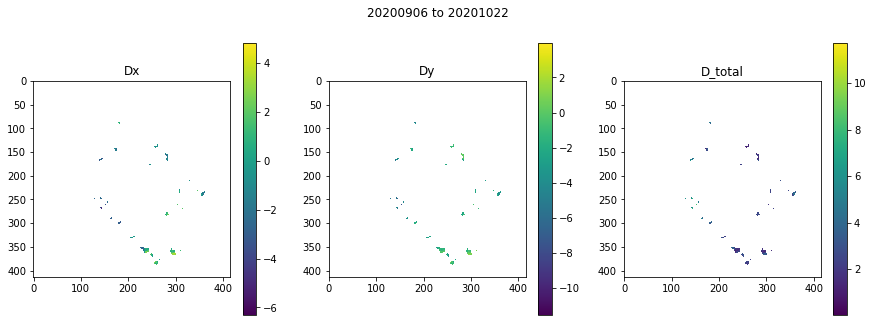

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05391573905944824
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

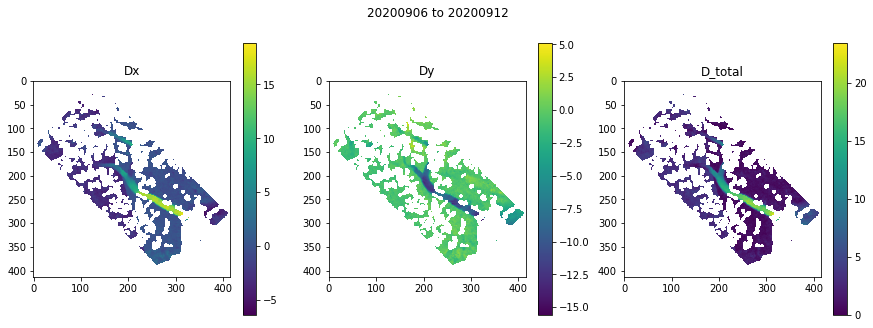

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05447793006896973
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

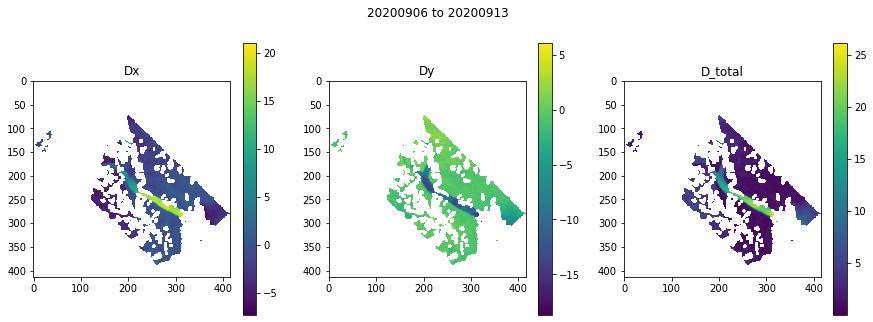

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.052541255950927734
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

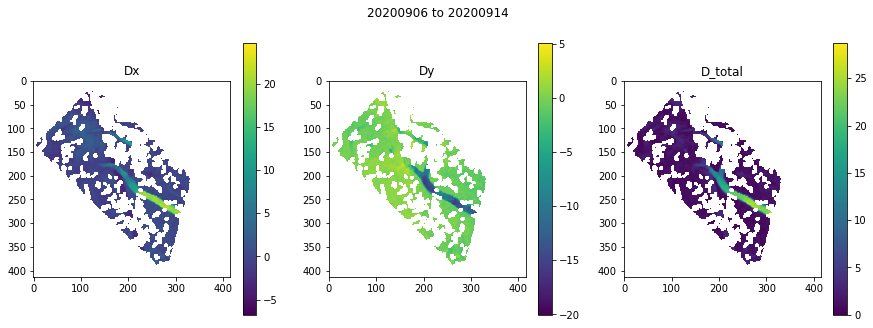

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06136488914489746
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

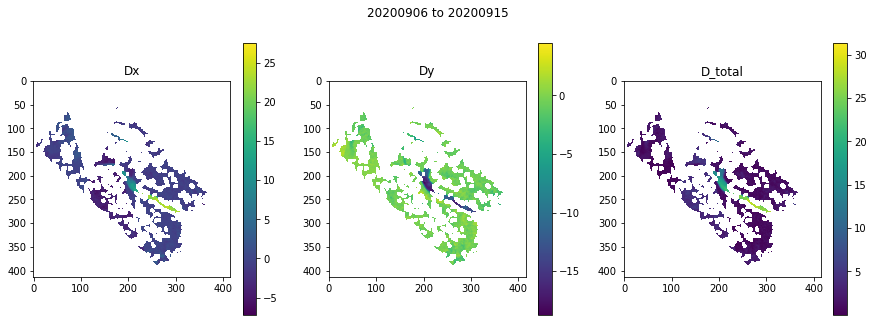

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.053526878356933594
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

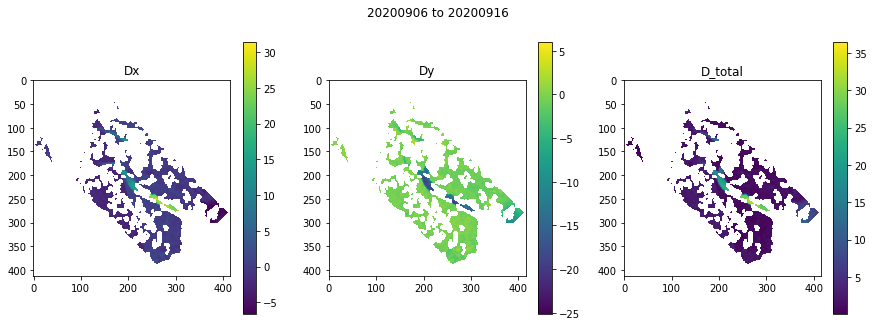

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05608725547790527
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

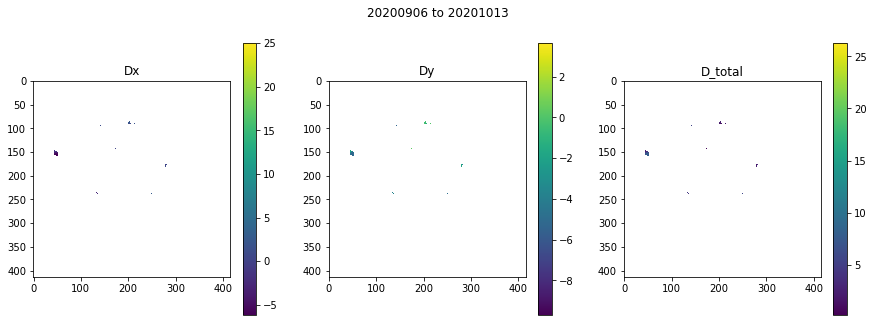

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.056729793548583984
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

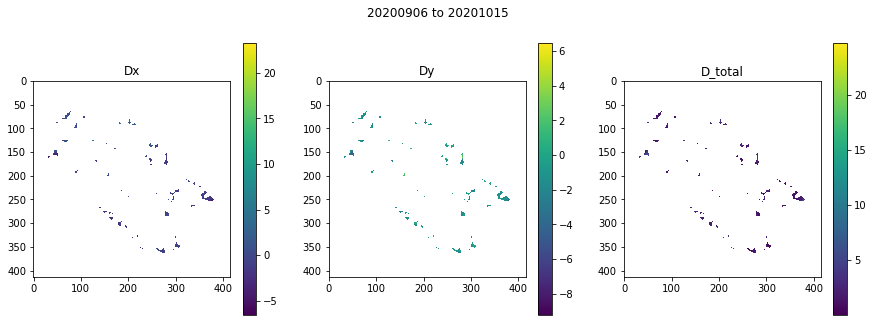

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05529022216796875
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

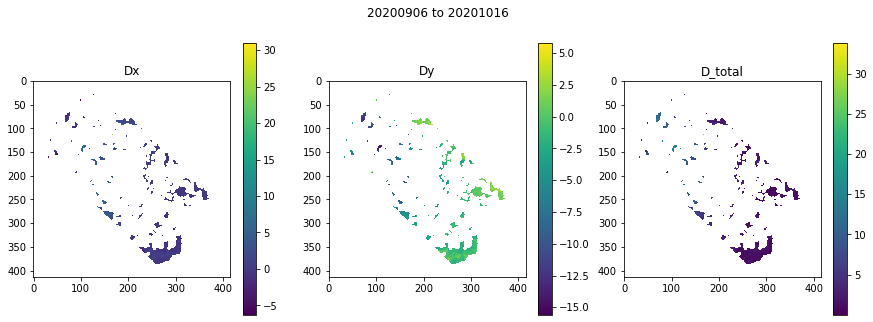

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05244874954223633
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 100
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_100m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

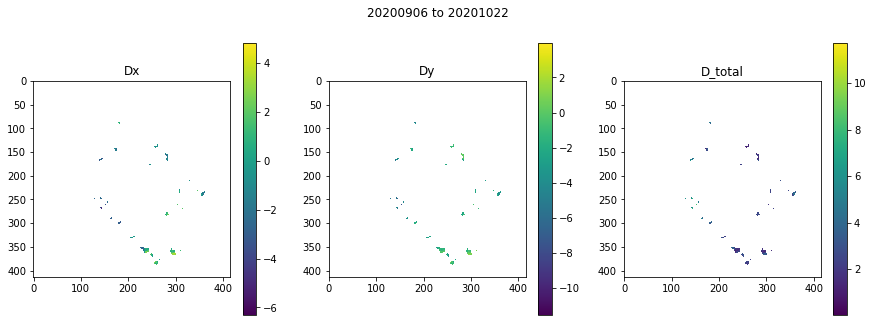

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05510997772216797
IfSAR_200m_DSM_clipped.tif  already exists.
IfSAR_200m_DSM_clipped_dhdy.tif and IfSAR_200m_DSM_clipped_dhdx.tif already exist.
vx_200m.tif , vy_200m.tif , srx_200m.tif , sry_200m.tif already exist.
ssm_200m.tif and TG_mask_200m.tif already exist.
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490

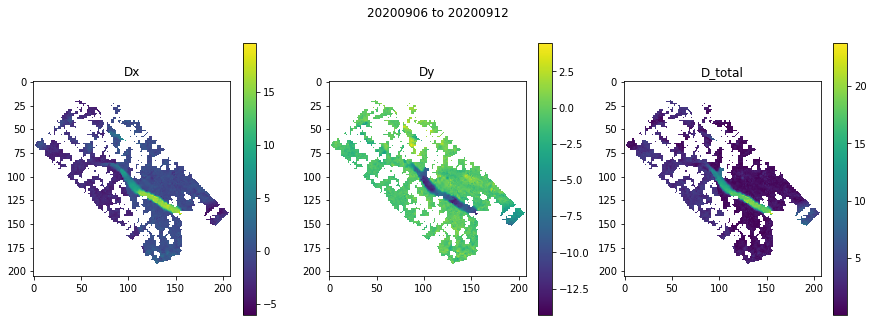

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
1.0520961284637451
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

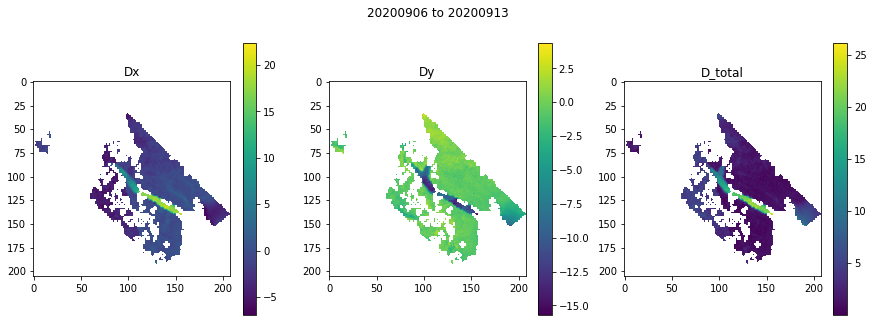

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018455028533935547
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

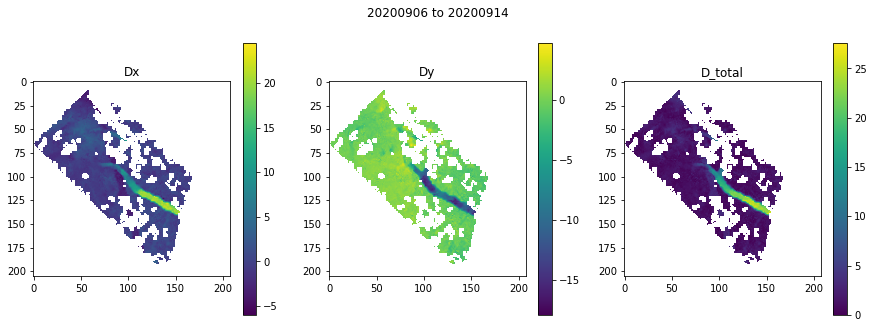

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018352031707763672
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

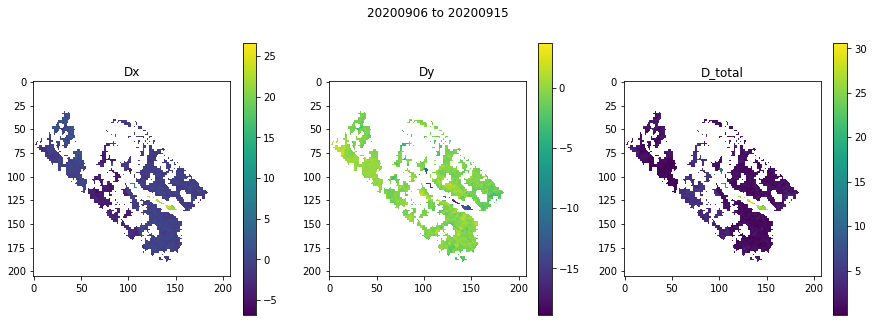

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018950223922729492
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

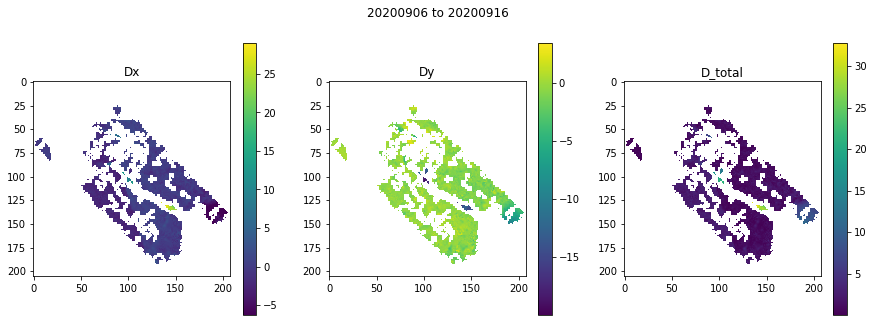

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01739025115966797
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

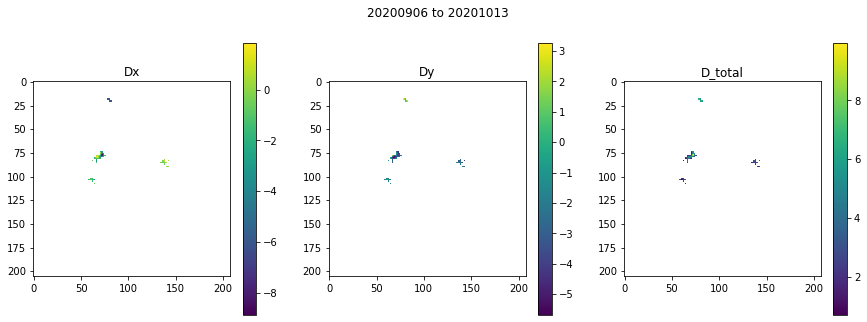

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0202639102935791
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

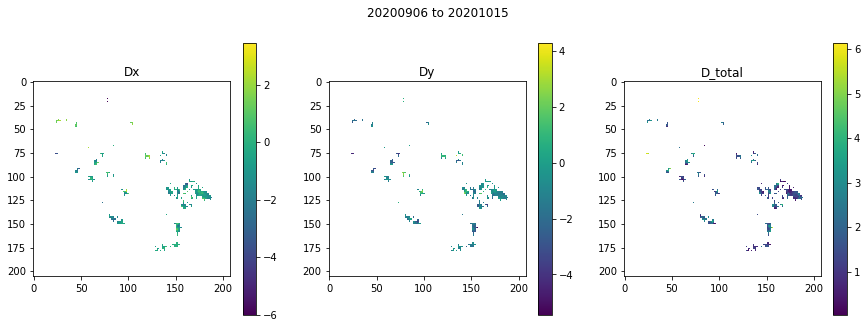

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0179440975189209
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

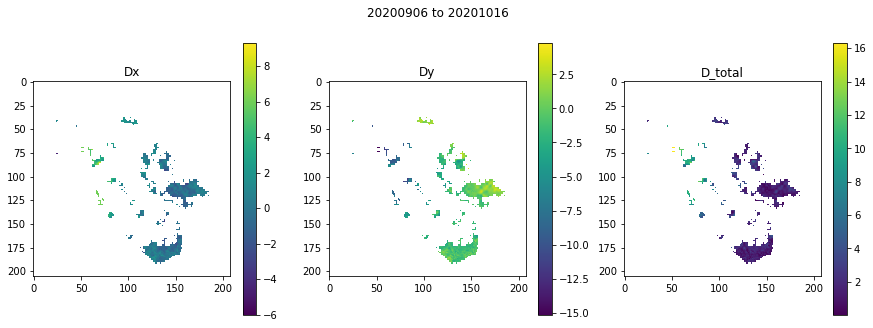

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02144002914428711
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

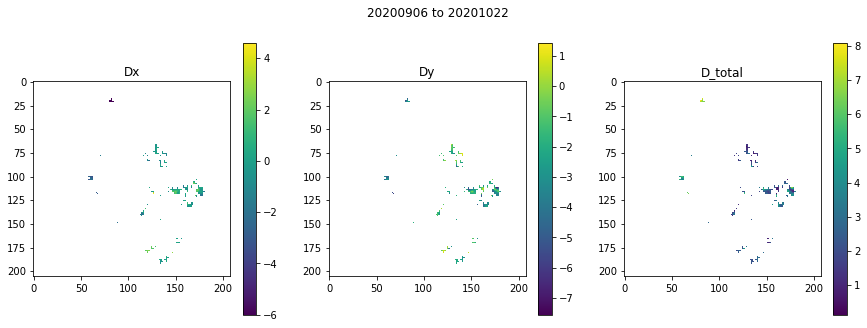

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016772747039794922
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

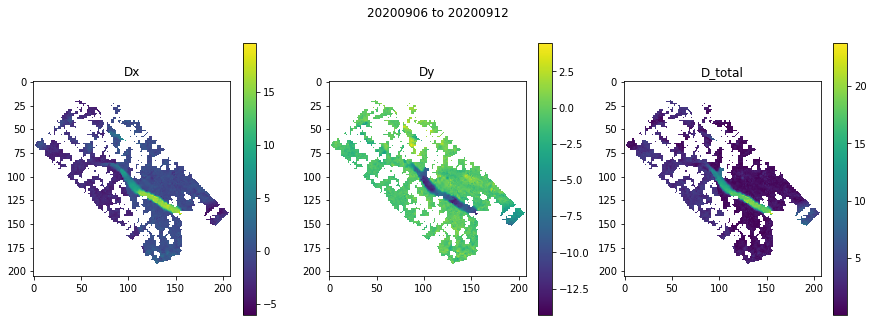

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02323126792907715
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

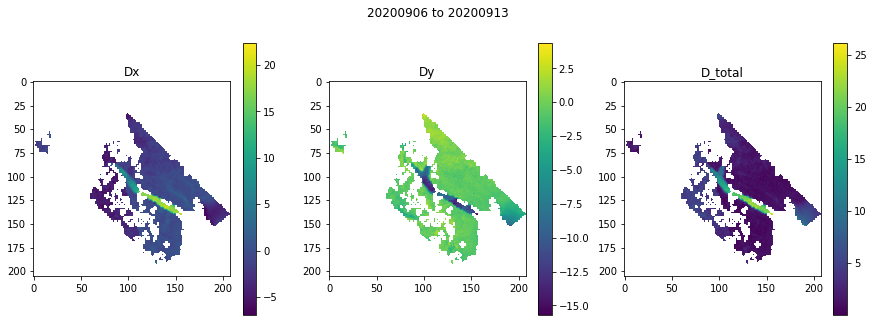

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016741037368774414
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

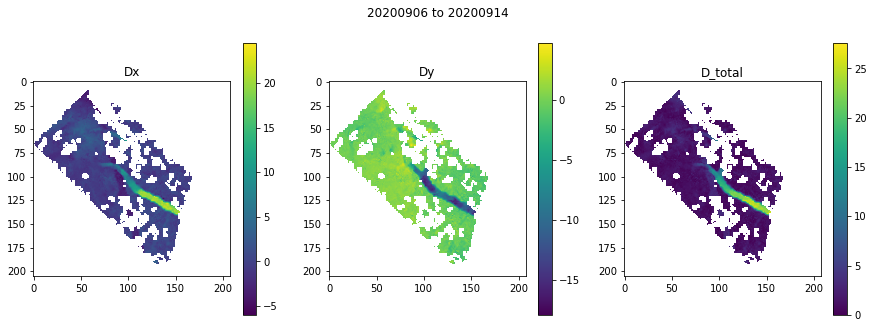

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018117904663085938
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

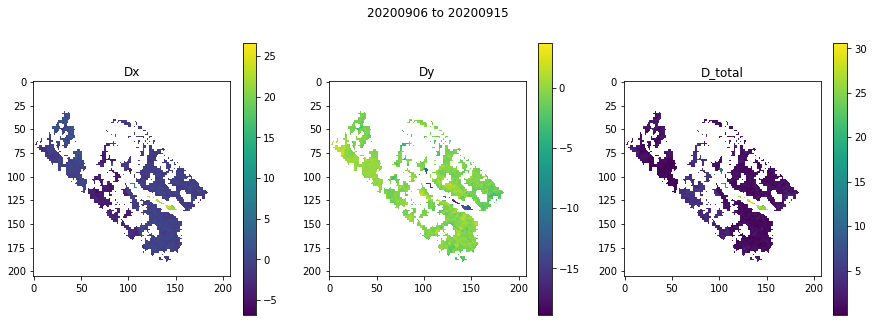

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018873214721679688
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

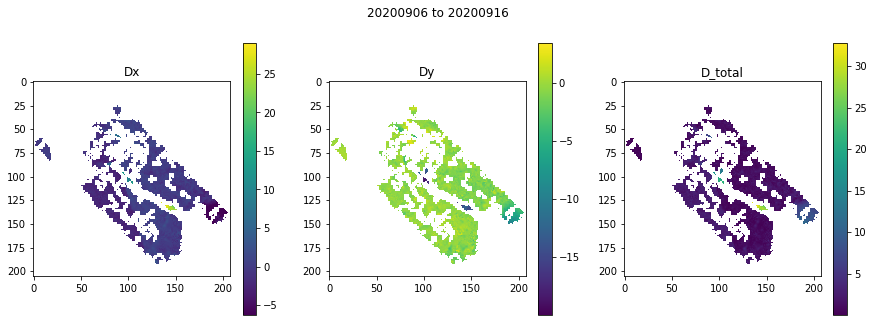

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018362760543823242
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

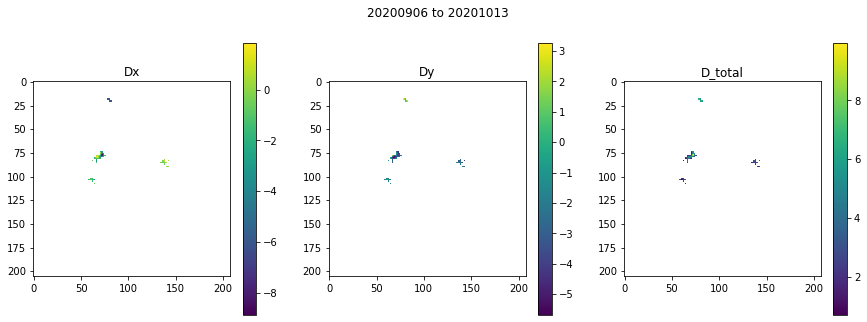

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017889022827148438
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

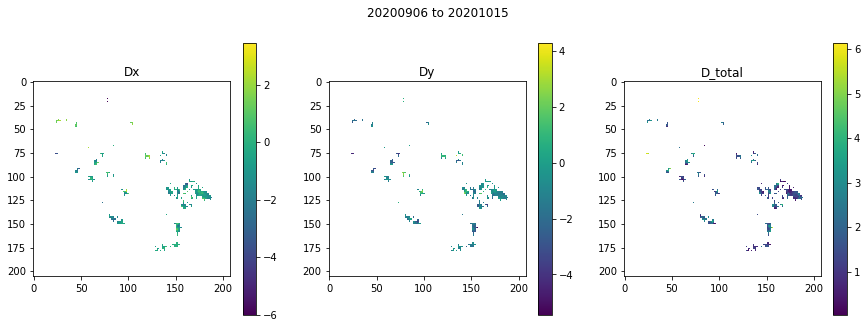

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020426034927368164
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

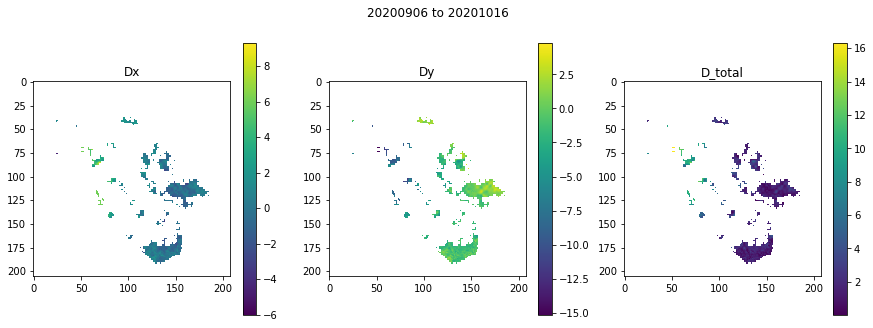

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019042015075683594
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

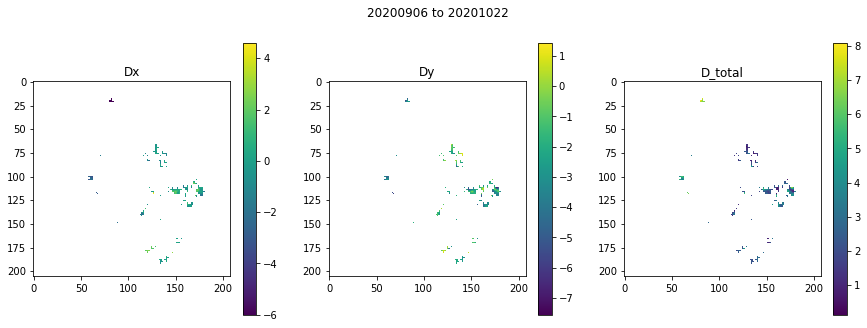

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02104496955871582
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

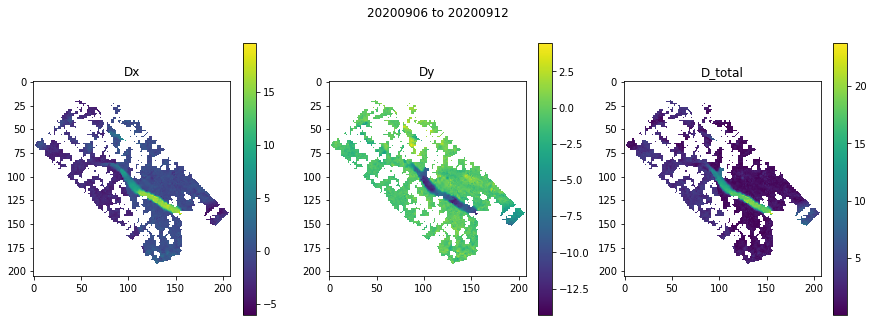

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016969919204711914
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

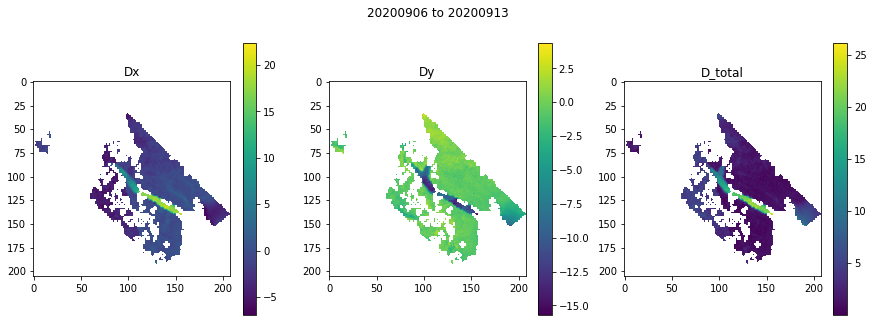

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023392200469970703
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

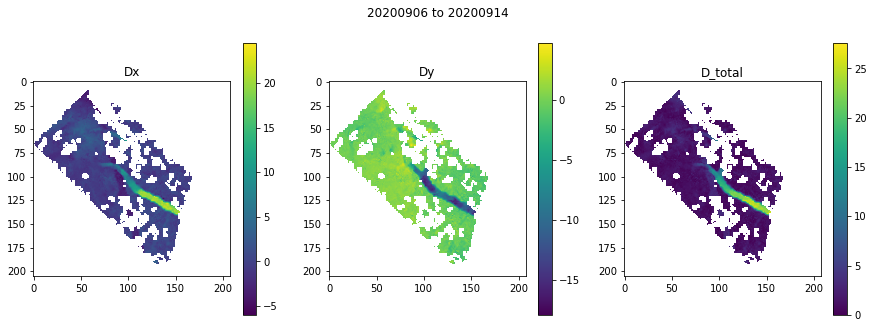

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019163131713867188
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

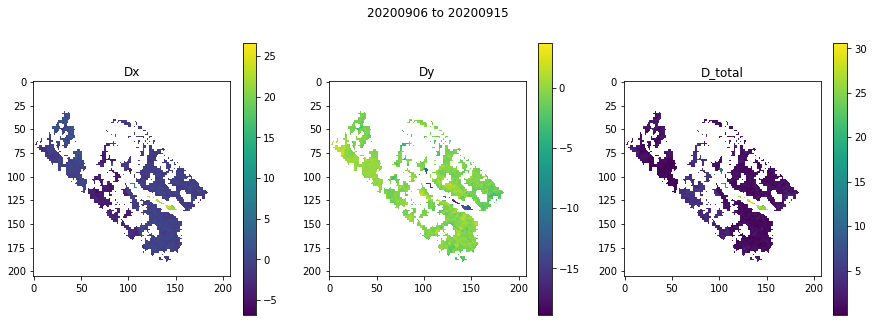

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016541004180908203
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

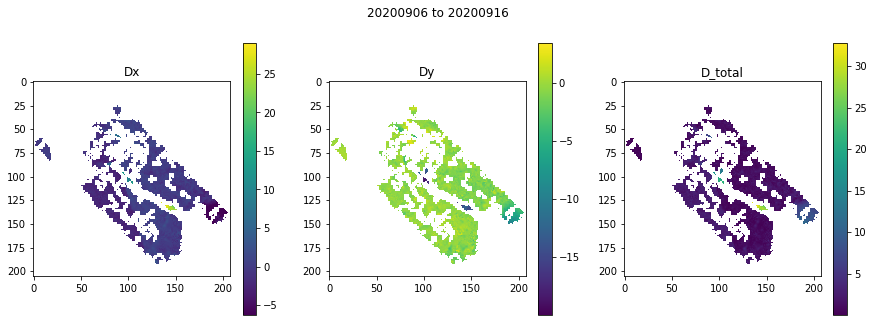

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018141984939575195
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

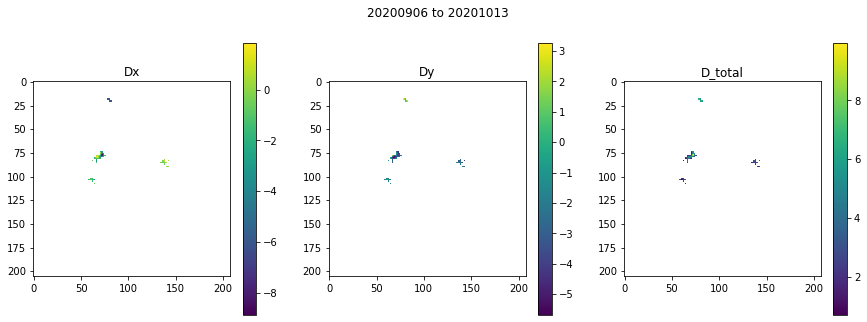

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.022023916244506836
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

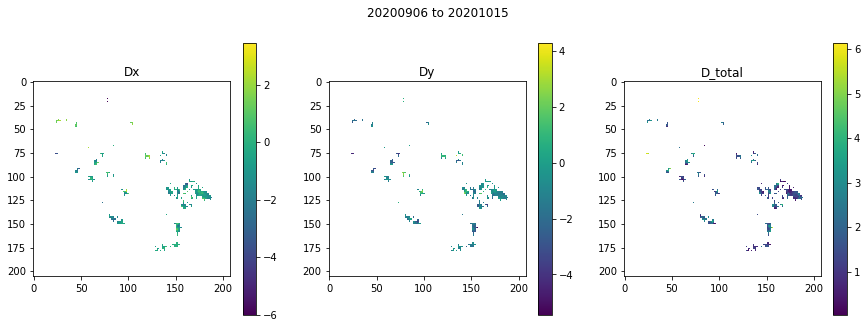

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01731586456298828
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

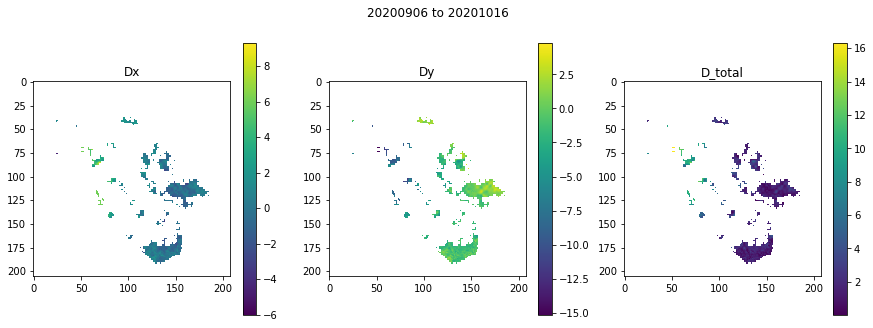

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01868915557861328
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

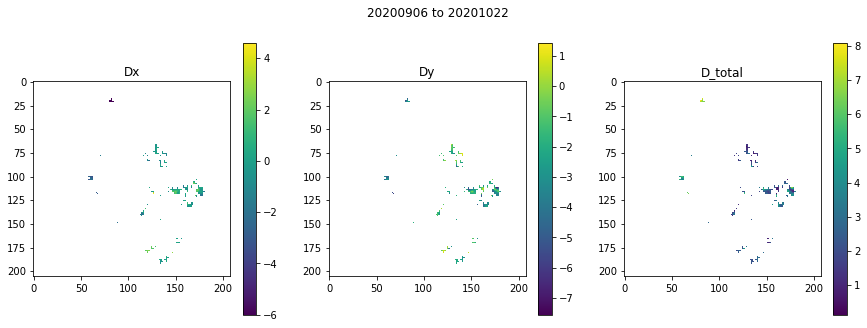

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021358013153076172
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

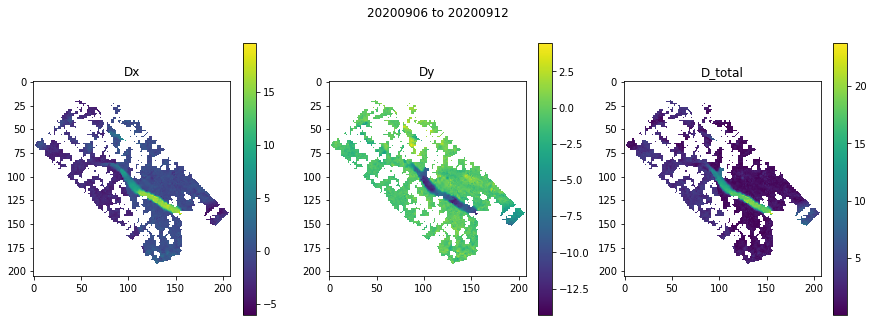

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019709348678588867
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

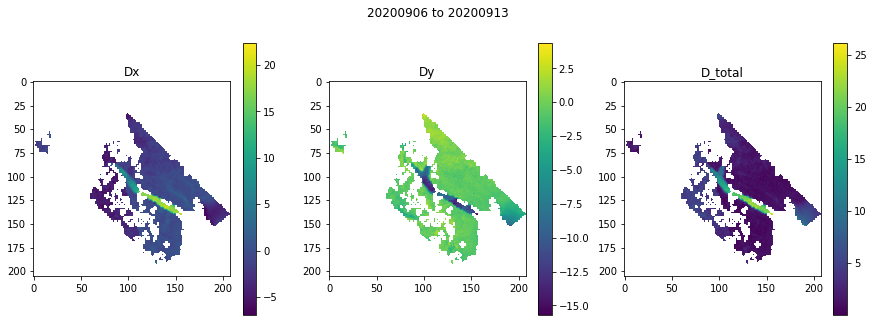

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02284693717956543
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

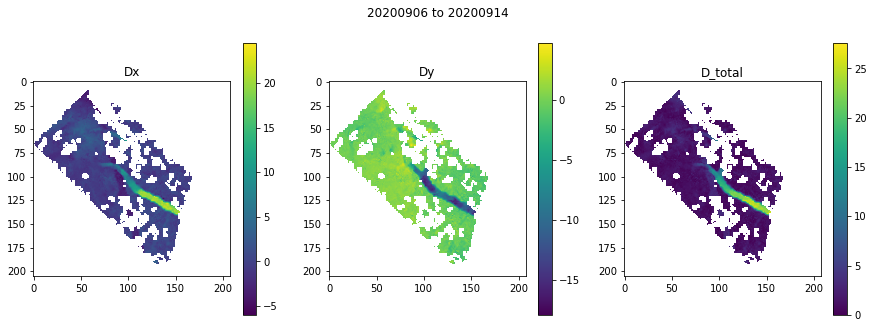

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02649402618408203
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

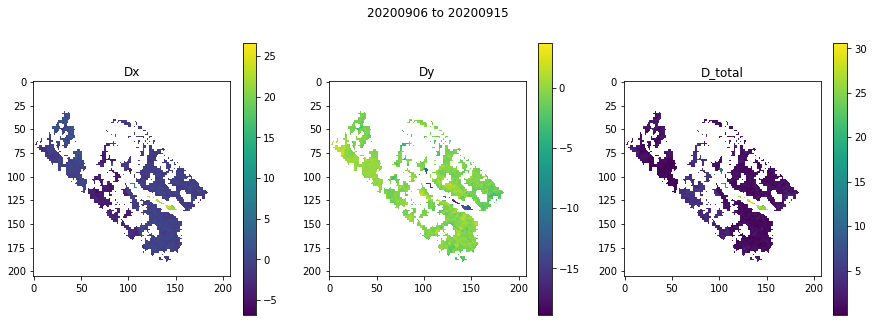

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018596887588500977
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

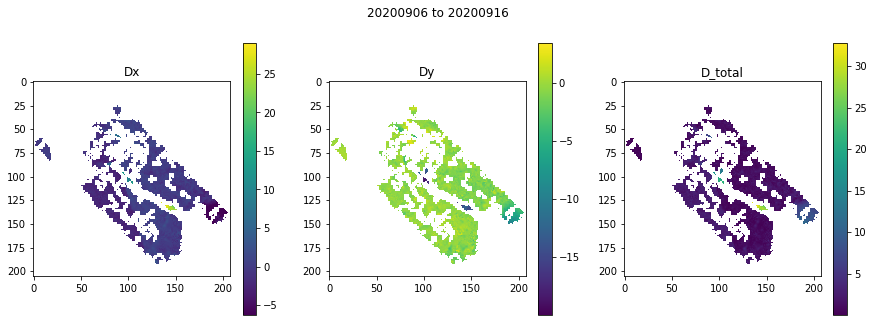

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01700901985168457
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

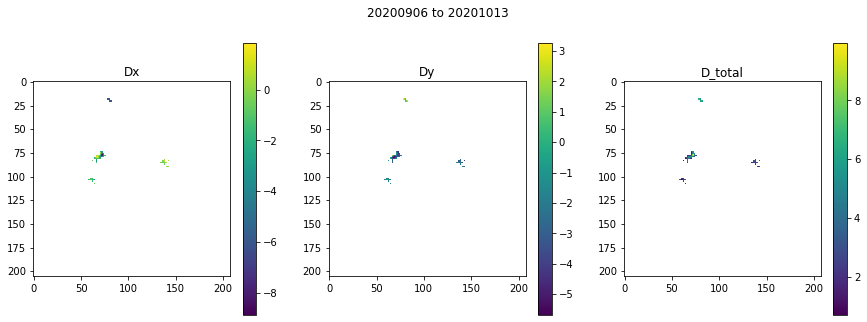

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0202639102935791
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

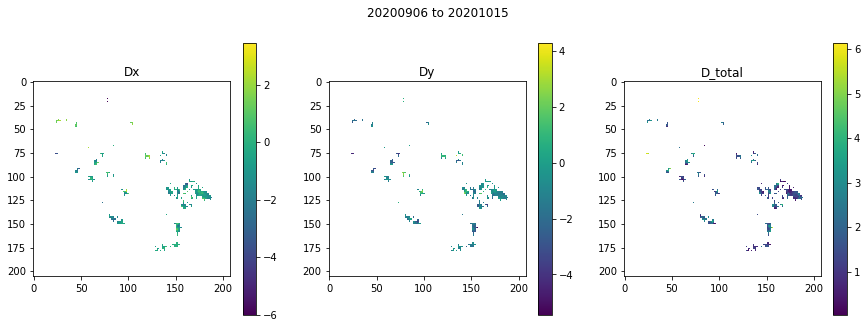

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023662805557250977
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

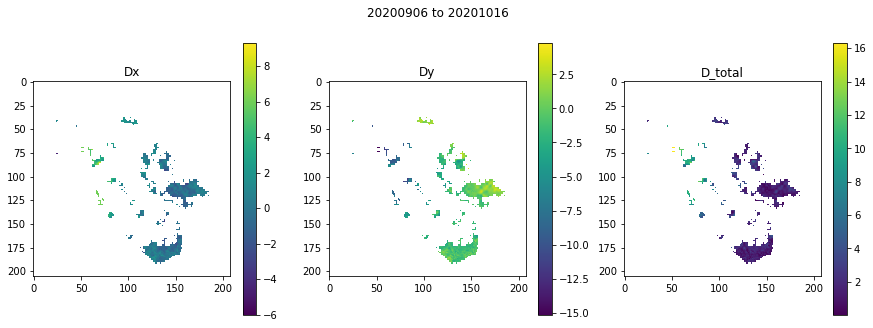

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018429279327392578
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

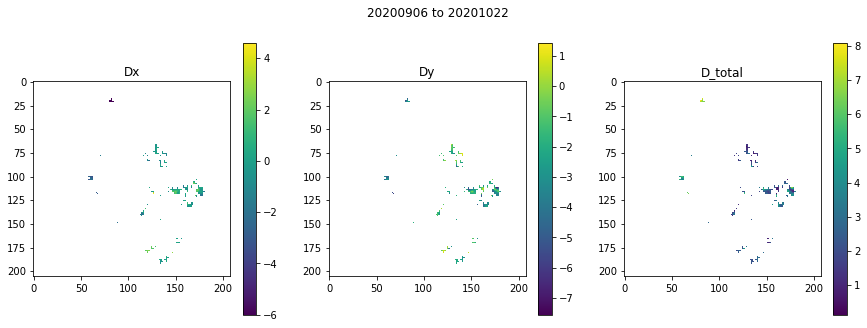

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017441987991333008
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

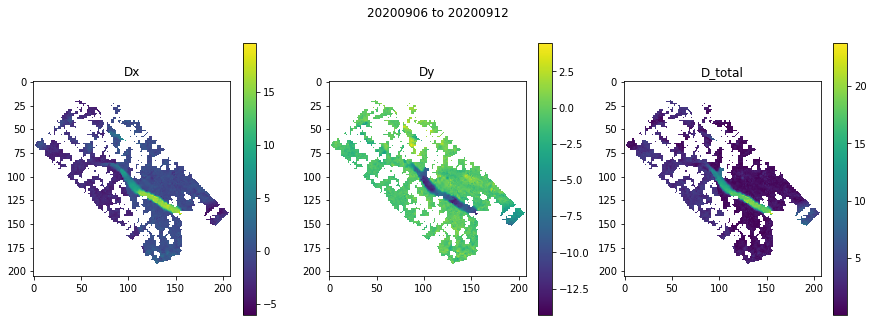

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018040895462036133
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

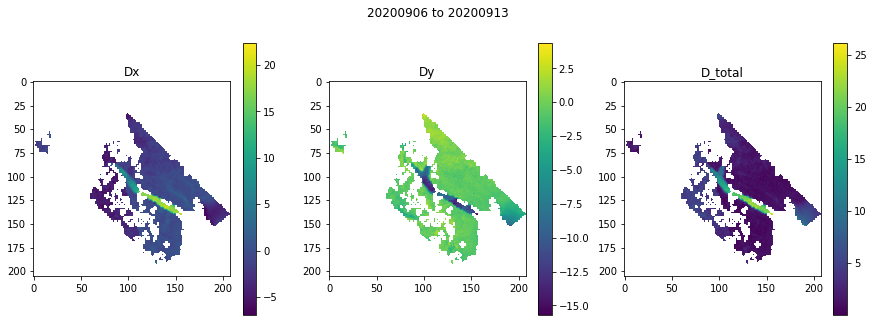

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018887996673583984
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

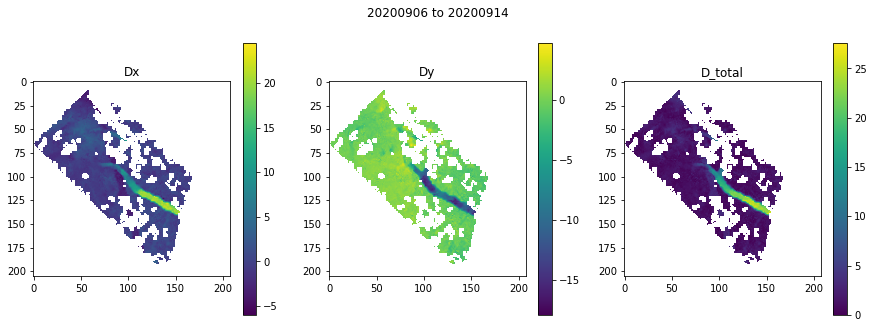

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018455028533935547
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

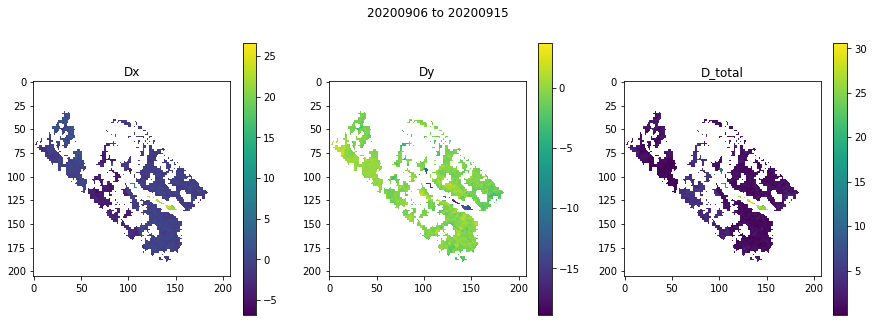

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02165818214416504
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

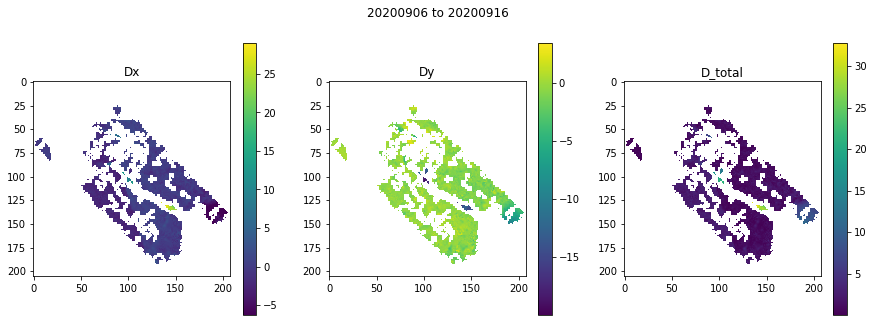

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01850104331970215
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

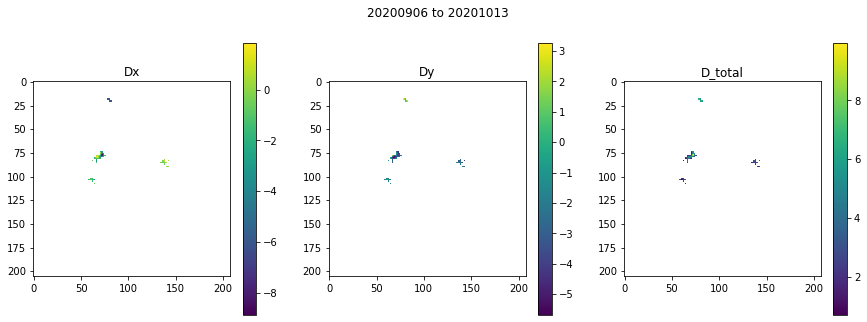

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017795085906982422
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

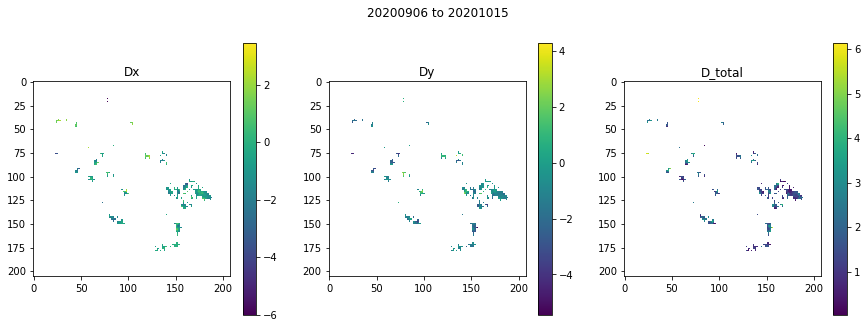

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018803119659423828
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

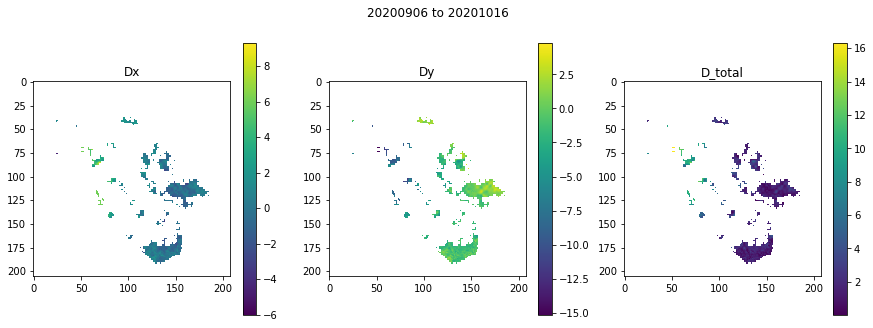

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018599987030029297
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

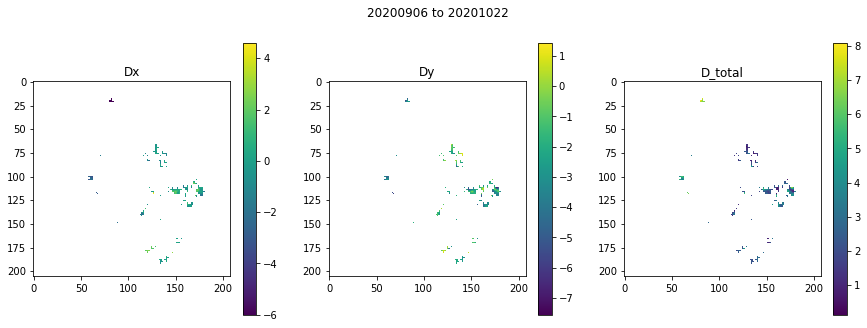

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3552970886230469
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

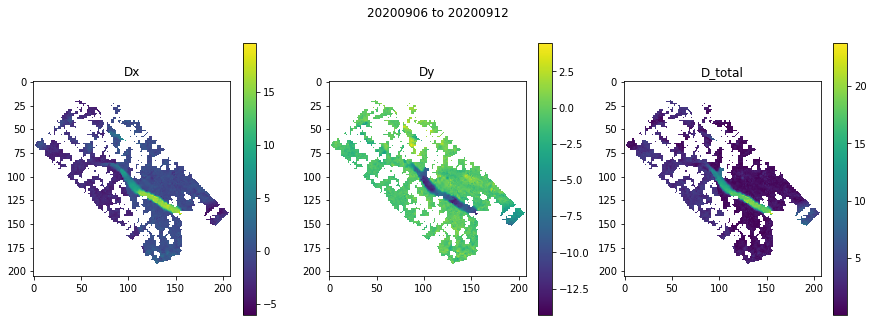

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.32196617126464844
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

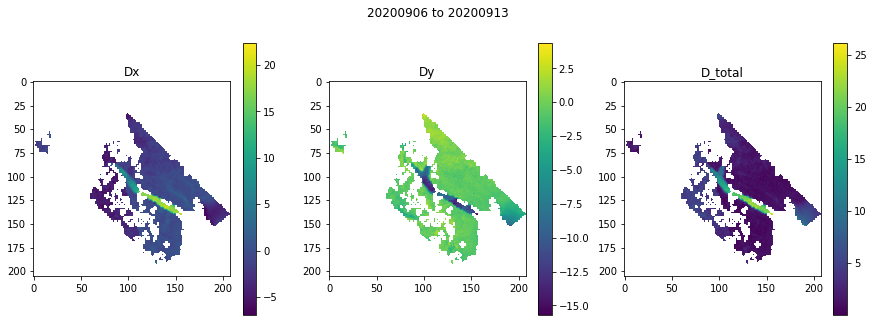

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018217802047729492
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

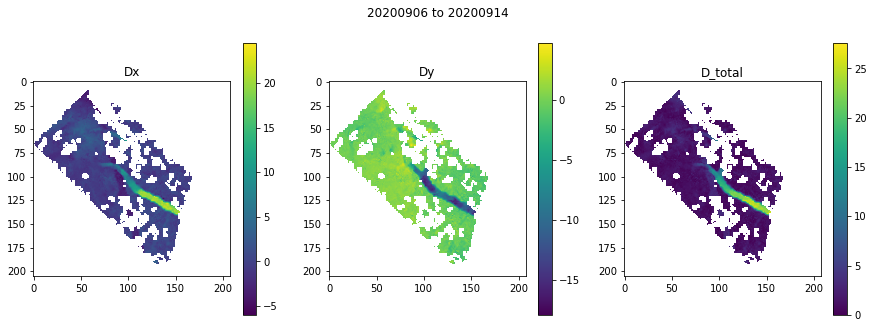

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.025358200073242188
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

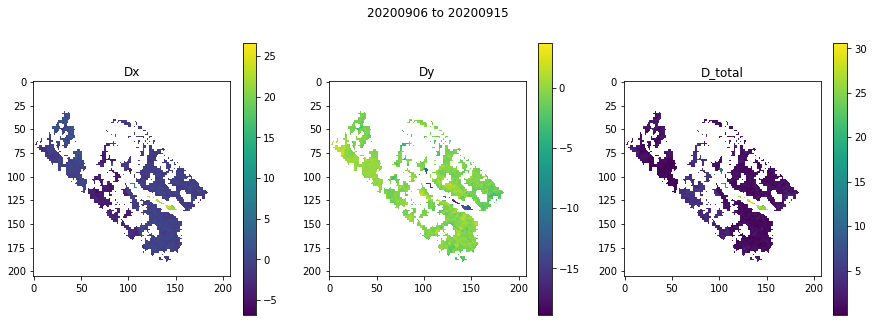

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018663883209228516
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

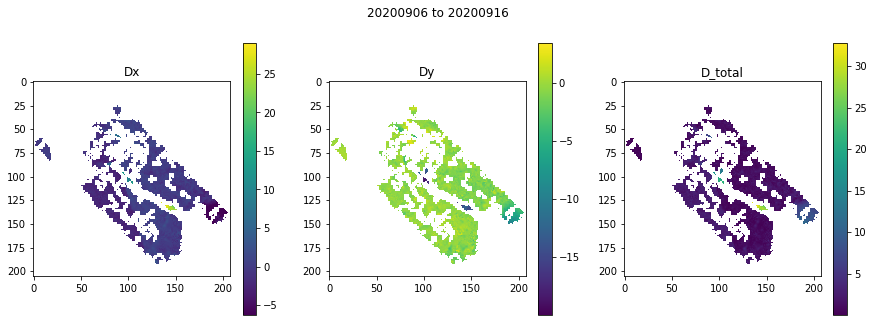

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01713109016418457
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

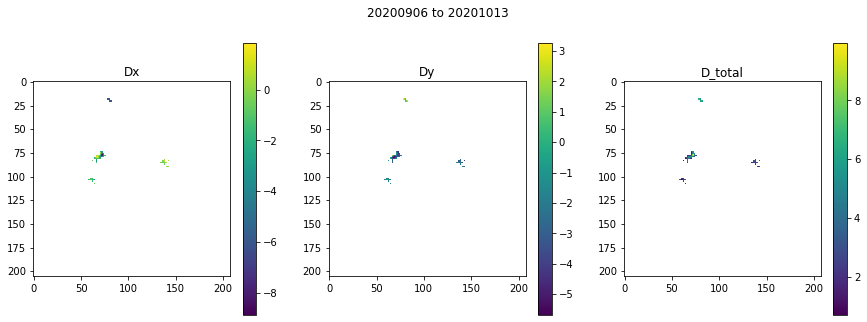

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023908138275146484
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

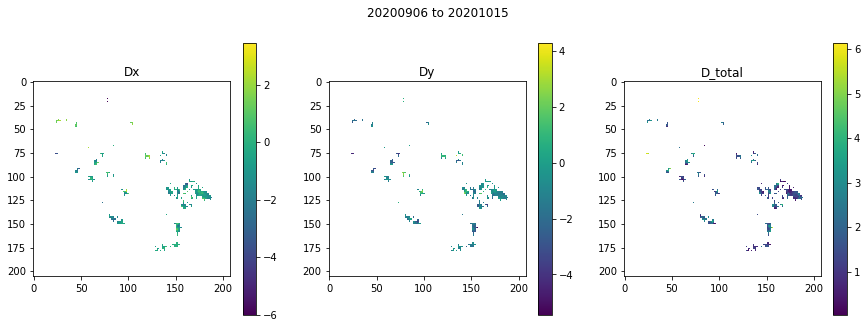

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018740177154541016
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

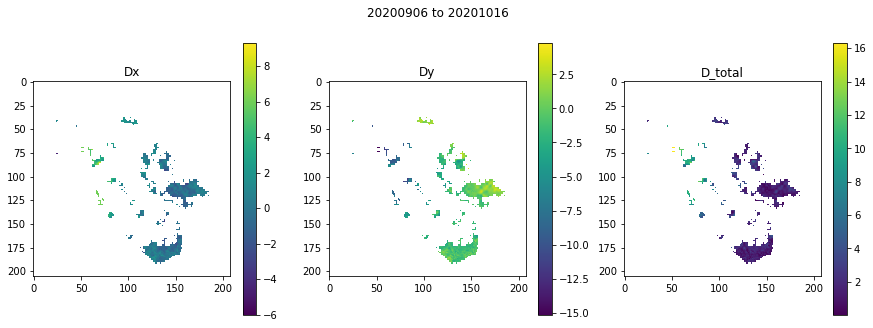

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017463207244873047
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

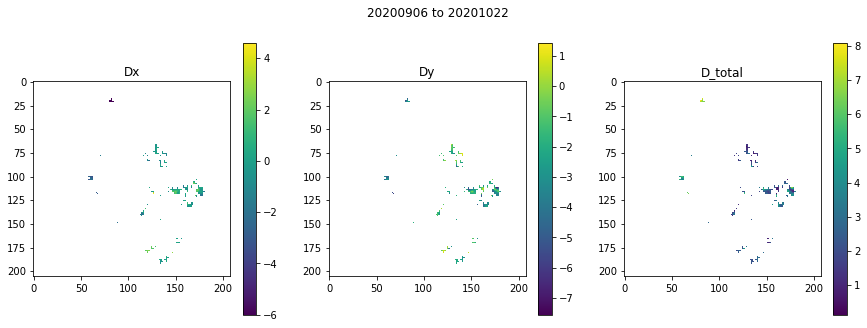

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018690109252929688
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

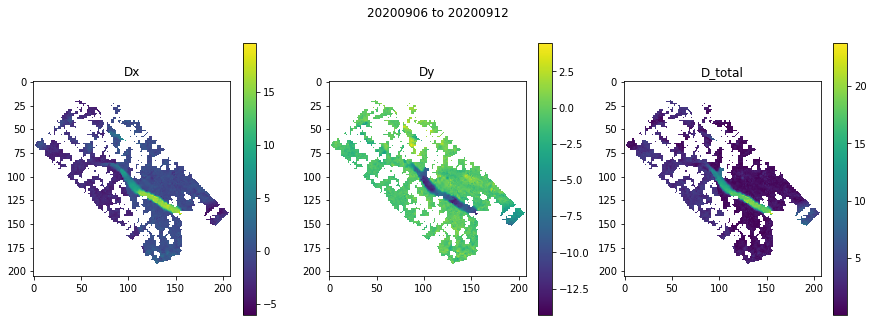

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017773866653442383
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

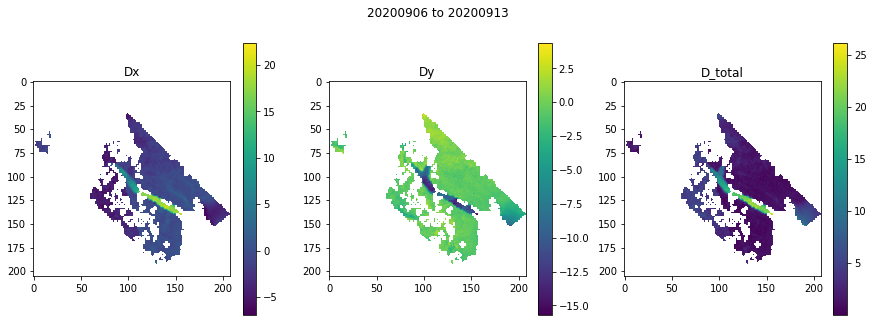

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018199920654296875
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

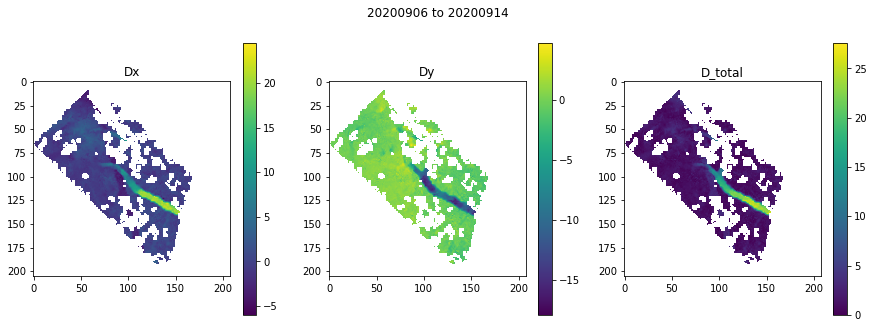

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018026351928710938
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

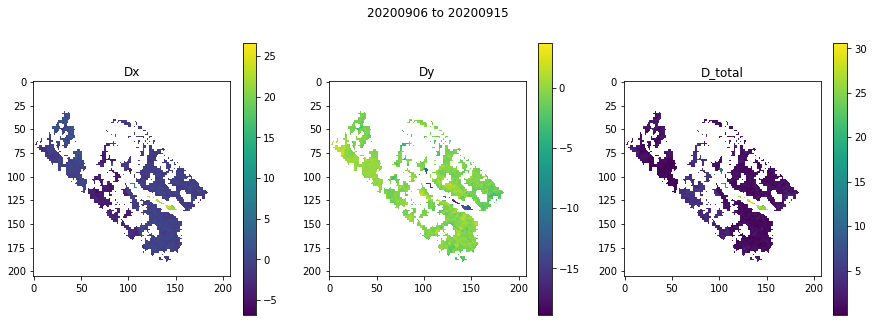

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018718957901000977
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

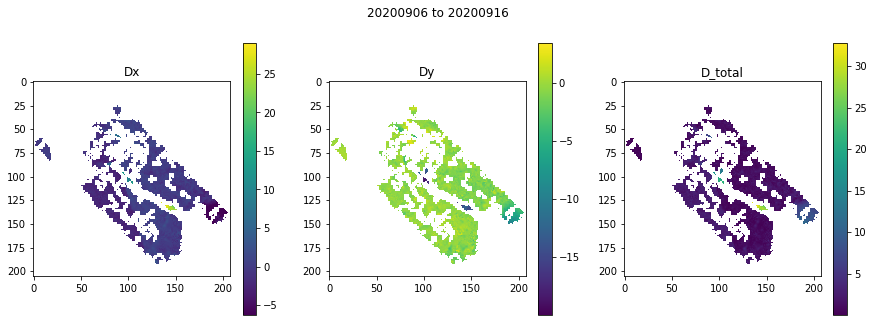

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018657922744750977
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

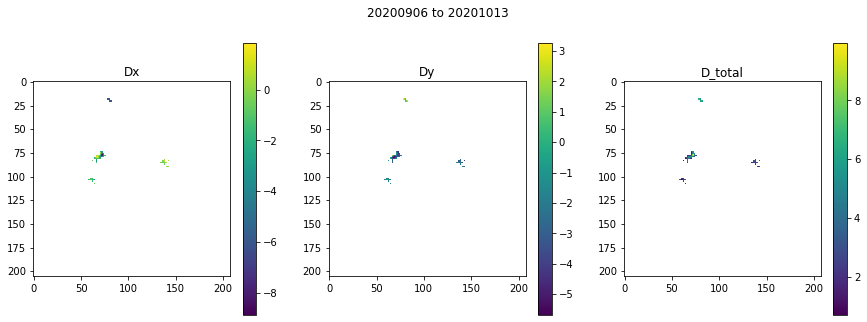

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016912221908569336
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

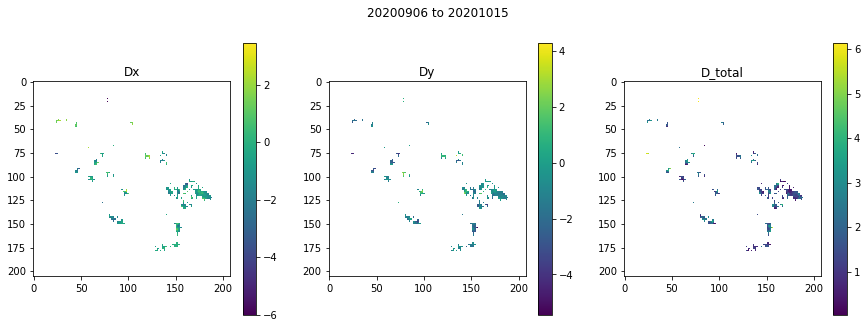

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018413066864013672
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

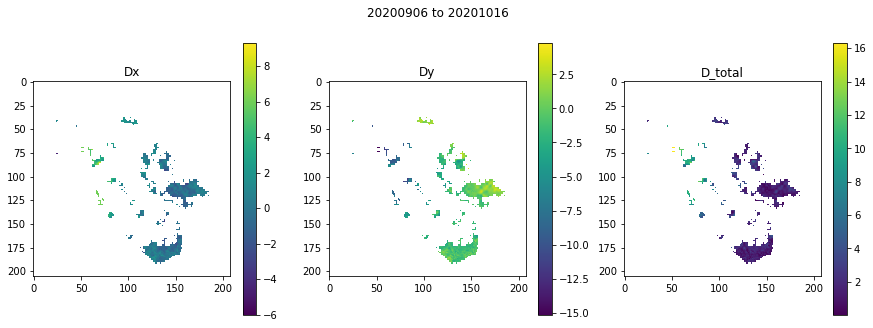

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019219160079956055
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

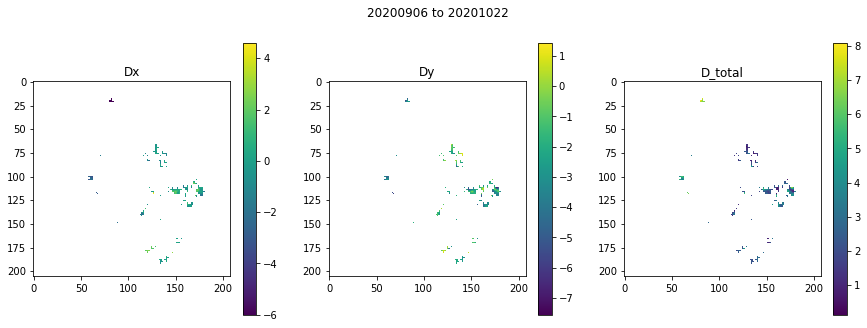

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017521142959594727
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

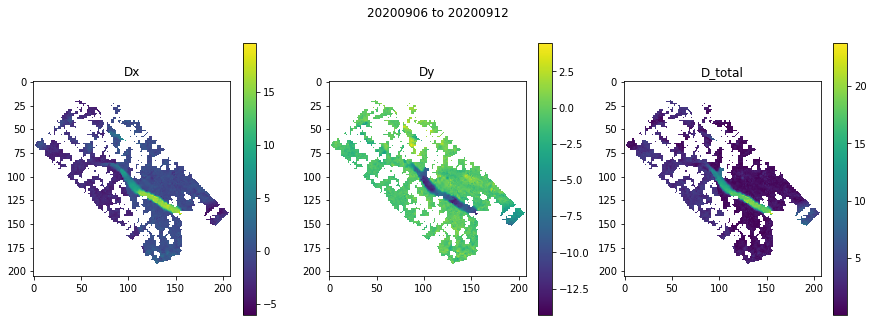

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019006967544555664
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

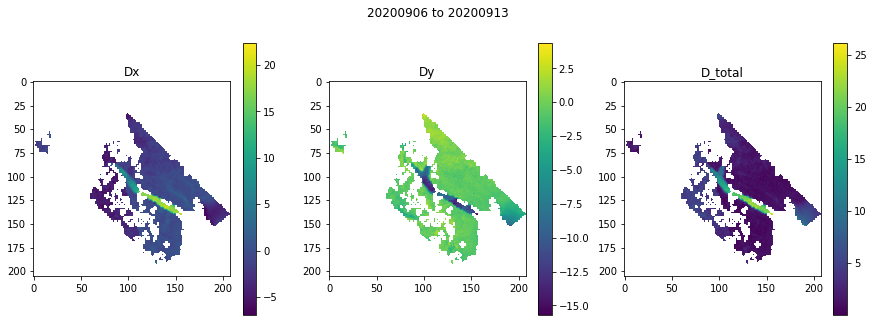

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023176908493041992
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

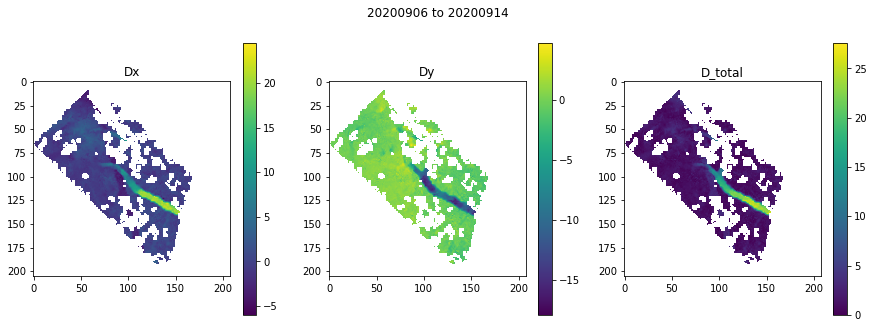

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019134998321533203
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

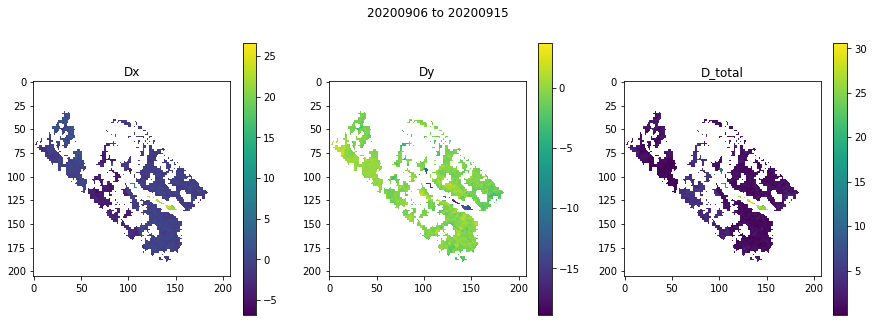

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020295143127441406
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

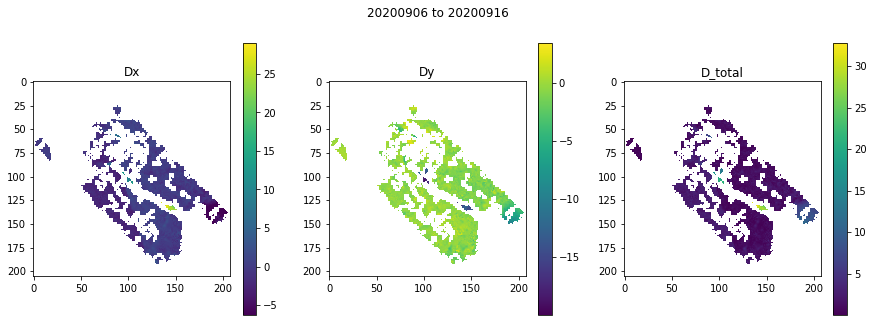

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.024415016174316406
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

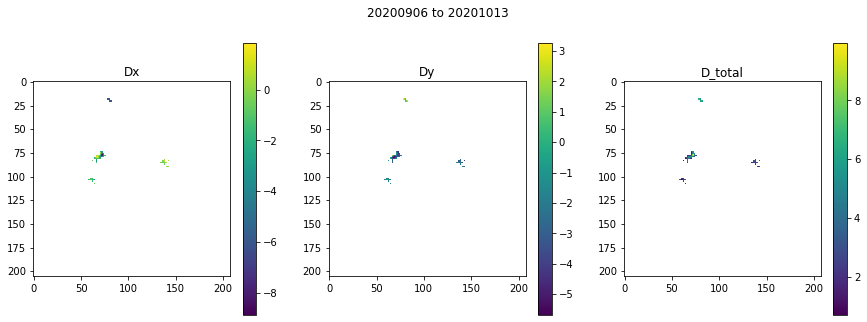

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02007007598876953
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

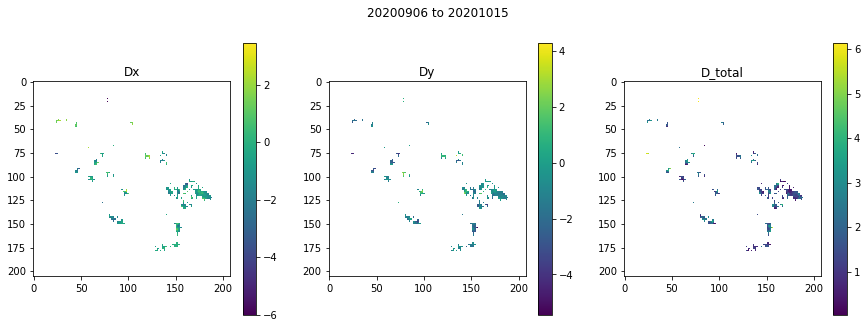

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01714491844177246
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

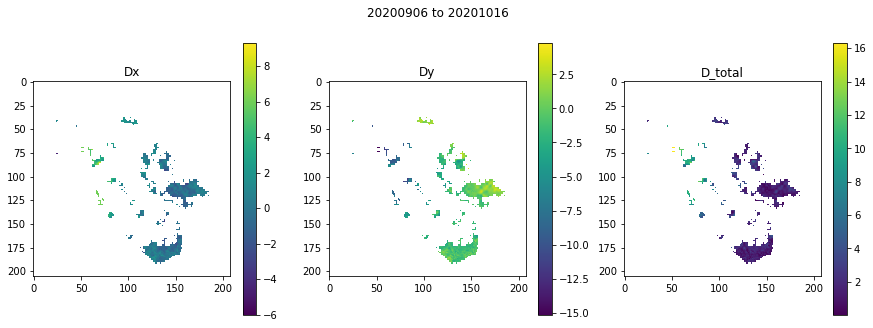

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017659902572631836
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

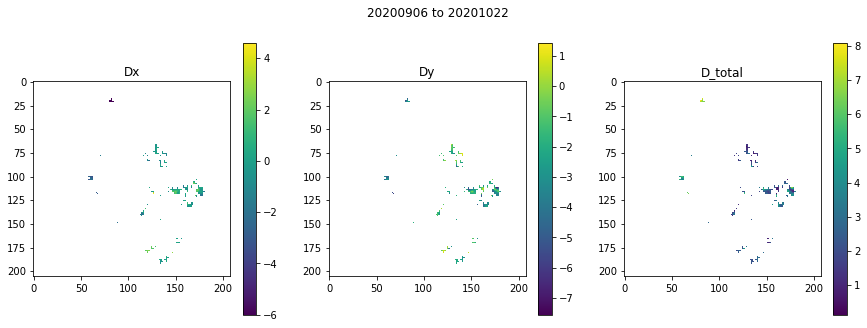

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.025104761123657227
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

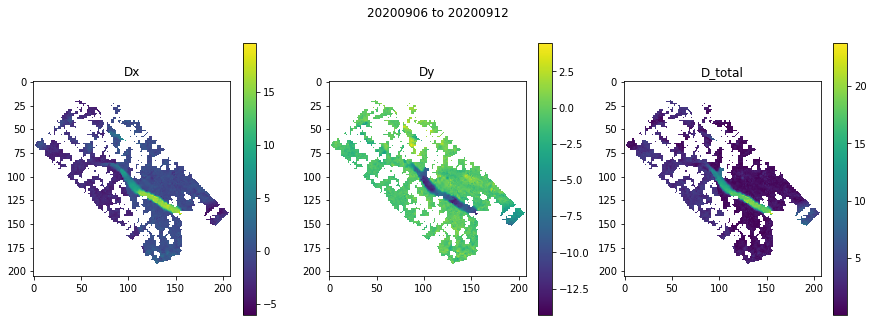

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01872396469116211
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

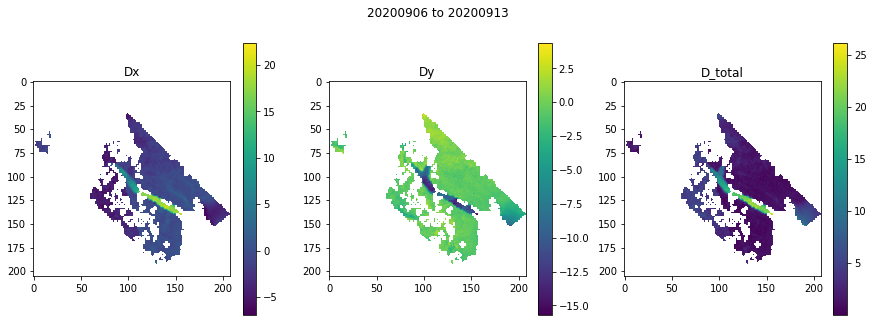

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020895004272460938
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

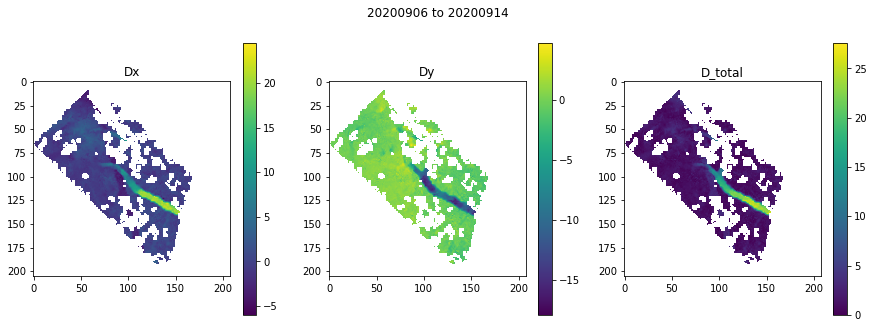

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019502878189086914
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

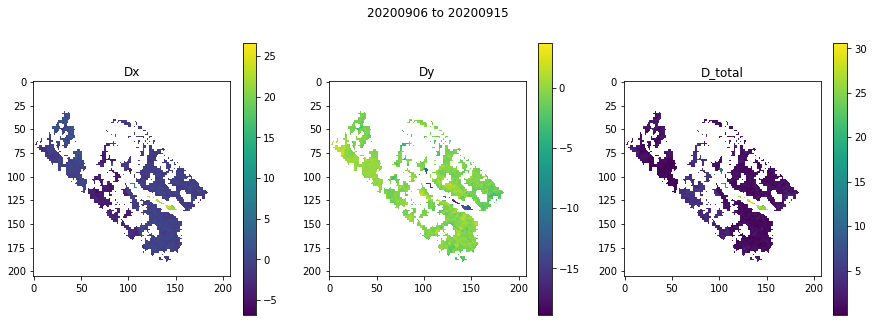

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0189669132232666
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

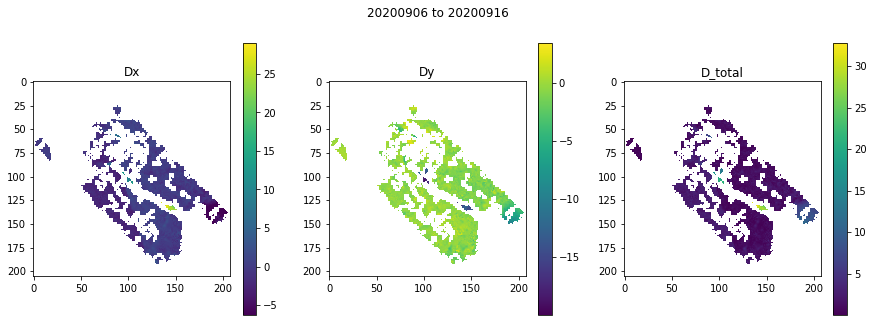

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023693084716796875
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

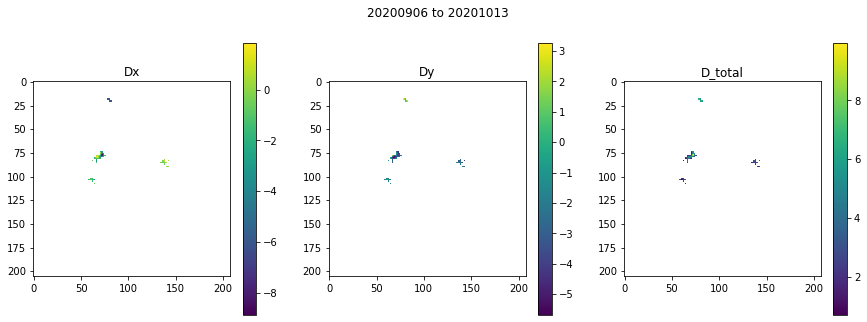

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01925826072692871
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

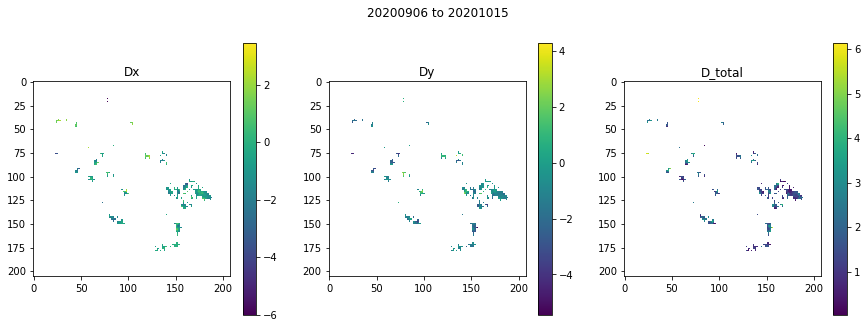

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018446922302246094
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

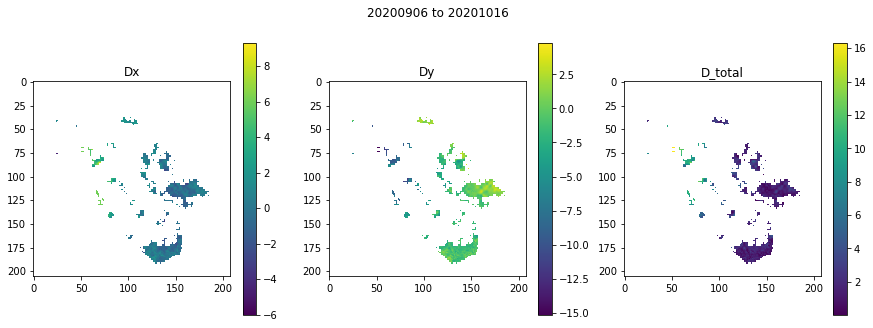

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019068002700805664
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

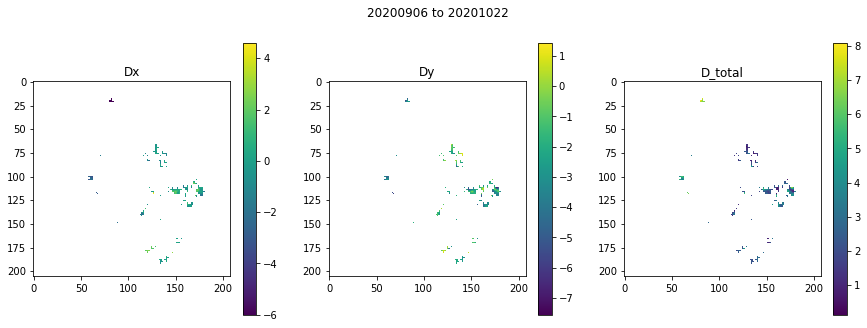

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02296590805053711
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

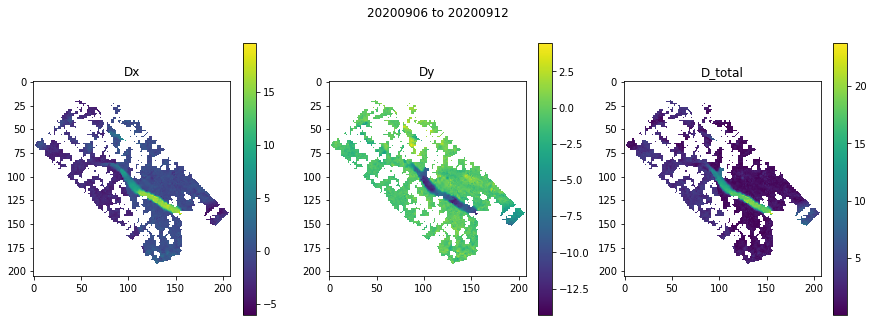

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018339157104492188
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

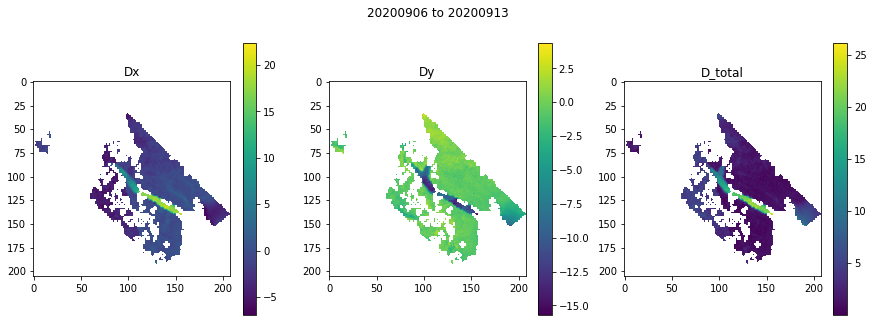

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018815040588378906
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

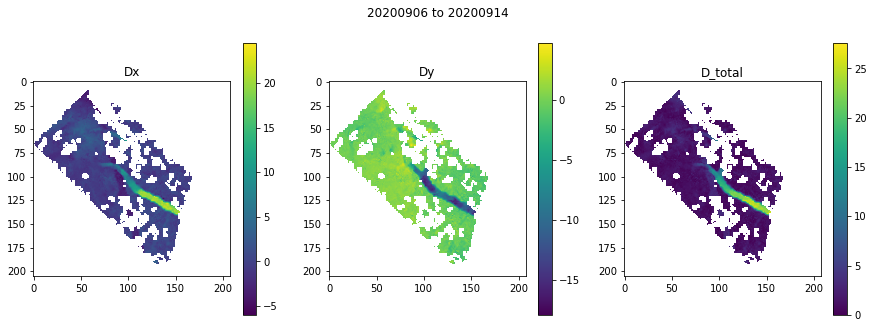

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.024931907653808594
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

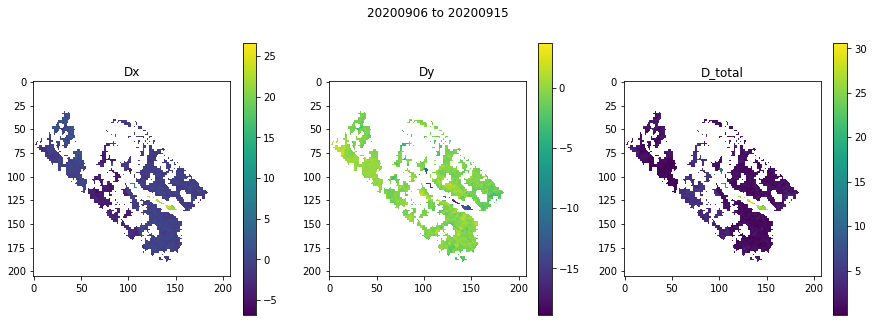

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019094228744506836
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

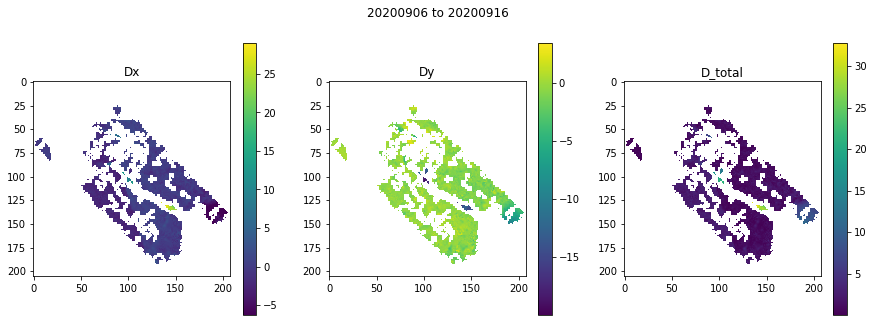

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02189922332763672
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

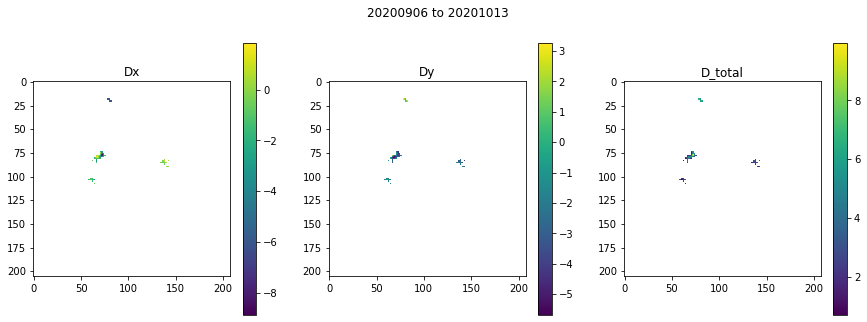

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021455049514770508
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

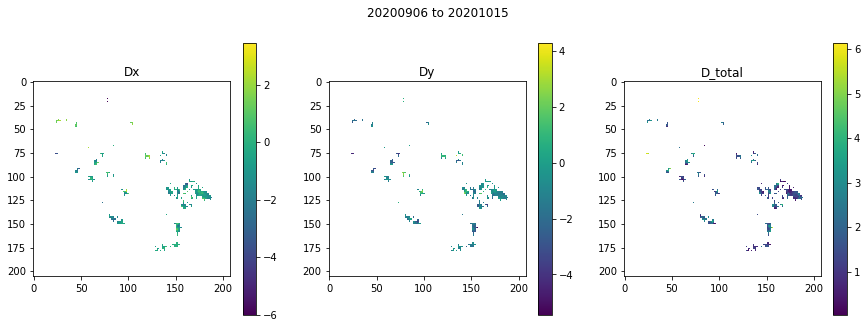

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021158933639526367
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

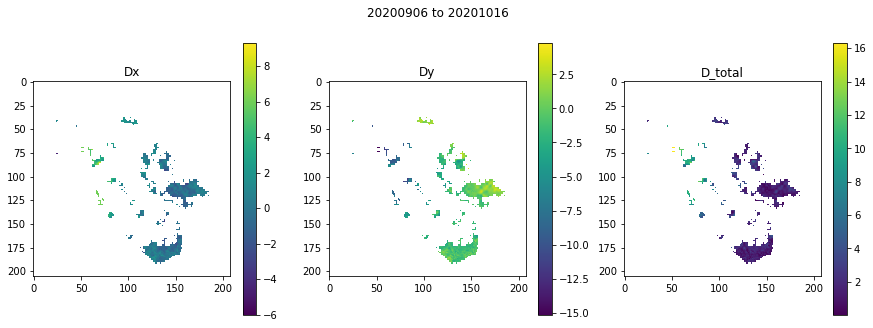

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018657207489013672
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

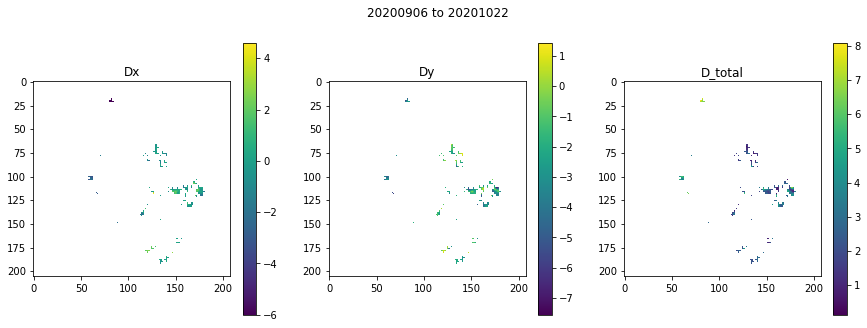

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02373814582824707
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

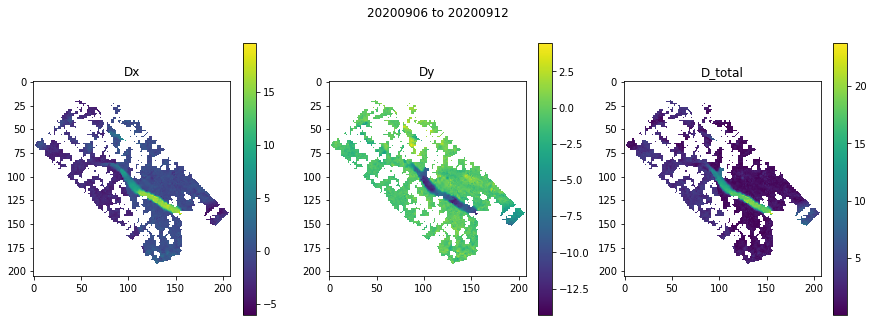

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.022687911987304688
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

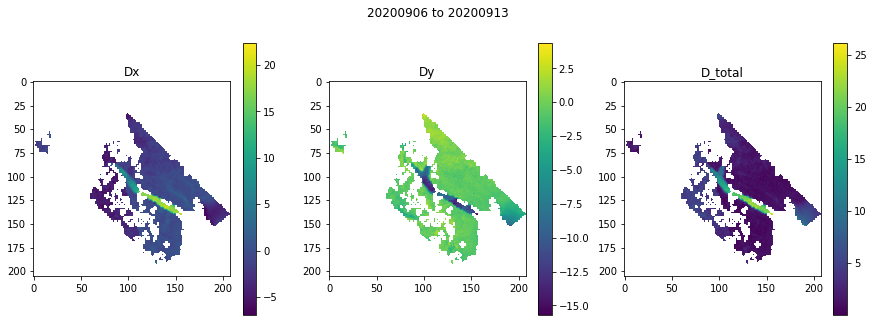

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01873302459716797
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

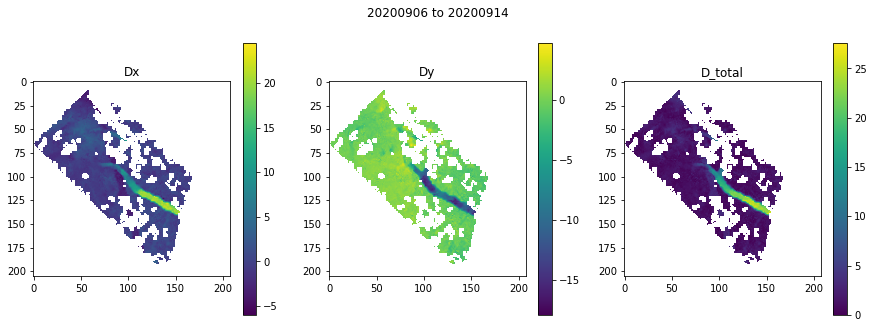

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019060850143432617
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

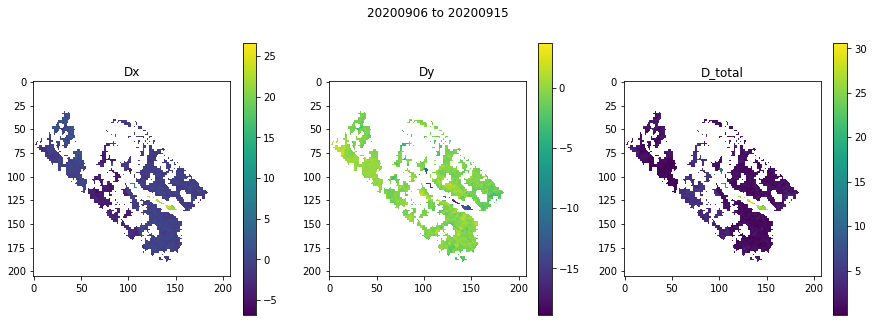

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023235797882080078
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

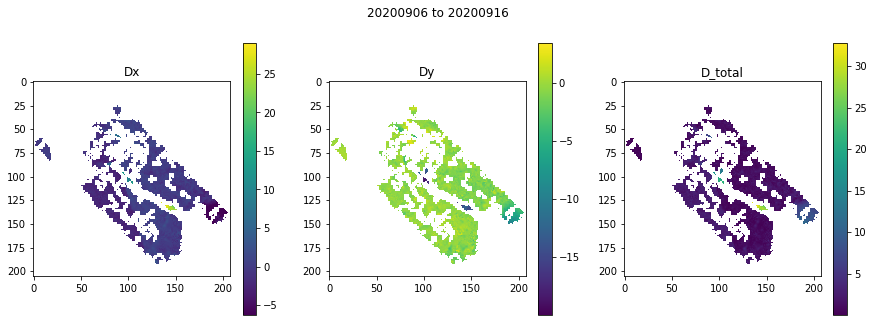

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018805980682373047
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

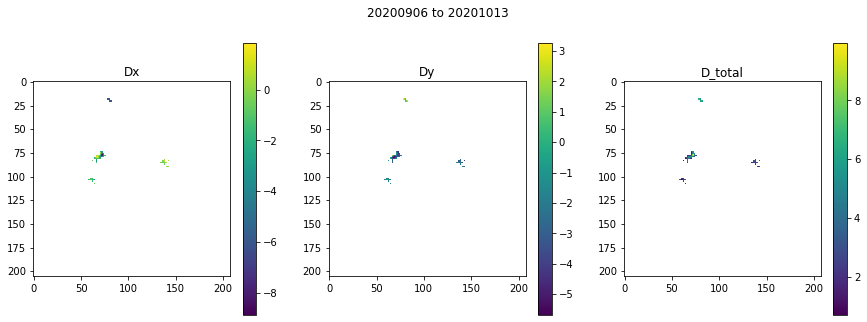

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018732070922851562
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

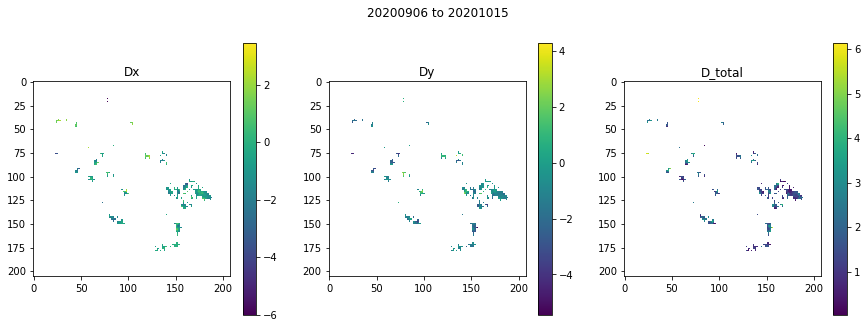

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0182340145111084
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

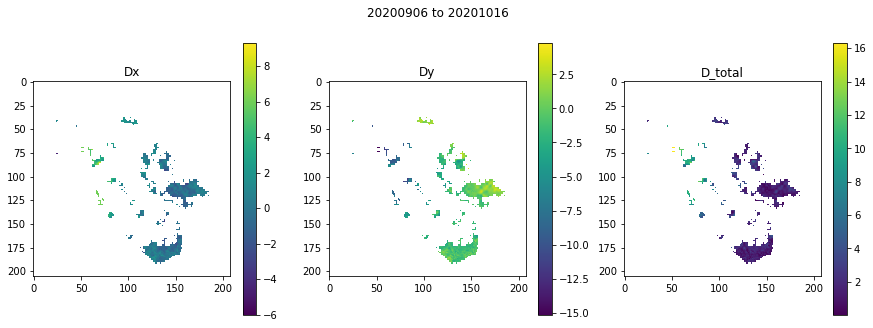

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01835799217224121
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

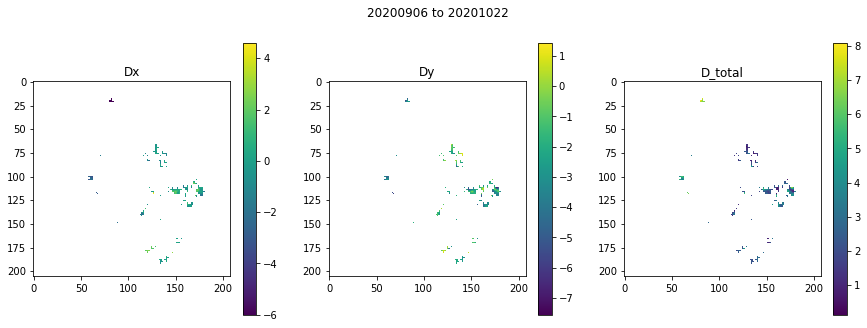

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023373126983642578
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

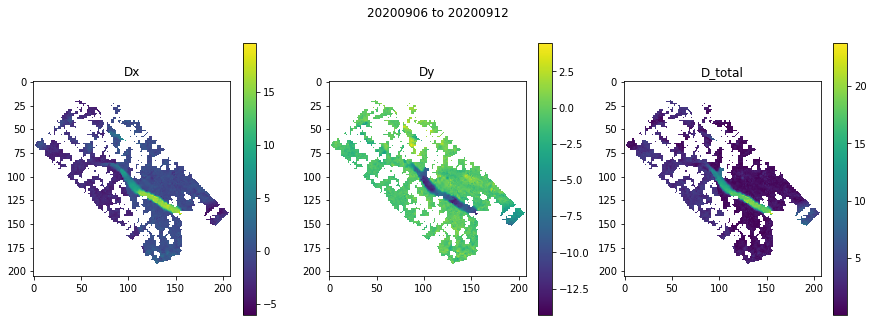

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018847942352294922
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

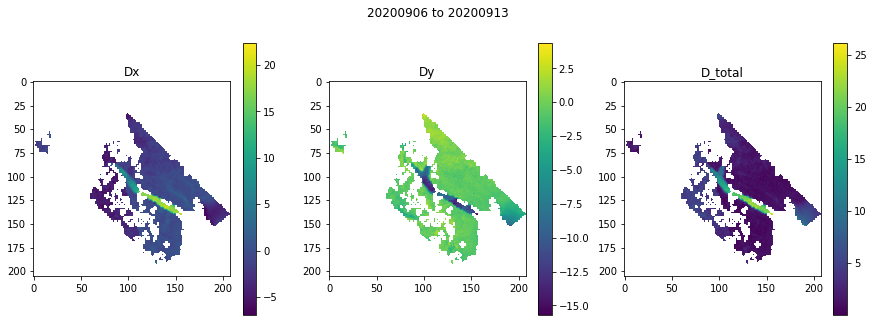

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019145965576171875
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

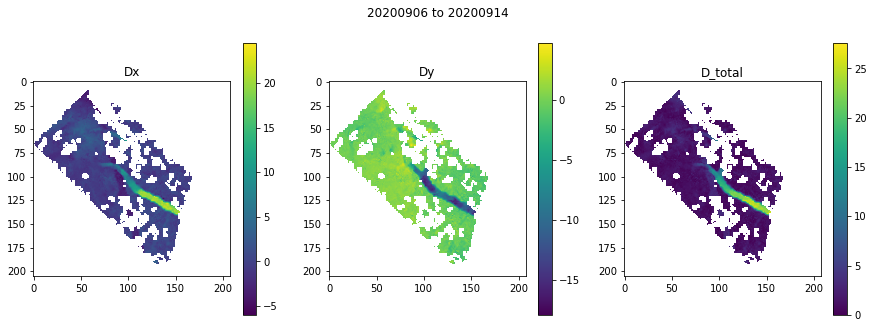

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019104957580566406
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

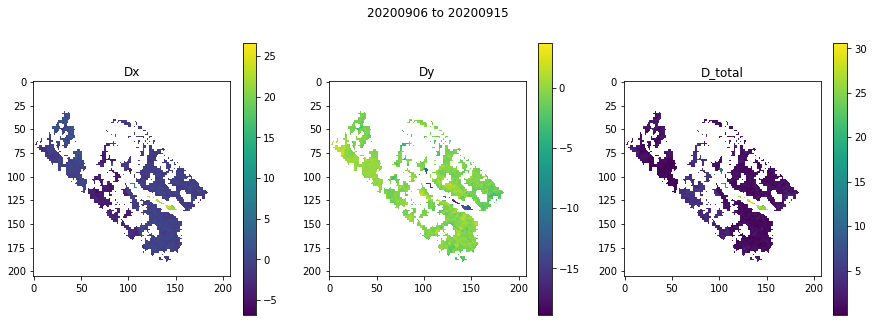

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018847942352294922
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

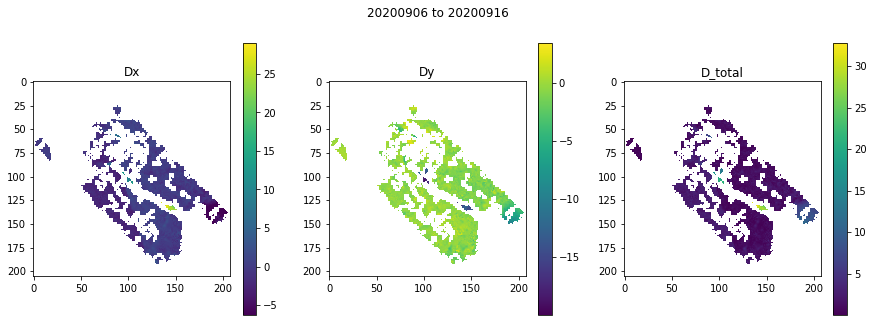

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018592119216918945
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

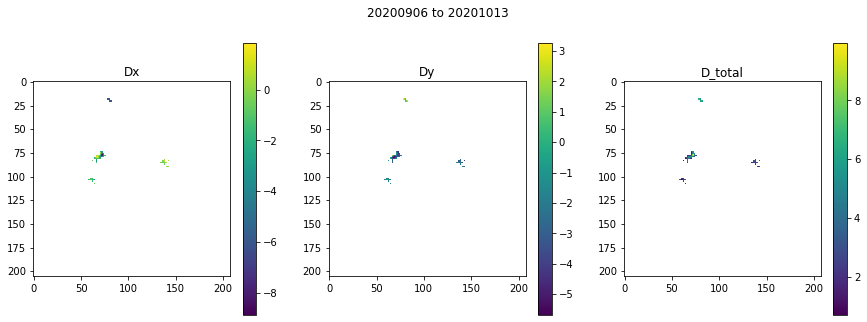

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02173590660095215
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

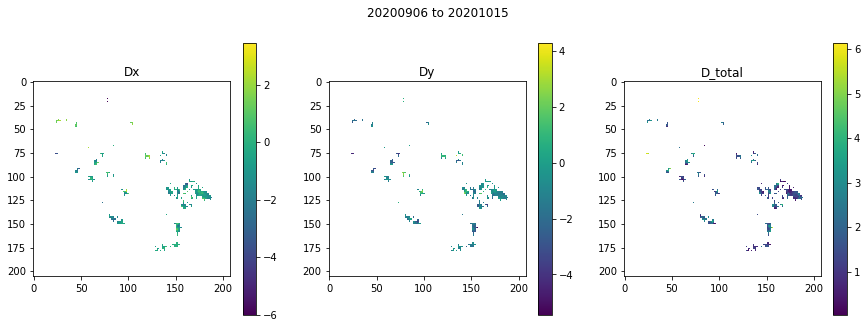

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01882791519165039
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

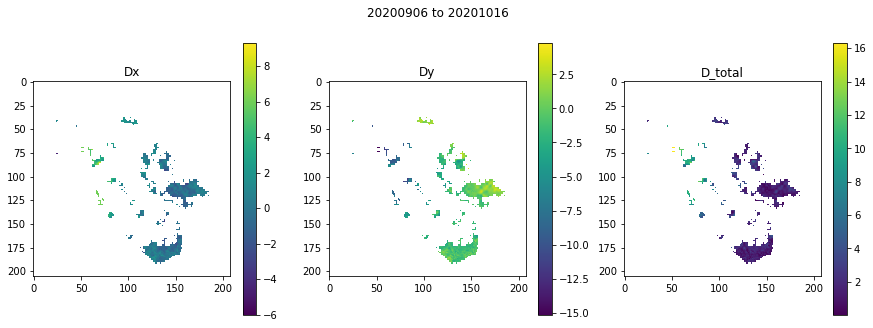

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018583059310913086
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

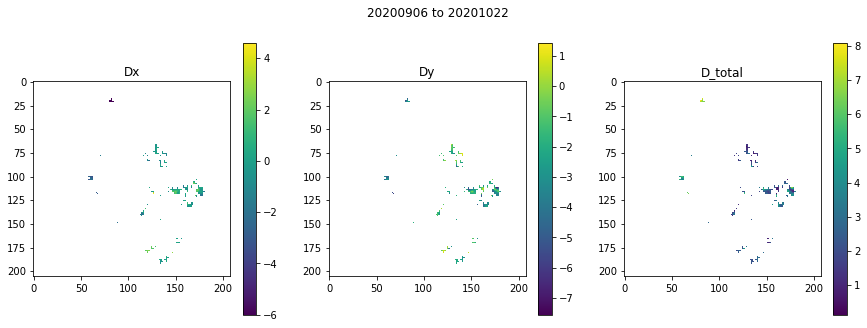

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018739938735961914
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

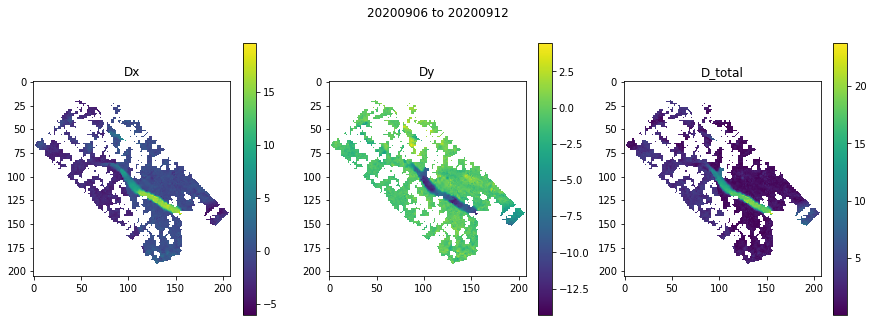

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019822120666503906
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

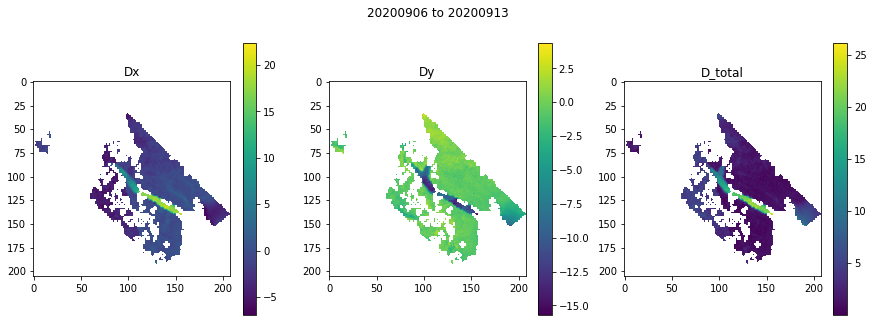

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018451929092407227
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

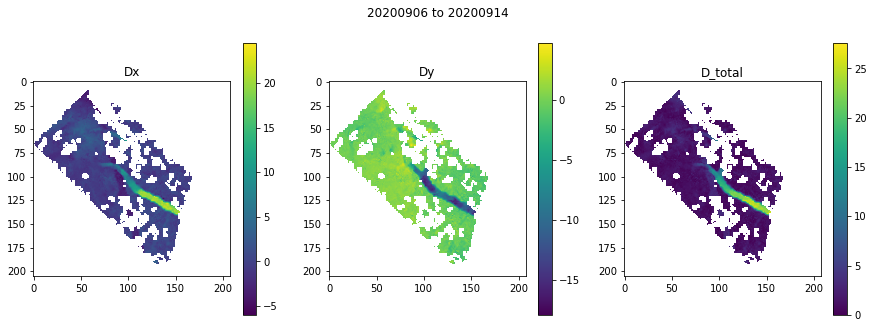

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018748760223388672
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

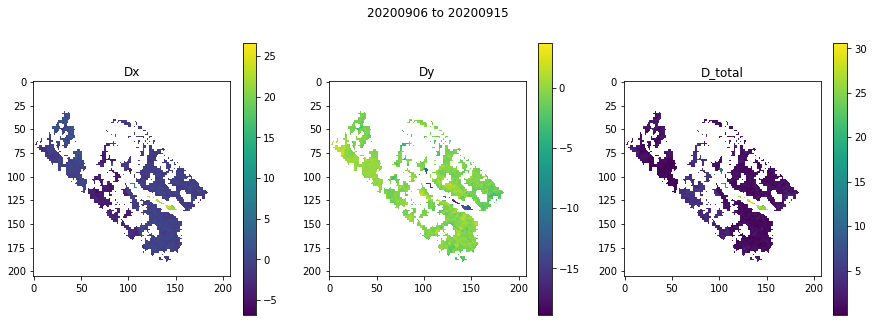

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021203279495239258
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

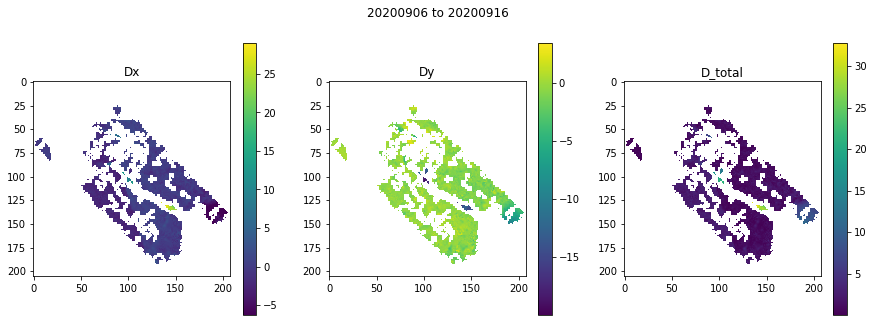

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018249988555908203
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

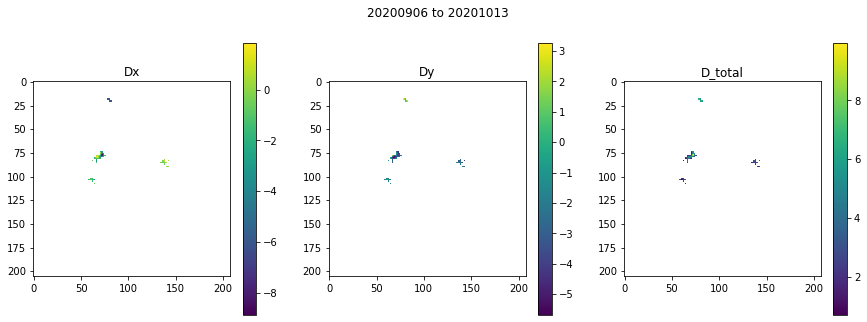

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.024558067321777344
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

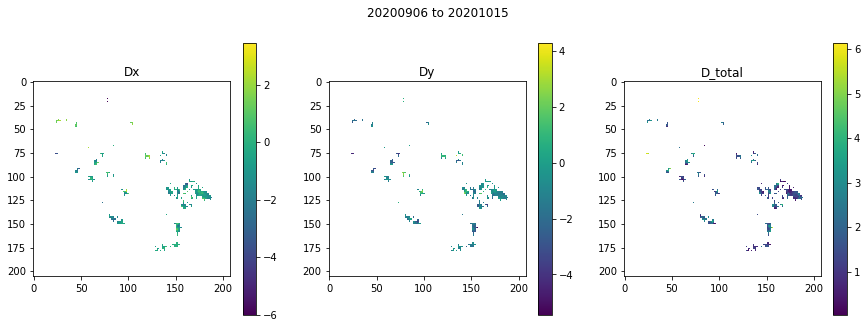

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018606185913085938
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

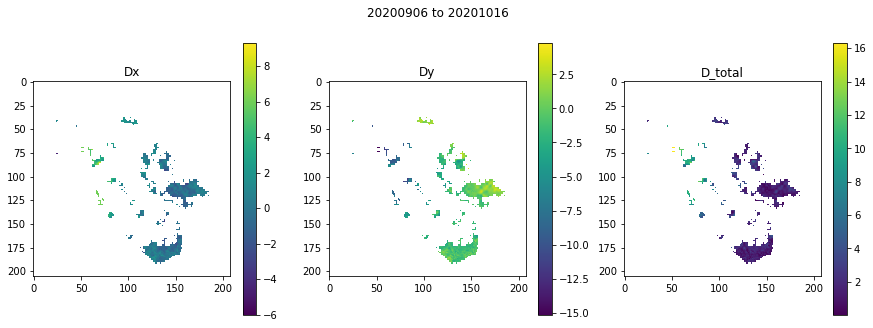

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.028872966766357422
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

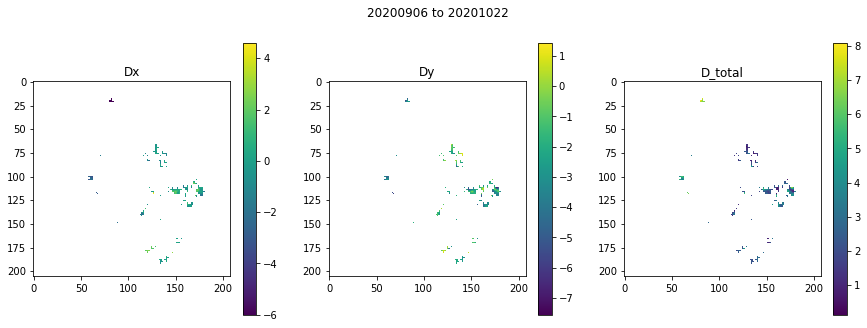

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018442869186401367
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

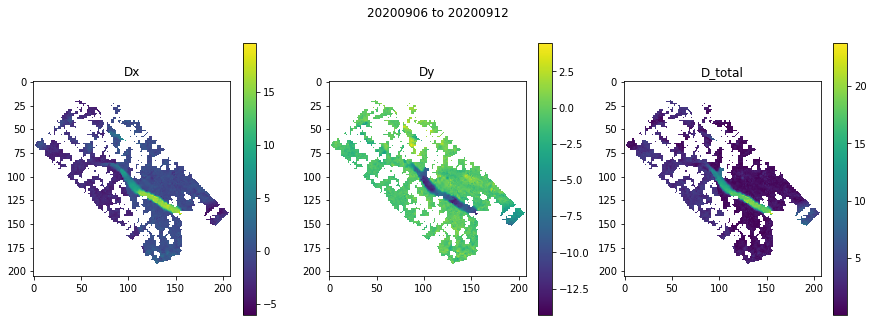

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020339012145996094
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

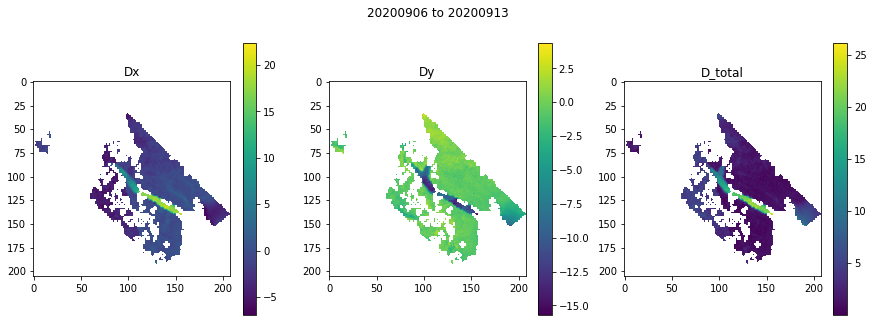

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0261843204498291
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

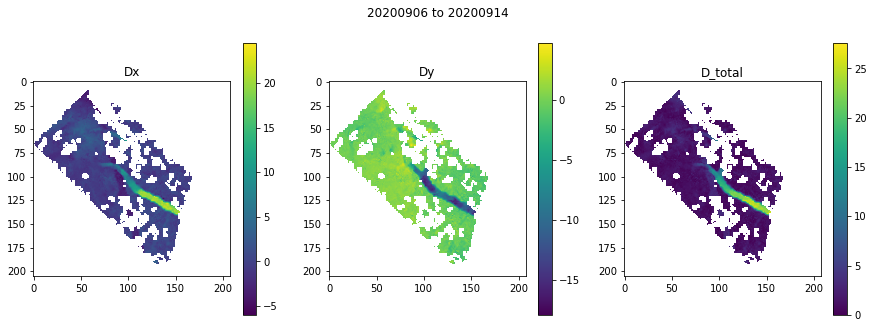

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01869511604309082
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

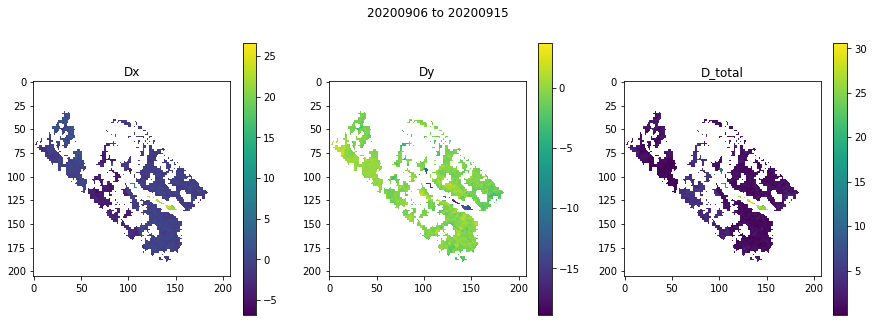

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019779205322265625
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

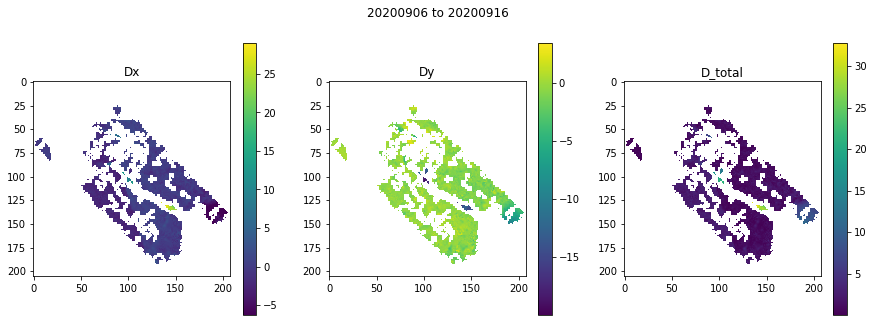

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.024599075317382812
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

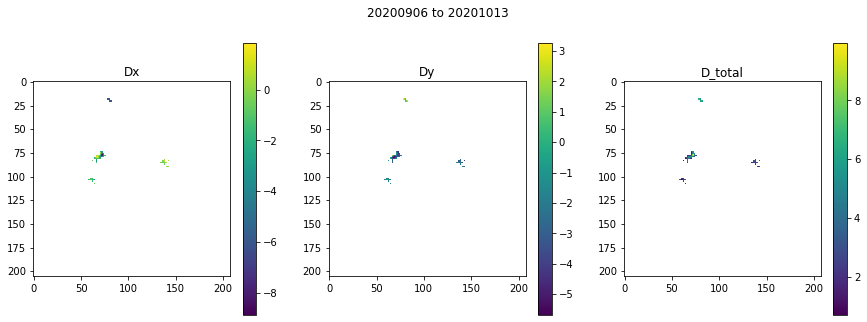

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018192768096923828
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

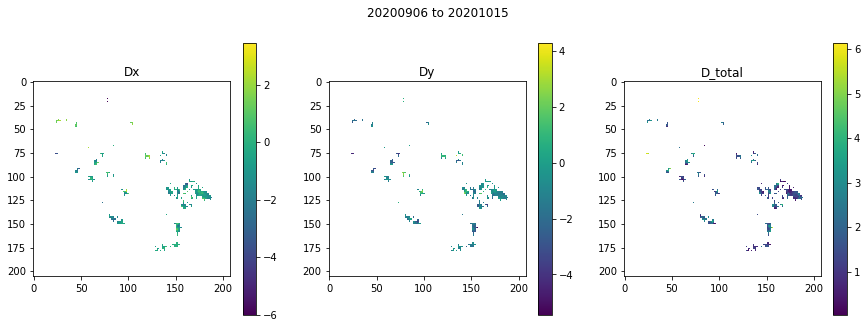

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018245697021484375
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

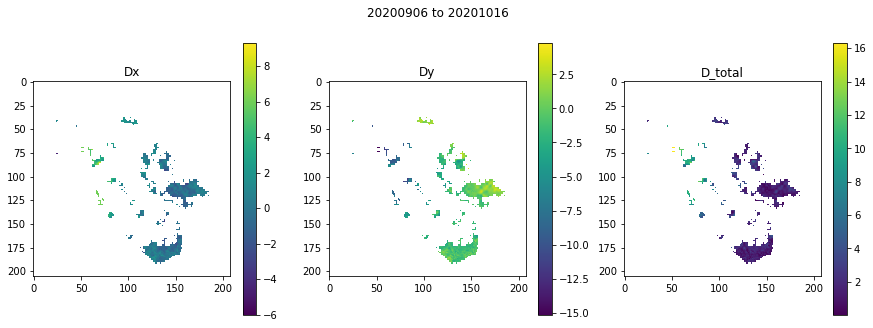

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020900726318359375
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

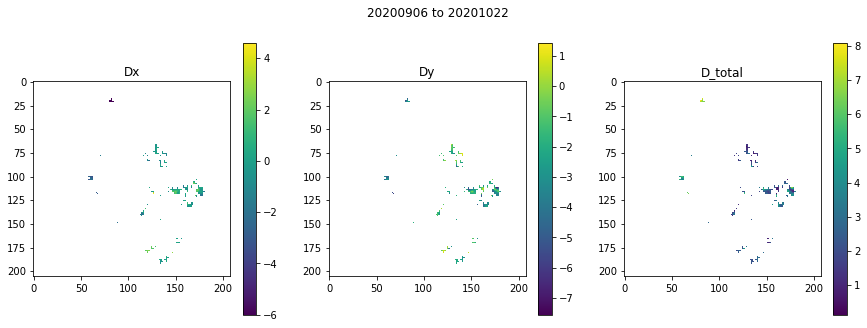

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01902008056640625
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

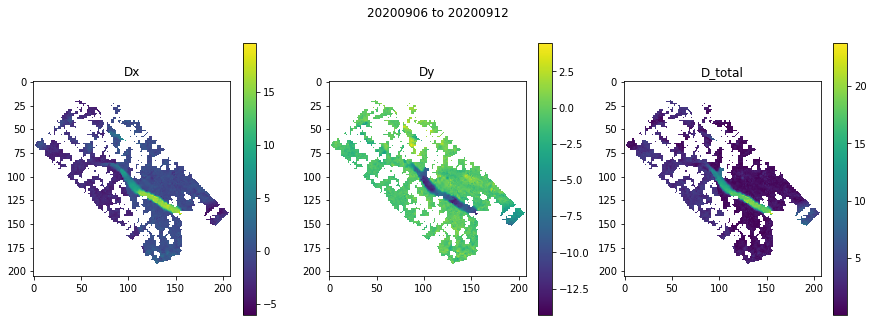

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018376827239990234
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

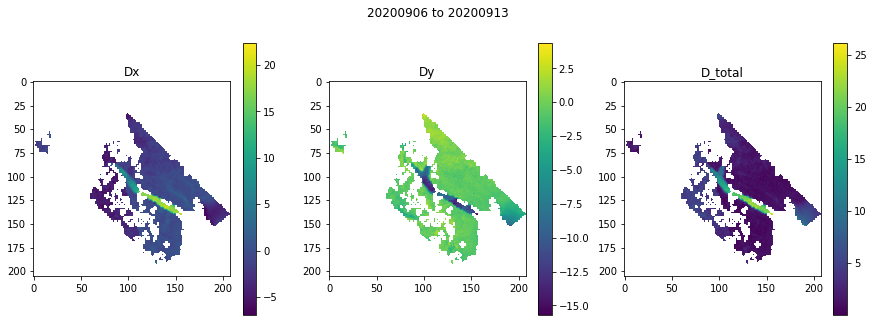

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018630266189575195
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

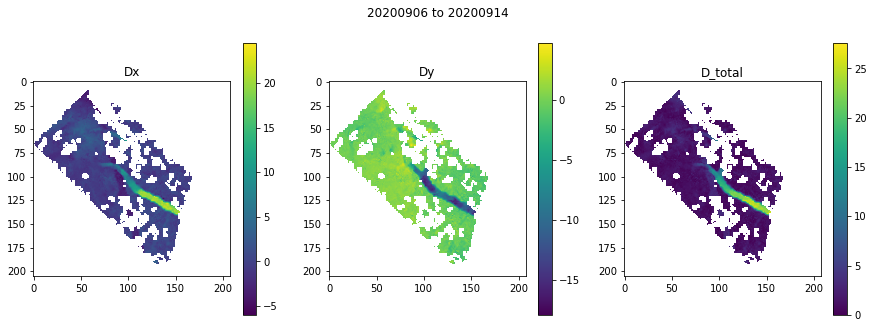

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.026334047317504883
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

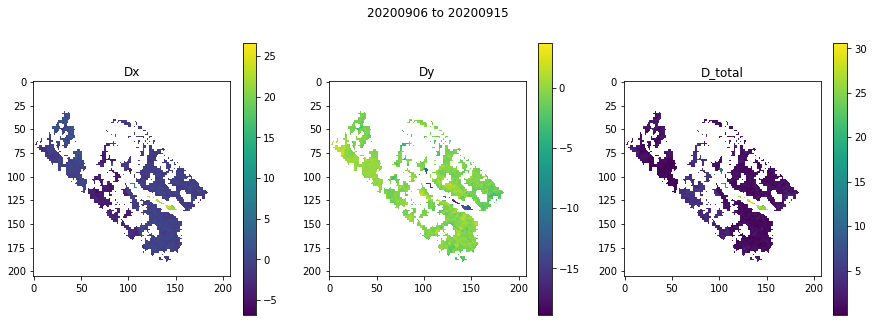

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018523216247558594
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

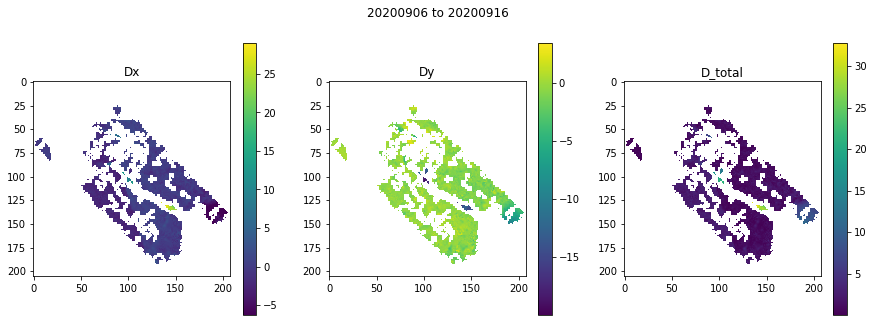

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01862812042236328
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

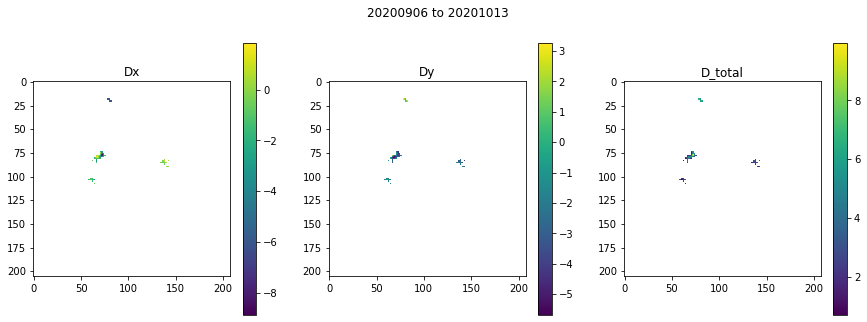

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.024113893508911133
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

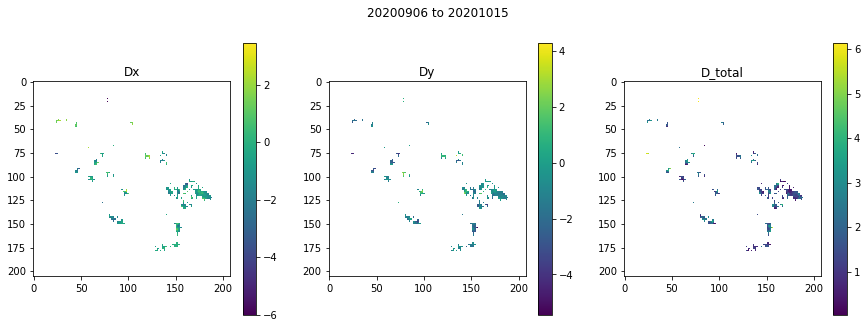

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021741867065429688
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

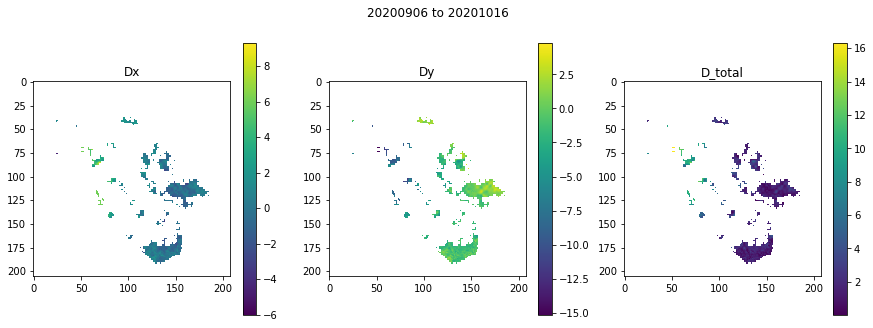

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019298076629638672
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

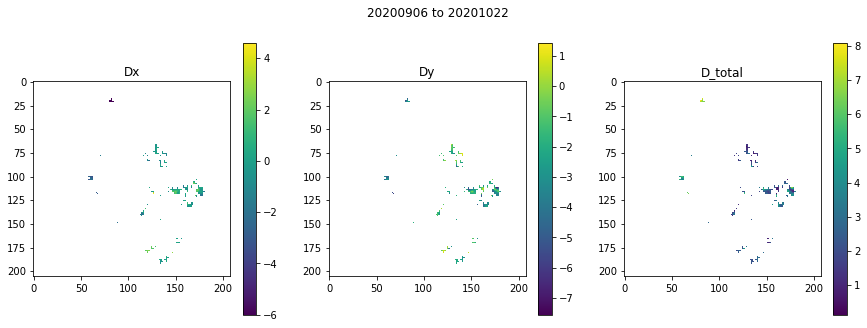

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018877029418945312
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

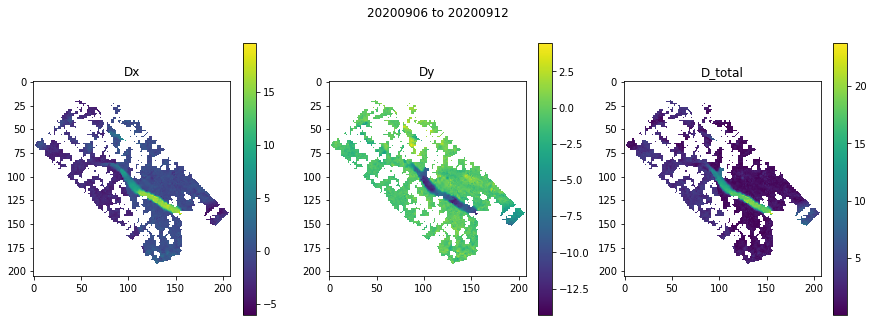

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018870115280151367
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

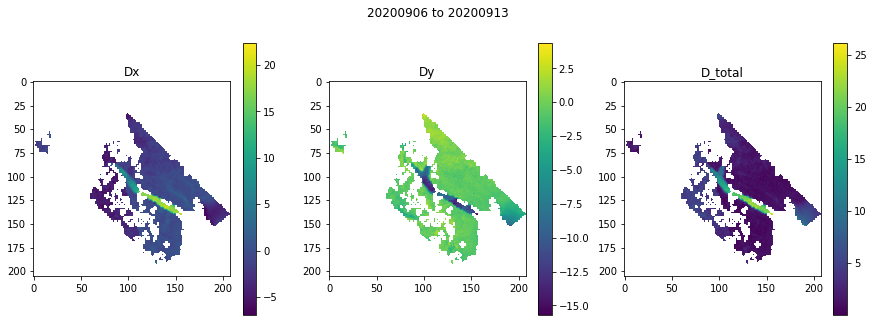

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021378040313720703
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

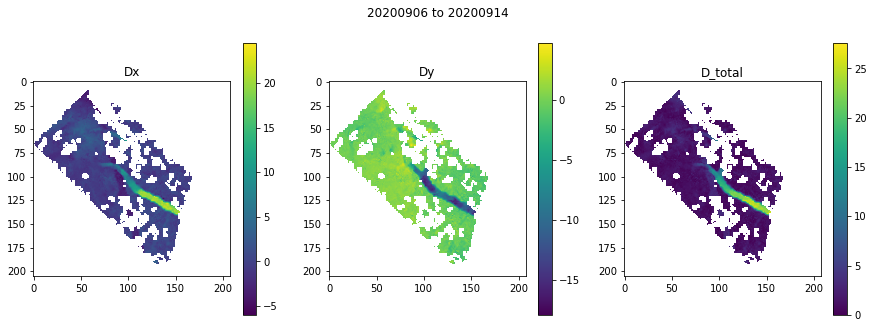

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01863408088684082
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

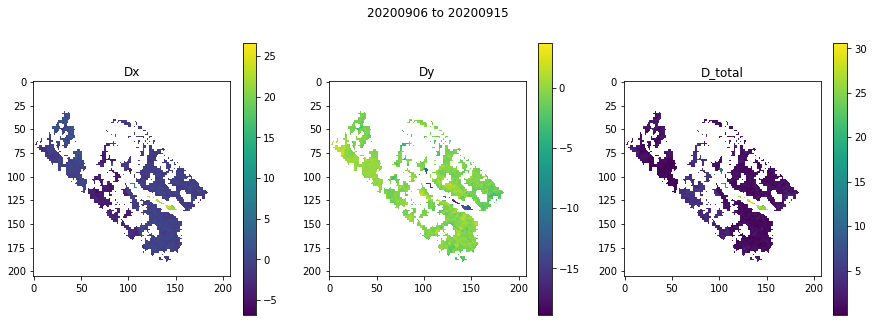

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01929783821105957
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

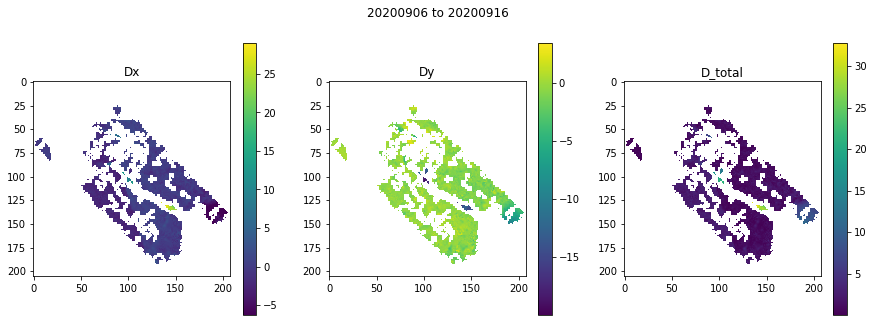

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018439054489135742
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

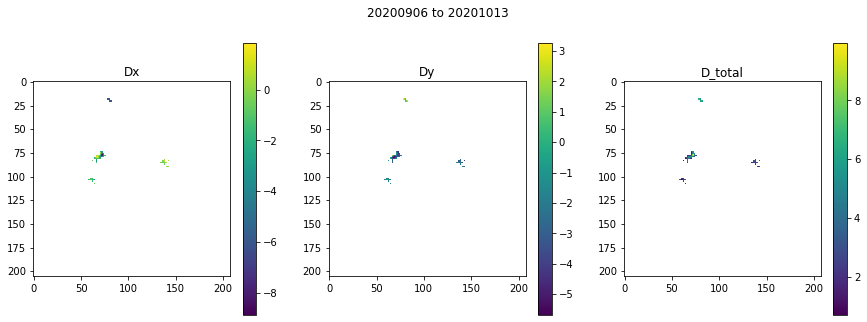

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018705129623413086
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

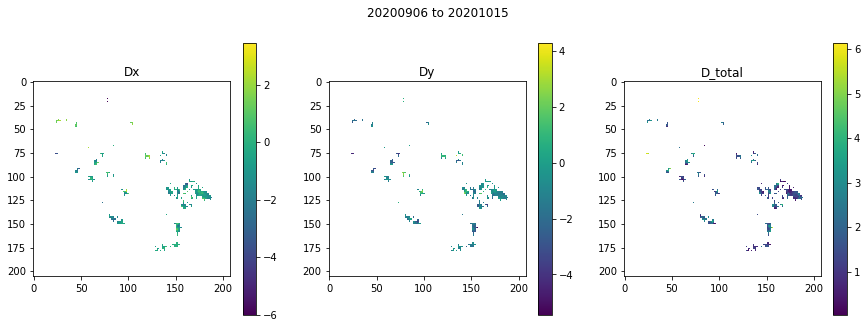

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.032659053802490234
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

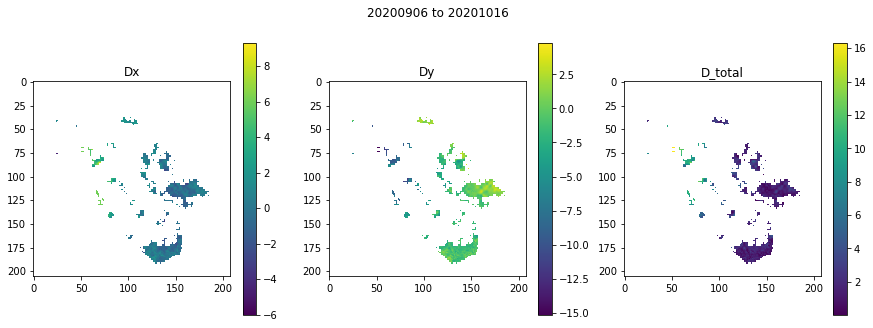

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019443035125732422
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

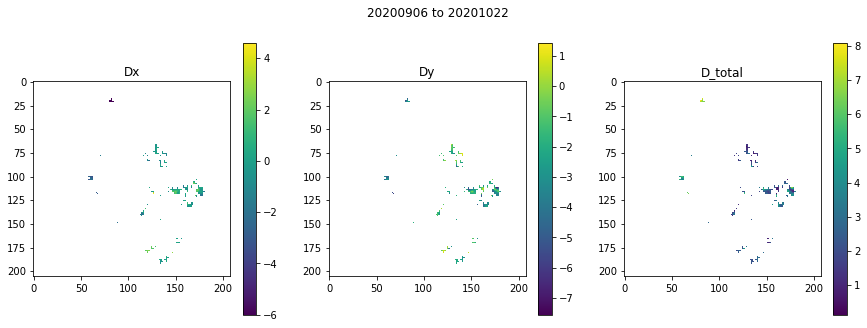

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.027627944946289062
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

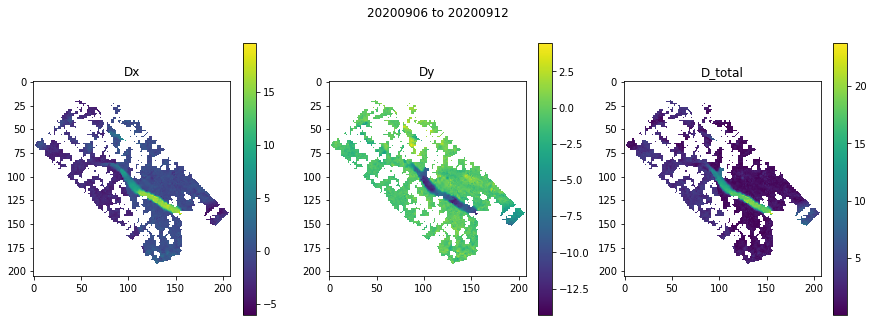

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01833510398864746
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

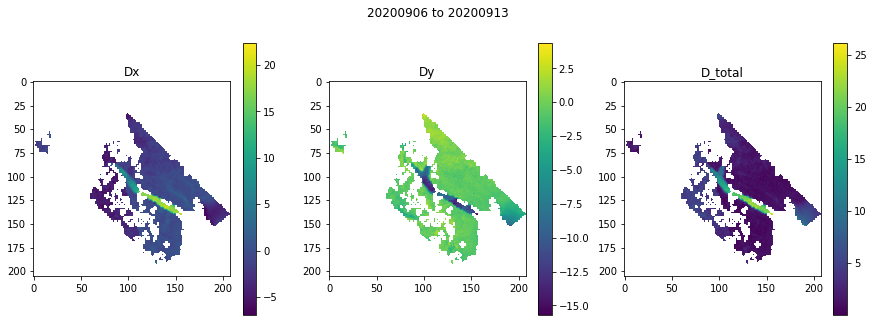

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019379138946533203
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

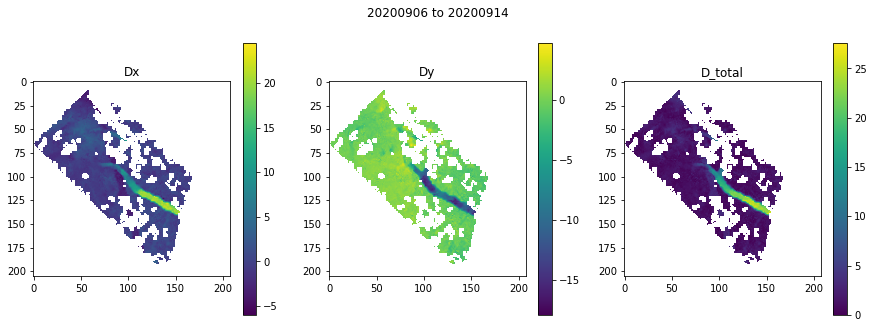

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018559932708740234
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

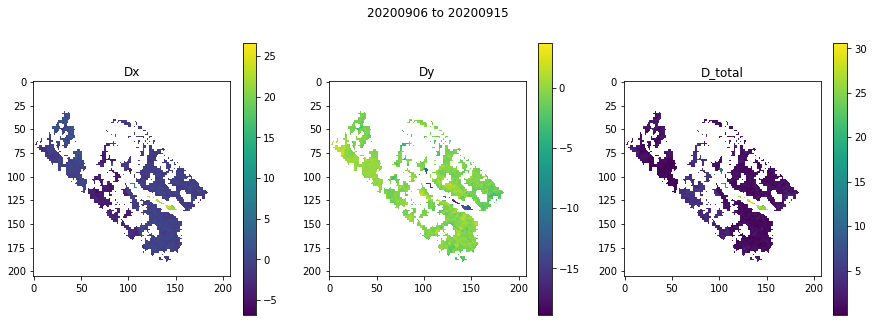

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019008159637451172
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

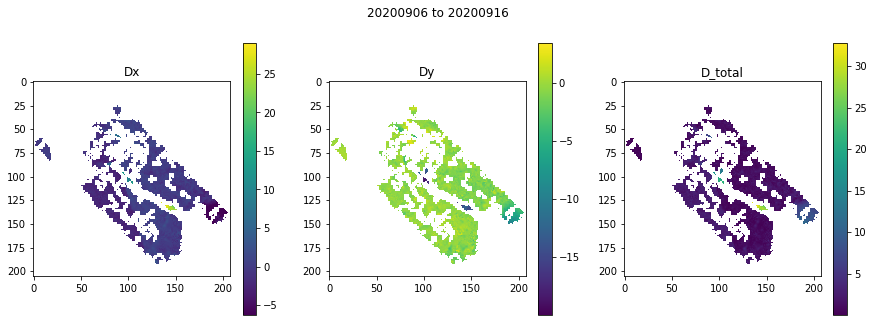

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018828153610229492
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

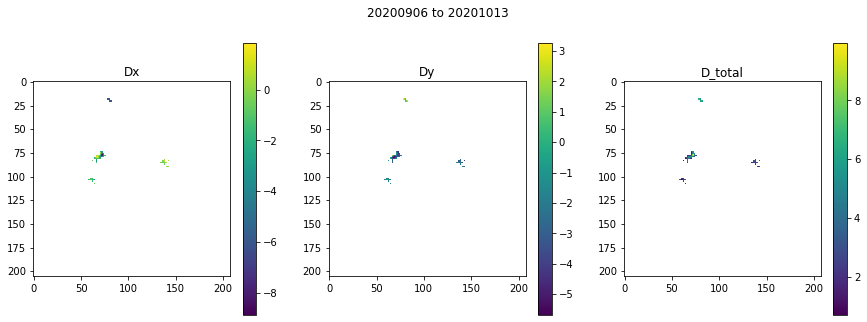

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.023823976516723633
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

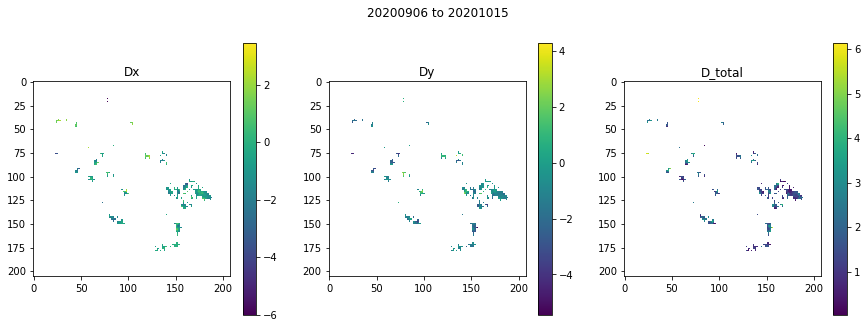

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018435239791870117
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

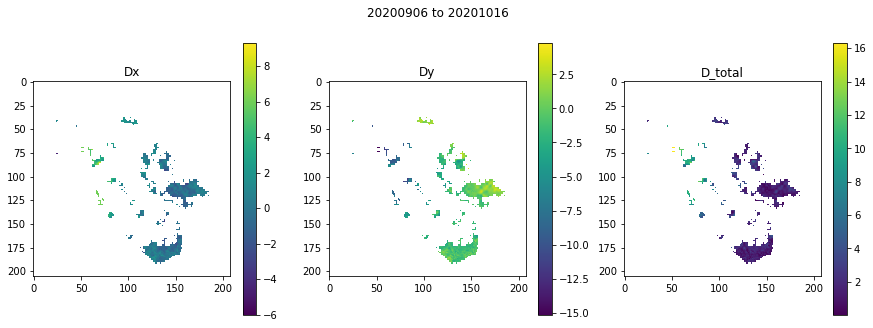

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018338918685913086
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 200
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_200m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

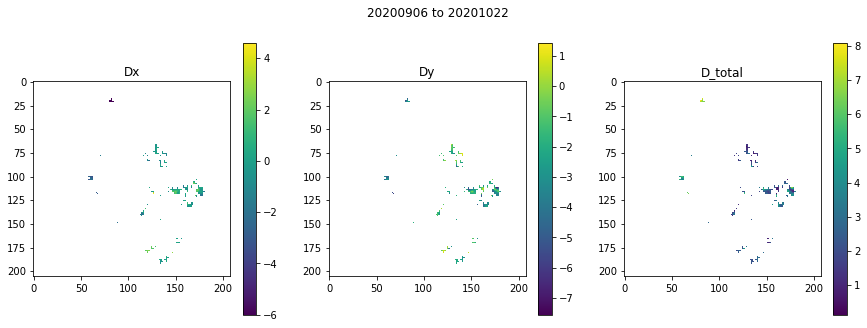

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018796920776367188
IfSAR_300m_DSM_clipped.tif  already exists.
IfSAR_300m_DSM_clipped_dhdy.tif and IfSAR_300m_DSM_clipped_dhdx.tif already exist.
vx_300m.tif , vy_300m.tif , srx_300m.tif , sry_300m.tif already exist.
ssm_300m.tif and TG_mask_300m.tif already exist.
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 664149

/var/folders/mr/7f69f7y50zj85n420pyvh8cr0000gq/T/ipykernel_11582/1810812533.py:81: RuntimeWarning: divide by zero encountered in true_divide
  obj.SearchLimitX = np.int32(4+(25-4)/(np.max(np.abs(Dx0[np.logical_not(noDataMask)]))-np.min(np.abs(Dx0[np.logical_not(noDataMask)])))*(np.abs(Dx0)-np.min(np.abs(Dx0[np.logical_not(noDataMask)]))))
/var/folders/mr/7f69f7y50zj85n420pyvh8cr0000gq/T/ipykernel_11582/1810812533.py:81: RuntimeWarning: invalid value encountered in multiply
  obj.SearchLimitX = np.int32(4+(25-4)/(np.max(np.abs(Dx0[np.logical_not(noDataMask)]))-np.min(np.abs(Dx0[np.logical_not(noDataMask)])))*(np.abs(Dx0)-np.min(np.abs(Dx0[np.logical_not(noDataMask)]))))


Pre-process Start!!!
Pre-process Done!!!
1.8862202167510986
Uniform Data Type Done!!!
0.8994560241699219
AutoRIFT Start!!!


/Users/jukesliu/opt/anaconda3/envs/newautoriftenv/lib/python3.9/site-packages/isce/components/contrib/geo_autoRIFT/autoRIFT/autoRIFT.py:442: RuntimeWarning: invalid value encountered in long_scalars
  CoarseCorValidFac = np.sum(MC[ROIC]) / np.sum(M0C[ROIC])


AutoRIFT Done!!!
1.338458776473999


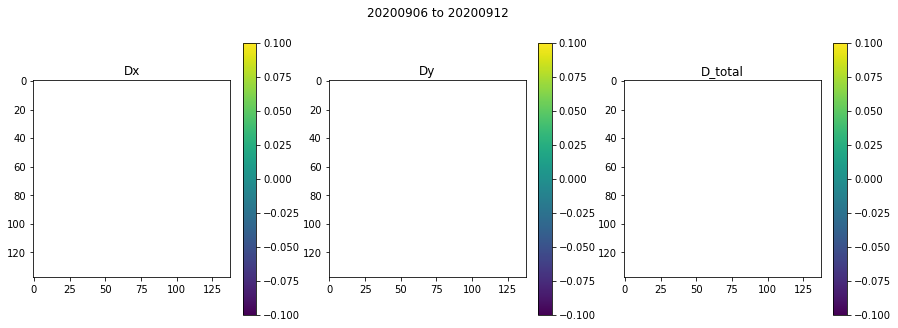

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.5394401550292969
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

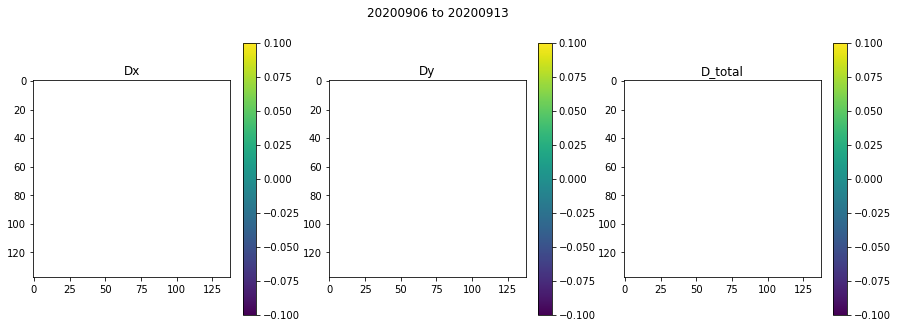

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010257959365844727
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

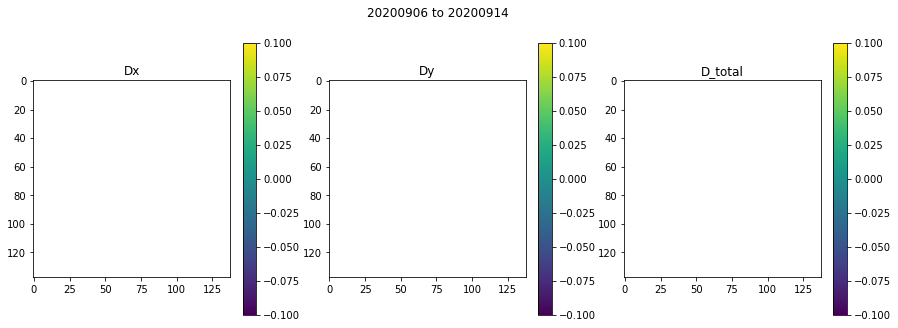

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015119075775146484
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

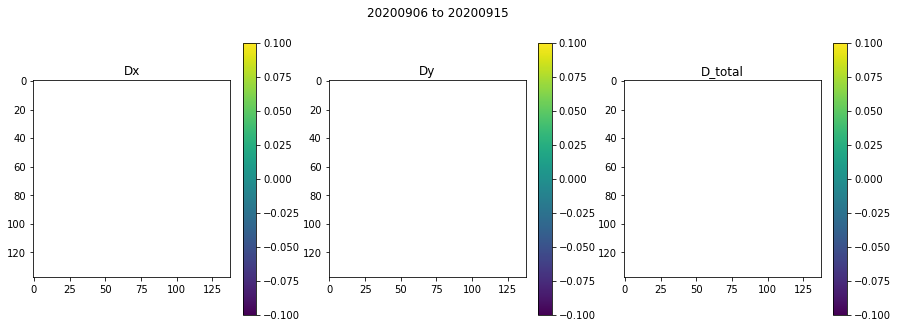

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010476112365722656
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

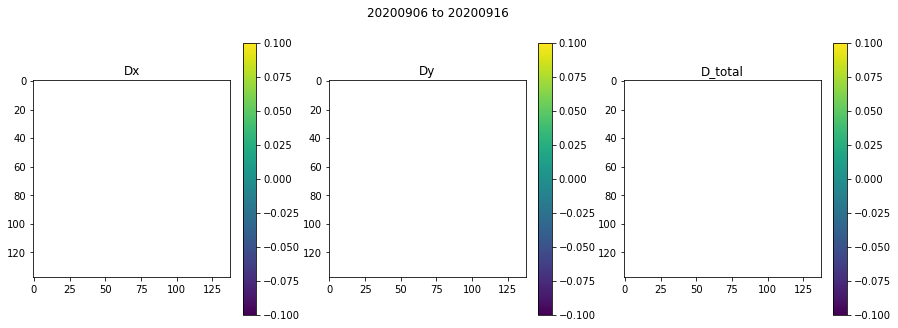

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012548208236694336
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

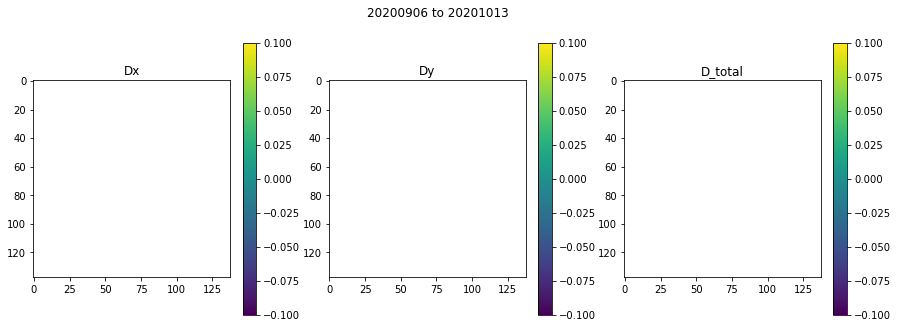

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012681007385253906
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

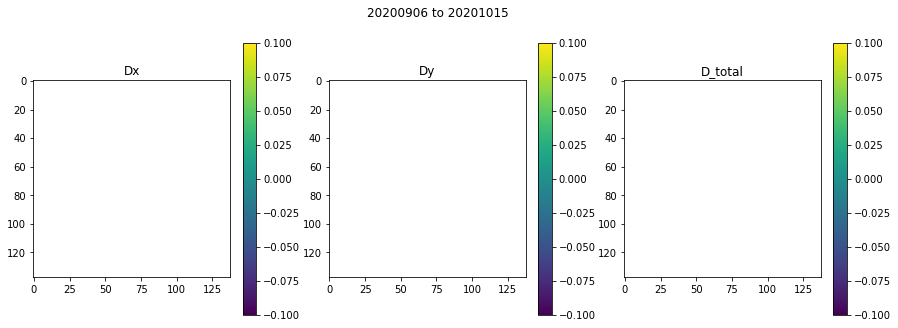

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011297941207885742
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

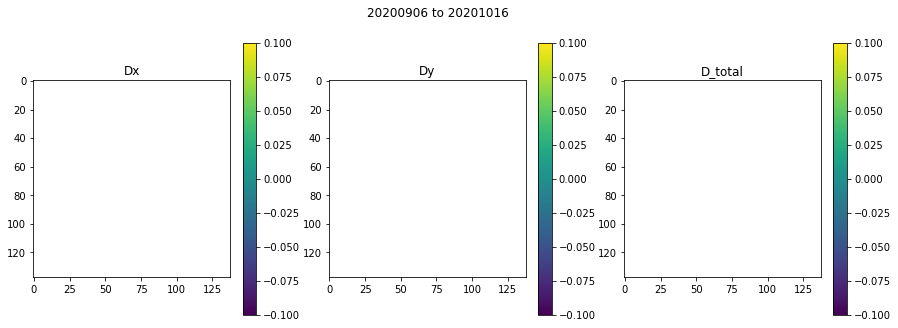

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01738905906677246
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

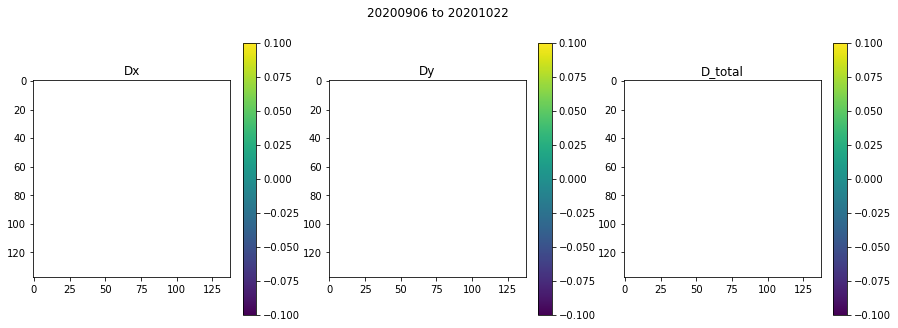

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010711193084716797
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

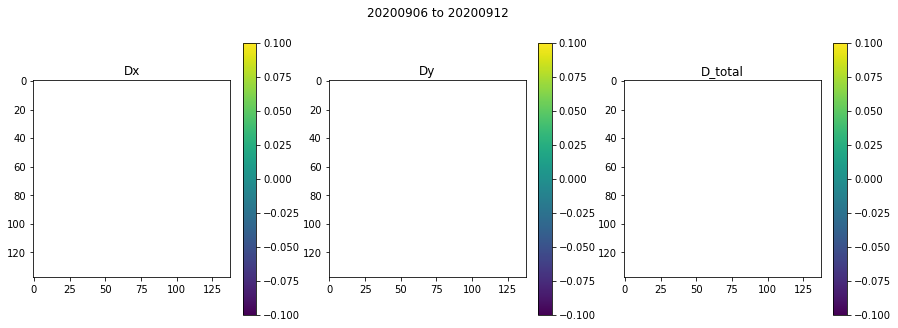

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01627516746520996
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

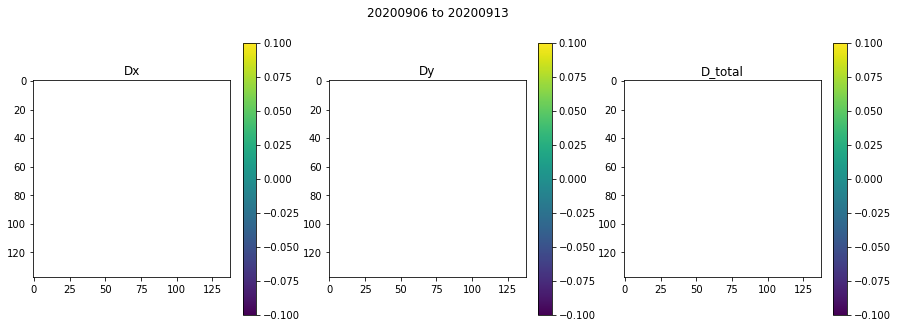

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01612710952758789
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

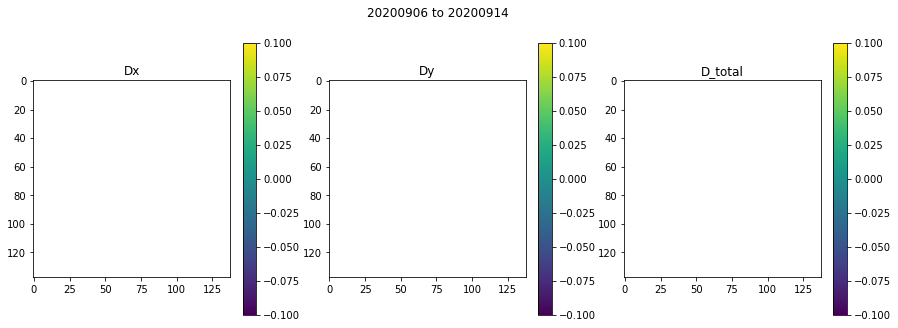

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010526180267333984
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

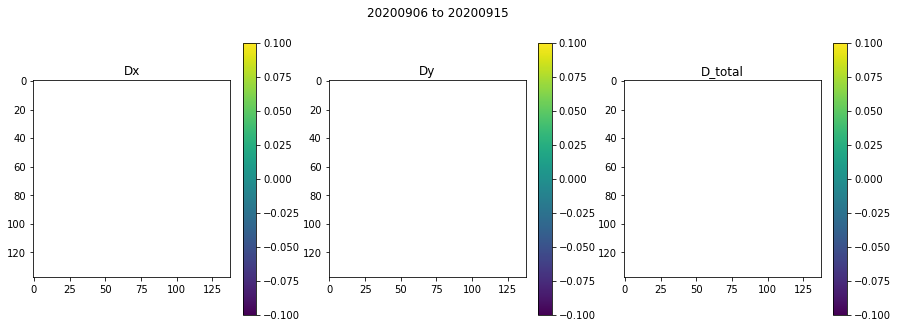

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017279863357543945
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

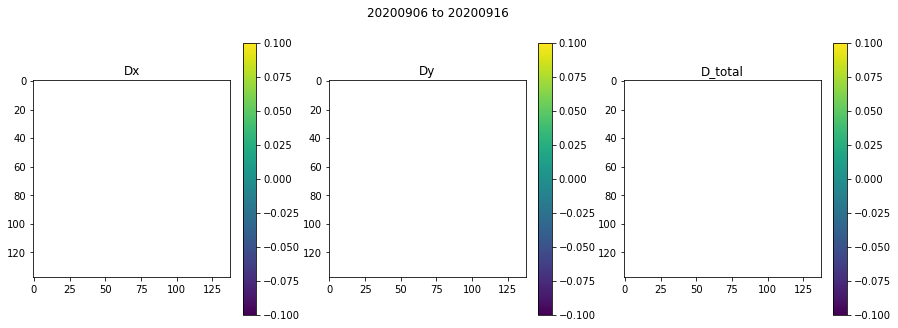

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010607004165649414
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

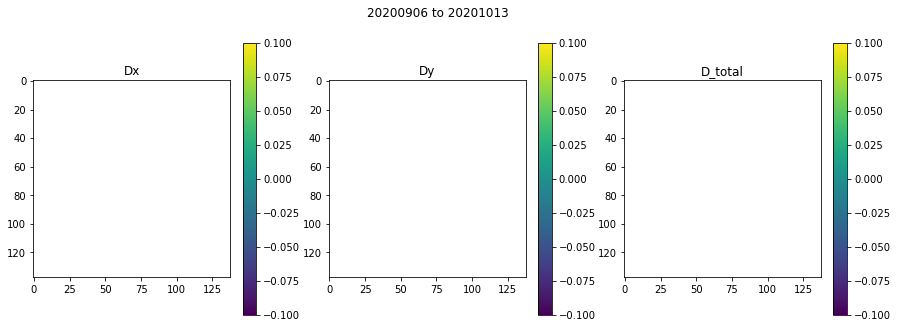

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.013833999633789062
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

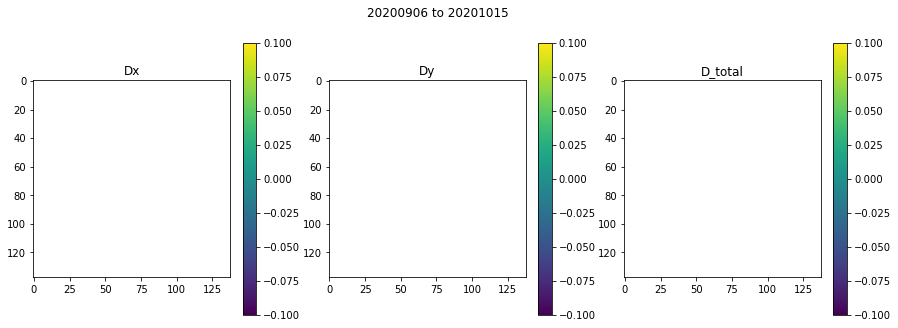

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012465238571166992
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

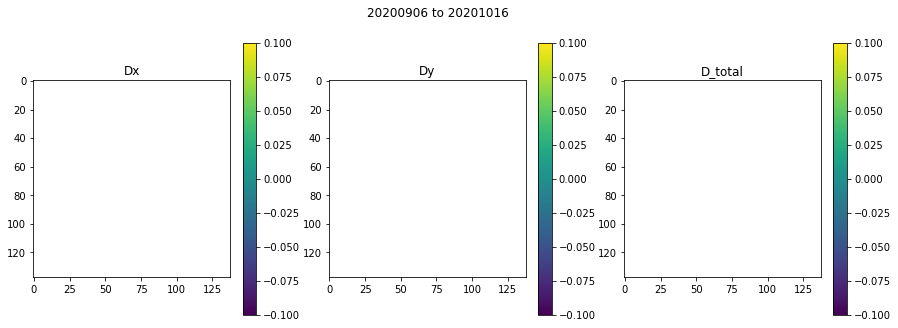

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.013412952423095703
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

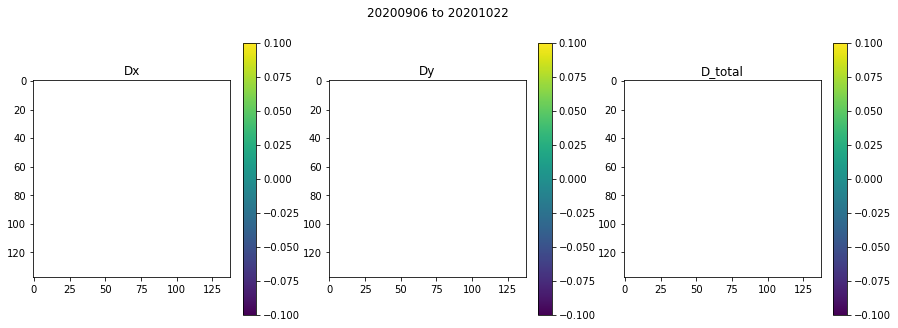

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01081705093383789
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

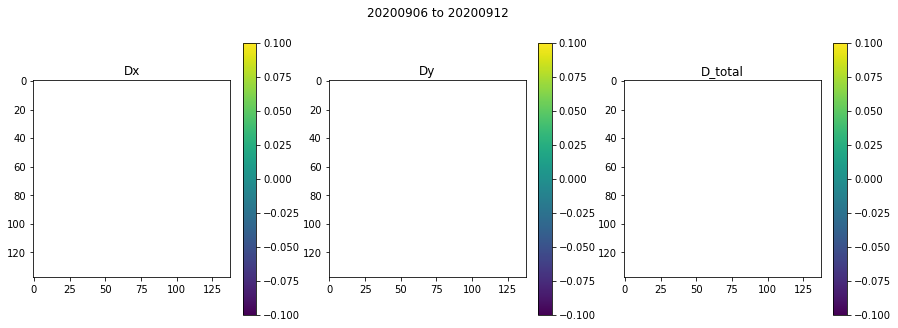

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011244058609008789
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

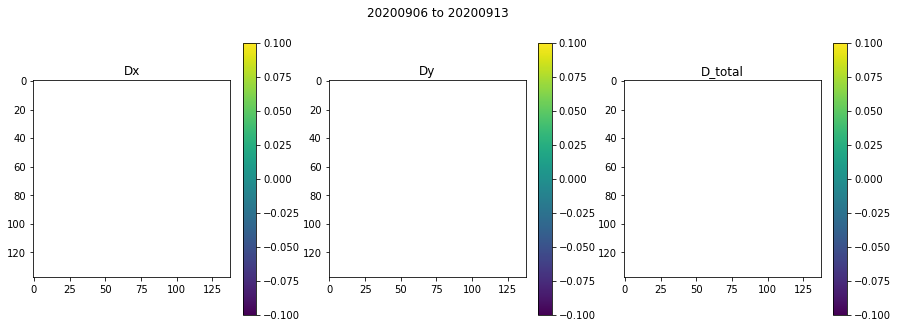

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010443925857543945
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

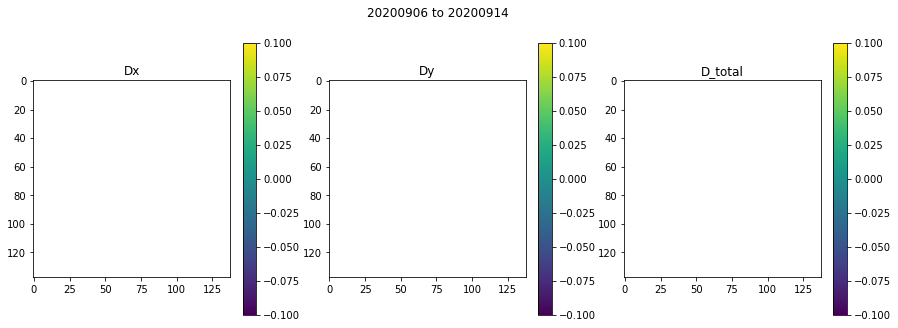

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014060020446777344
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

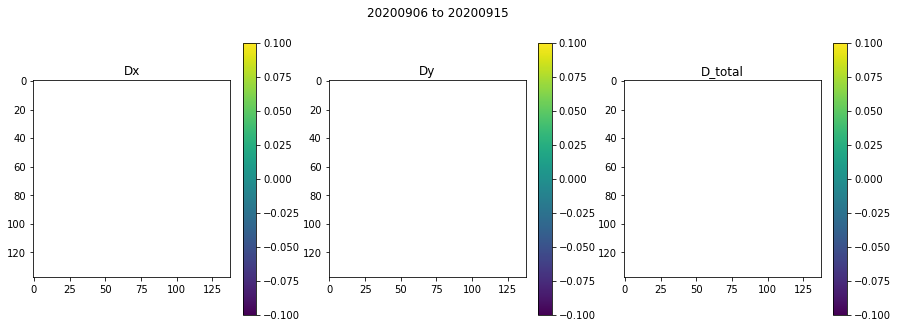

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012393951416015625
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

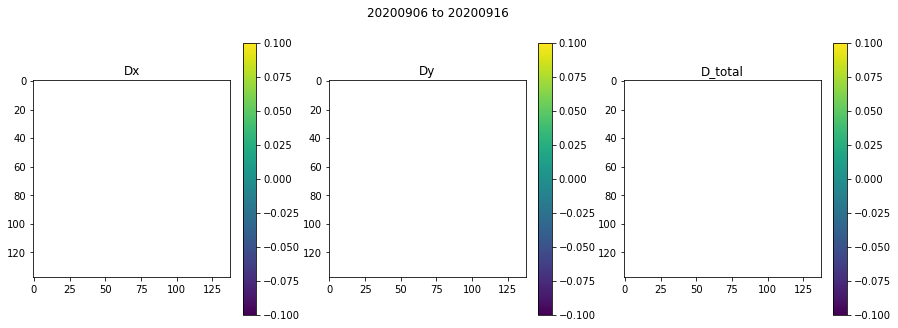

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010704994201660156
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

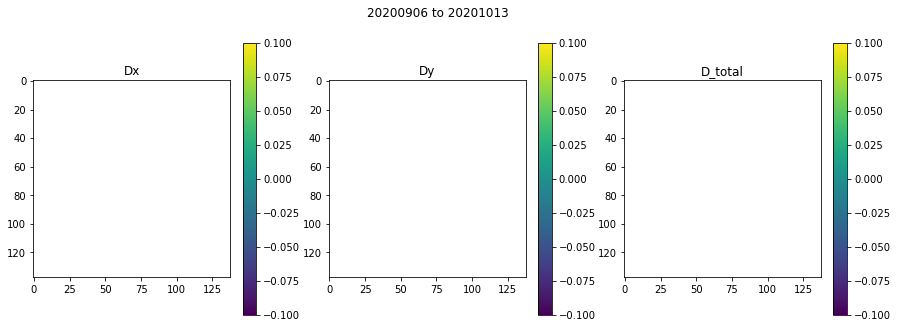

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010269880294799805
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

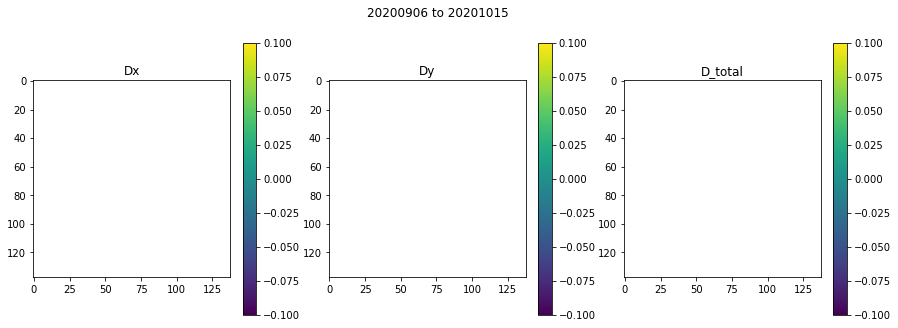

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015861034393310547
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

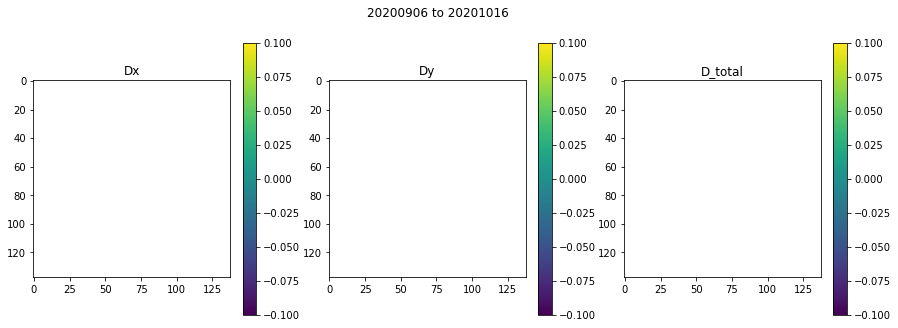

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011511087417602539
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

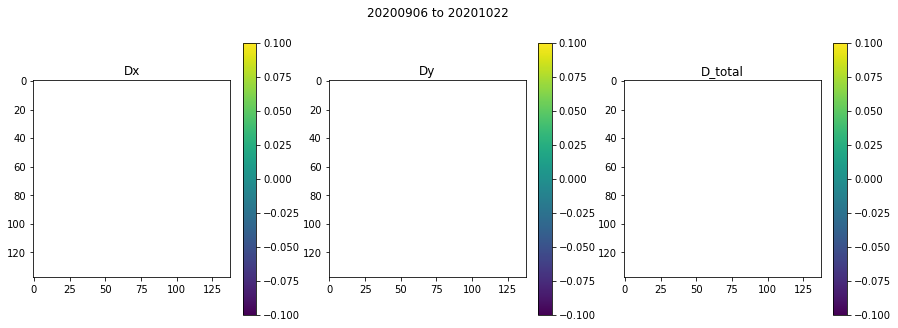

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010319709777832031
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

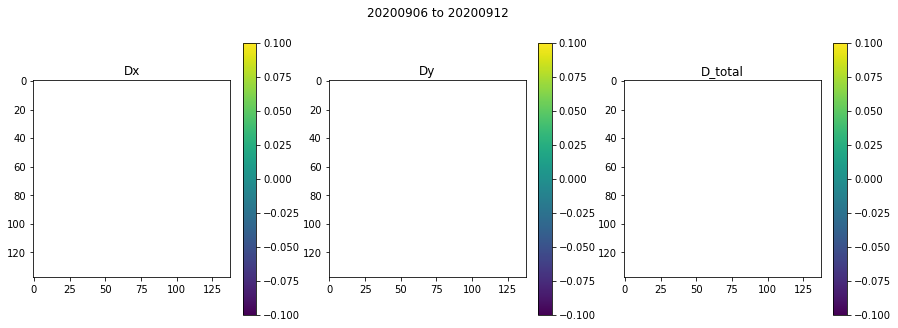

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010272026062011719
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

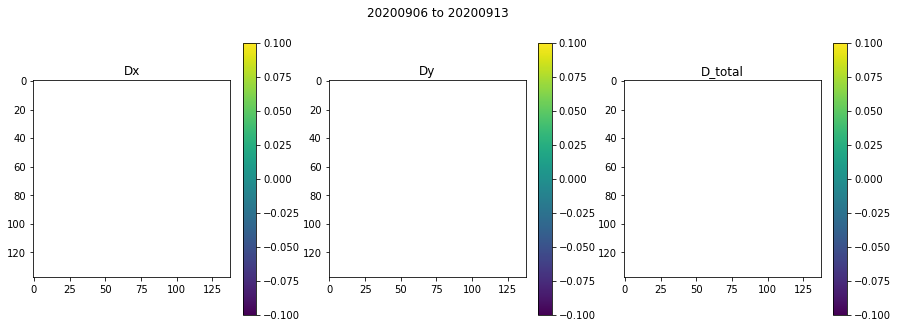

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010344743728637695
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

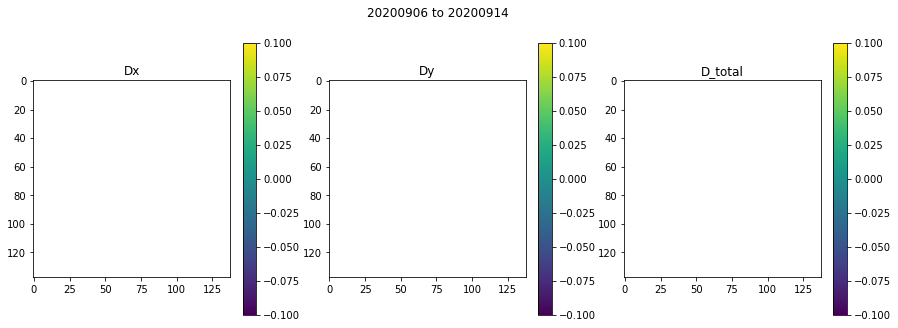

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010769128799438477
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

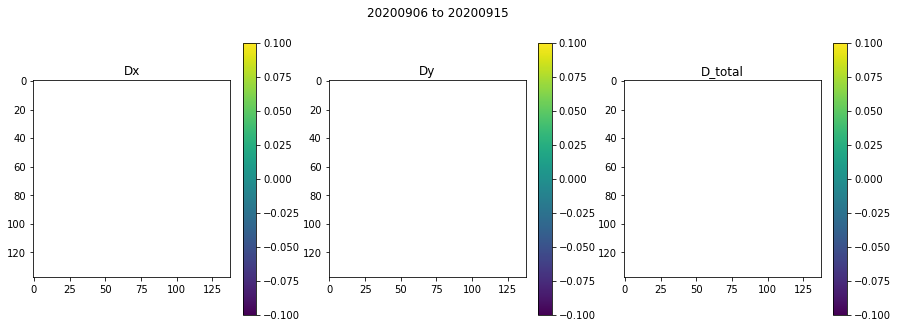

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014753103256225586
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

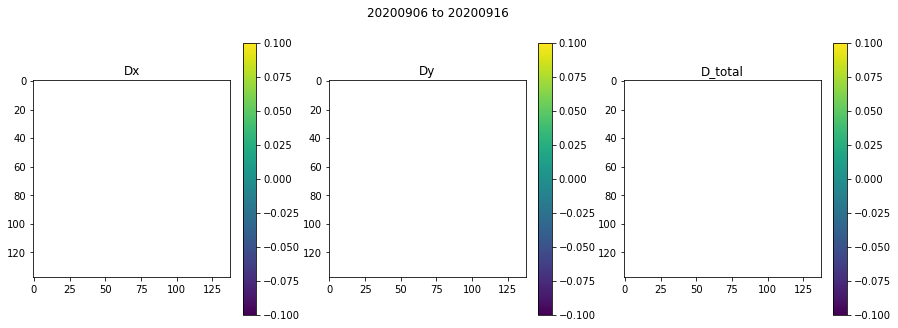

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01077413558959961
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

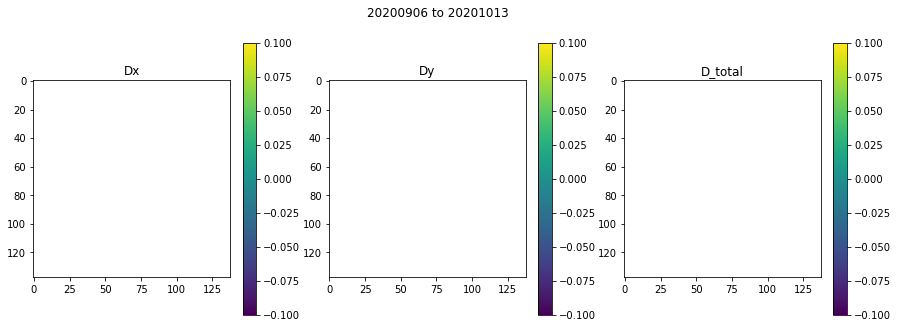

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010529756546020508
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

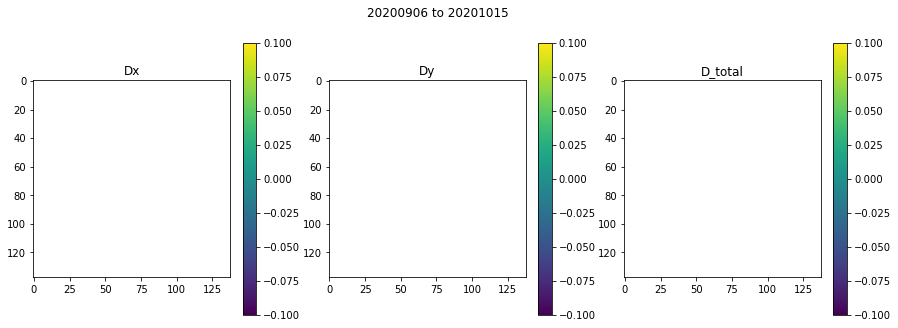

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014976978302001953
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

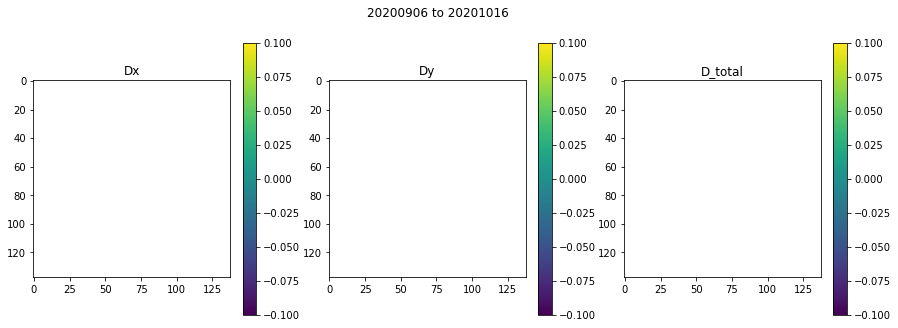

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010200023651123047
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

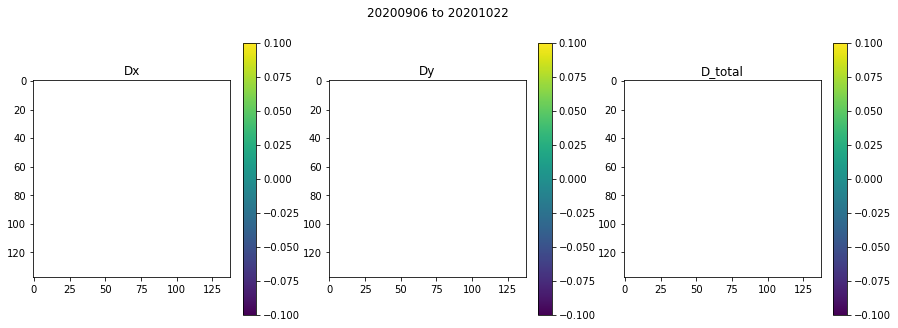

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01052093505859375
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

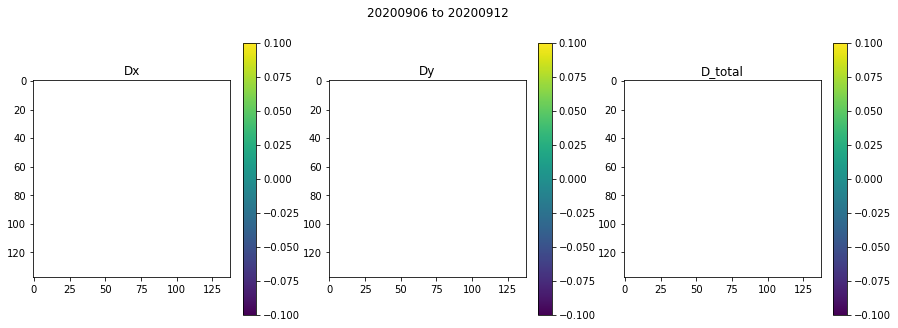

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012118101119995117
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

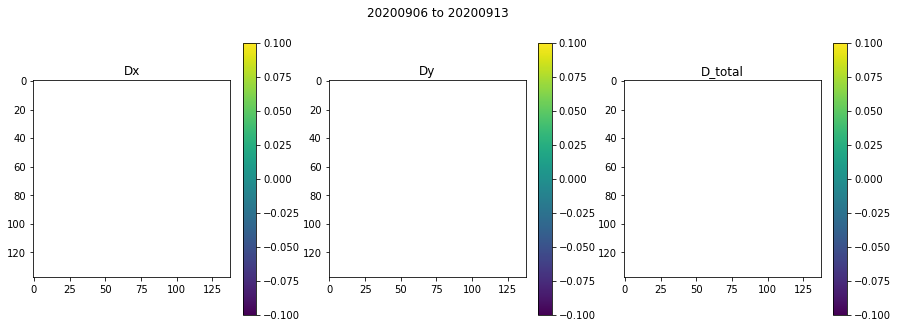

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010532140731811523
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

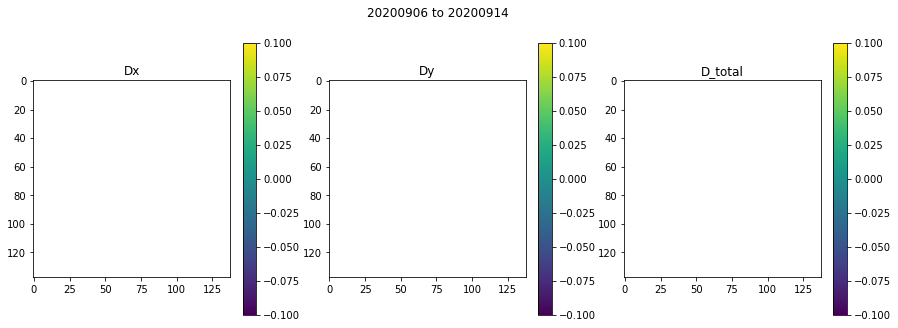

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010550975799560547
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

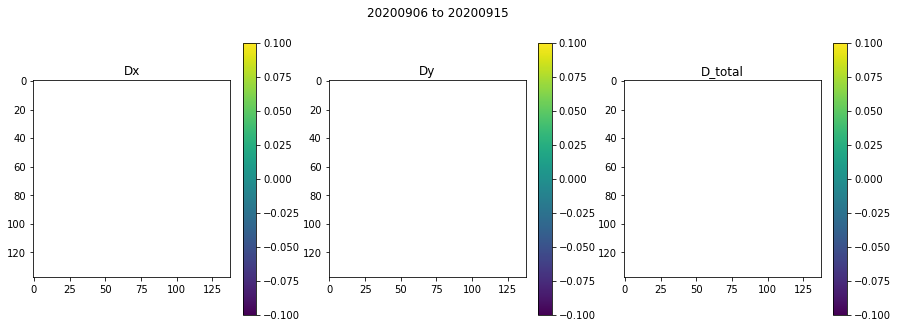

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010591983795166016
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

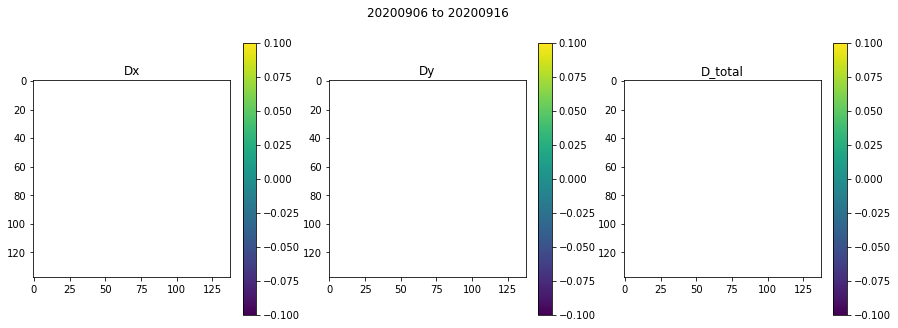

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01077413558959961
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

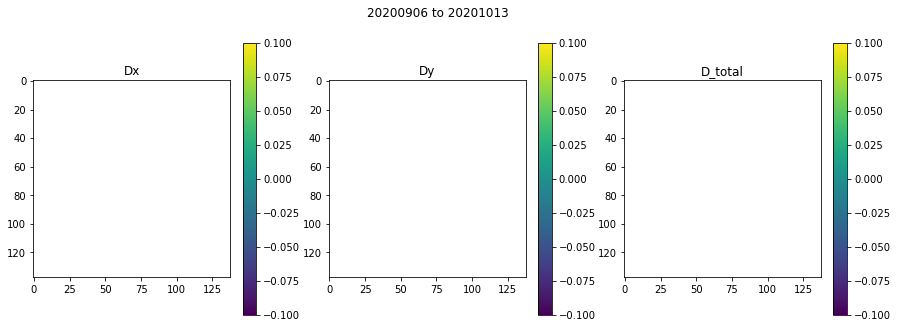

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015926122665405273
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

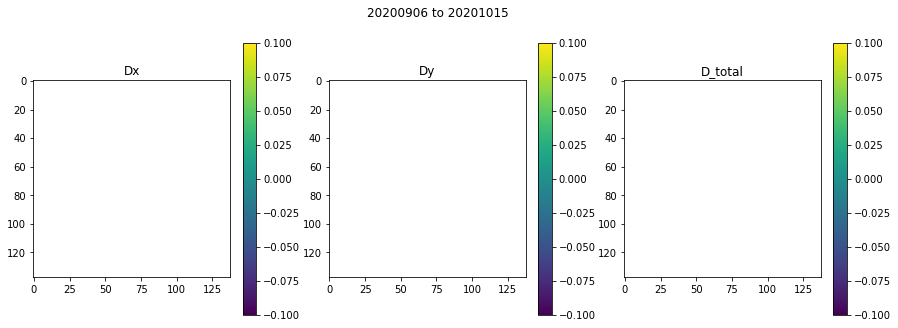

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.009994029998779297
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

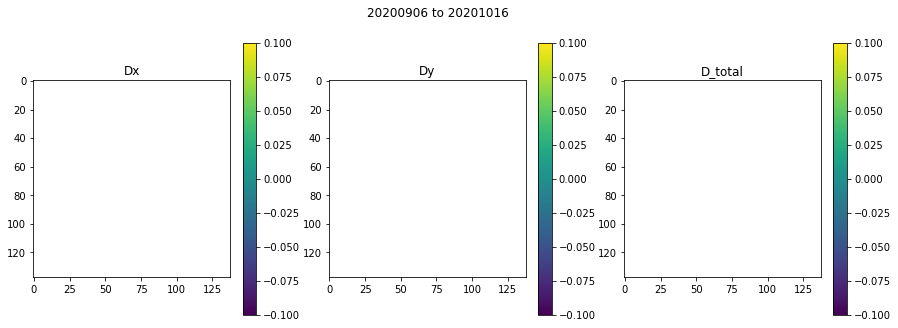

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010505199432373047
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

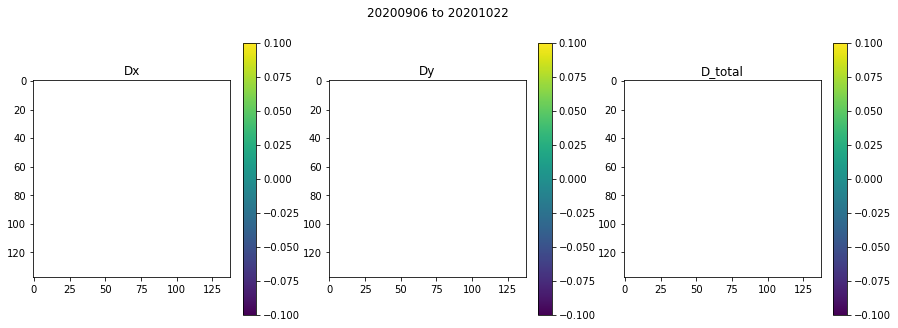

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01584792137145996
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

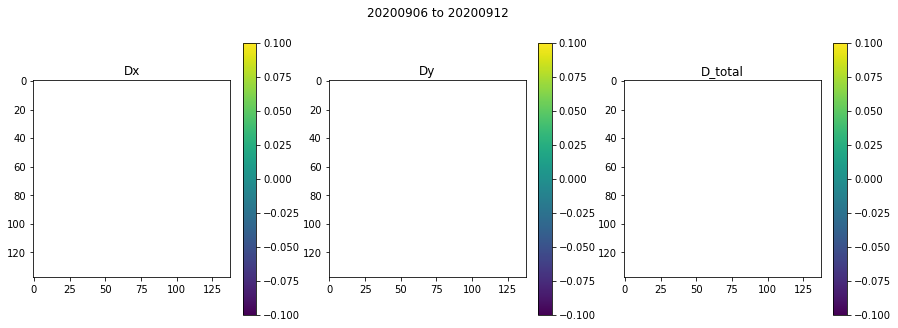

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010324954986572266
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

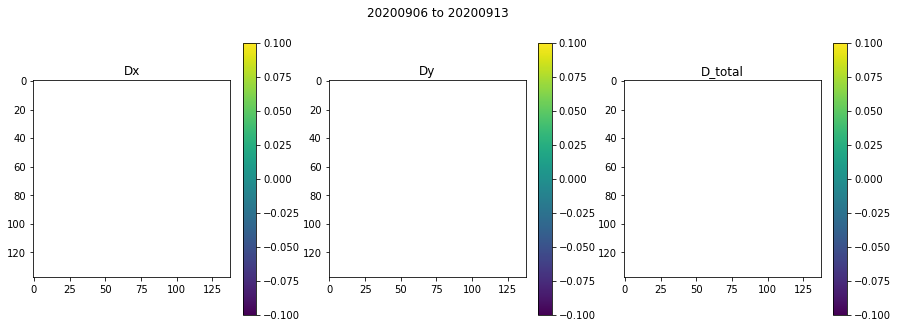

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01067209243774414
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

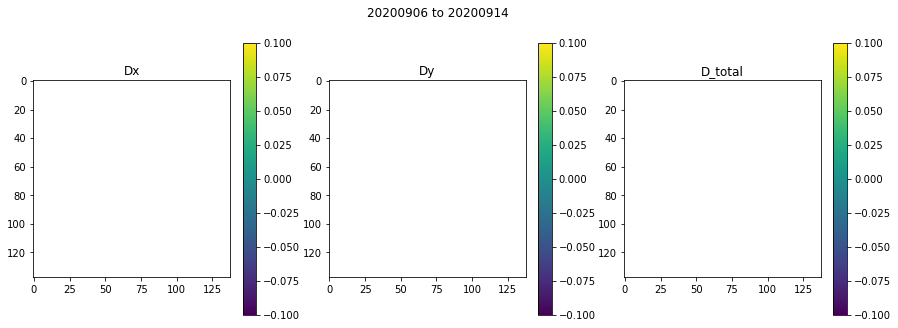

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015568256378173828
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

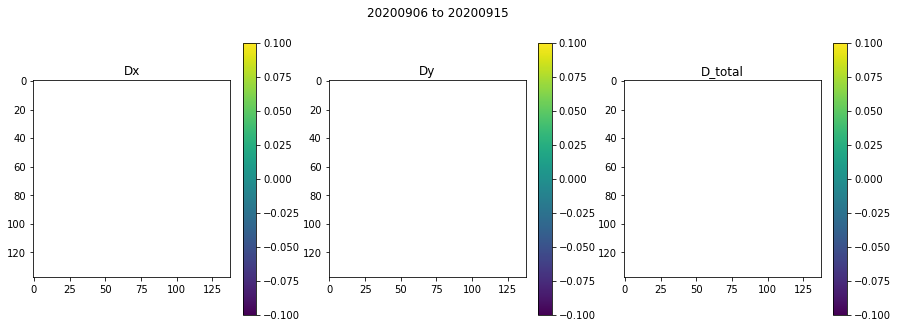

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011253118515014648
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

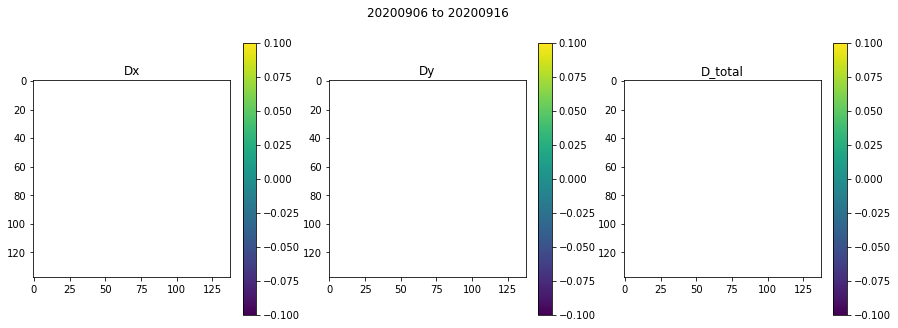

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014882087707519531
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

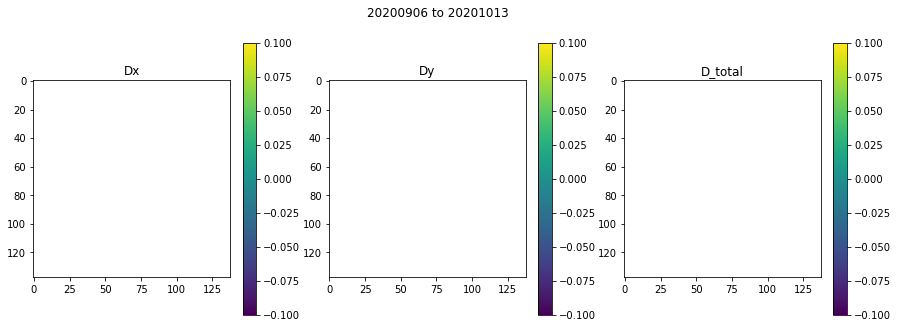

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.03479790687561035
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

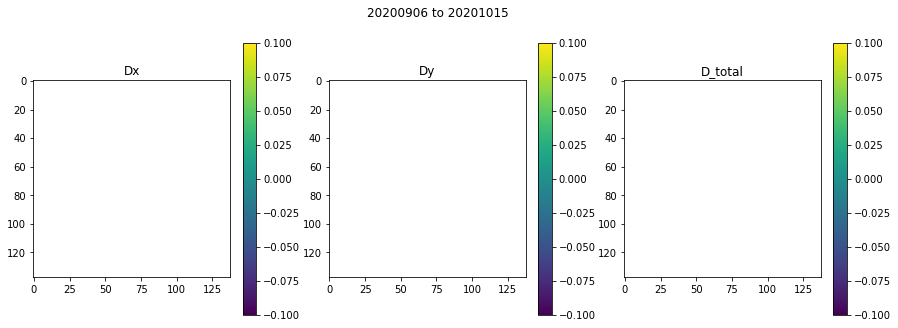

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010462045669555664
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

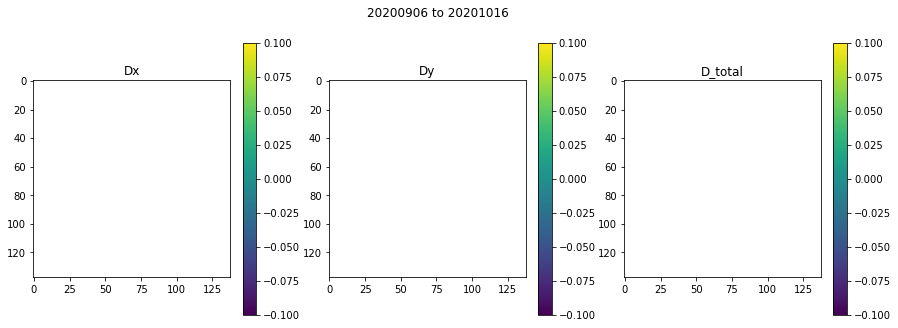

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015037775039672852
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

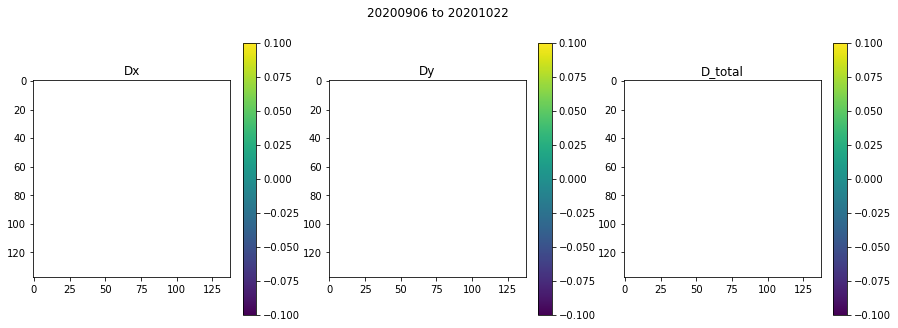

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011053800582885742
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

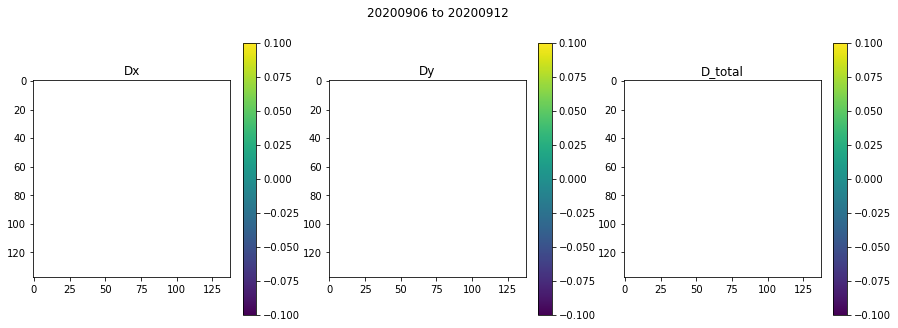

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.05377006530761719
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

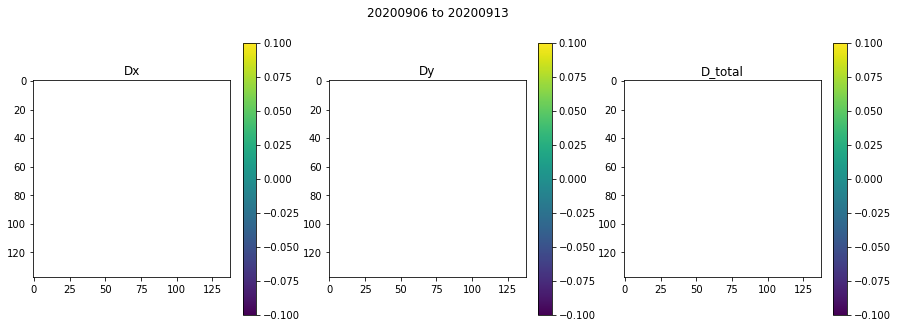

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010380744934082031
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

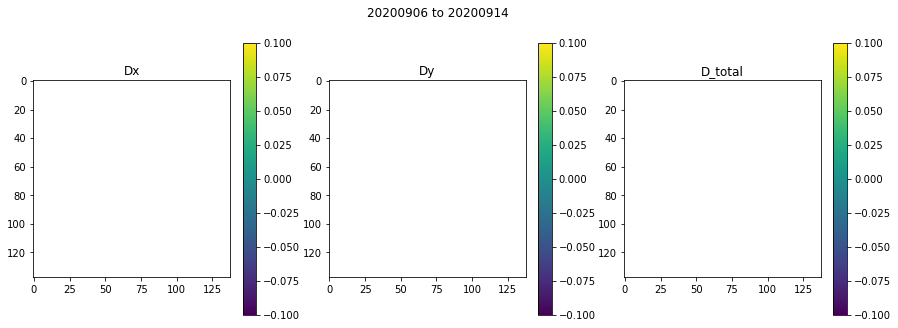

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01076197624206543
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

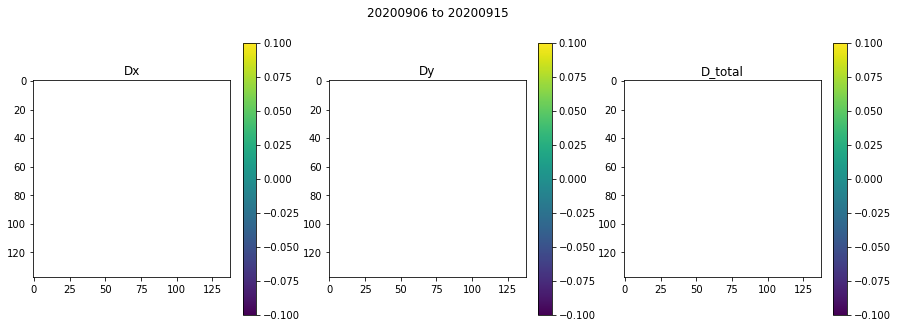

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010965347290039062
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

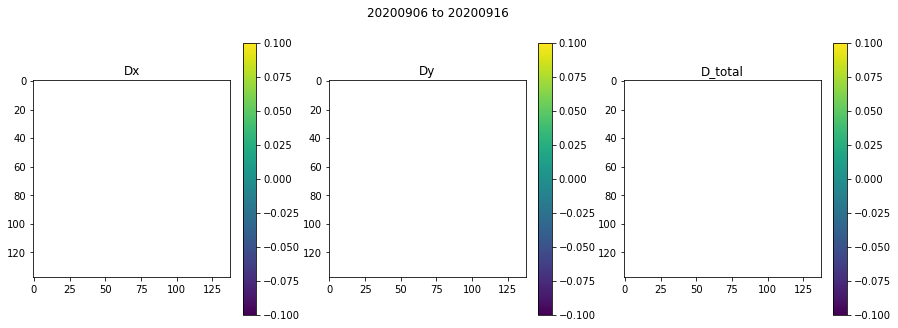

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010362863540649414
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

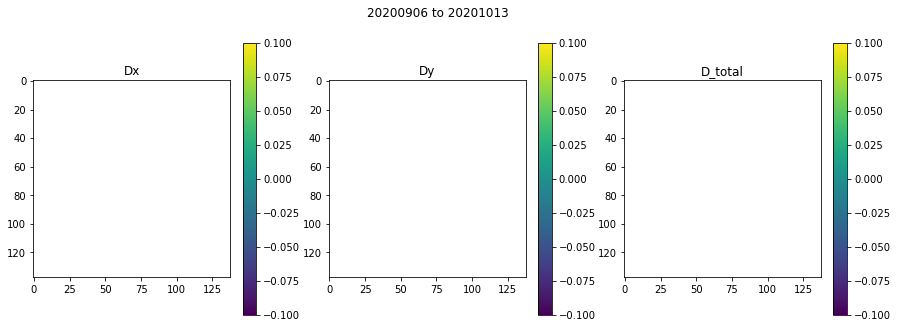

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010650157928466797
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

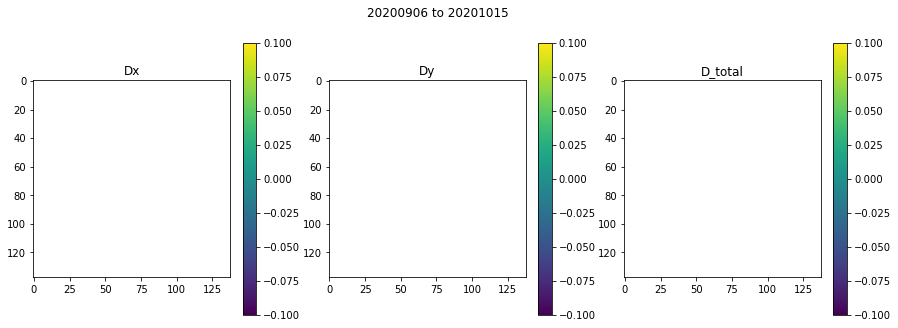

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01164698600769043
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

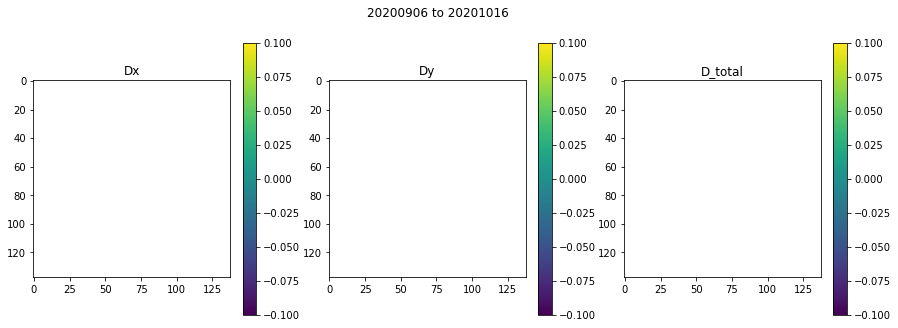

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010413646697998047
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

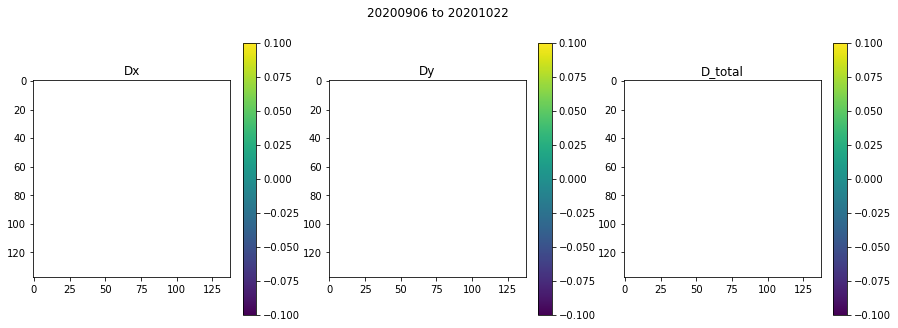

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011127948760986328
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

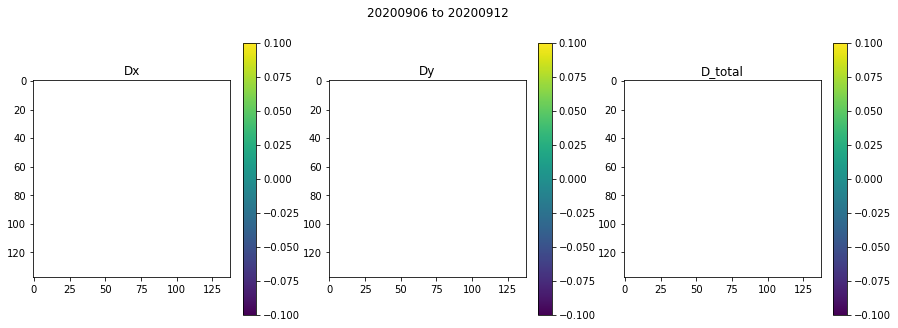

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01222991943359375
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

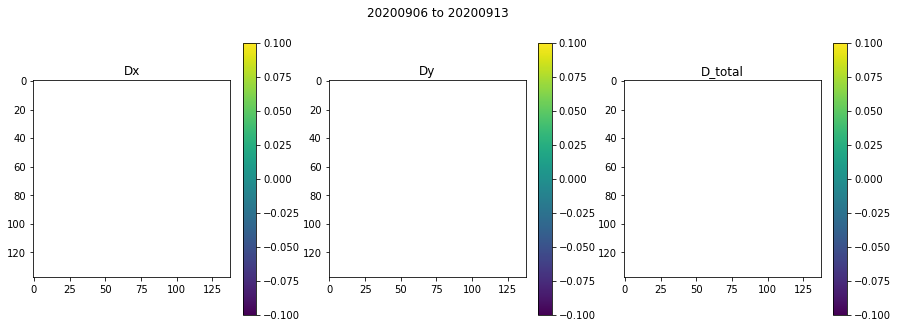

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016144752502441406
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

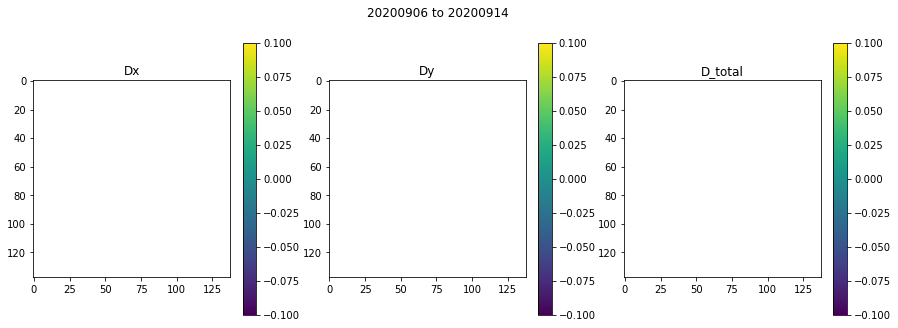

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014924764633178711
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

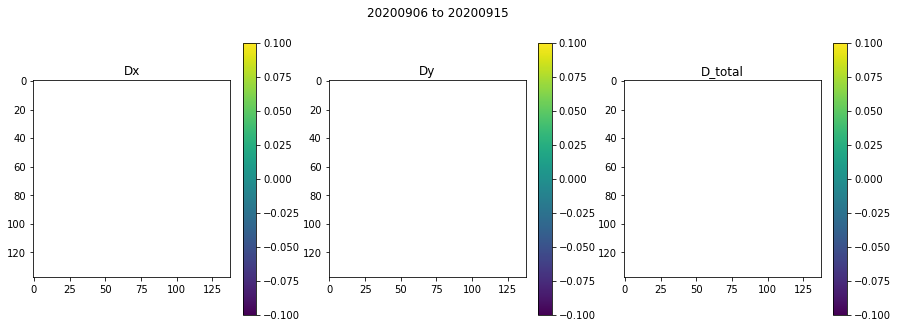

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010412931442260742
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

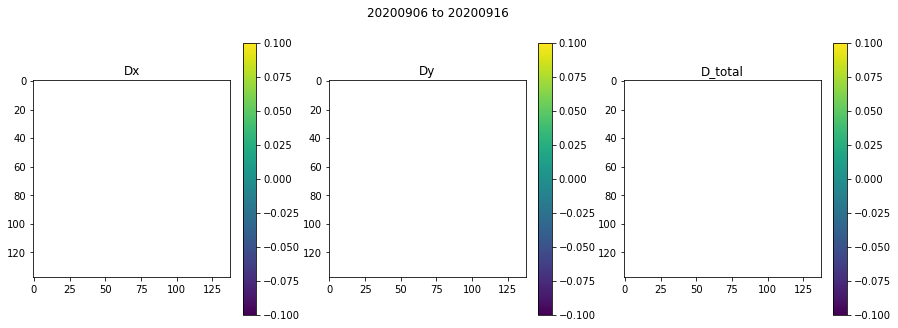

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.013449907302856445
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

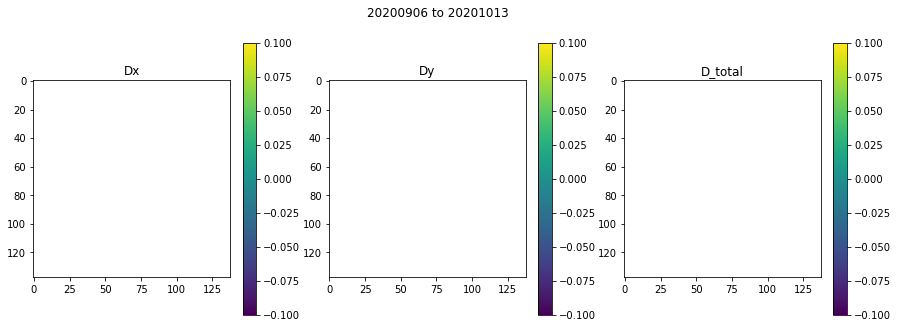

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01039886474609375
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

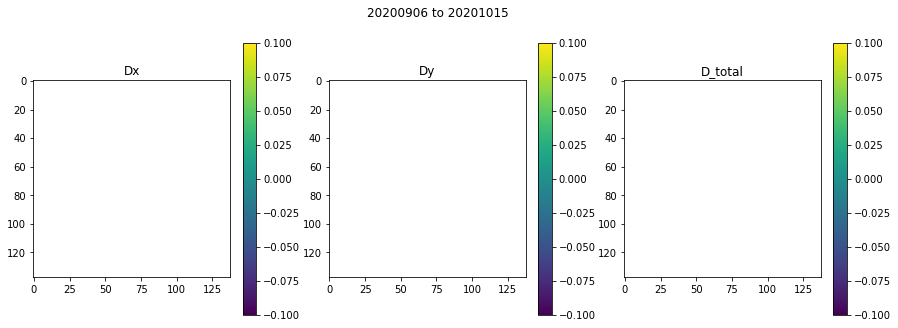

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010263204574584961
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

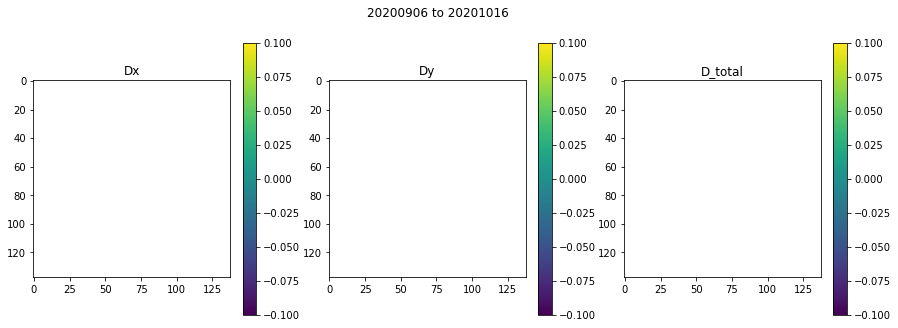

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015426158905029297
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

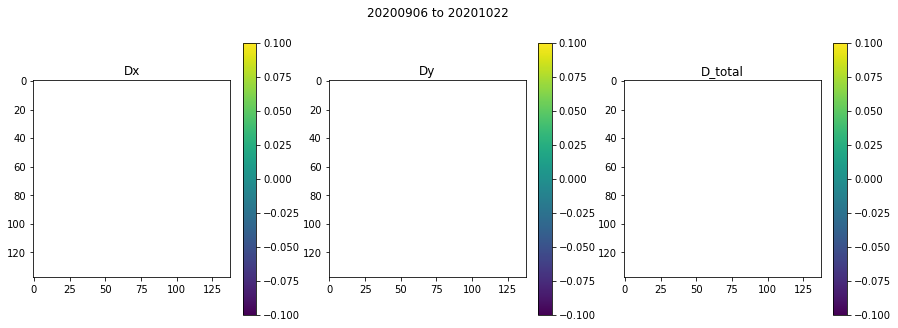

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.013049125671386719
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

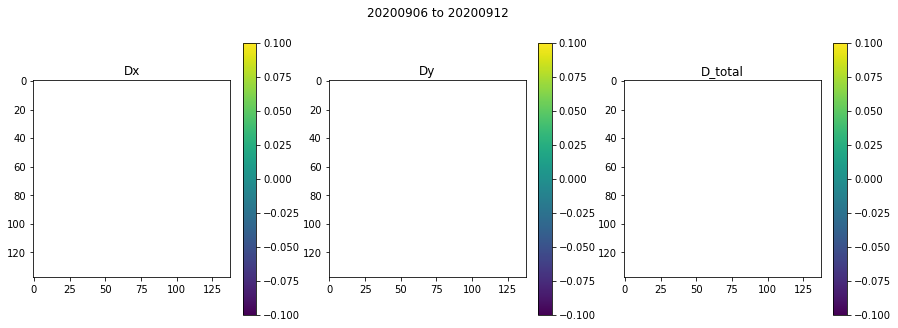

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014072895050048828
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

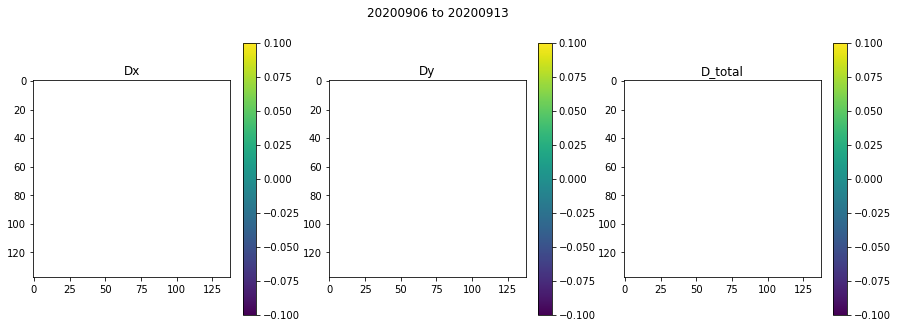

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010089397430419922
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

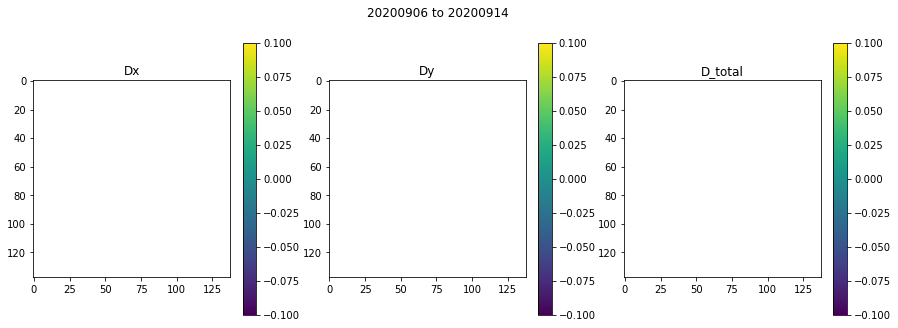

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012319087982177734
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

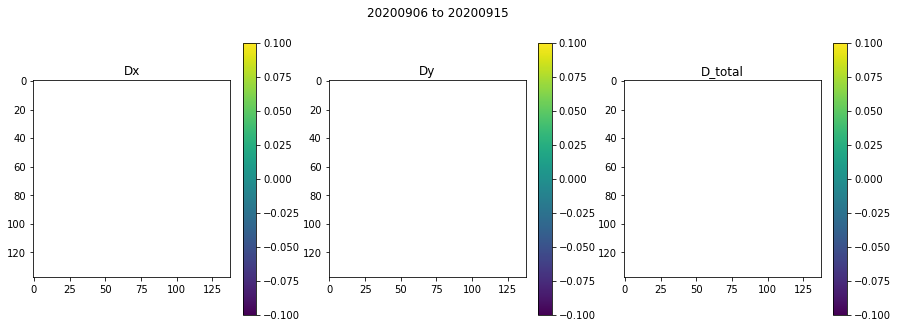

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010313987731933594
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

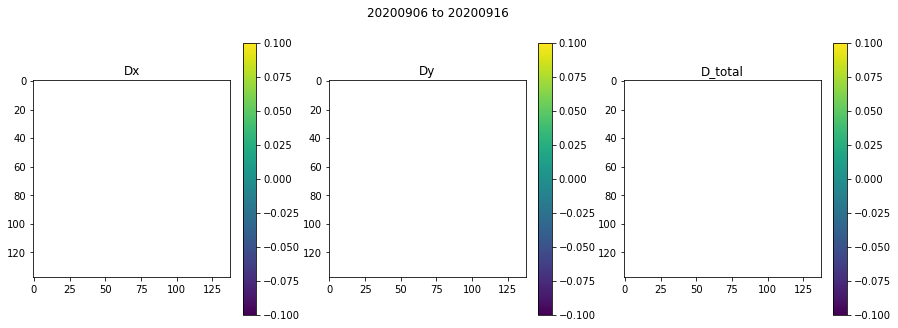

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01068115234375
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs

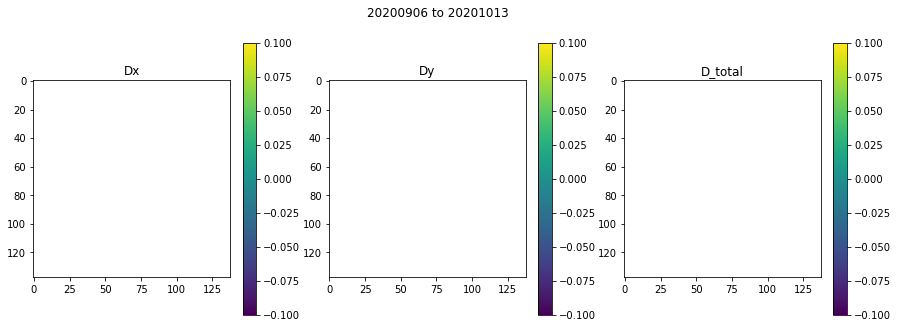

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016579866409301758
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

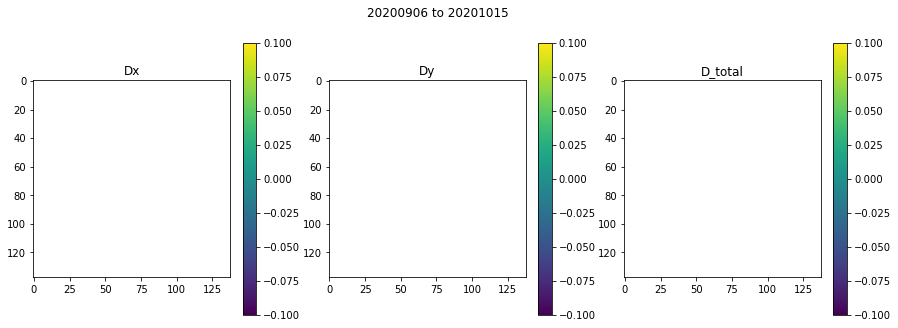

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014602899551391602
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

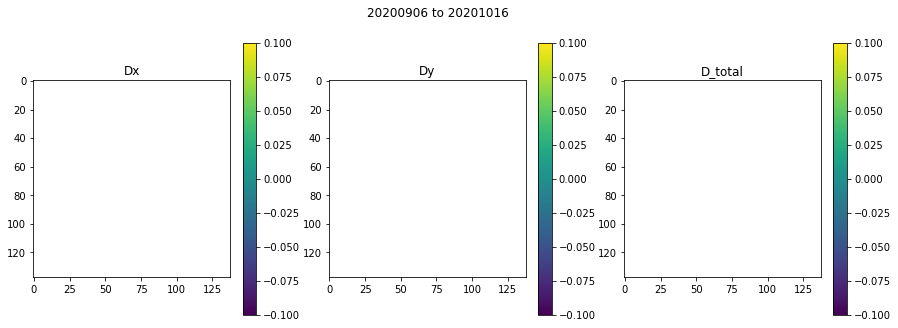

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01497507095336914
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

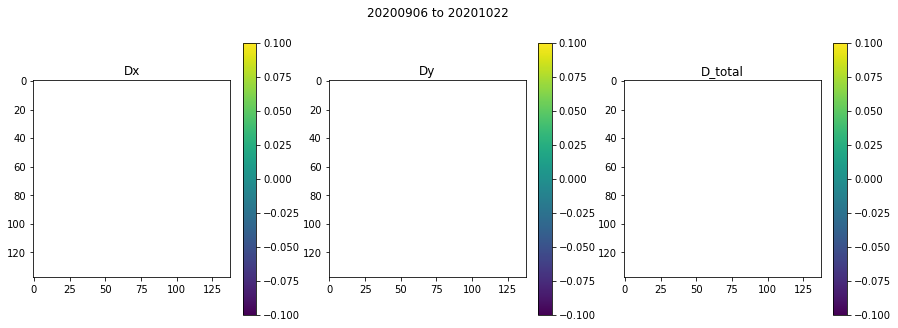

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014816045761108398
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

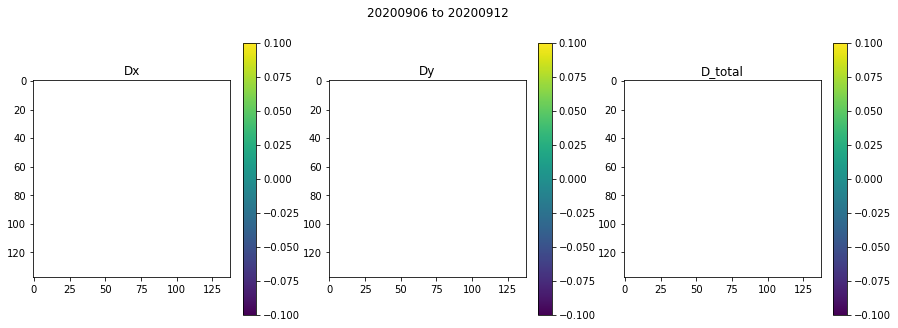

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010479211807250977
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

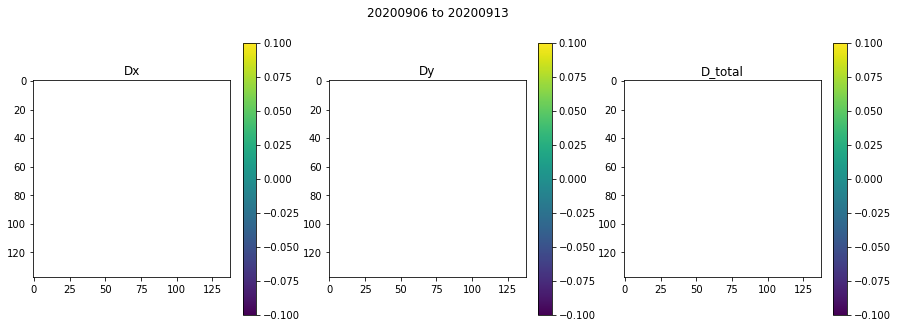

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018927812576293945
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

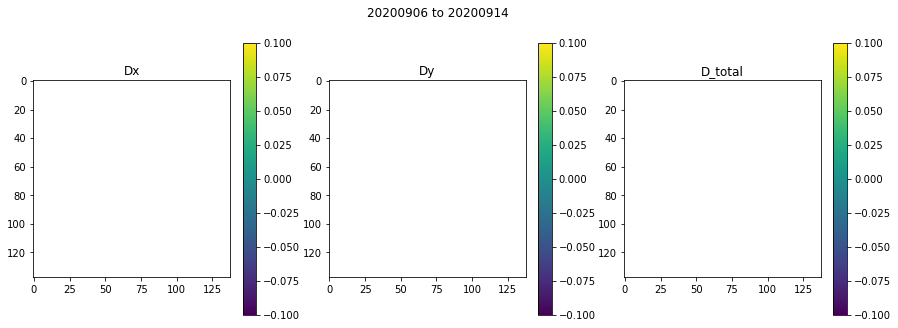

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010164976119995117
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

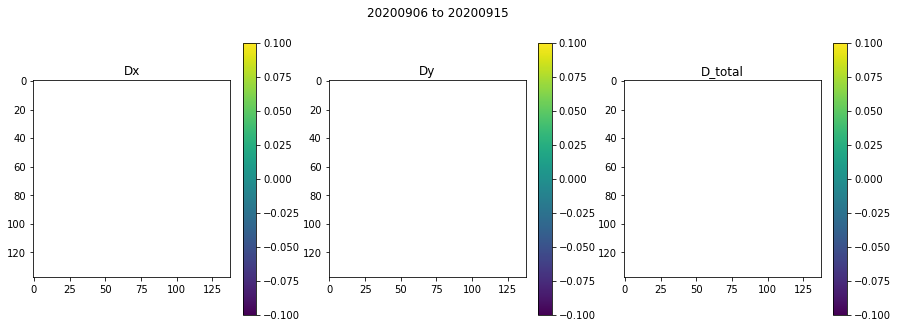

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010276079177856445
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

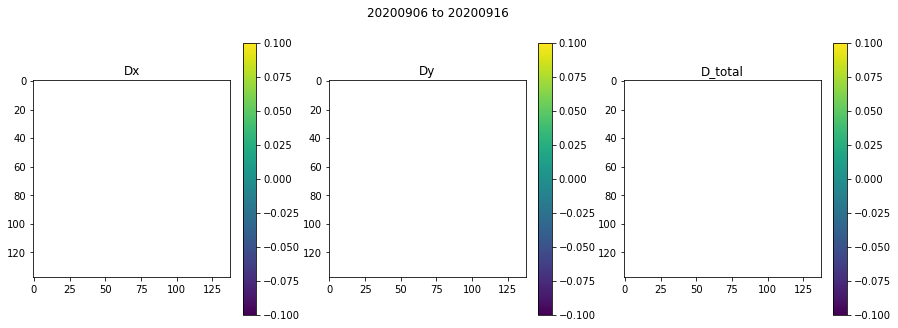

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010862112045288086
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

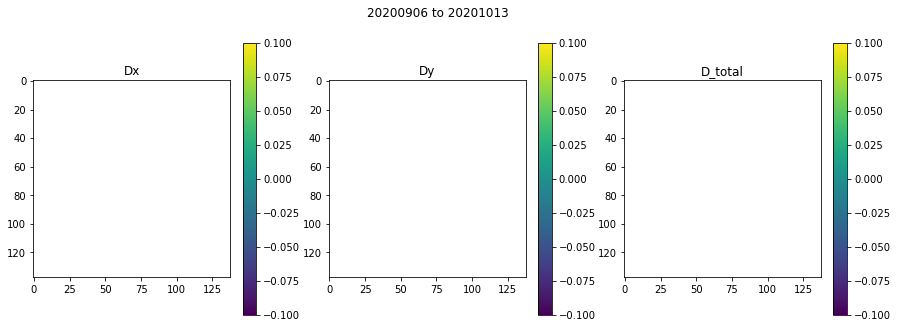

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010891914367675781
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

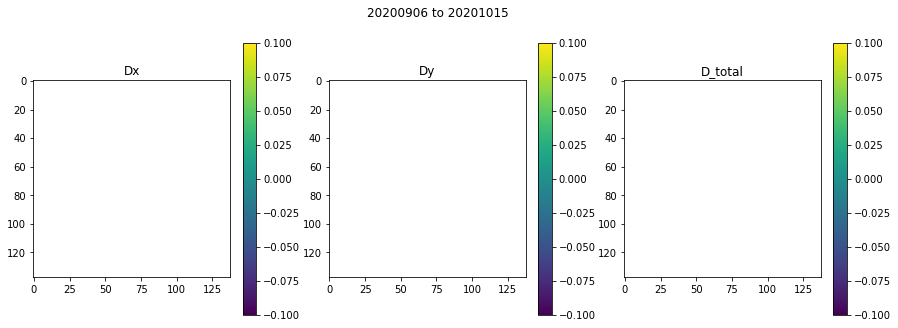

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010330915451049805
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

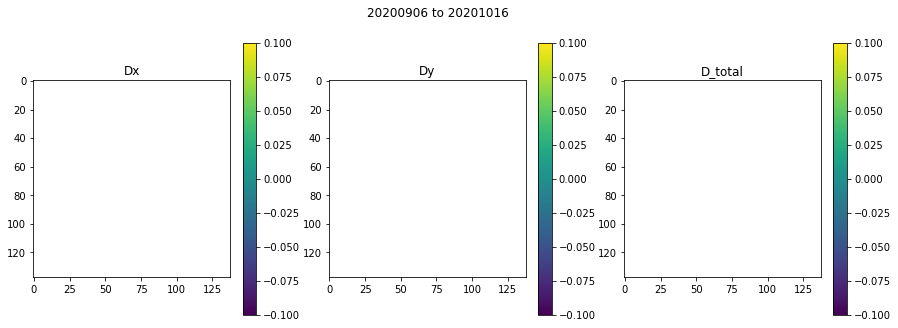

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011745214462280273
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

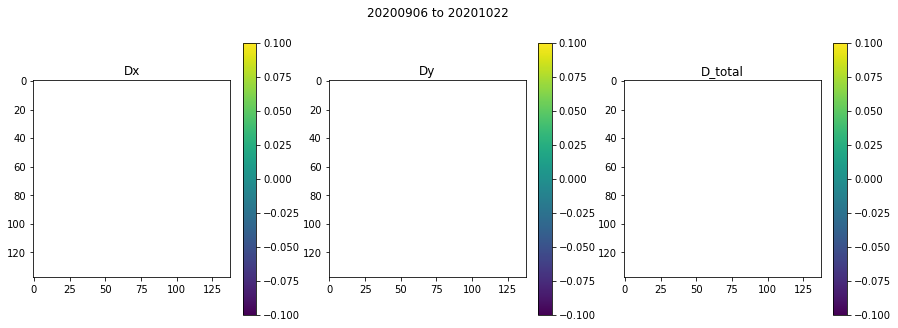

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010724782943725586
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

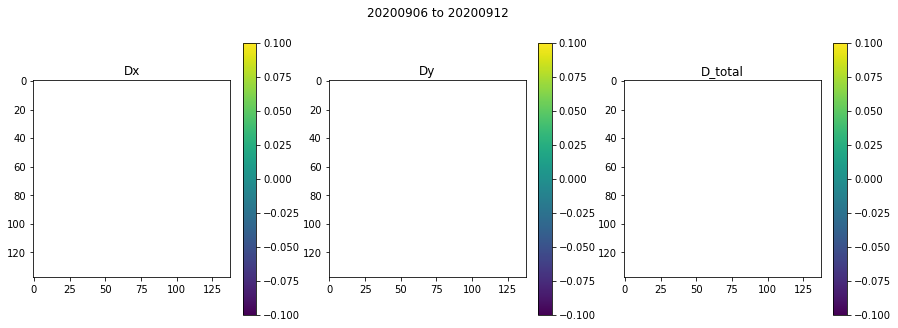

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016221046447753906
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

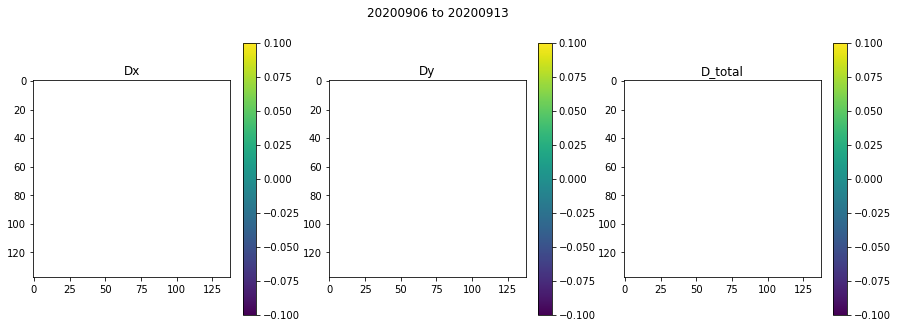

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02079010009765625
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

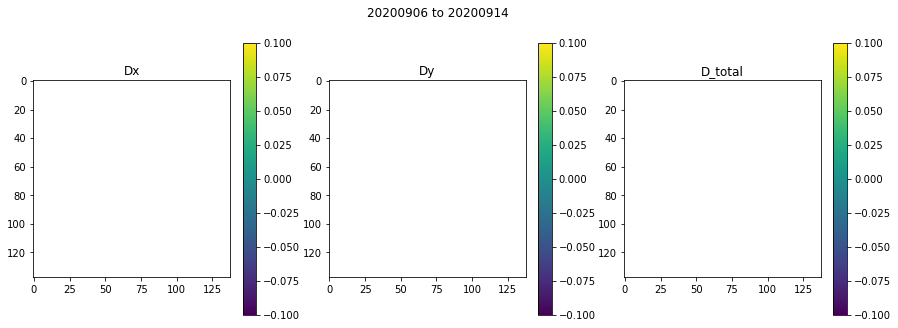

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010113000869750977
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

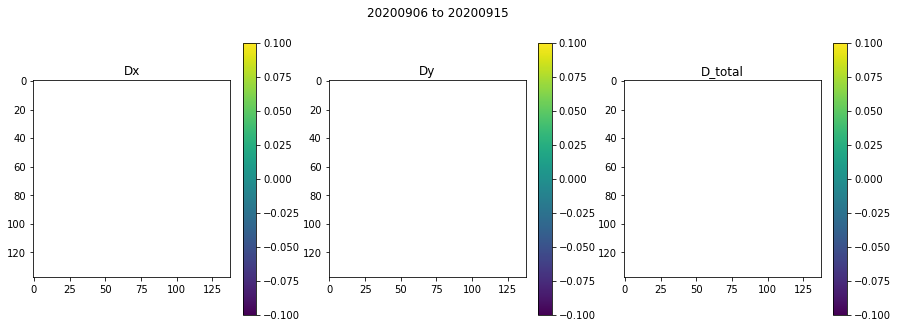

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.013496160507202148
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

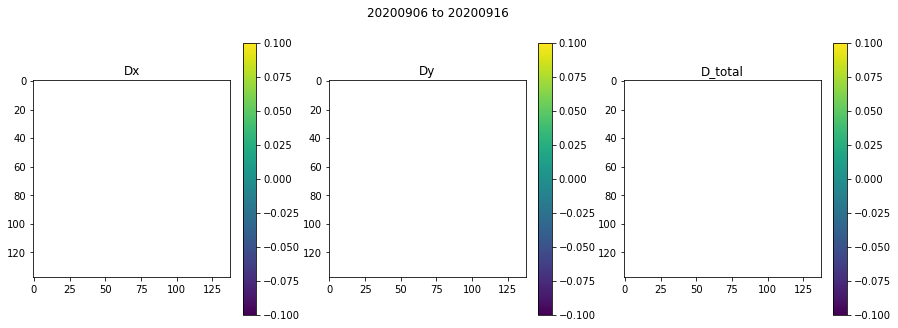

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010268926620483398
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

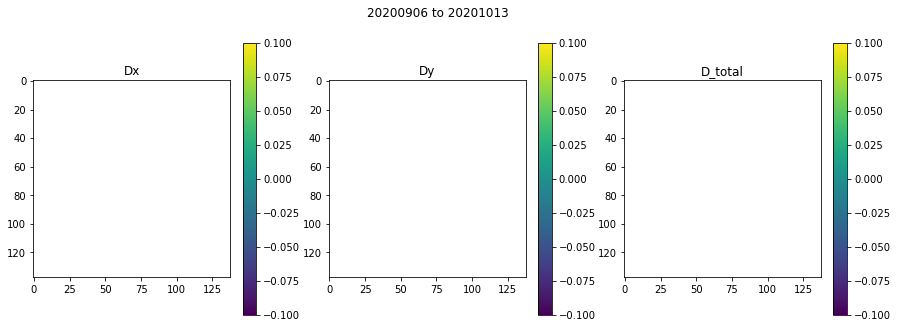

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010766029357910156
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

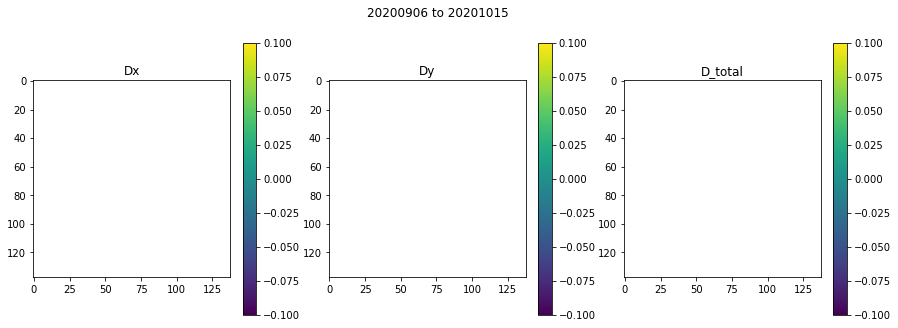

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011159181594848633
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

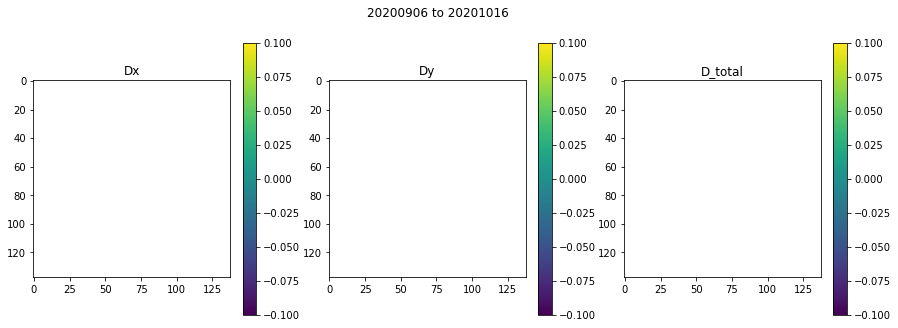

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010711908340454102
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

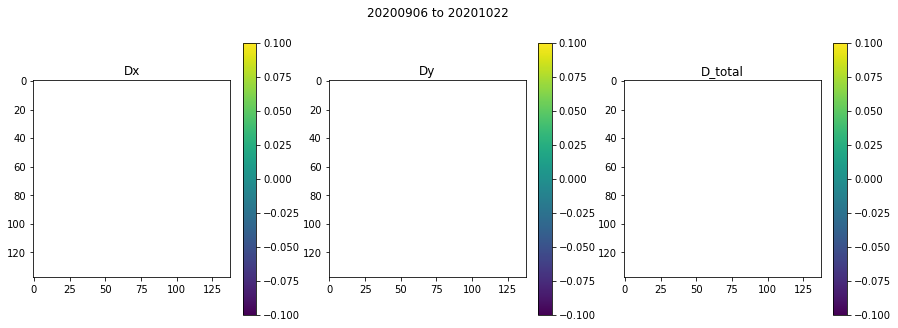

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010442018508911133
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

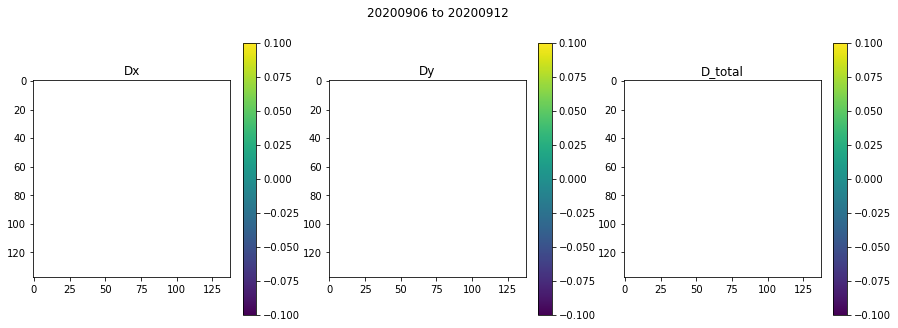

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01064610481262207
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

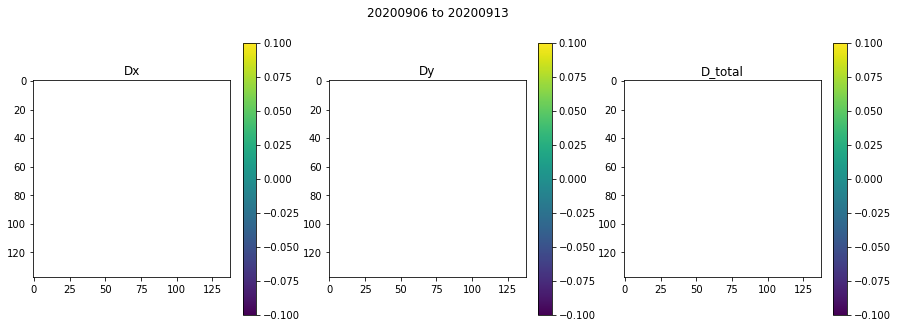

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010763168334960938
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

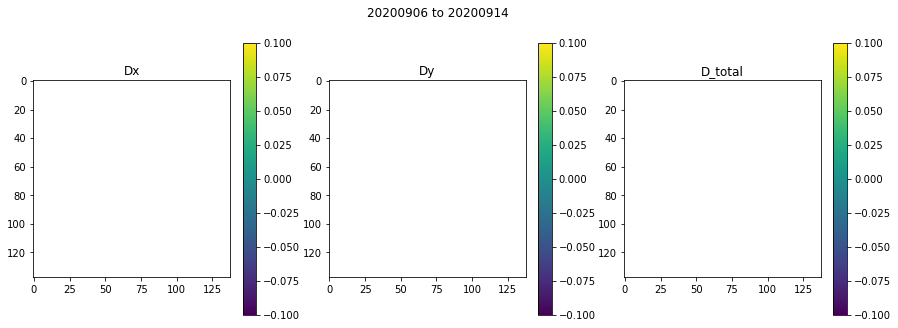

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010945796966552734
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

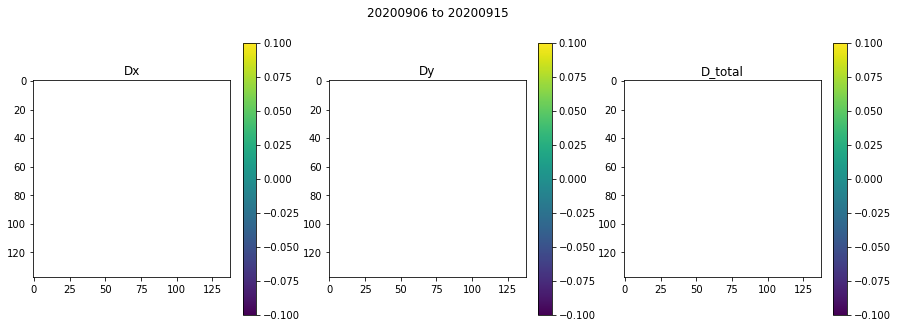

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012609004974365234
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

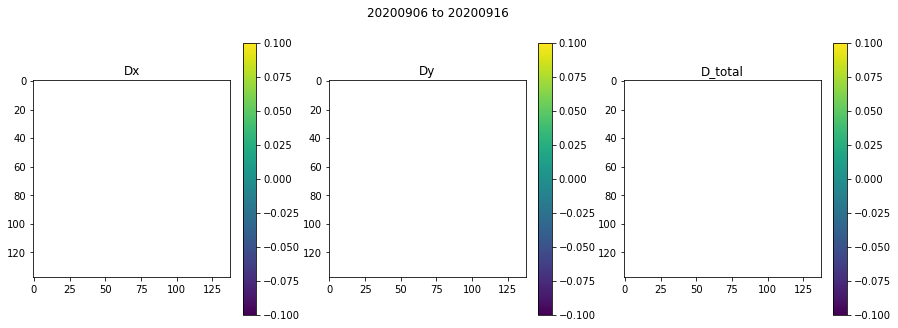

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012941837310791016
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

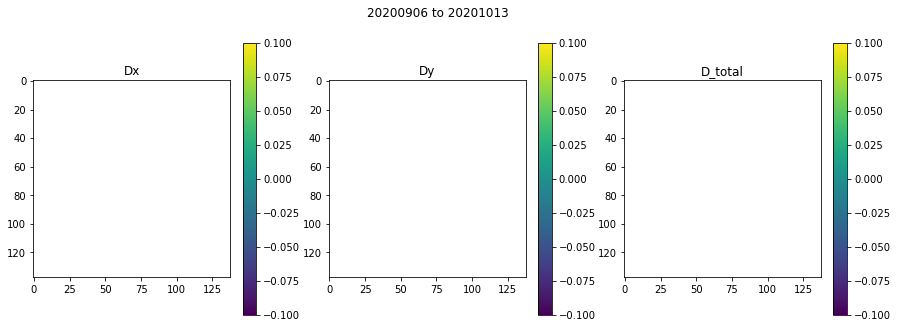

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015166044235229492
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

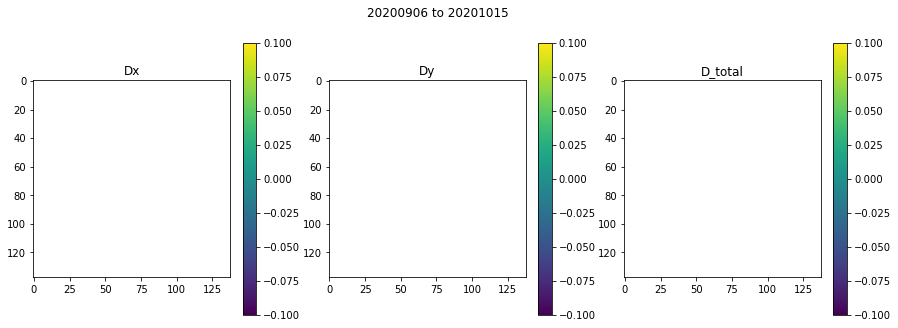

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011491775512695312
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

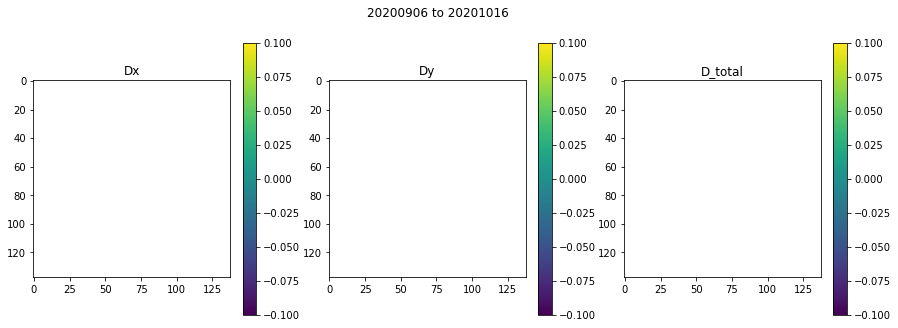

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.00960397720336914
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

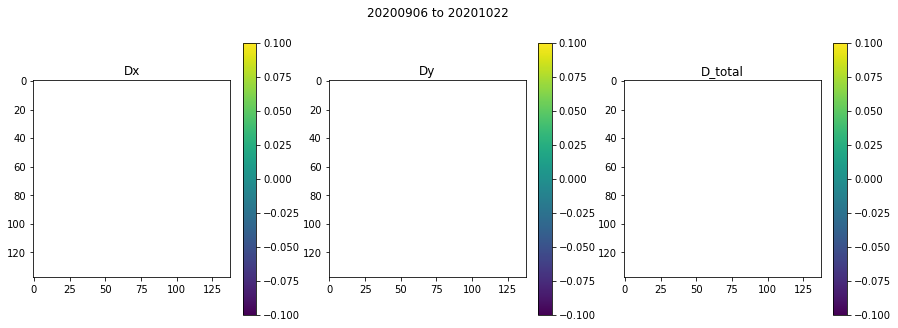

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010583162307739258
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

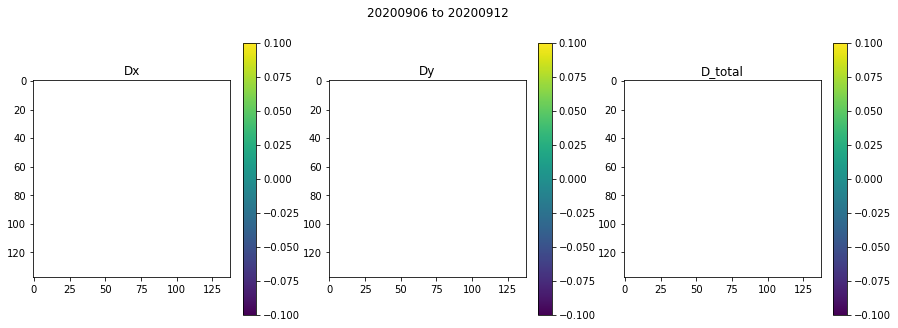

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010488033294677734
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

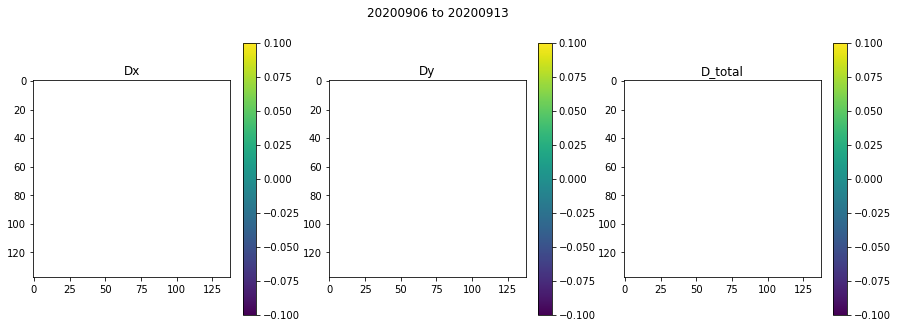

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02145981788635254
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

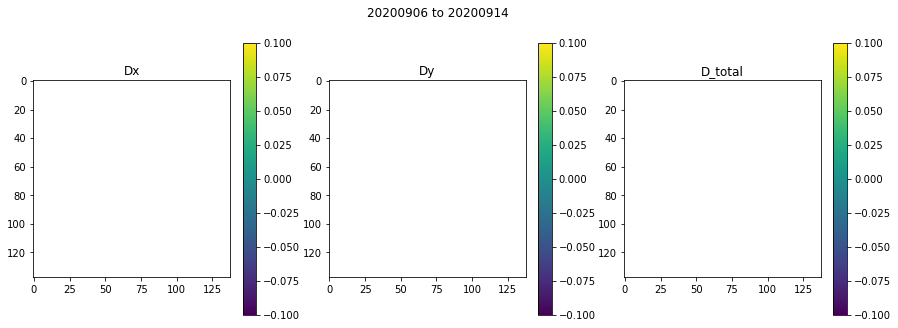

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010135173797607422
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

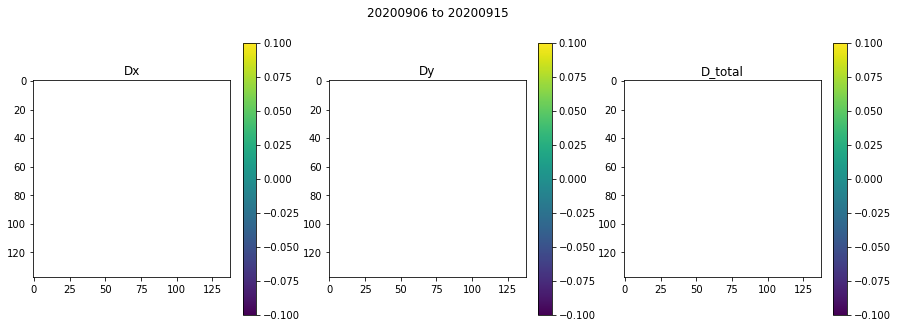

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01407003402709961
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

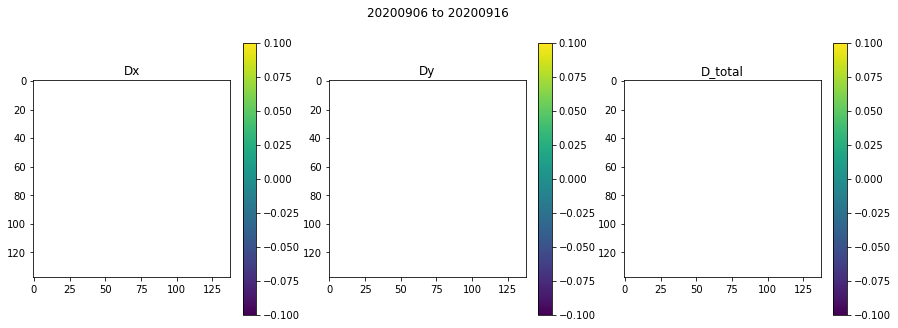

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010113954544067383
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

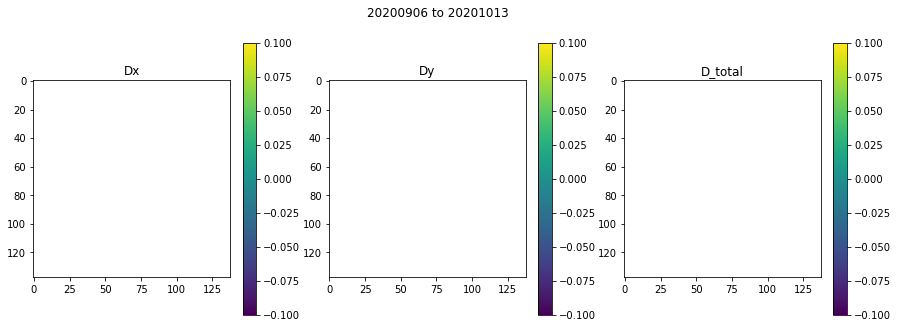

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01628875732421875
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

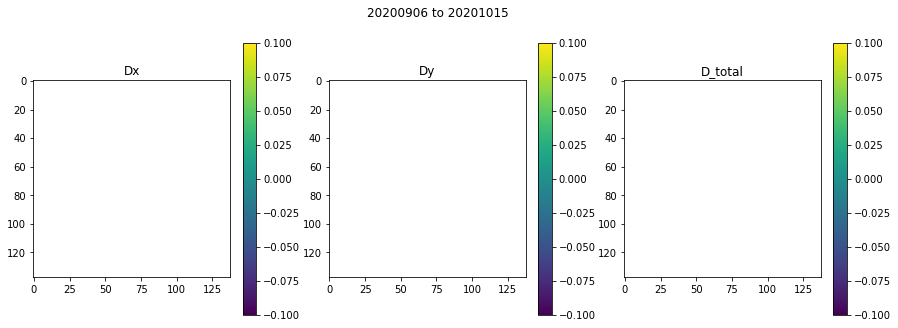

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010545969009399414
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

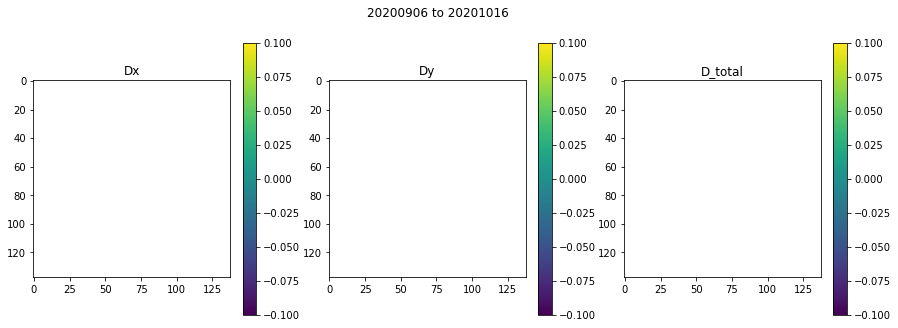

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011040210723876953
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

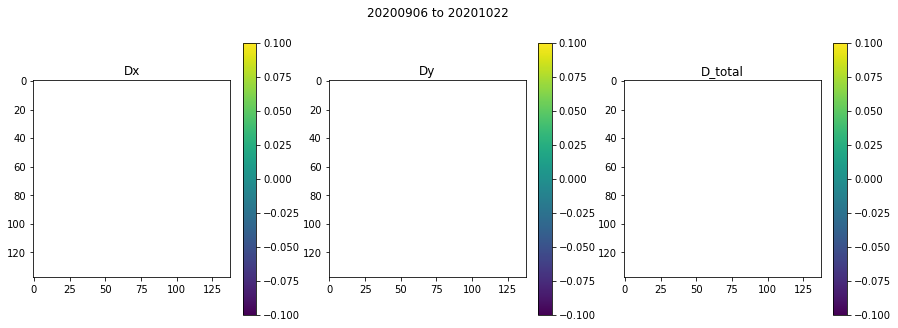

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015283823013305664
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

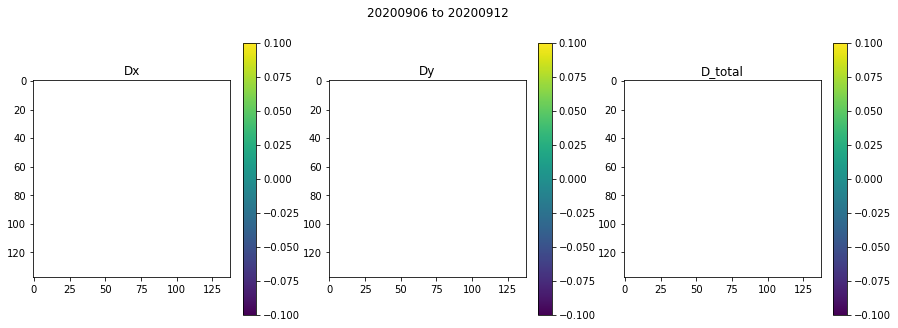

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010985136032104492
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

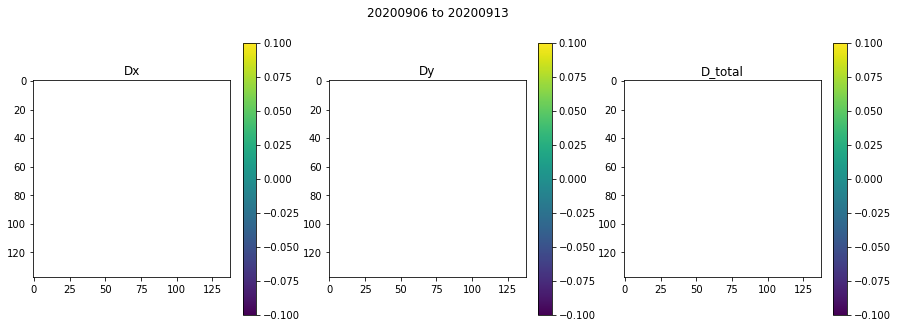

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019421100616455078
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

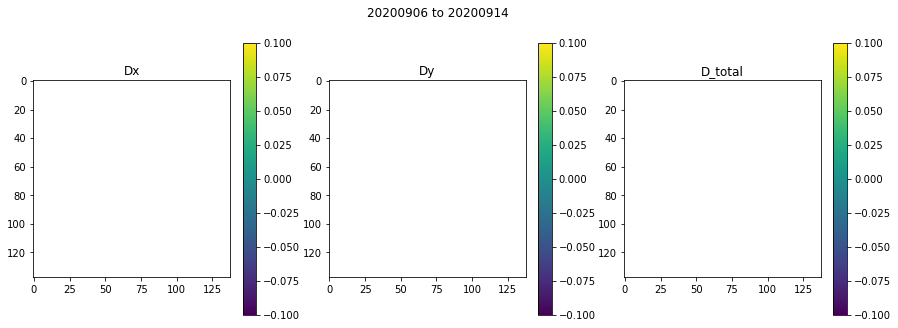

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016543865203857422
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

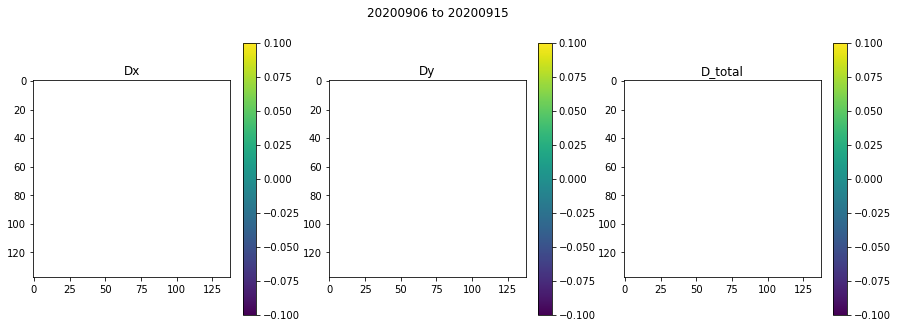

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010587930679321289
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

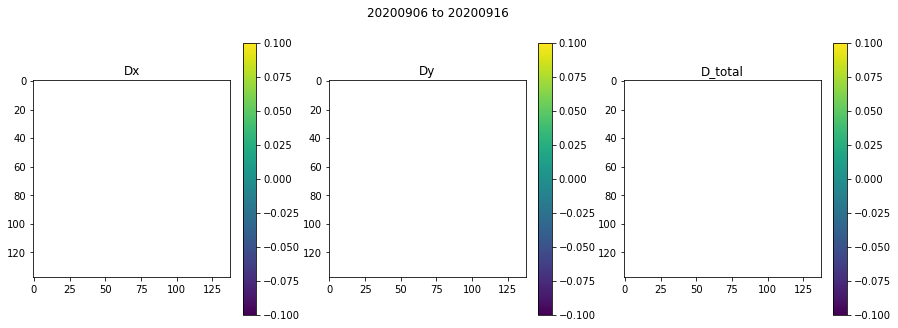

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017008304595947266
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

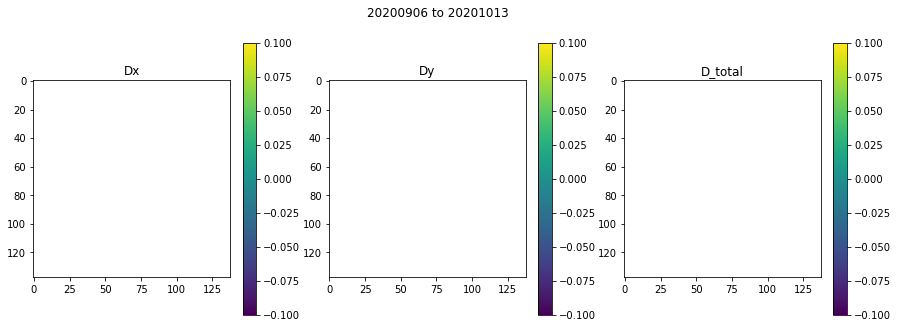

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015531063079833984
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

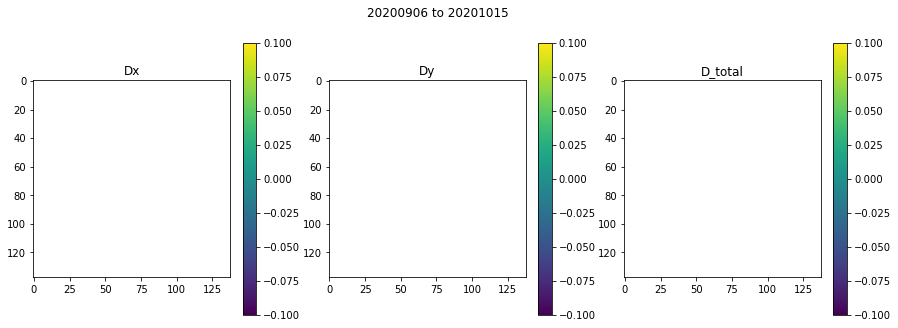

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010477066040039062
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

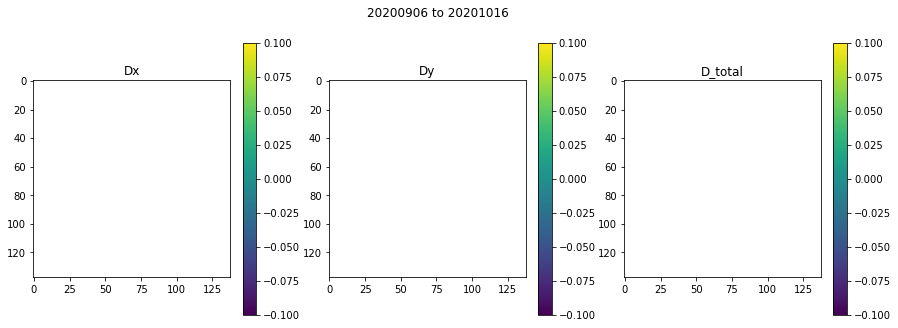

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011558055877685547
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

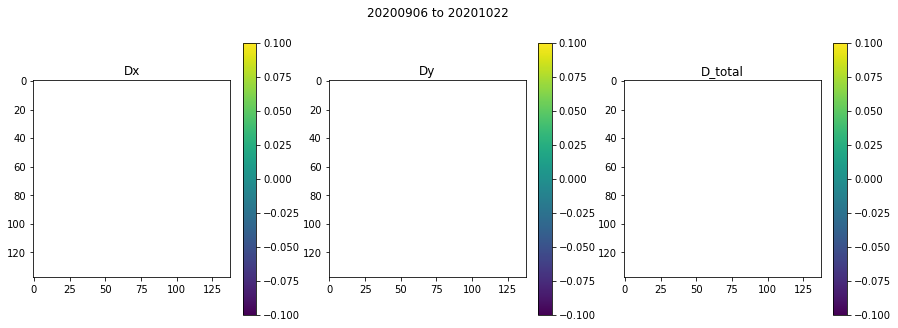

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010483980178833008
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

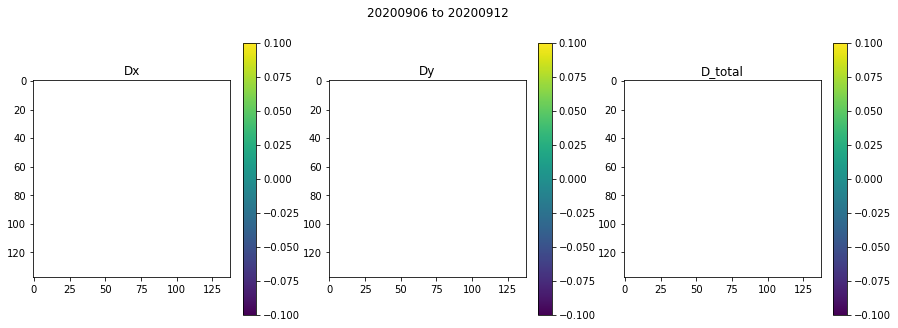

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0156862735748291
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEM

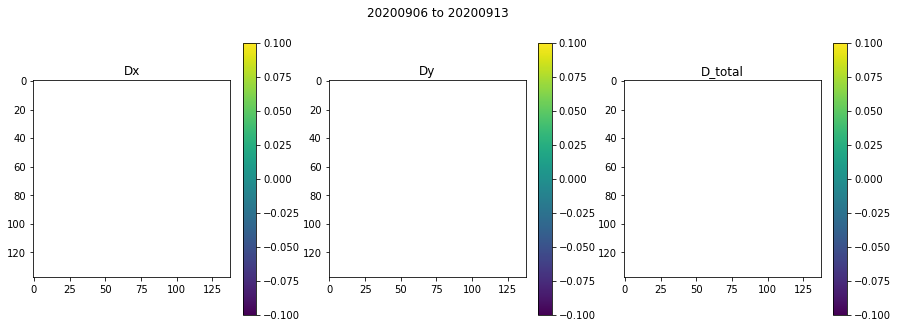

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016458749771118164
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

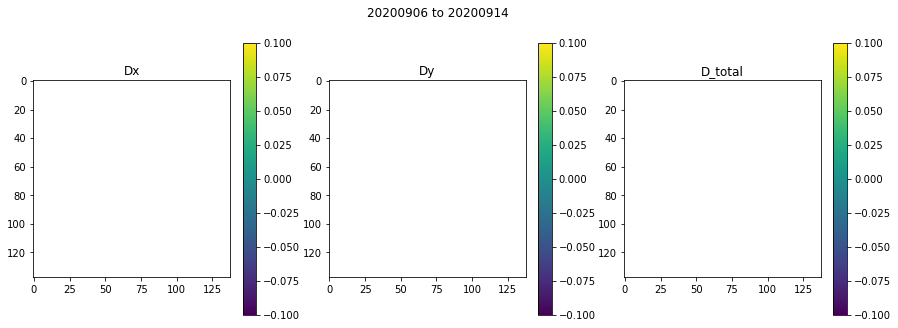

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011522054672241211
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

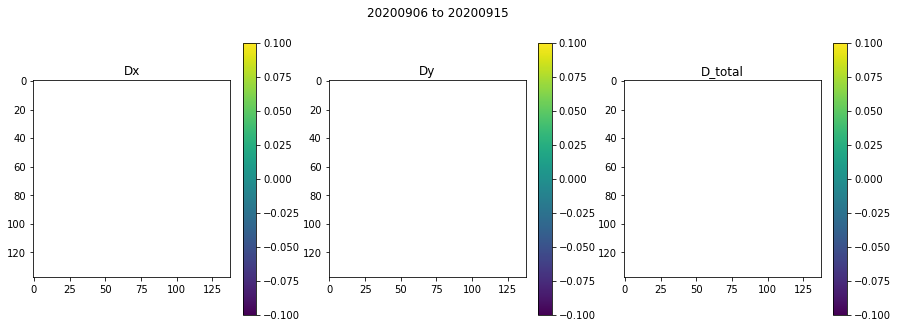

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016237735748291016
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

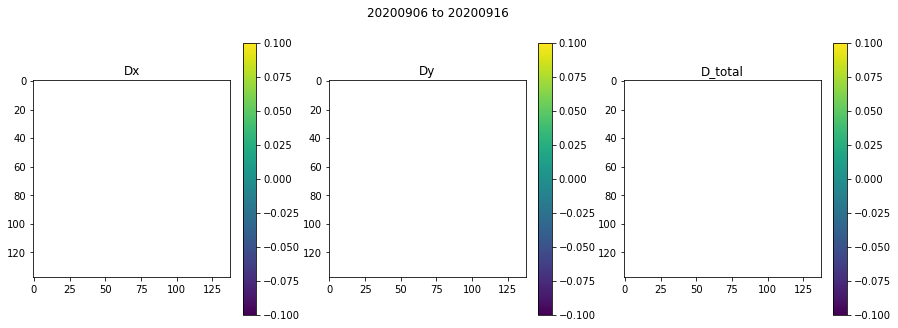

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01759171485900879
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

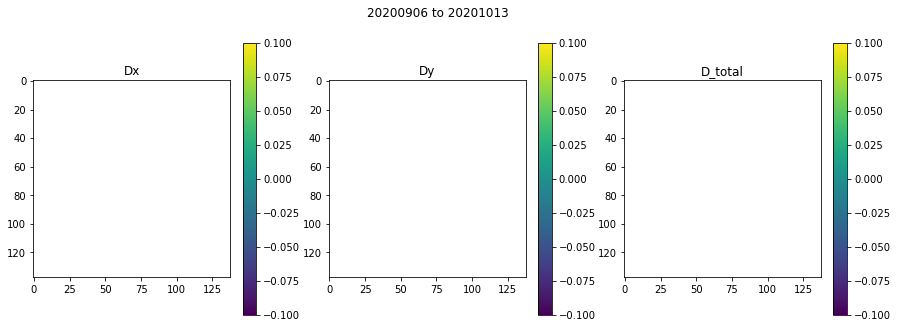

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010533809661865234
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

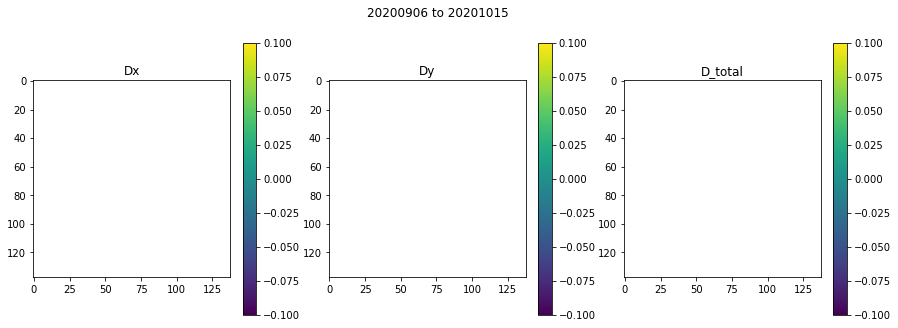

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010024070739746094
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

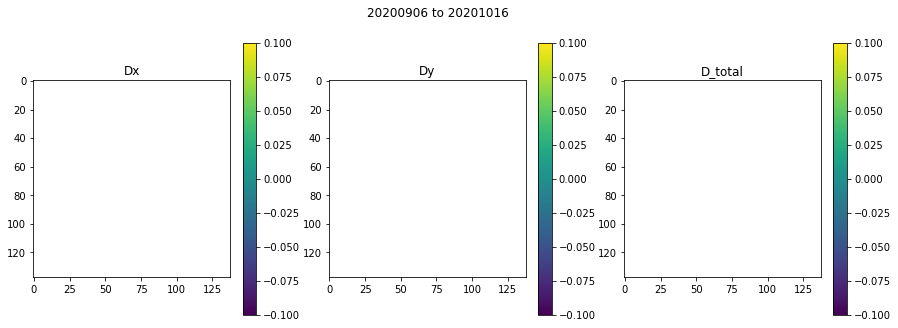

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01859903335571289
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

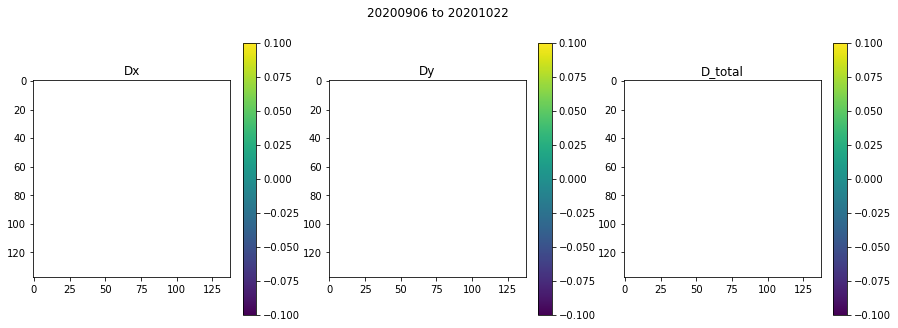

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010576963424682617
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

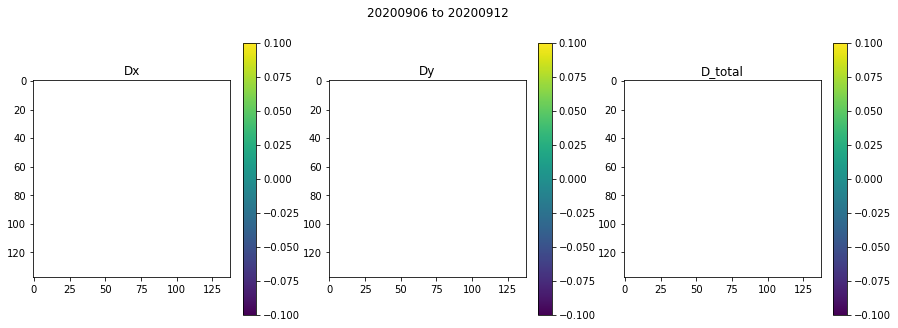

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01312708854675293
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

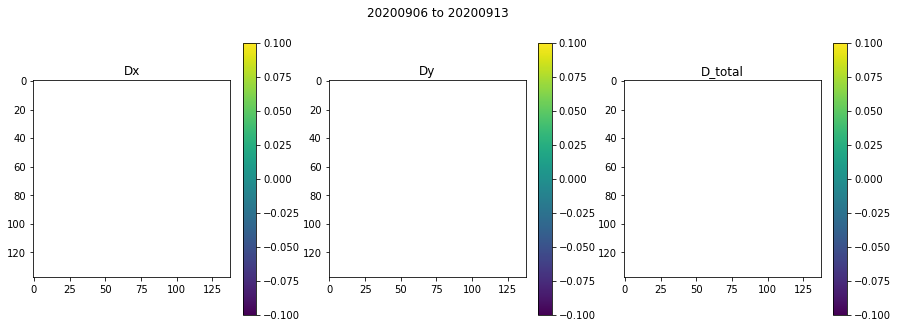

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01070094108581543
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

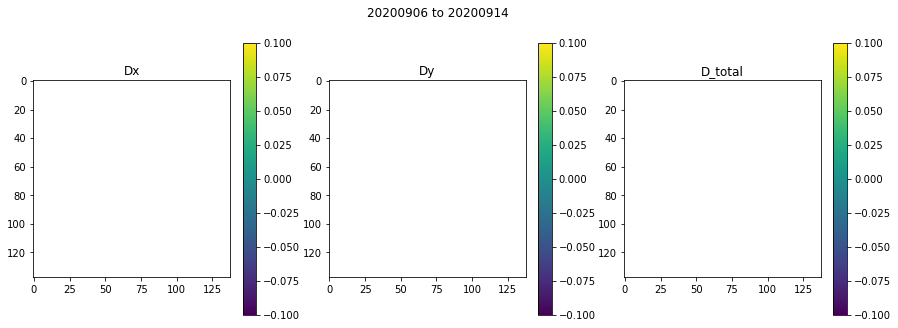

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016437053680419922
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

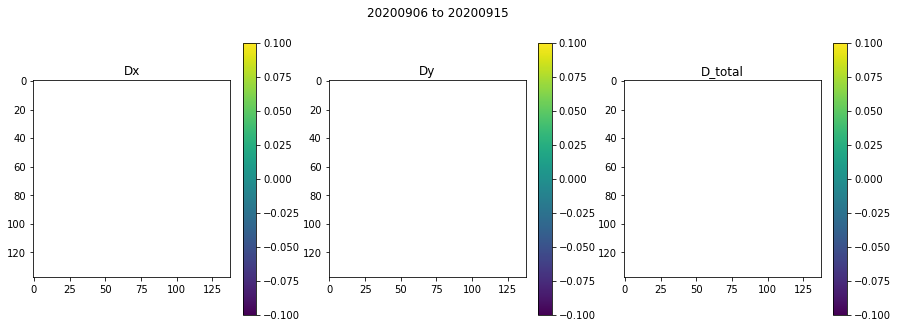

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015522003173828125
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

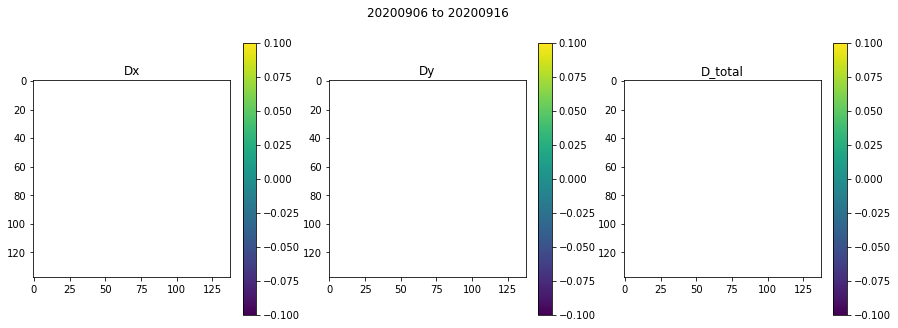

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0159299373626709
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

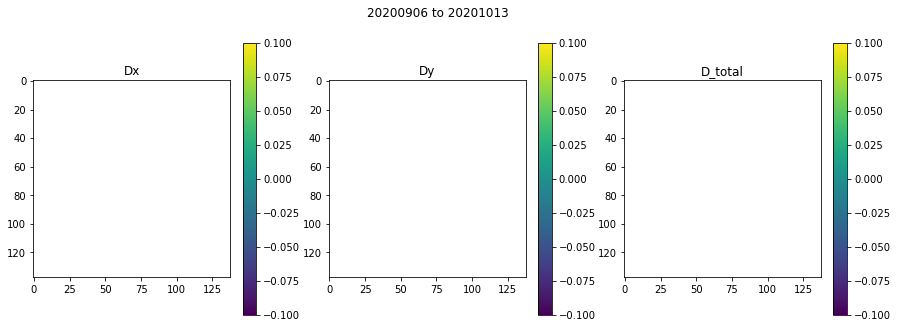

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010225057601928711
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

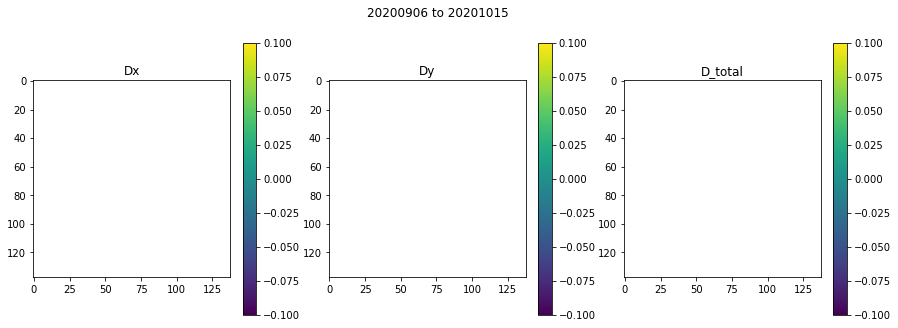

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01823902130126953
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

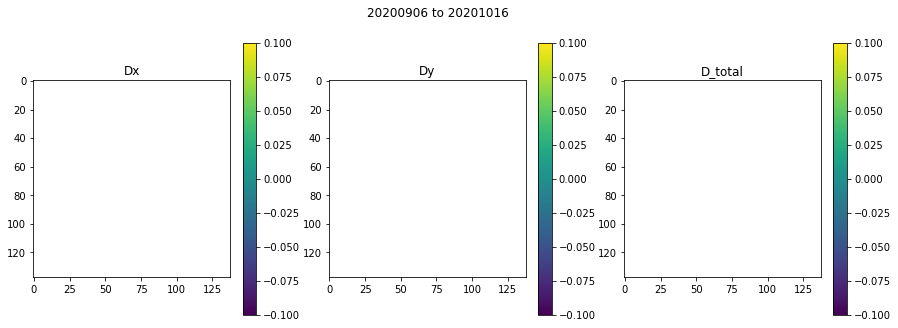

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.014437198638916016
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

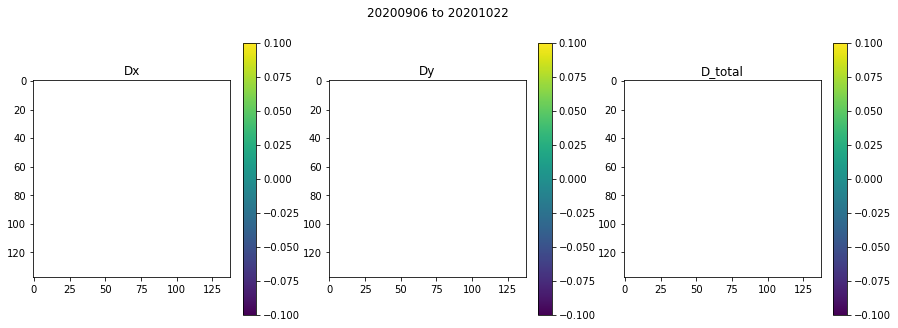

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01038503646850586
PS_20200906_clipped.tif PS_20200912_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 518400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DE

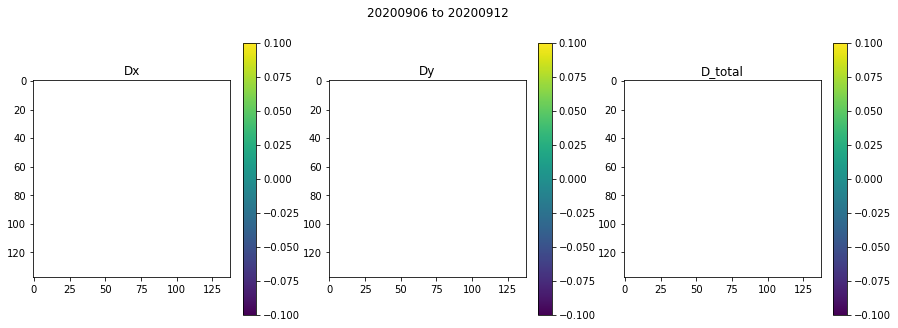

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010542154312133789
PS_20200906_clipped.tif PS_20200913_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 604800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

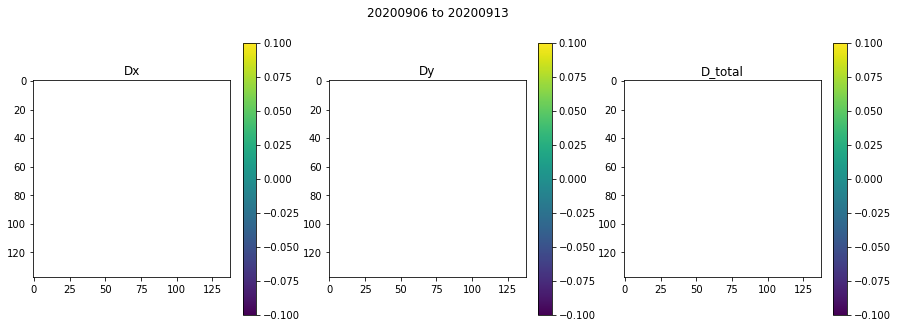

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010456085205078125
PS_20200906_clipped.tif PS_20200914_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 691200.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

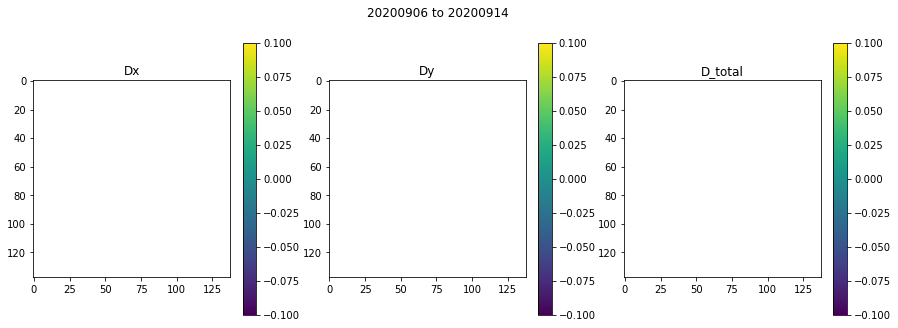

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.015284061431884766
PS_20200906_clipped.tif PS_20200915_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 777600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

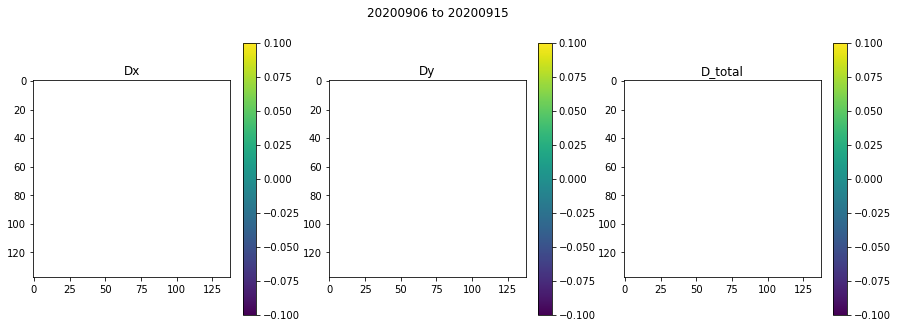

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.011795997619628906
PS_20200906_clipped.tif PS_20200916_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 864000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

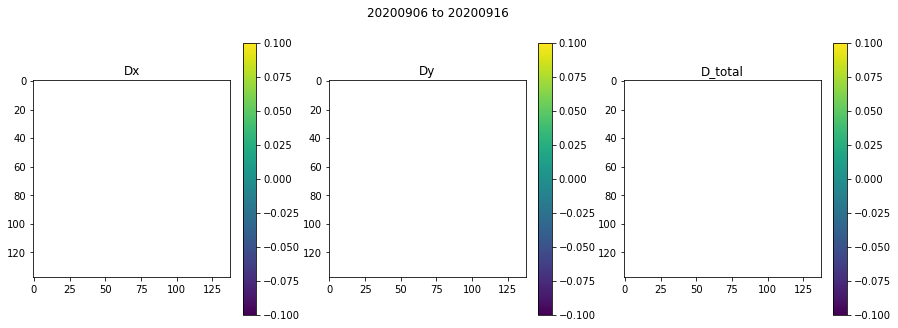

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01051783561706543
PS_20200906_clipped.tif PS_20201013_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3196800.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/D

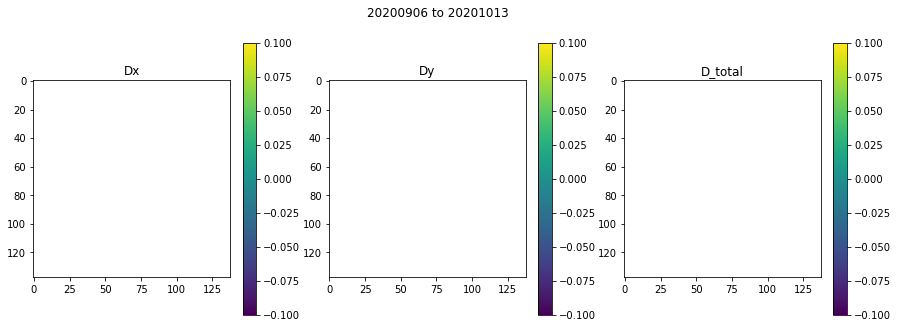

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.010174036026000977
PS_20200906_clipped.tif PS_20201015_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3369600.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

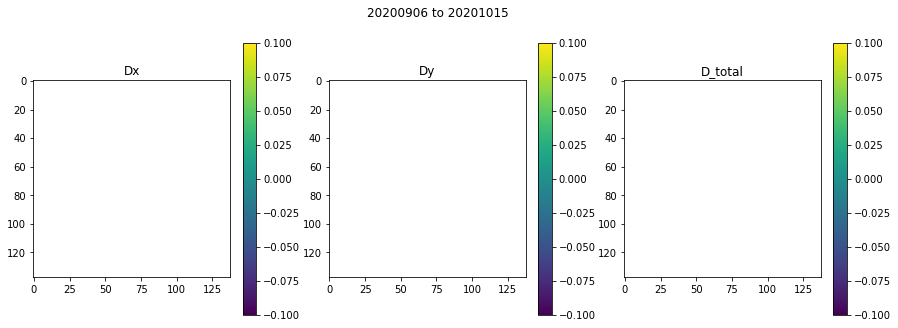

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020045995712280273
PS_20200906_clipped.tif PS_20201016_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3456000.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

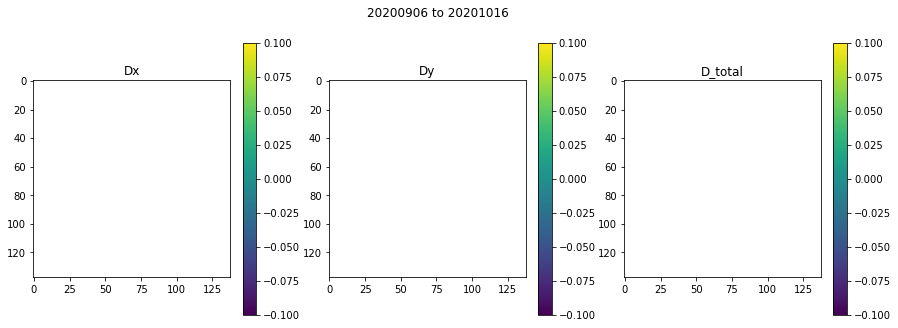

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.012159109115600586
PS_20200906_clipped.tif PS_20201022_clipped.tif
removed window_offset.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.


Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 546087.127  4.979215077180815
Y-direction coordinate: 6682892.3027  -4.979215081178562
Dimensions: 8357  8315

Map inputs: 
EPSG: 32607
Smallest Allowable Chip Size in m: 300
Repeat Time: 3974400.0
XLimits: 546087.127  587698.4274
YLimits: 6641490.1293  6682892.3027
Extent in km: 41.61130040000007  41.40217339999974
DEM: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/IfSAR_300m_DSM_clipped.tif
Slopes: /Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/

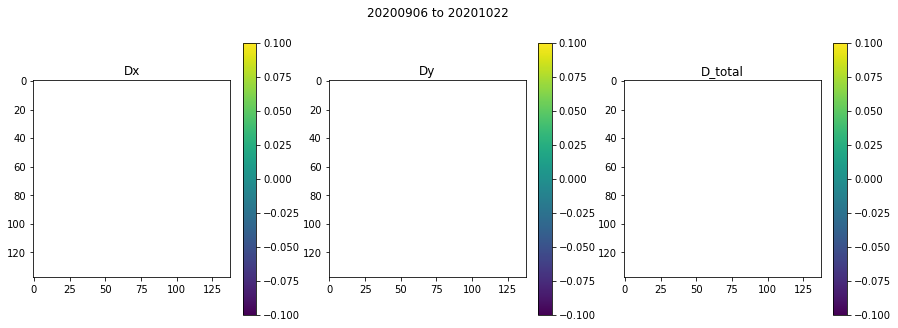

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01123189926147461


In [15]:
# try multiple chip sizes and sats
# for platform in ['S2','L8']:
for platform in ['PS']:
# for platform in [platforms]:
    # assign the folder path based on the platform
    if platform == 'S2': # sentinel-2
        path = s2path
        ext = '_clipped.tif' # image filename extension
        img_type = 'OPT'
        date_split_idx = 2 # split filename by underscore, index corresponds to image date
    elif platform == 'L8': # landsat 8
        path = LS8path
        ext = '.TIF'
        img_type = 'OPT'
        date_split_idx = 3
    elif platform == 'PS': # PlanetScope
        path = PSpath
        ext = '_clipped.tif' 
#         ext = '.tif' 
        img_type = 'OPT'
        date_split_idx = 1
    elif platform == 'S1': # sentinel-1
        path = S1path
        ext = '.zip' 
        img_type = 'SAR'
        date_split_idx = 5
    else:
        print('Platform', platform, 'not recognized. Options are "S2", "L8", "PS", and "S1"')

    # record all possible images and their dates
    dates = []; files = []  
    for file in os.listdir(path):
        if file.endswith(ext):
            date = file.split('_')[date_split_idx] # grab the date from the filename
            if platform == 'S1': # S1 filenames need another split
                date = date[:8]
            dates.append(date); files.append(file) # store the date and filename
    files_df = pd.DataFrame(list(zip(files,dates)),columns=['filename','date'])
    files_df = files_df.sort_values(by='date',ignore_index=True) # sort the dataframe by ascending date
    files_df = files_df[(files_df.date >= startdate) & (files_df.date <= enddate)]
    files_df = files_df.reset_index(drop=True) # reset index for searching
    print("Number of files found:",len(files_df))
    
    for min_chipsize in [100,200,300]: # MULTIPLE CHIP SIZES
#     for min_chipsize in [100,200,300]: # MULTIPLE CHIP SIZES
        MINCHIPSIZE = min_chipsize
        # generate geogrid inputs and grab outfilenames
        [dem_outfile, dhdx_outfile, dhdy_outfile, 
         vx_outfile, vy_outfile, srx_outfile, 
         sry_outfile, ssm_outfile, tg_outfile] = generate_geogrid_inputs(min_chipsize, dempath, demname, 
                                                                         refvpath, vx_fname, vy_fname, 
                                                                         sr_scaling)
#         [dem_outfile, dhdx_outfile, dhdy_outfile] = generate_geogrid_inputs(min_chipsize, dempath, demname, 
#                                                                          refvpath, vx_fname, vy_fname, 
#                                                                          sr_scaling)
        #######################################################################
        # # CHOOSE OPTIONAL INPUTS: (set as '' to leave blank)
        # # 1) surface slope:
        #   dhdx = ''; dhdy = ''  
        dhdx = dempath+dhdx_outfile; dhdy = dempath+dhdy_outfile
        
        # # 2) reference velocity:
#         vx = ''; vy = ''    
        vx = refvpath+vx_fname; vy = refvpath+vy_fname
        
        # # 3) chip sizes:
        csminx = ''; csminy = ''
        csmaxx = ''; csmaxy = ''  
        #             csminx = refvpath+csminx_fname; csminy = refvpath+csminy_fname
        #             csmaxx = refvpath+csmaxx_fname; csmaxy = refvpath+csmaxy_fname
        
        # # 4) stable surface mask:
        ssm = ''
        #             ssm = refvpath+ssm_outfile # stable surface mask 
        
        # # 5) search range limit:
        srx = ''; sry = '' # for best results, never input search range limit
        #######################################################################
        
        for rownum in range(0,len(files_df)-1):
            if rownum == 0: # for the first row, idx1 = 0 and idx2 = 1
                idx1 = rownum
#             idx2 = idx1+1 # reset index 2 as the next item - SEQUENTIAL
            for idx2, row in files_df[idx1:].iterrows(): # for all subsequent idxs - ALL PAIRS

                if idx1 < len(files_df) and idx2 < len(files_df): # don't surpass the end of the data
                    # identify the successive image pairs:
                    m = files_df.loc[idx1,'filename']; s = files_df.loc[idx2, 'filename']

                    # grab the two dates and convert to datetime objects
                    d1s = m.split('_')[date_split_idx]; d2s = s.split('_')[date_split_idx]
                    if platform == 'S1': # S1 filenames need another split
                        d1s = d1s[:8]; d2s = d2s[:8]

                    # calculate time separation
                    d1 = datetime.datetime.strptime(d1s, '%Y%m%d'); d2 = datetime.datetime.strptime(d2s, '%Y%m%d')
                    dt = d2-d1; dt = int(dt.days)
                    
#                     # SEQUENTIAL
#                     # evaluate if dates are within the appropriate time separation
#                     while (dt < min_dt or dt > max_dt): # dt is outside of appropriate time separation
#                         idx2 += 1 # increment index 2

#                         if idx2 > len(files_df)-1:
#                             print('No image pair with correct time separation found. Skip to next.')
#                             idx2 = idx1+1 # reset index 2 as the next item 
#                             m = None; s = None
#                             break

#                         # Keep looking for the correct time separation:
#                         m = files_df.loc[idx1,'filename']; s = files_df.loc[idx2, 'filename']

#                         # grab the two dates and convert to datetime objects
#                         d1s = m.split('_')[date_split_idx]; d2s = s.split('_')[date_split_idx]
#                         print(d1s, d2s)
#                         if platform == 'S1': # S1 filenames need another split
#                             d1s = d1s[:8]; d2s = d2s[:8]
#                         d1 = datetime.datetime.strptime(d1s, '%Y%m%d'); d2 = datetime.datetime.strptime(d2s, '%Y%m%d')
#                         dt = d2-d1; dt = int(dt.days)


                    # run geogrid and autoRIFT
                    if m is not None and s is not None:
                        print(m,s)
                        indir_m = path+m; indir_s = path+s # path to the two images
                        
                        # ADJUST CODE TO NOT HAVE TO CHANGE THIS BETWEEN SK AND LOWELL
#                         dem = dempath+'Lowell_'+str(MINCHIPSIZE)+'m_DSM_clipped.tif'
#                         dhdx = dempath+'Lowell_'+str(MINCHIPSIZE)+'m_DSM_clipped_dhdx.tif'
#                         dhdy = dempath+'Lowell_'+str(MINCHIPSIZE)+'m_DSM_clipped_dhdy.tif'
                        dem = dempath+'IfSAR_'+str(MINCHIPSIZE)+'m_DSM_clipped.tif'
                        dhdx = dempath+'IfSAR_'+str(MINCHIPSIZE)+'m_DSM_clipped_dhdx.tif'
                        dhdy = dempath+'IfSAR_'+str(MINCHIPSIZE)+'m_DSM_clipped_dhdy.tif'
                        ###################### RUN GEOGRID ################################
                        run_geogrid_inhouse(out_path, img_type, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
                                            dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm, # optional inputs
                                            temp_dir)

                            ##################### PREP AUTORIFT ##############################
                            gp = out_path # identify files produced from geogrid
                            # remove all empty grids
                            for grid in os.listdir(gp): 
                                if grid.startswith('window') and grid.endswith('.tif'):
                                    reader = rio.open(gp+grid) # read dataset
                                    data_found = False 
                                    for band in range(1,reader.count+1):
                                        testband = reader.read(band) # read in the band
                                        if np.count_nonzero(testband[testband != NO_DATA_VAL]) > 0:
                                            data_found = True
                                    if not data_found:
                                        print(grid, 'has no data. Removed.')
                                        os.remove(gp+grid)

                            # fill in AutoRIFT parameters using the files
                            mpflag = 0 # leave multiprocessing off

                            # GRID LOCATION (required) from window_location.tif
                            grid_location = rio.open(gp+'window_location.tif')
                            xGrid = grid_location.read(1) # 1st band in window location
                            yGrid = grid_location.read(2) # 2nd band in window location

                            # optional parameters (default None or zero until filled)
                            init_offset = None; search_range = None
                            chip_size_min = None; chip_size_max = None
                            offset2vx = None; offset2vy = None; stable_surface_mask = None
                            Dx0 = None; Dy0 = None; CSMINx0 = None
                            SRx0 = None; SRy0 = None;
                            CSMAXx0 = None; CSMAXy0 = None; SSM = None
                            noDataMask = np.zeros(xGrid.shape).astype(int)

                            if os.path.exists(gp+'window_offset.tif'): # Dx0 and Dy0 from window_offset.tif
                                init_offset = rio.open(gp+'window_offset.tif')
                                Dx0 = init_offset.read(1); Dy0 = init_offset.read(2)
                            if os.path.exists(gp+'window_search_range.tif'): # SRx0 and SRy0 from window_search_range.tif
                                search_range = rio.open(gp+'window_search_range.tif')
                                SRx0 = search_range.read(1); SRy0 = search_range.read(2)
                            if os.path.exists(gp+'window_chip_size_min.tif'): # CSMINx0 and CSMINy0 from window_chip_size_min.tif
                                chip_size_min = rio.open(gp+'window_chip_size_min.tif')
                                CSMINx0 = chip_size_min.read(1); CSMINy0 = chip_size_min.read(2)
                            if os.path.exists(gp+'window_chip_size_max.tif'): # CSMAXx0 and CSMAXy0 from window_chip_size_max.tif
                                chip_size_max = rio.open(gp+'window_chip_size_max.tif')
                                CSMAXx0 = chip_size_max.read(1); CSMAXy0 = chip_size_max.read(2)
                            if os.path.exists(gp+'window_rdr_off2vel_x_vec.tif'): # offset2vx from window_rdr_off2vel_x_vec.tif
                                offset2vx = gp+'window_rdr_off2vel_x_vec.tif' # path to be read in with GDAL
                            if os.path.exists(gp+'window_rdr_off2vel_y_vec.tif'): # offset2vy from window_rdr_off2vel_y_vec.tif
                                offset2vy = gp+'window_rdr_off2vel_y_vec.tif' 
                            if os.path.exists(gp+'window_stable_surface_mask.tif'): # noDataMask from window_stable_surface_mask.tif
                                stable_surface_mask = rio.open(gp+'window_stable_surface_mask.tif')
                                noDataMask = stable_surface_mask.read(1)

                            # other parameters
                            nodata = NO_DATA_VAL # use same as in previous steps
                            geogrid_run_info=None
                            print('AutoRIFT parameters loaded.')

                        ##################### RUN AUTORIFT ##############################
                        print(indir_m, indir_s)
                        # run autoRIFT with function
                        run_autoRIFT_inhouse(indir_m, indir_s, out_path, img_type, mpflag, xGrid, yGrid, # required parameters
                                                 FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATE, 
                                                 OVERSAMPLE_RATIO, MINCHIPSIZE,
                                                 Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                                 
                                             
                                             
                                             
                                             
                                             noDataMask, nodata, geogrid_run_info=None)

#                     idx1 = idx2 # set the second image index as the new first image index - SEQUENTIAL
#                     if idx2 >= len(files_df)-1:
#                         print('Finished searching.')
#                         break
